In [1]:
# Projet de data sciences, reconnaître les évènements de pêche
# Trajectoire de bateaux en time series 
# 4 à 5 types de pêches: évènements à caractériser par une réduction de la vitesse et des déplacements spécifiques et dans le même secteur
# Ajouter une appli qui présente les trajectoires potentiellement de pêche et qui permet de cliquer sur un oui ou non afin de labeller 
# pour un apprentissage supervisé (garder la trajectoire en entier, détecter début et fin de trajectoire, colorer avec vitesse les portion de trajectoire potentiellement de pêche)

In [2]:
import pandas as pd

In [3]:
path = '/Users/sarahlenet/Desktop/Bloom/spire_ais_data_13042024/'

In [4]:
df = pd.read_csv(path + 'spire_ais_data_FR_13042024.csv', sep = ';')

In [5]:
df

,id,spire_update_statement,vessel_ais_class,vessel_flag,vessel_name,vessel_callsign,vessel_timestamp,vessel_update_timestamp,vessel_ship_type,vessel_sub_ship_type,...,position_rot,position_speed,position_timestamp,position_update_timestamp,voyage_destination,voyage_draught,voyage_eta,voyage_timestamp,voyage_update_timestamp,created_at
0,880345,2024-04-01 22:39:20.172+00,A,FR,F/V TH0MAS NICOLAS 2,FKDT,2024-04-01 07:11:28+00,2024-04-01 07:23:22.164+00,FISHING,NaN,...,NaN,10.2,2024-04-01 22:21:53+00,2024-04-01 22:39:20.172+00,LE HAVRE,4.0,NaN,2024-04-01 07:11:28+00,2024-04-01 07:23:22.164+00,2024-04-11 19:20:02.512986+00
1,880354,2024-04-11 19:08:38.909+00,A,FR,F/V EMERAUDE,FJVO,2024-04-11 03:51:45+00,2024-04-11 04:05:59.937+00,FISHING,FISHING,...,0.000000,14.5,2024-04-11 19:06:55+00,2024-04-11 19:08:38.909+00,ALESUND (NOAES),7.5,2024-04-13 14:00:00+00,2024-04-11 17:01:12+00,2024-04-11 17:01:23.54+00,2024-04-11 19:20:02.512986+00
2,880361,2024-04-11 19:15:44.77+00,A,FR,F/V LE MARMOUSET 3,FJZH,2024-04-11 05:45:46+00,2024-04-11 05:45:56.461+00,FISHING,NaN,...,0.000000,0.0,2024-04-11 19:15:35+00,2024-04-11 19:15:44.77+00,NaN,3.6,NaN,2024-04-11 13:40:07+00,2024-04-11 13:40:17.582+00,2024-04-11 19:20:02.512986+00
3,880392,2024-04-11 17:51:47.037+00,A,FR,F/V RADOCHE TERCERO,FIDH,2024-04-11 02:25:02+00,2024-04-11 02:25:21.662+00,FISHING,NaN,...,0.000000,3.0,2024-04-11 17:21:44+00,2024-04-11 17:51:47.037+00,CORUNA,4.5,2024-06-07 00:00:00+00,2024-04-10 23:55:01+00,2024-04-10 23:55:21.412+00,2024-04-11 19:20:02.512986+00
4,880395,2024-04-11 19:13:05.443+00,A,FR,F/V LA TRINITE,FAE9935,2024-04-11 06:05:38+00,2024-04-11 06:15:02.681+00,FISHING,NaN,...,17.856115,4.3,2024-04-11 19:03:46+00,2024-04-11 19:13:05.443+00,BOULOGNE/MER,3.5,NaN,2024-04-11 06:05:38+00,2024-04-11 06:15:02.681+00,2024-04-11 19:20:02.512986+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21723,1171270,2024-04-13 19:08:13.705+00,A,FR,F/V CAP BOJADOR,FGPI,2024-04-13 04:11:12+00,2024-04-13 04:11:22.206+00,FISHING,NaN,...,0.000000,9.5,2024-04-13 18:57:38+00,2024-04-13 19:08:13.705+00,ABIDJAN,6.7,2024-02-27 07:00:00+00,2024-04-12 21:11:12+00,2024-04-12 21:13:36.064+00,2024-04-13 19:20:03.221582+00
21724,1171274,2024-04-13 19:20:12.416+00,A,FR,F/V JULIEN COLEOU,FHEV,2024-04-13 01:17:52+00,2024-04-13 01:18:08.788+00,FISHING,NaN,...,0.000000,0.0,2024-04-13 19:20:02+00,2024-04-13 19:20:12.416+00,LORIENT,4.5,2024-04-12 06:00:00+00,2024-04-13 00:59:53+00,2024-04-13 01:00:06.017+00,2024-04-13 19:20:03.221582+00
21725,1171280,2024-04-13 18:55:35.736+00,A,FR,F/V MELODIE,FPSR,2024-04-11 01:45:05+00,2024-04-11 01:45:23.209+00,FISHING,NaN,...,0.000000,1.2,2024-04-13 17:26:50.581+00,2024-04-13 18:55:35.736+00,VHF CH 16/77,NaN,NaN,2024-04-11 01:45:05+00,2024-04-11 01:45:23.209+00,2024-04-13 19:20:03.221582+00
21726,1171319,2024-03-16 06:35:50.753+00,A,FR,F/V GLENAN,FMHD,2024-03-15 07:27:13+00,2024-03-15 10:06:44.513+00,FISHING,NaN,...,0.000000,0.0,2024-03-16 02:20:40+00,2024-03-16 06:35:50.753+00,MAHE,7.5,2024-03-03 00:00:00+00,2024-03-15 07:27:13+00,2024-03-15 10:06:44.513+00,2024-04-13 19:20:03.221582+00


In [6]:
df.columns

Index(['id', 'spire_update_statement', 'vessel_ais_class', 'vessel_flag',
       'vessel_name', 'vessel_callsign', 'vessel_timestamp',
       'vessel_update_timestamp', 'vessel_ship_type', 'vessel_sub_ship_type',
       'vessel_mmsi', 'vessel_imo', 'vessel_width', 'vessel_length',
       'position_accuracy', 'position_collection_type', 'position_course',
       'position_heading', 'position_latitude', 'position_longitude',
       'position_maneuver', 'position_navigational_status', 'position_rot',
       'position_speed', 'position_timestamp', 'position_update_timestamp',
       'voyage_destination', 'voyage_draught', 'voyage_eta',
       'voyage_timestamp', 'voyage_update_timestamp', 'created_at'],
      dtype='object')

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


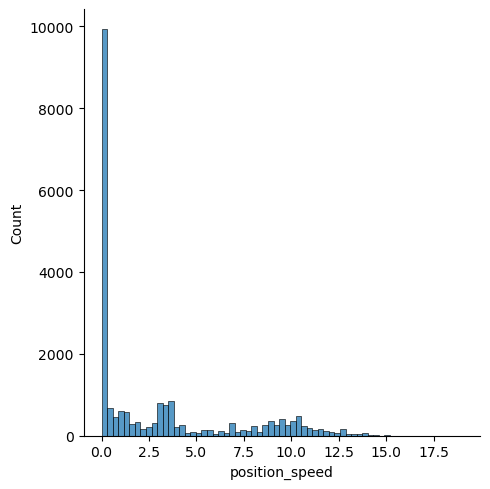

In [7]:
import seaborn as sns
sns.displot(data = df, x = 'position_speed')

In [8]:
position = pd.read_csv(path + 'spire_ais_data_13042024.csv', sep = ';')

In [9]:
position.columns

Index(['id', 'spire_update_statement', 'vessel_ais_class', 'vessel_flag',
       'vessel_name', 'vessel_callsign', 'vessel_timestamp',
       'vessel_update_timestamp', 'vessel_ship_type', 'vessel_sub_ship_type',
       'vessel_mmsi', 'vessel_imo', 'vessel_width', 'vessel_length',
       'position_accuracy', 'position_collection_type', 'position_course',
       'position_heading', 'position_latitude', 'position_longitude',
       'position_maneuver', 'position_navigational_status', 'position_rot',
       'position_speed', 'position_timestamp', 'position_update_timestamp',
       'voyage_destination', 'voyage_draught', 'voyage_eta',
       'voyage_timestamp', 'voyage_update_timestamp', 'created_at'],
      dtype='object')

In [10]:
first_name = df.vessel_name.loc[0]

In [11]:
df = df.sort_values('position_timestamp')

In [12]:
df_first_name = df[df['vessel_name'] == first_name]
df_second_name = df[df['vessel_name'] == 'F/V EMERAUDE']

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


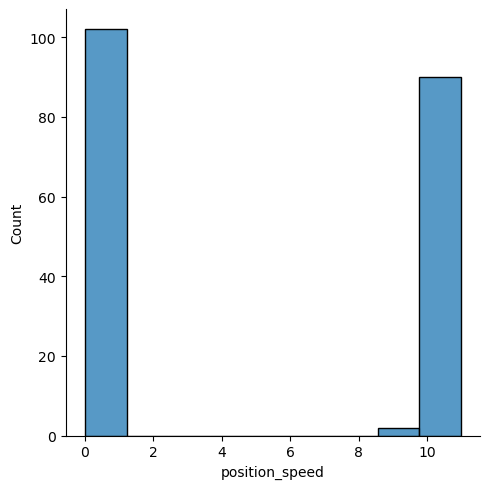

In [13]:
sns.displot(x = 'position_speed', data = df_first_name);

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


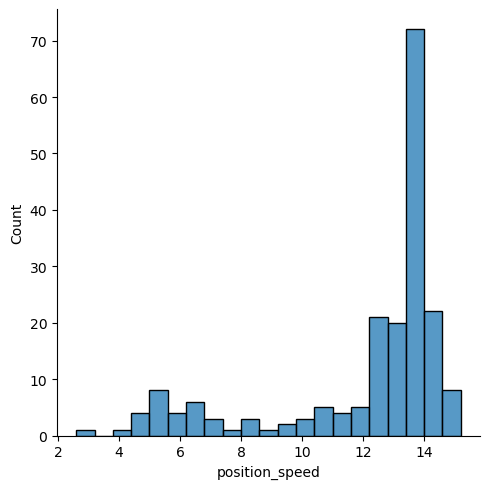

In [14]:
sns.displot(x = 'position_speed', data = df_second_name);

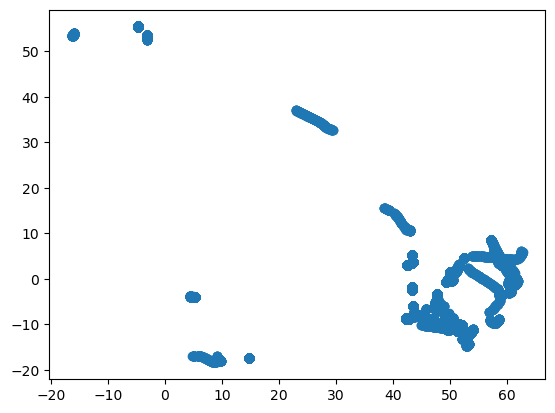

In [15]:
import matplotlib.pyplot as plt
plt.scatter(df['position_latitude'], df['position_longitude']);

/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/opt/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


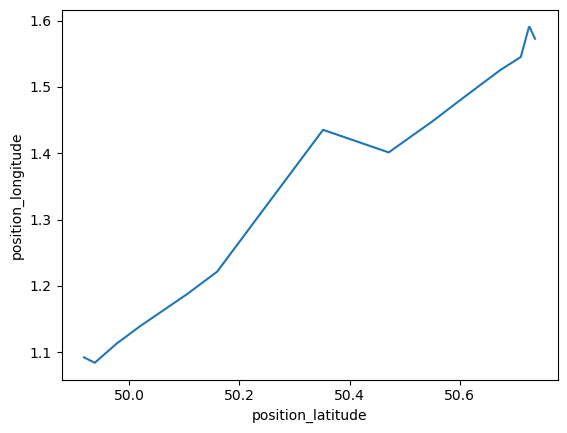

In [16]:
sns.lineplot(data = df[df['vessel_name'] == df.loc[0,:].to_frame().T['vessel_name'].values[0]], x = 'position_latitude', y = 'position_longitude');

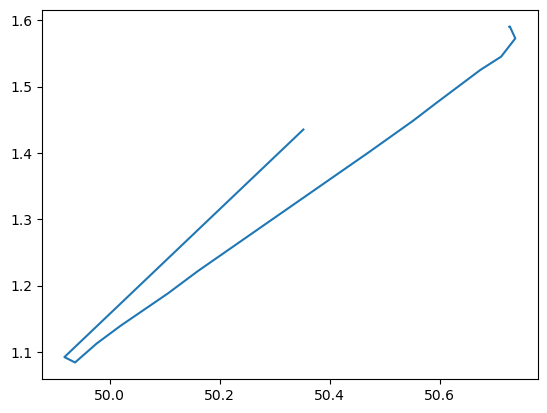

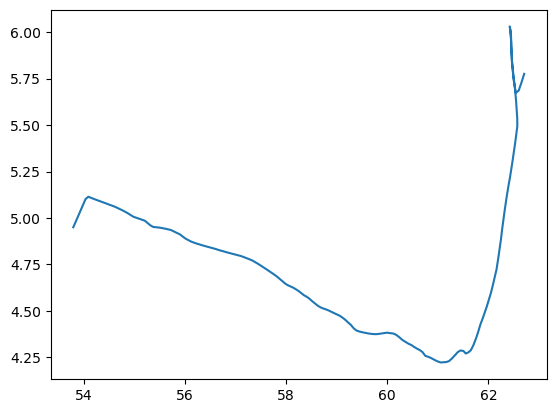

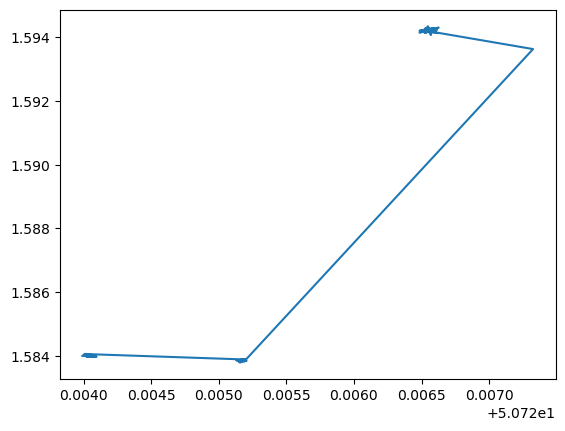

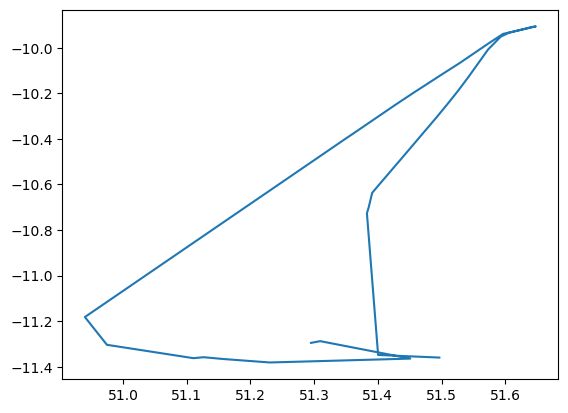

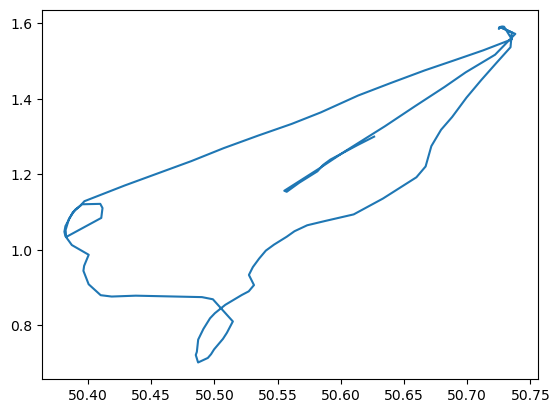

...

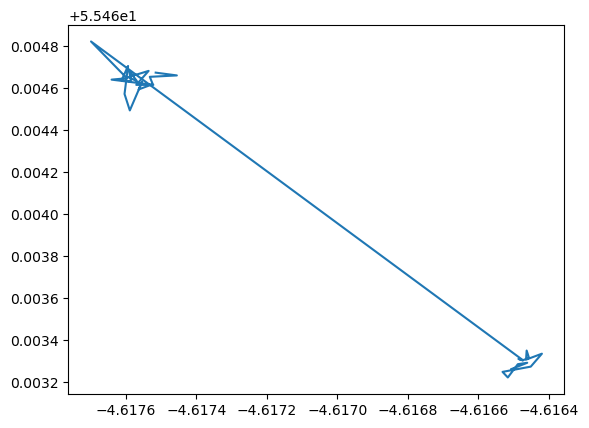

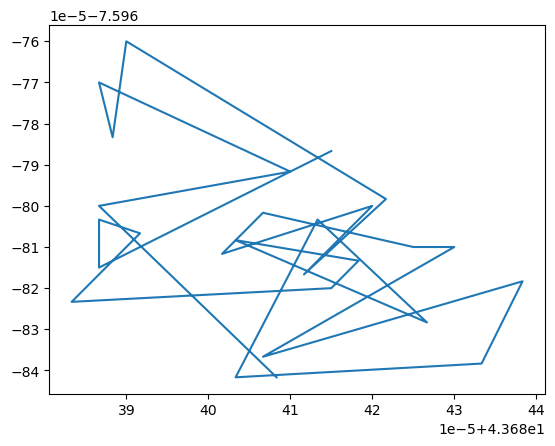

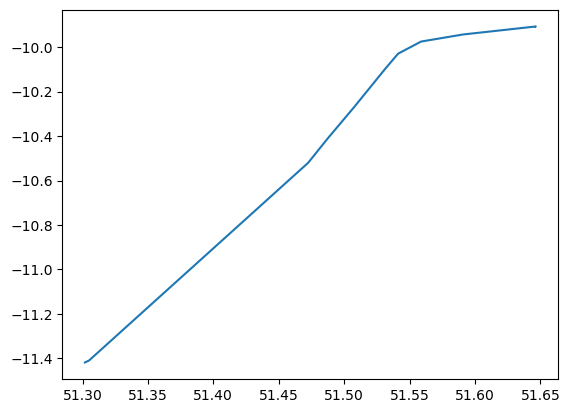

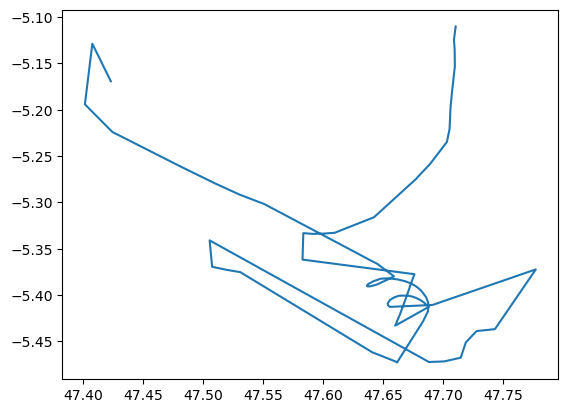

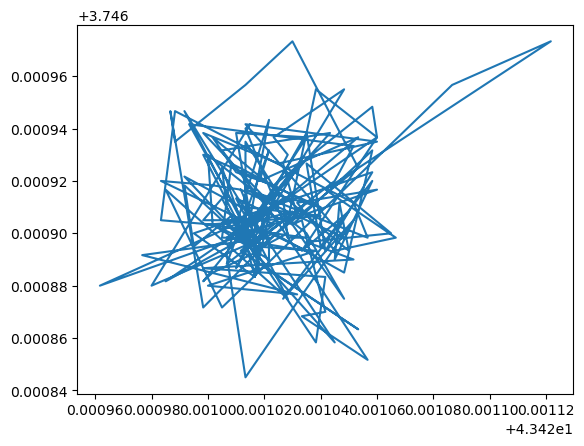

In [17]:
for i in range(50):
    plt.plot(df[df['vessel_name'] == df.loc[i,:].to_frame().T['vessel_name'].values[0]]['position_latitude'], df[df['vessel_name'] == df.loc[i,:].to_frame().T['vessel_name'].values[0]]['position_longitude'])
    plt.show();


In [18]:
df.columns

Index(['id', 'spire_update_statement', 'vessel_ais_class', 'vessel_flag',
       'vessel_name', 'vessel_callsign', 'vessel_timestamp',
       'vessel_update_timestamp', 'vessel_ship_type', 'vessel_sub_ship_type',
       'vessel_mmsi', 'vessel_imo', 'vessel_width', 'vessel_length',
       'position_accuracy', 'position_collection_type', 'position_course',
       'position_heading', 'position_latitude', 'position_longitude',
       'position_maneuver', 'position_navigational_status', 'position_rot',
       'position_speed', 'position_timestamp', 'position_update_timestamp',
       'voyage_destination', 'voyage_draught', 'voyage_eta',
       'voyage_timestamp', 'voyage_update_timestamp', 'created_at'],
      dtype='object')

In [19]:
df['position_speed']

2267      0.0
16267     0.0
18619     0.0
12123     0.0
7531      0.0
         ... 
21716     1.0
21717     9.5
21708     0.0
21719     0.0
21710    12.9
Name: position_speed, Length: 21728, dtype: float64

In [20]:
# Les critères de vitesse pour vérifier si la trajectoire est une trajectoire de pêche:
# - on peut imaginer un diminution de la vitesse en pourcentage de la vitesse moyenne / de la vitesse max (not the best solution)
# - on peut supposer que les navires ont tous une vitesse de croisière plus ou moins la même et avoir une limite absolue
import numpy as np
mean_speeds = df.groupby(['vessel_name']).agg({'position_speed' : np.mean})

/var/folders/vm/ylnr3pdd3pjdxlnt2mn3hy7c0000gn/T/ipykernel_2918/3488546413.py:5: FutureWarning: The provided callable <function mean at 0x103bf7060> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  mean_speeds = df.groupby(['vessel_name']).agg({'position_speed' : np.mean})


<Axes: >

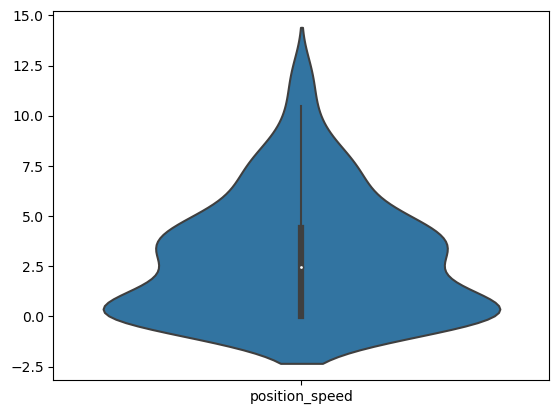

In [21]:
sns.violinplot(mean_speeds)

In [22]:
df[df['vessel_name'] == df.loc[1, 'vessel_name']]['position_speed'].unique()

array([14.5, 14.4, 14.3, 14.2, 13.9, 13.8, 14. , 13.7, 14.1, 10.6, 13.5,
       13.6, 13.3, 13.4, 11.2, 13.1, 12.9, 12.7, 12.6, 12.8, 13. , 13.2,
       14.6, 14.7, 15.1, 15.2, 15. , 12.1, 12.2, 11.9, 12.3, 12.4, 12. ,
       12.5, 11.5, 11.3, 11.7, 10.3, 10.4, 10.9, 11. ,  9.9,  9.2,  8.4,
        8.3,  8.6,  8. ,  6.9,  6.5,  6.6,  6.4,  7. ,  6.3,  6.2,  5.3,
        5.4,  5.6,  4.9,  4.8,  5.8,  5.1,  4.7,  4.1,  7.5,  2.6])

In [23]:
df_ = df[df['vessel_name'] == 'PUNTA VIXIA']

In [24]:
df_

,id,spire_update_statement,vessel_ais_class,vessel_flag,vessel_name,vessel_callsign,vessel_timestamp,vessel_update_timestamp,vessel_ship_type,vessel_sub_ship_type,...,position_rot,position_speed,position_timestamp,position_update_timestamp,voyage_destination,voyage_draught,voyage_eta,voyage_timestamp,voyage_update_timestamp,created_at
9765,1011112,2024-04-09 13:38:33.29+00,A,FR,PUNTA VIXIA,FIKF,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,FISHING,NaN,...,0.0,0.2,2024-04-09 13:20:41+00,2024-04-09 13:20:51.463+00,CASTLETOWNBERE,6.7,2023-08-10 16:00:00+00,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,2024-04-12 16:50:03.129973+00
2485,913612,2024-04-09 13:38:33.29+00,A,FR,PUNTA VIXIA,FIKF,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,FISHING,NaN,...,0.0,0.2,2024-04-09 13:20:41+00,2024-04-09 13:20:51.463+00,CASTLETOWNBERE,6.7,2023-08-10 16:00:00+00,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,2024-04-12 00:35:03.596138+00
4613,942112,2024-04-09 13:38:33.29+00,A,FR,PUNTA VIXIA,FIKF,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,FISHING,NaN,...,0.0,0.2,2024-04-09 13:20:41+00,2024-04-09 13:20:51.463+00,CASTLETOWNBERE,6.7,2023-08-10 16:00:00+00,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,2024-04-12 05:20:02.779057+00
18165,1123612,2024-04-09 13:38:33.29+00,A,FR,PUNTA VIXIA,FIKF,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,FISHING,NaN,...,0.0,0.2,2024-04-09 13:20:41+00,2024-04-09 13:20:51.463+00,CASTLETOWNBERE,6.7,2023-08-10 16:00:00+00,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,2024-04-13 11:35:02.760209+00
15701,1090612,2024-04-09 13:38:33.29+00,A,FR,PUNTA VIXIA,FIKF,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,FISHING,NaN,...,0.0,0.2,2024-04-09 13:20:41+00,2024-04-09 13:20:51.463+00,CASTLETOWNBERE,6.7,2023-08-10 16:00:00+00,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,2024-04-13 06:05:03.071115+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1141,895612,2024-04-09 13:38:33.29+00,A,FR,PUNTA VIXIA,FIKF,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,FISHING,NaN,...,0.0,0.2,2024-04-09 13:20:41+00,2024-04-09 13:20:51.463+00,CASTLETOWNBERE,6.7,2023-08-10 16:00:00+00,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,2024-04-11 21:35:02.77779+00
17493,1114612,2024-04-09 13:38:33.29+00,A,FR,PUNTA VIXIA,FIKF,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,FISHING,NaN,...,0.0,0.2,2024-04-09 13:20:41+00,2024-04-09 13:20:51.463+00,CASTLETOWNBERE,6.7,2023-08-10 16:00:00+00,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,2024-04-13 10:05:03.322049+00
21,880622,2024-04-09 13:38:33.29+00,A,FR,PUNTA VIXIA,FIKF,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,FISHING,NaN,...,0.0,0.2,2024-04-09 13:20:41+00,2024-04-09 13:20:51.463+00,CASTLETOWNBERE,6.7,2023-08-10 16:00:00+00,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,2024-04-11 19:20:02.512986+00
1365,898612,2024-04-09 13:38:33.29+00,A,FR,PUNTA VIXIA,FIKF,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,FISHING,NaN,...,0.0,0.2,2024-04-09 13:20:41+00,2024-04-09 13:20:51.463+00,CASTLETOWNBERE,6.7,2023-08-10 16:00:00+00,2024-04-09 13:23:19+00,2024-04-09 13:38:33.29+00,2024-04-11 22:05:02.907096+00


F/V GERALD-JEAN 3
2267     42.51664
16267    42.51664
18619    42.51664
12123    42.51664
7531     42.51664
           ...   
11451    42.51664
21195    42.51664
6411     42.51664
17051    42.51664
1371     42.51664
Name: position_latitude, Length: 194, dtype: float64


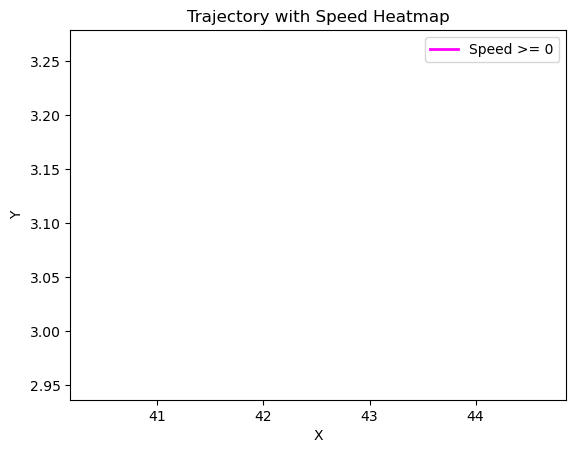

F/V ASPIN
16263    43.321483
12455    43.321483
17271    43.321483
11223    43.321483
14583    43.321483
           ...    
7303     43.321483
23       43.321483
10775    43.321483
1591     43.321483
3383     43.321483
Name: position_latitude, Length: 194, dtype: float64


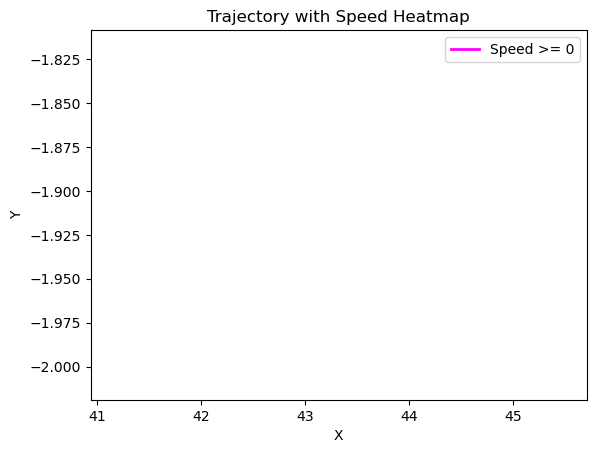

CHRISDERIC V
6572     42.6208
9148     42.6208
19900    42.6208
13292    42.6208
8028     42.6208
          ...   
5004     42.6208
16092    42.6208
14188    42.6208
20348    42.6208
17324    42.6208
Name: position_latitude, Length: 194, dtype: float64


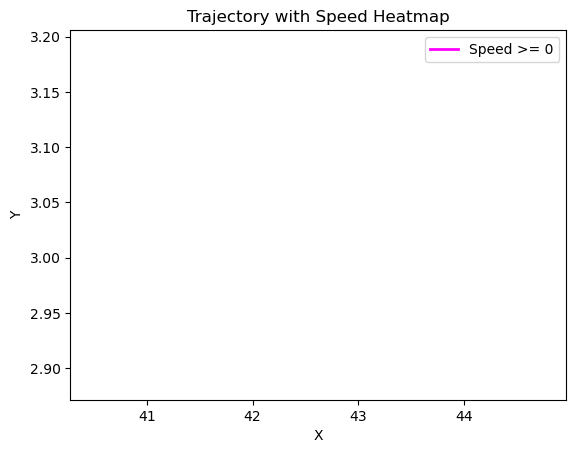

F/V GERALD JEAN IV
12670    42.516608
1022     42.516608
14350    42.516608
9198     42.516608
13790    42.516608
           ...    
17822    42.516608
350      42.516608
18606    42.516608
12110    42.516608
16702    42.516608
Name: position_latitude, Length: 194, dtype: float64


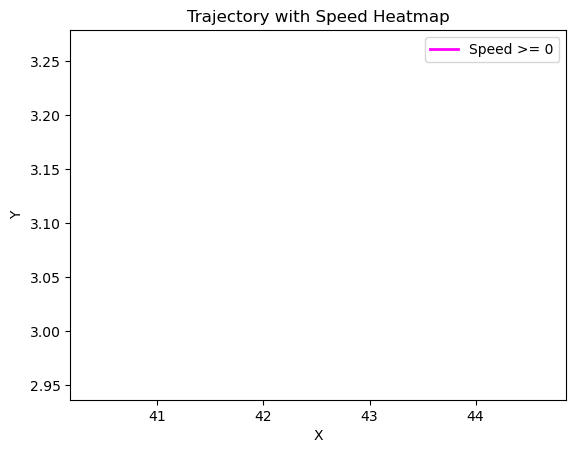

F/V  J.M.CHRISTIAN 4
7909     43.399867
7461     43.399867
965      43.399867
1413     43.399867
9813     43.399867
           ...    
21237    43.400393
21349    43.400373
21461    43.400397
21573    43.400410
21685    43.400392
Name: position_latitude, Length: 194, dtype: float64


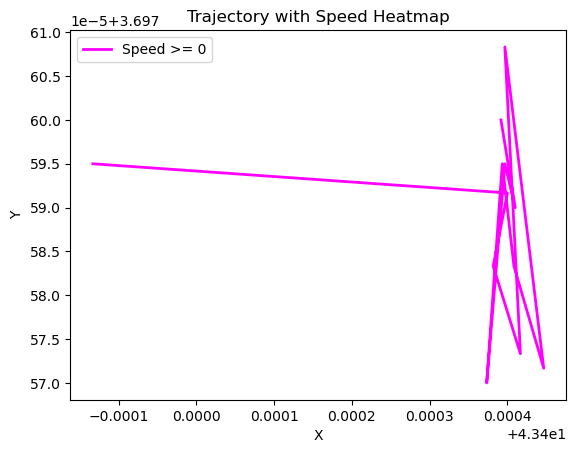

F/V GLENAN
7390    -4.616523
1566    -4.616523
20718   -4.616523
4926    -4.616523
3246    -4.616523
           ...   
18702   -4.616523
8846    -4.616523
5262    -4.616523
16126   -4.616523
4142    -4.616523
Name: position_latitude, Length: 194, dtype: float64


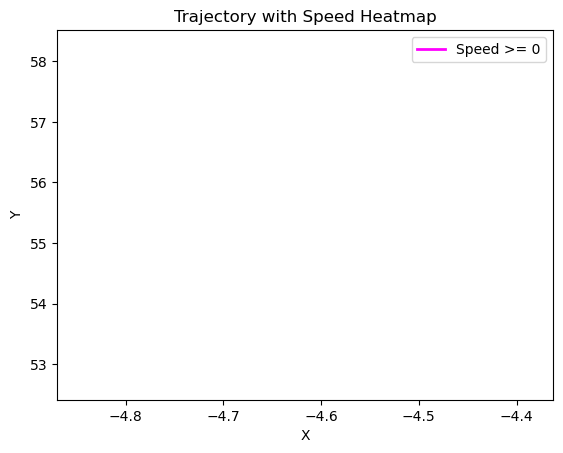

CAP SAINT VINCENT
5610    -4.620093
2362    -4.620093
2026    -4.620093
6506    -4.620093
2138    -4.620093
           ...   
20058   -3.184188
12218   -3.184188
15914   -3.184188
16362   -3.184188
15242   -3.184188
Name: position_latitude, Length: 194, dtype: float64


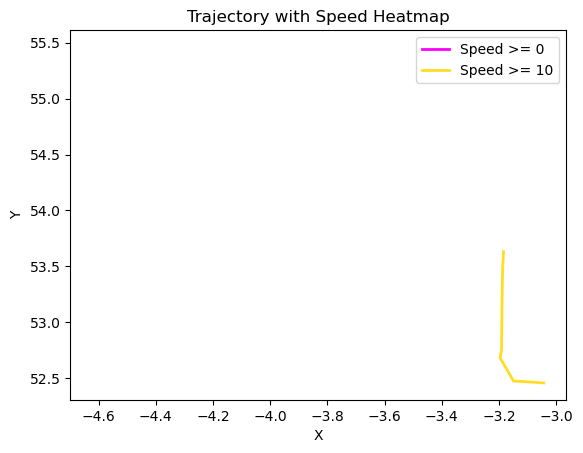

F/V TH0MAS NICOLAS 2
2128     50.351902
2912     50.351902
2352     50.351902
3472     50.351902
3024     50.351902
           ...    
18928    50.725885
15792    50.725885
16240    50.725885
20944    50.725885
16688    50.725885
Name: position_latitude, Length: 194, dtype: float64


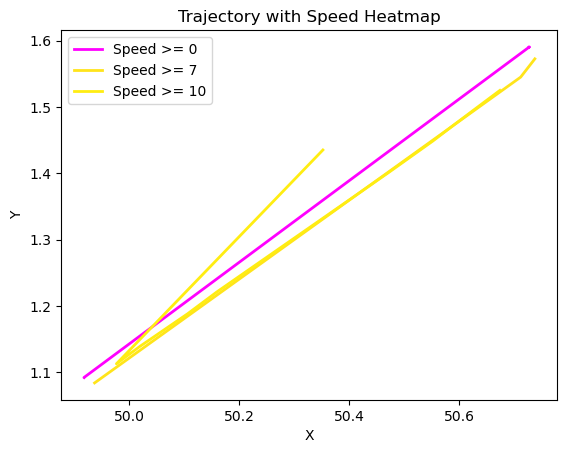

AVEL VAD
5119    -4.61601
4559    -4.61601
7584    -4.61601
7023    -4.61601
3551    -4.61601
          ...   
5007    -4.61601
10159   -4.61601
11615   -4.61601
4895    -4.61601
3103    -4.61601
Name: position_latitude, Length: 194, dtype: float64


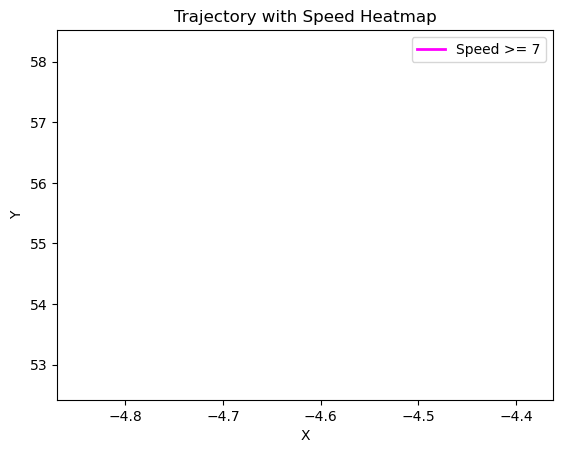

NOTRE DAME CEDEIRA
7910     43.679835
3430     43.679835
11718    43.679835
15974    43.679835
21126    43.679835
           ...    
6118     43.679835
4662     43.679835
17094    43.679835
20790    43.679835
9814     43.679835
Name: position_latitude, Length: 194, dtype: float64


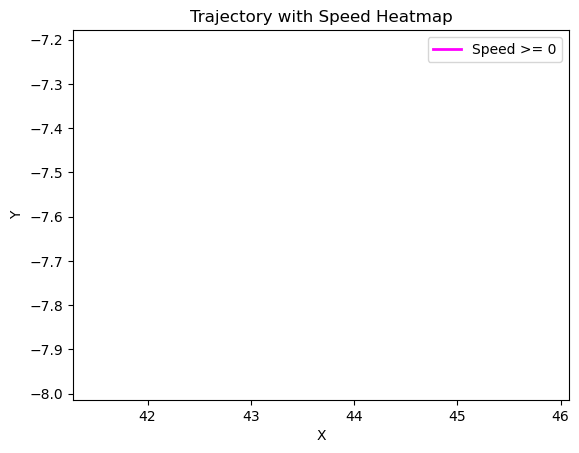

F/V STEMARIELAMERII
212      50.062538
660      50.062538
548      50.062538
436      50.062538
100      50.062538
           ...    
21268    49.972723
21380    49.982907
21492    49.996132
21604    50.004495
21716    50.010063
Name: position_latitude, Length: 194, dtype: float64


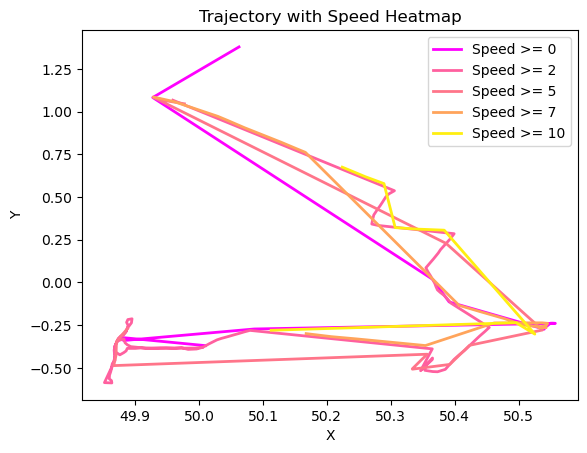

CAP HORIZON
8440     43.401667
2616     43.401667
1496     43.401667
2392     43.401667
152      43.401667
           ...    
21208    43.403055
21320    43.403108
21432    43.403105
21544    43.403067
21656    43.403080
Name: position_latitude, Length: 194, dtype: float64


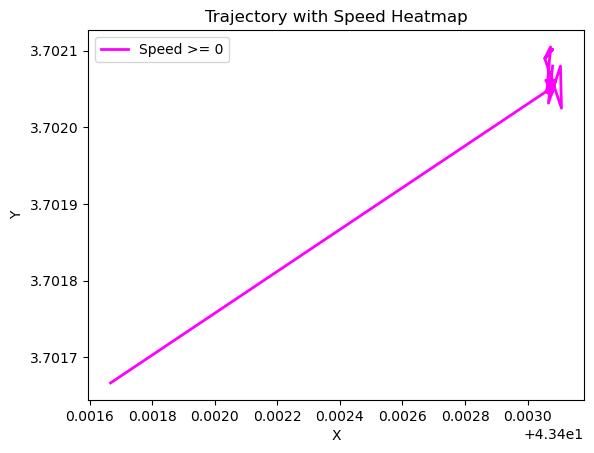

SCAPIRIA 1
3378     43.681505
1810     43.681505
4050     43.681505
578      43.681505
466      43.681505
           ...    
15810    43.656040
14130    43.656040
19170    43.656040
18946    43.656040
16482    43.656040
Name: position_latitude, Length: 194, dtype: float64


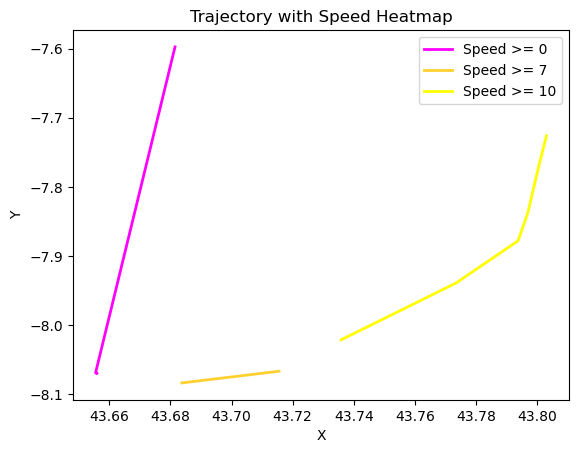

F/V ERIC MARIN
13044    43.404427
11812    43.404427
18196    43.404427
15284    43.404427
5092     43.404427
           ...    
19540    43.404427
21332    43.404427
6996     43.404427
3860     43.404427
8900     43.404427
Name: position_latitude, Length: 194, dtype: float64


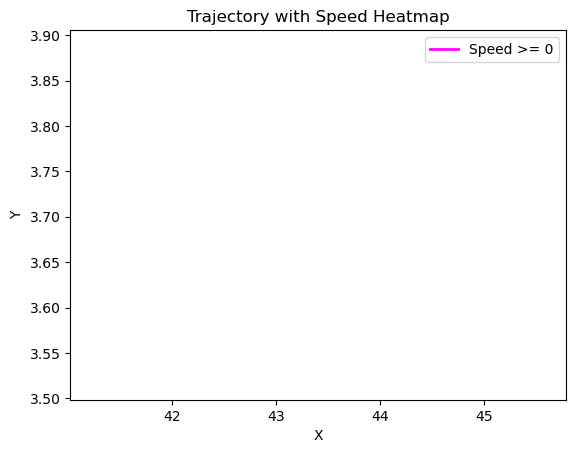

F/V VAUBAN
1163     49.345000
1051     49.345000
603      49.345000
155      49.345000
715      49.345000
           ...    
20987    49.346347
21435    49.346347
21099    49.346347
20427    49.346347
21323    49.346347
Name: position_latitude, Length: 194, dtype: float64


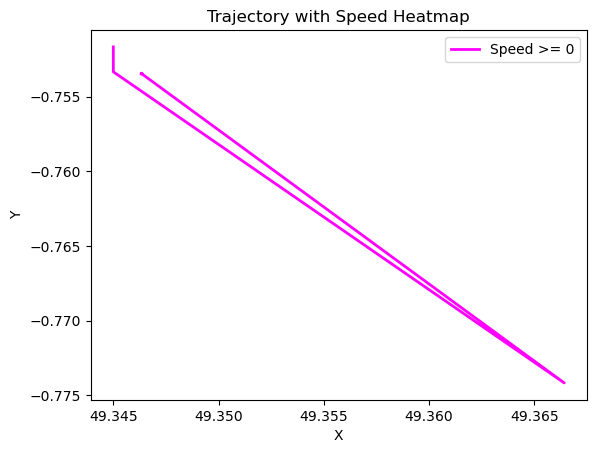

ROSE DE CASCIA
464      49.836320
912      49.836320
1136     49.836320
1024     49.836320
800      49.836320
           ...    
21184    50.723430
21296    50.723433
21408    50.723462
21520    50.723415
21632    50.723470
Name: position_latitude, Length: 194, dtype: float64


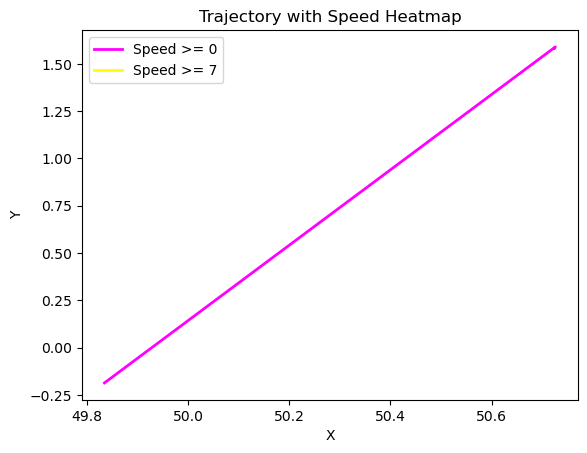

F/V CHRISDERIC2
16069    43.403542
16629    43.403542
8677     43.403542
16181    43.403542
3637     43.403542
           ...    
10133    43.403542
10805    43.403542
1173     43.403542
2069     43.403542
13269    43.403542
Name: position_latitude, Length: 194, dtype: float64


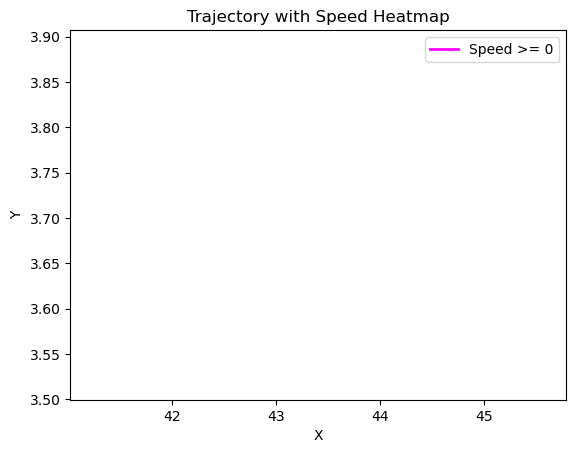

F/V GRAND ST BERNARD
1295     43.32218
11935    43.32218
2975     43.32218
10031    43.32218
15407    43.32218
           ...   
17423    43.32218
6111     43.32218
18319    43.32218
13503    43.32218
13951    43.32218
Name: position_latitude, Length: 194, dtype: float64


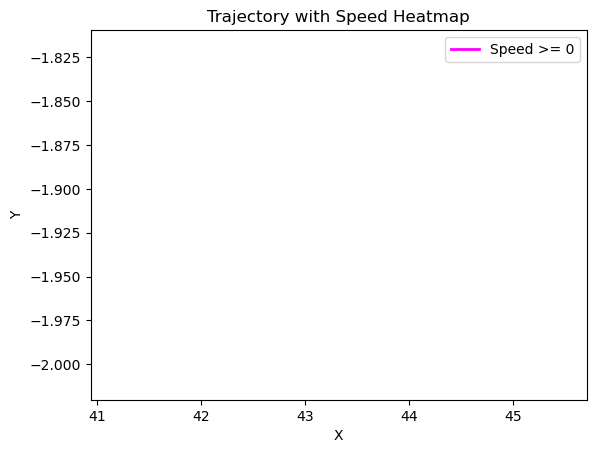

PUNTA VIXIA
9765     42.258372
2485     42.258372
4613     42.258372
18165    42.258372
15701    42.258372
           ...    
1141     42.258372
17493    42.258372
21       42.258372
1365     42.258372
11557    42.258372
Name: position_latitude, Length: 194, dtype: float64


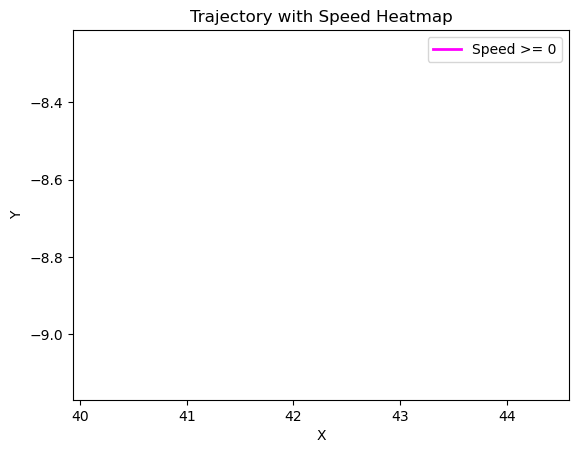

F/V J.M.CHRISTIAN 3
1923     43.399565
3603     43.399565
579      43.399565
18723    43.399565
3715     43.399565
           ...    
12675    43.399565
16931    43.399565
8195     43.399565
2371     43.399565
3491     43.399565
Name: position_latitude, Length: 194, dtype: float64


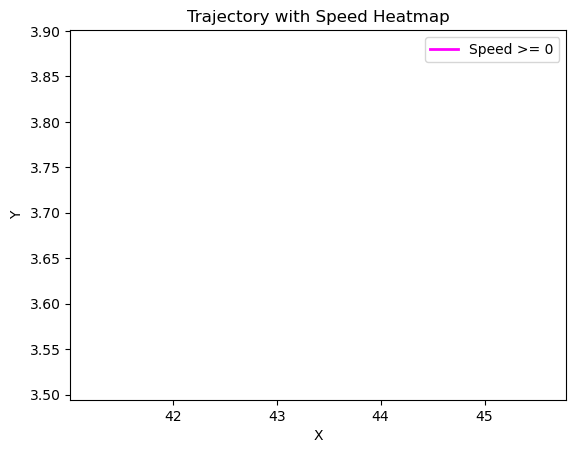

F/V CORONA DEL MAR
3272     14.684228
2040     14.684228
6072     14.684228
5176     14.684228
1144     14.684228
           ...    
21192    14.684775
21304    14.684753
21416    14.684767
21528    14.684745
21640    14.684762
Name: position_latitude, Length: 194, dtype: float64


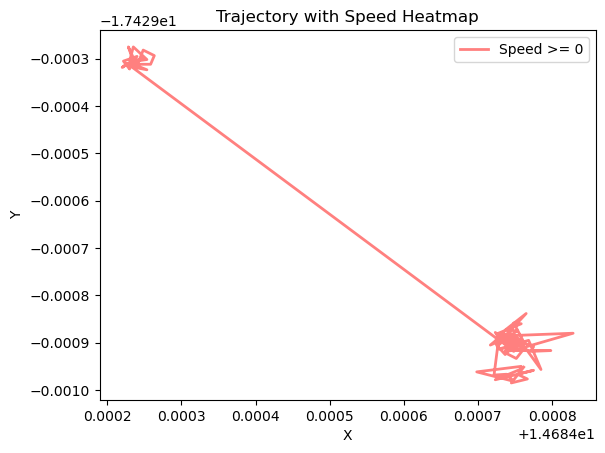

F/V ROSSOREN
1268     52.754833
148      52.754833
3172     52.754833
3284     52.754833
1492     52.754833
           ...    
17172    53.586865
16276    53.586865
17956    53.586865
20084    53.586865
15044    53.586865
Name: position_latitude, Length: 194, dtype: float64


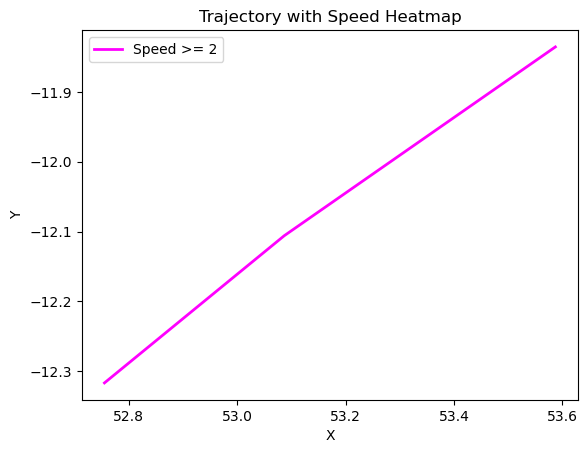

F/V BIKAIN
14591    43.334165
7871     43.334165
13135    43.334165
11119    43.334165
21423    43.334165
           ...    
13807    43.334165
20415    43.334165
16719    43.334165
8879     43.334165
13471    43.334165
Name: position_latitude, Length: 194, dtype: float64


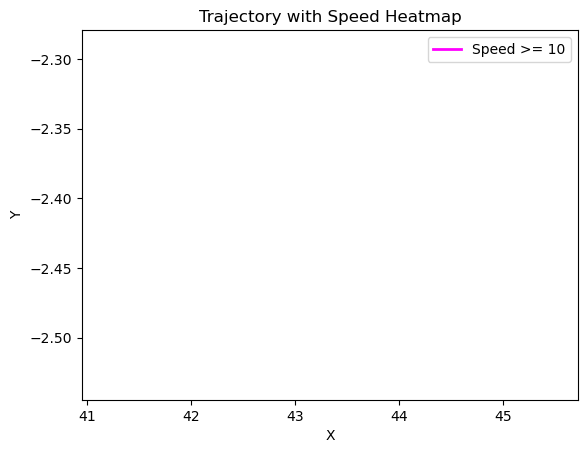

F/V GERARD LUC 4
18003    43.294732
21027    43.294732
4227     43.294732
2099     43.294732
12628    43.294732
           ...    
9267     43.294732
8147     43.294732
5795     43.294732
11843    43.294732
9939     43.294732
Name: position_latitude, Length: 194, dtype: float64


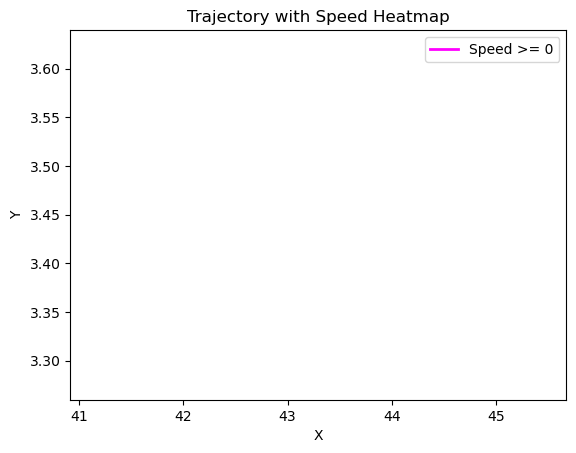

F/V JANVIER GIORDANO
9831     43.400828
20471    43.400828
6135     43.400828
8039     43.400828
10279    43.400828
           ...    
21367    43.400835
21255    43.400835
21703    43.400835
21591    43.400835
21479    43.400835
Name: position_latitude, Length: 194, dtype: float64


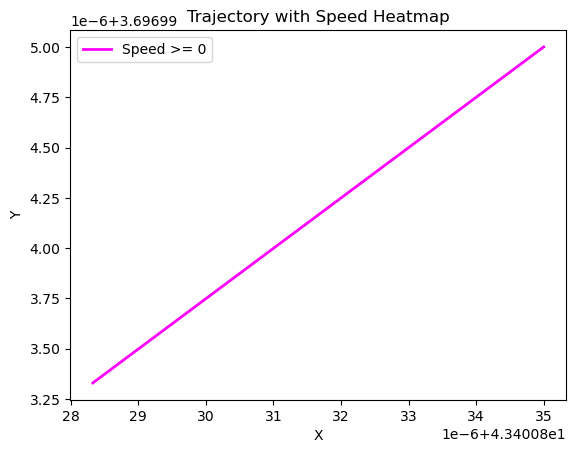

F/V G SAINTE RITA
958      49.547598
1070     49.547598
2302     49.547598
1406     49.547598
286      49.547598
           ...    
21230    50.723503
21342    50.723503
21454    50.723503
21566    50.723503
21678    50.723500
Name: position_latitude, Length: 194, dtype: float64


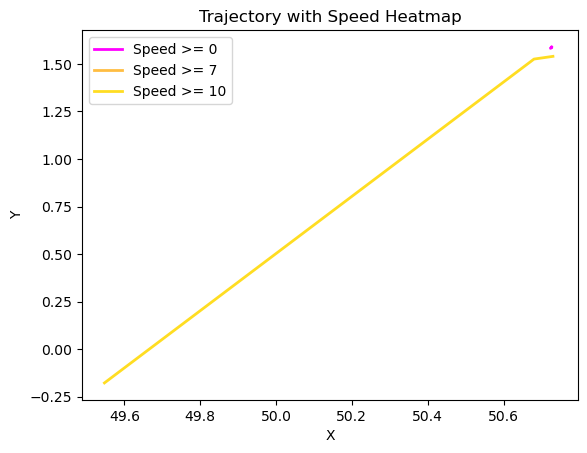

F/V PIER JO SALVADOR
3102     43.403957
4447     43.403957
862      43.403957
4894     43.403957
1870     43.403957
           ...    
21246    43.403928
21358    43.403943
21470    43.403943
21582    43.403962
21694    43.403948
Name: position_latitude, Length: 194, dtype: float64


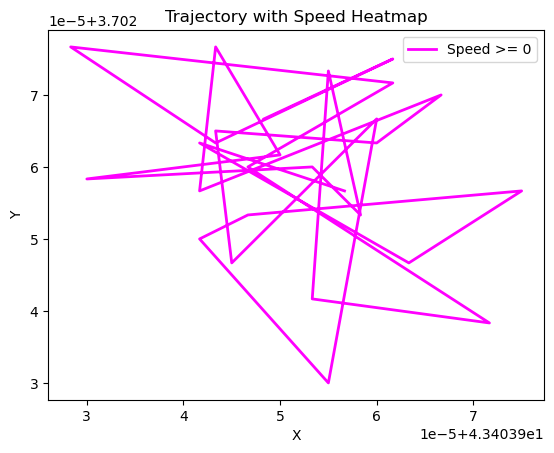

F/V STERENN
6816     14.68533
6928     14.68533
14208    14.68533
9392     14.68533
9280     14.68533
           ...   
11408    14.68533
17904    14.68533
17680    14.68533
8496     14.68533
11520    14.68533
Name: position_latitude, Length: 194, dtype: float64


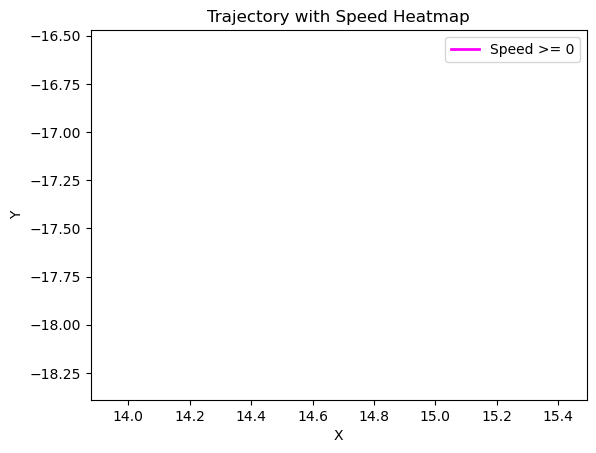

F/V CISBERLANDE 5
4958     43.403590
1374     43.403590
2718     43.403590
1262     43.403590
4846     43.403590
           ...    
21198    43.403627
21310    43.403613
21422    43.403613
21534    43.403615
21646    43.403622
Name: position_latitude, Length: 194, dtype: float64


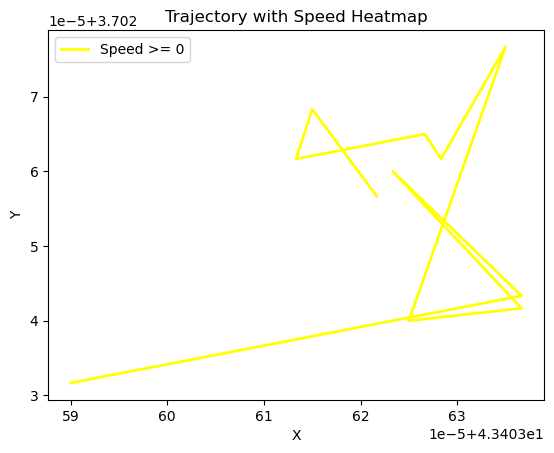

F/VSTSOPHIEFRANCOIS2
19785    43.402593
14745    43.402593
15865    43.402593
12729    43.402593
10937    43.402593
           ...    
1193     43.402593
5113     43.402593
13401    43.402593
13513    43.402593
13625    43.402593
Name: position_latitude, Length: 194, dtype: float64


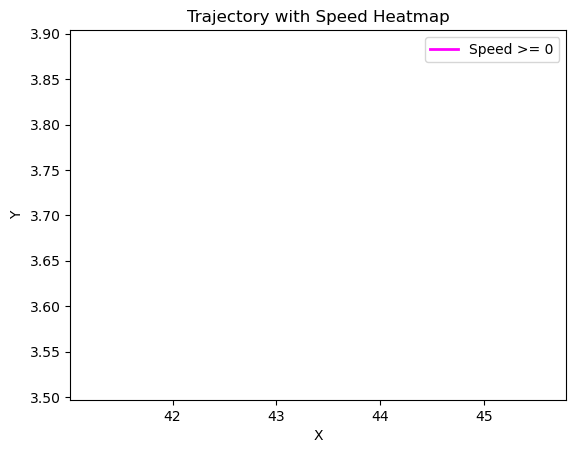

F/V PEPE BARREIRO
194      50.561082
5794     50.561082
1538     50.561082
3778     50.561082
2658     50.561082
           ...    
18786    51.577092
20914    51.577092
20690    51.577092
20242    51.577092
19794    51.577092
Name: position_latitude, Length: 194, dtype: float64


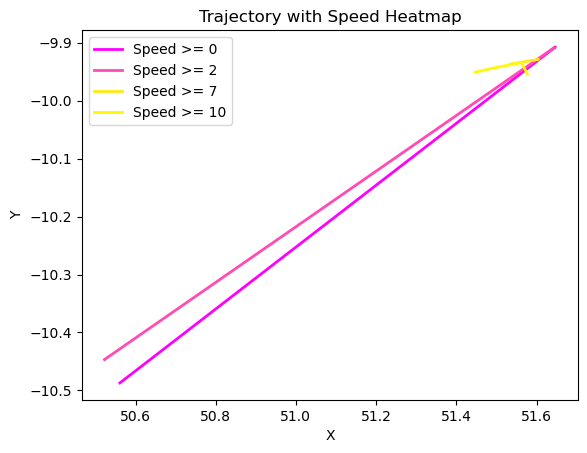

TIGERS III
21151    50.06177
19807    50.06177
13087    50.06177
7487     50.06177
319      50.06177
           ...   
18015    50.06177
11631    50.06177
16783    50.06177
12191    50.06177
19471    50.06177
Name: position_latitude, Length: 194, dtype: float64


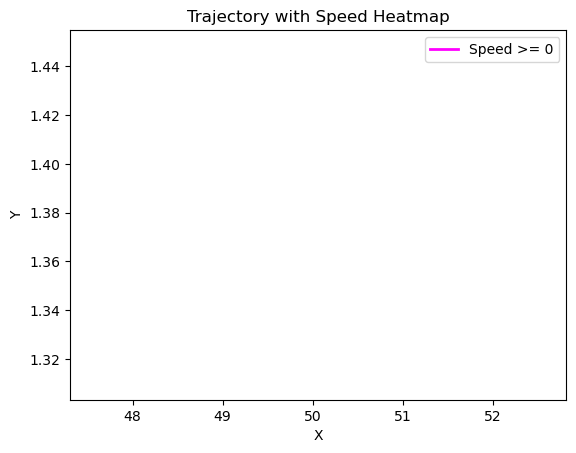

F/V SAINT GOTHARD
6165     51.746657
4709     51.746657
229      51.746657
8517     51.746657
3253     51.746657
           ...    
19157    51.481563
18709    51.481563
19829    51.481563
18821    51.481563
20053    51.481563
Name: position_latitude, Length: 194, dtype: float64


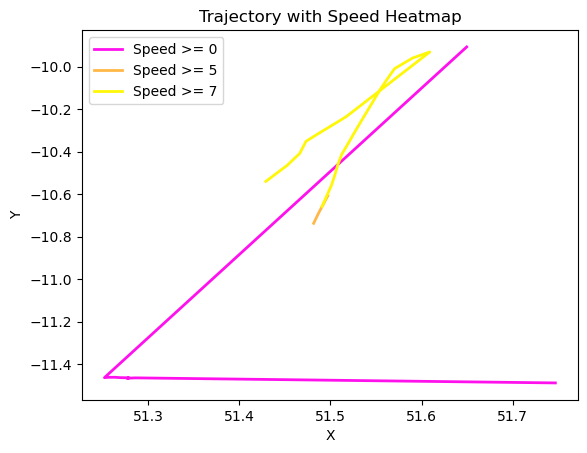

F/V PUENTEAREAS UNO
281      52.948763
1289     52.948763
505      52.948763
2633     52.948763
1401     52.948763
           ...    
20441    52.549390
20777    52.549390
21561    52.549390
20553    52.549390
21337    52.549390
Name: position_latitude, Length: 194, dtype: float64


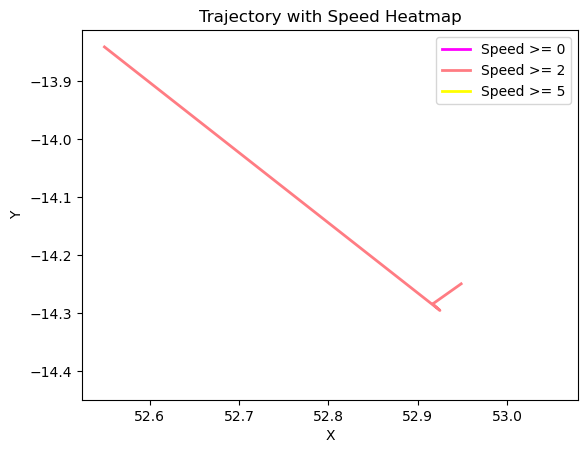

F/V ARGELES
520      52.537592
2424     52.537592
5224     52.537592
296      52.537592
4441     52.537592
           ...    
21240    53.851397
21129    53.851397
21352    53.851397
21576    53.851397
21688    53.851397
Name: position_latitude, Length: 194, dtype: float64


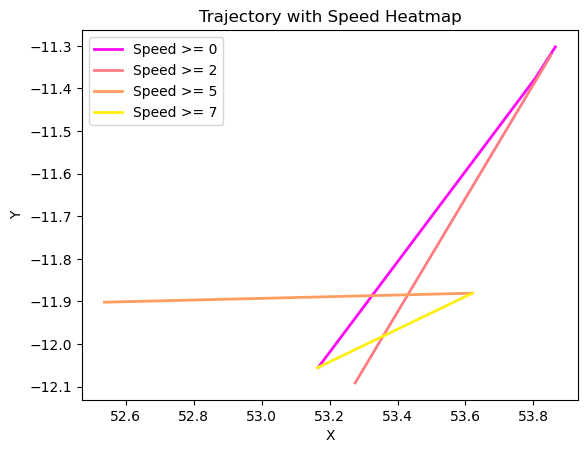

F/V MAR MARES
5272     52.340000
10536    52.340000
1688     52.340000
11320    52.340000
13224    52.340000
           ...    
21624    52.101022
19272    52.101022
17592    52.101022
15576    52.101022
18376    52.101022
Name: position_latitude, Length: 194, dtype: float64


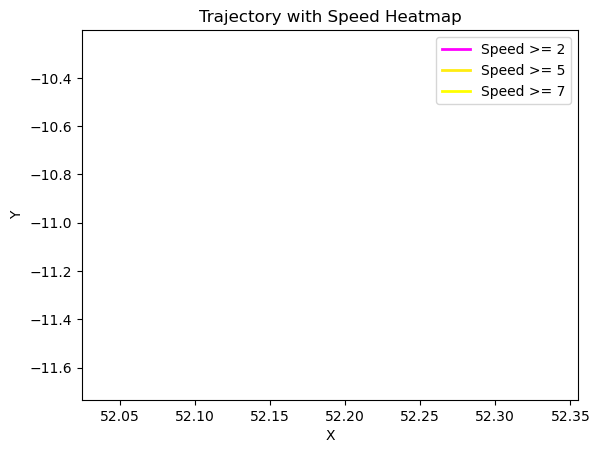

F/V PLAYA DE TUYA
151      54.045703
823      54.045703
375      54.045703
39       54.045703
711      54.045703
           ...    
21095    53.328727
21319    53.328727
19527    53.328727
21543    53.197828
21655    53.197828
Name: position_latitude, Length: 194, dtype: float64


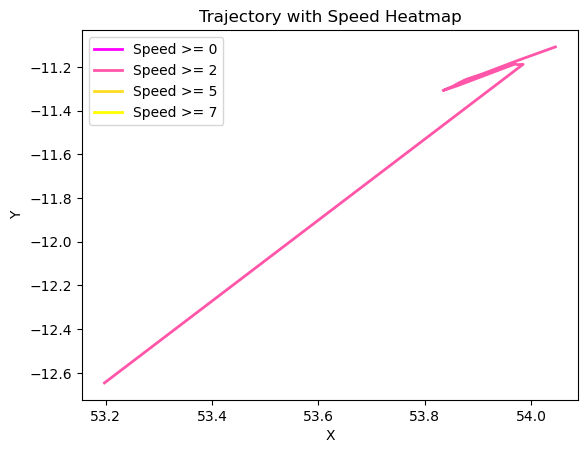

FV/BEOTHUK
8567     51.190952
6999     51.190952
7111     51.190952
4535     51.190952
3415     51.190952
           ...    
21223    51.397687
21559    51.397687
21447    51.397687
21671    51.397687
21335    51.397687
Name: position_latitude, Length: 194, dtype: float64


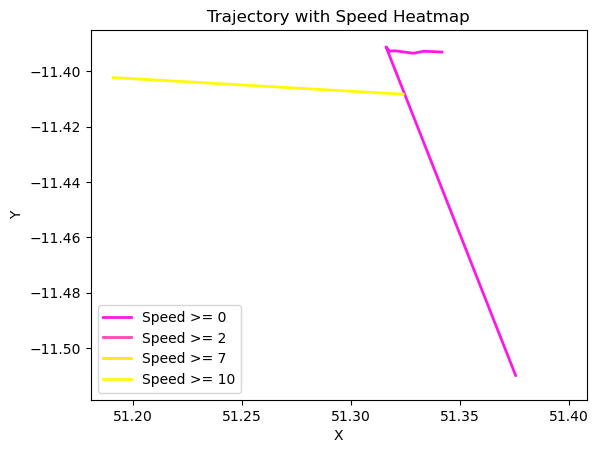

F/V LANDORA
3601     51.433477
3153     51.433477
801      51.433477
1809     51.433477
5393     51.433477
           ...    
18609    51.534623
19617    51.534623
20065    51.534623
17825    51.534623
18945    51.534623
Name: position_latitude, Length: 194, dtype: float64


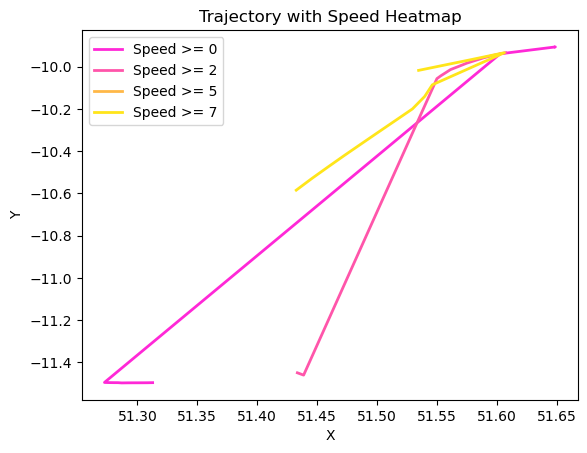

F/V RABELAIS
1512     51.371768
1400     51.371768
2744     51.371768
2632     51.371768
840      51.371768
           ...    
16632    51.336085
19656    51.336085
19880    51.336085
15960    51.336085
15624    51.336085
Name: position_latitude, Length: 194, dtype: float64


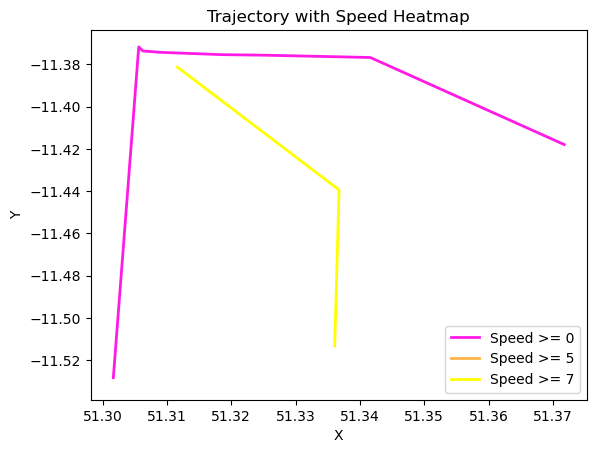

F/V CAP BOJADOR
107      9.125173
219      9.125173
443      9.125173
555      9.125173
331      9.125173
           ...   
21611    4.946552
21163    4.946552
21275    4.946552
21051    4.946552
21723    4.773715
Name: position_latitude, Length: 194, dtype: float64


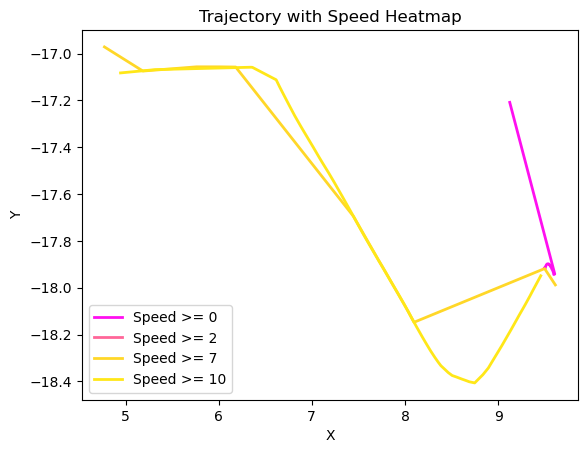

F/V GUEOTEC
246      9.205023
134      9.205023
22       9.205023
358      9.205023
470      9.744057
           ...   
18166    9.562865
20966    9.562865
21302    9.562865
18278    9.562865
20854    9.562865
Name: position_latitude, Length: 194, dtype: float64


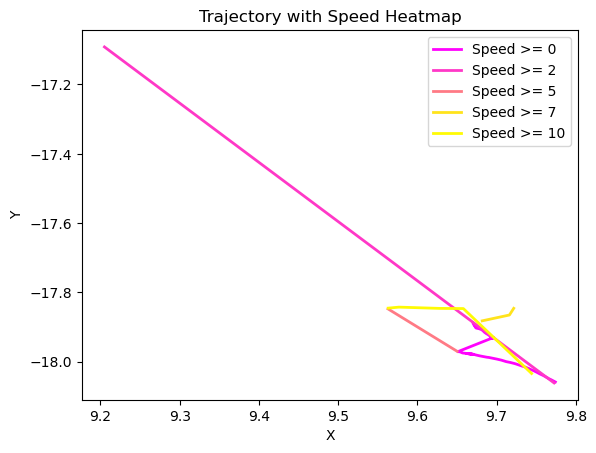

F/V SYLVANNA
1515     60.544587
1067     60.544587
171      60.544587
283      60.544587
1627     60.544587
           ...    
21227    60.259780
21339    60.271527
21451    60.271527
21563    60.278705
21675    60.286835
Name: position_latitude, Length: 194, dtype: float64


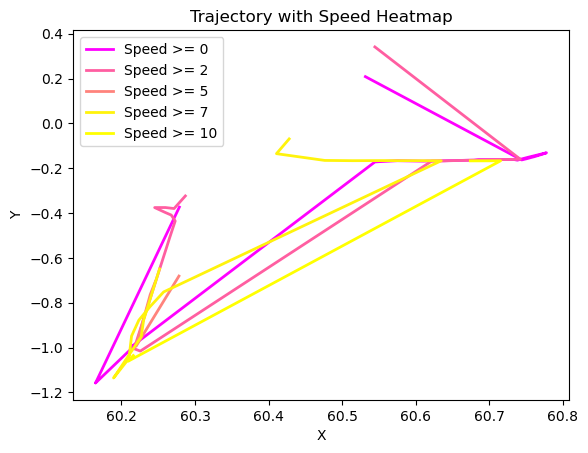

FV FERREIRA MARTINEZ
4327     49.745077
3767     49.745077
4887     49.745077
10711    49.745077
6119     49.745077
           ...    
16759    50.525938
14519    50.525938
14183    50.525938
20455    50.525938
21575    50.525938
Name: position_latitude, Length: 194, dtype: float64


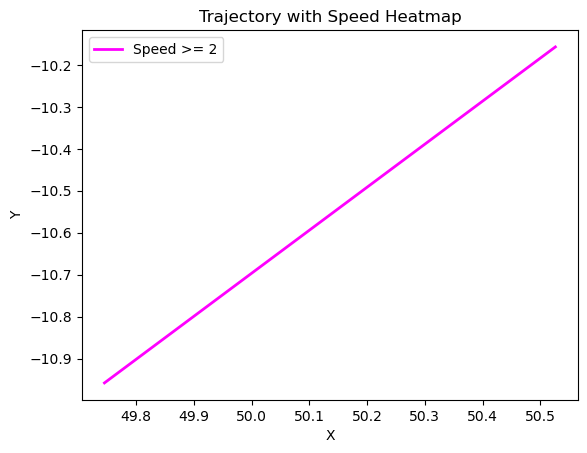

F/V SIEMPRE VIRIATO
26       43.569783
138      43.569783
250      43.569807
362      43.569823
474      43.569772
           ...    
16938    43.569805
18506    43.569805
18730    43.569805
18282    43.569805
19514    43.569805
Name: position_latitude, Length: 194, dtype: float64


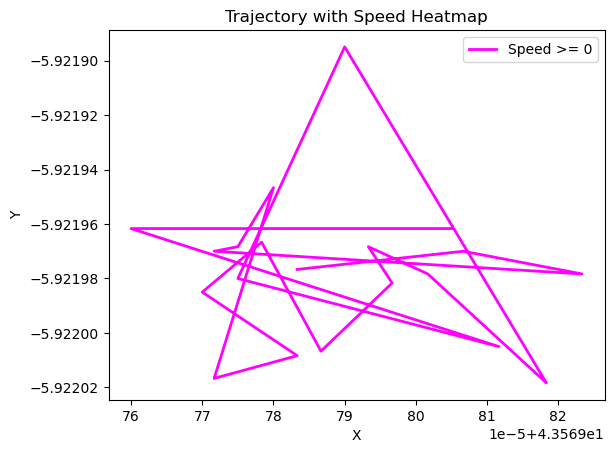

F/V LARCHE
5574     50.456167
1206     50.456167
6918     50.456167
6470     50.456167
10166    50.456167
           ...    
21254    50.723833
21366    50.723833
21478    50.723833
21590    50.723833
21702    50.723833
Name: position_latitude, Length: 194, dtype: float64


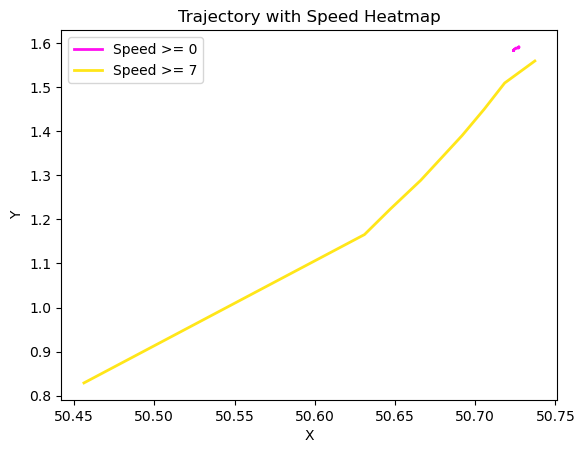

F/V MELODIE
5037     51.494302
7837     51.494302
2573     51.494302
3133     51.494302
7725     51.494302
           ...    
20717    51.296397
19933    51.296397
20381    51.296397
21613    51.346780
21725    51.346780
Name: position_latitude, Length: 194, dtype: float64


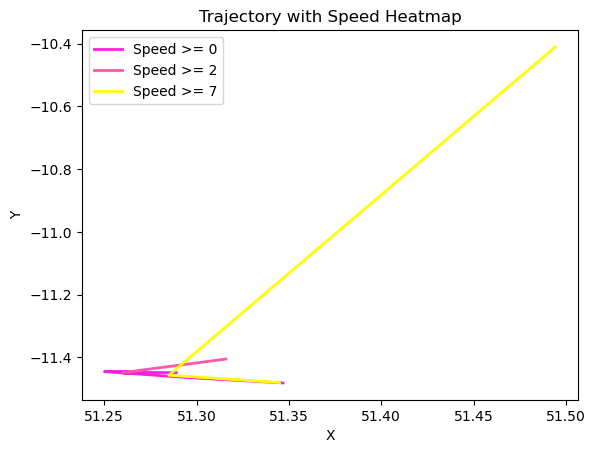

F/V LOIRA
2614     42.231115
2390     42.231115
38       42.231115
4406     42.231115
374      42.231115
           ...    
13590    42.231127
21542    42.231127
21430    42.231127
11686    42.231127
11574    42.231127
Name: position_latitude, Length: 194, dtype: float64


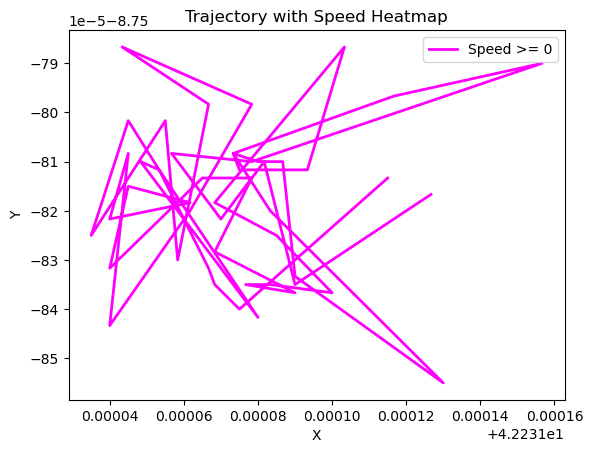

F/V ANTONIO MARIA
1547     58.612692
5579     58.612692
763      58.612692
3899     58.612692
427      58.612692
           ...    
18459    60.250822
19355    60.250822
19019    60.250822
21259    60.250822
20587    60.250822
Name: position_latitude, Length: 194, dtype: float64


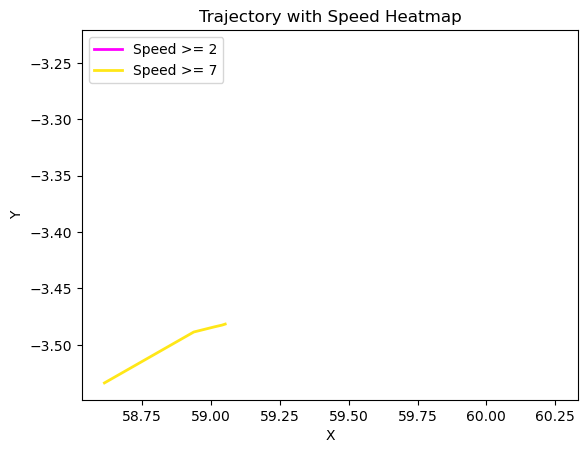

F/V CUCA
536      60.629035
1320     60.629035
984      60.629035
88       60.629035
312      60.629035
           ...    
20360    60.652320
21368    60.556642
21592    60.556642
21480    60.556642
21704    60.556642
Name: position_latitude, Length: 194, dtype: float64


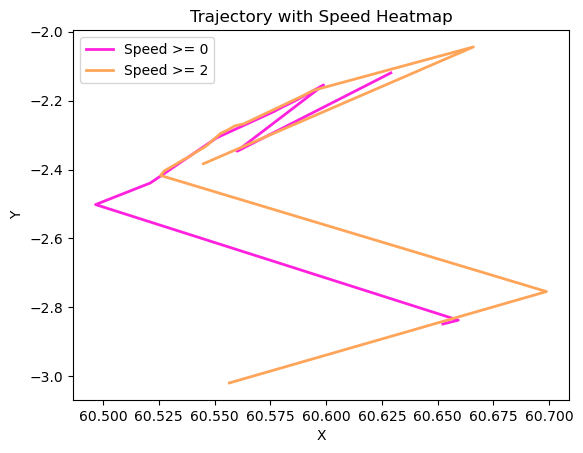

F/V GURE ANDRE
16596    42.800027
916      42.800027
9540     42.800027
692      42.800027
2484     42.800027
           ...    
4724     42.800027
3828     42.800027
21076    42.800027
9764     42.800027
2596     42.800027
Name: position_latitude, Length: 194, dtype: float64


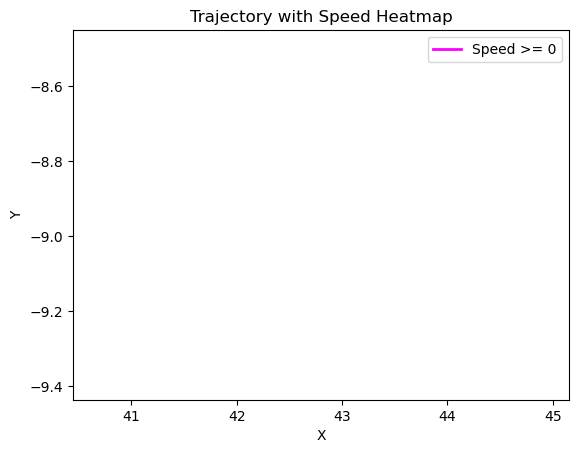

F/V ANNE ANTOINE 2
4658     43.400325
2754     43.400325
290      43.400325
4322     43.400325
738      43.400325
           ...    
15410    43.400330
13730    43.400330
12386    43.400330
13618    43.400330
19778    43.400330
Name: position_latitude, Length: 194, dtype: float64


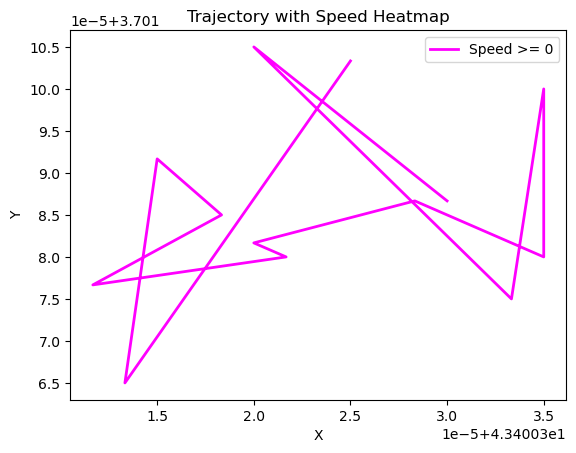

F/V LE RESSAC
2396     49.769508
1276     49.769508
1612     49.769508
940      49.769508
380      49.769508
           ...    
21212    45.597995
21324    45.523685
21436    45.464523
21548    45.462233
21660    45.462233
Name: position_latitude, Length: 194, dtype: float64


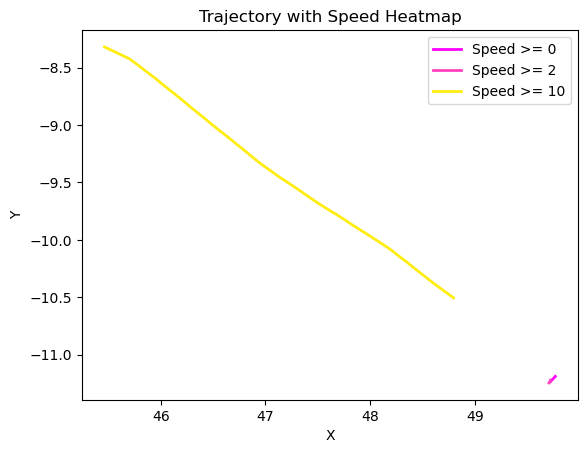

F/V R0NSARD
214      49.003715
886      49.003715
1222     49.003715
998      49.003715
326      49.003715
           ...    
21494    51.644960
17014    51.644960
18358    51.644960
21718    51.644960
20934    51.644960
Name: position_latitude, Length: 194, dtype: float64


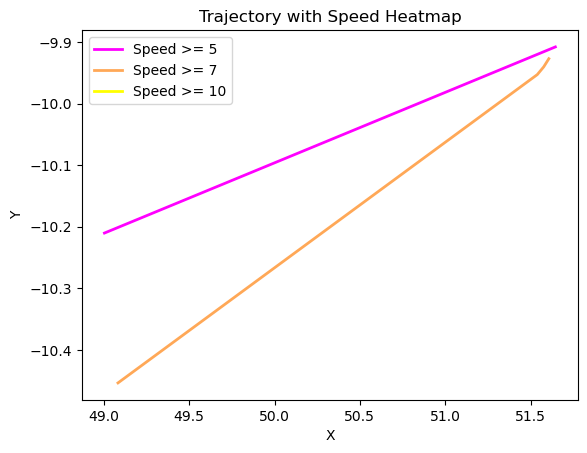

F/V LE CROTELLOIS
1537     50.531713
193      50.531713
81       50.531713
977      50.531713
417      50.531713
           ...    
21249    50.061638
21361    50.061618
21473    50.061672
21585    50.061620
21697    50.061615
Name: position_latitude, Length: 194, dtype: float64


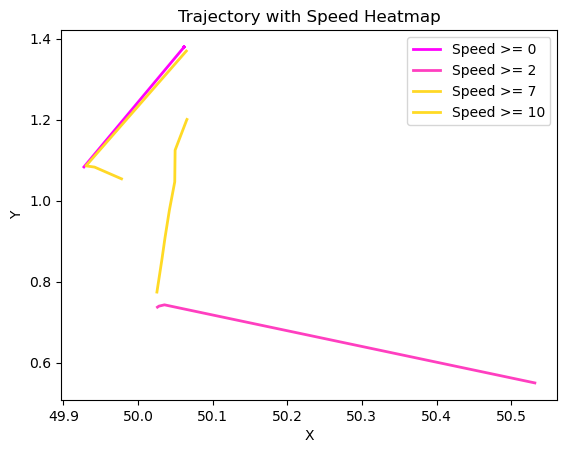

F/V YANNICK
6172     51.309705
8300     51.309705
6956     51.309705
7740     51.309705
4380     51.309705
           ...    
21180    51.880063
21292    51.856545
21404    51.834153
21516    51.810807
21628    51.786900
Name: position_latitude, Length: 194, dtype: float64


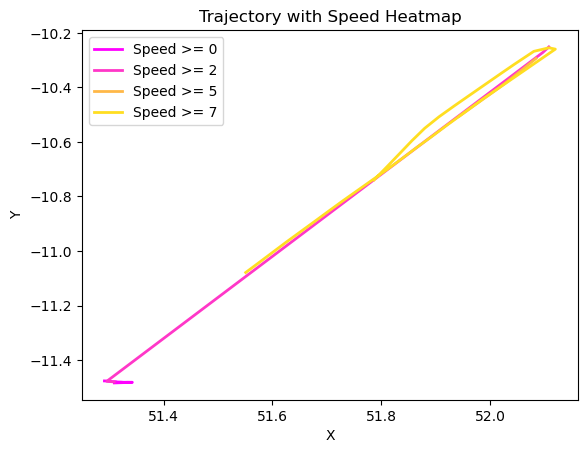

BRESSAY-BANK PAIR TR
473      61.686193
249      61.686193
137      61.686193
361      61.686193
697      61.686193
           ...    
21193    61.735527
21417    61.735527
21305    61.735527
21529    61.735527
21641    61.735527
Name: position_latitude, Length: 194, dtype: float64


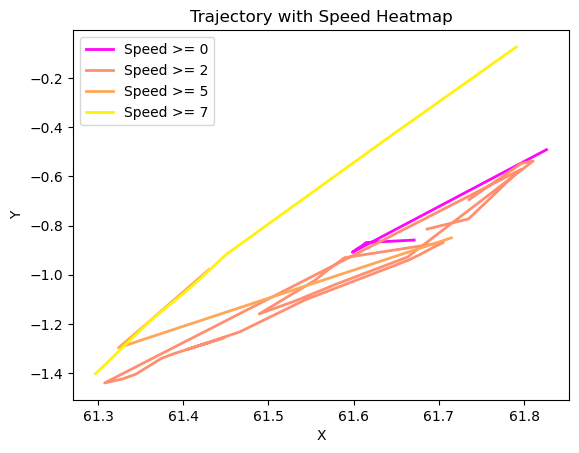

CAP SAINT GEORGES
50       61.636562
162      61.636562
386      61.636562
274      61.636562
498      61.636562
           ...    
21218    57.670363
21330    57.665848
21442    57.664508
21554    57.665725
21666    57.667018
Name: position_latitude, Length: 194, dtype: float64


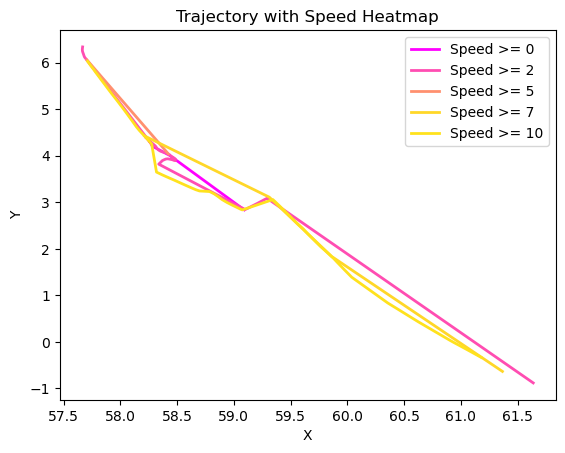

F/V LE STIFF
3449     43.352687
1433     43.352687
2217     43.352687
5353     43.352687
2441     43.352687
           ...    
14873    43.352677
9049     43.352677
18121    43.352677
10393    43.352677
17673    43.352677
Name: position_latitude, Length: 194, dtype: float64


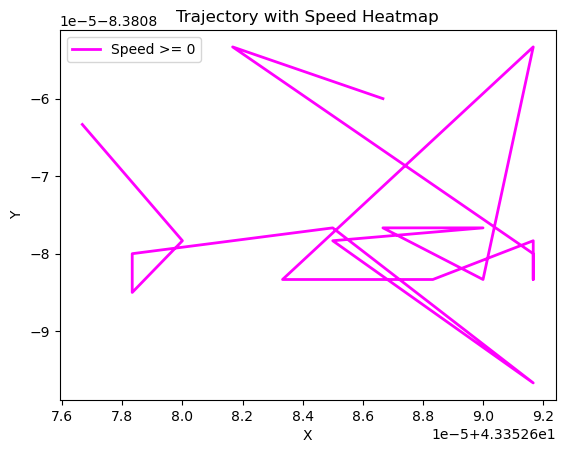

F/V SILURE
11991    43.680747
2471     43.680747
14455    43.680747
5831     43.680747
4152     43.680747
           ...    
21399    44.222570
21623    44.222570
21511    44.222570
21287    44.222570
21175    44.222570
Name: position_latitude, Length: 194, dtype: float64


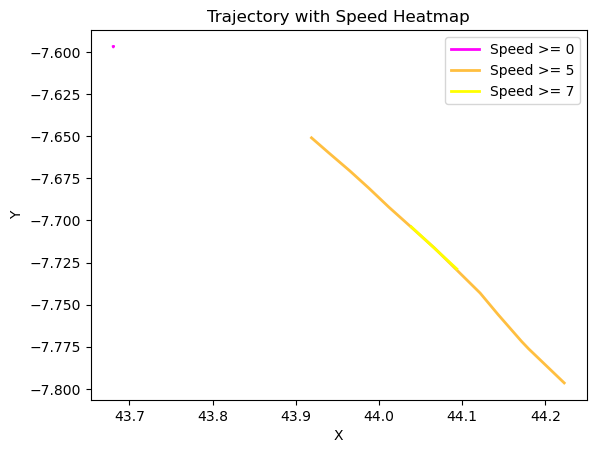

F/V CROIX MORAND
943      51.646270
1503     51.646270
3967     51.646270
1727     51.646270
3183     51.646270
           ...    
16399    51.301825
15279    51.301825
19983    51.301825
19647    51.301825
20991    51.301825
Name: position_latitude, Length: 194, dtype: float64


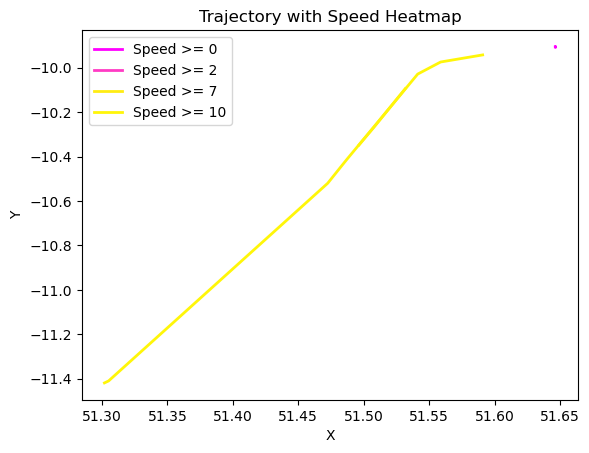

F/V RADOCHE TERCERO
227      51.496547
787      51.496547
115      51.496547
3        51.496547
675      51.496547
           ...    
21171    51.309502
21395    51.309502
21283    51.309502
21507    51.295080
21619    51.295080
Name: position_latitude, Length: 194, dtype: float64


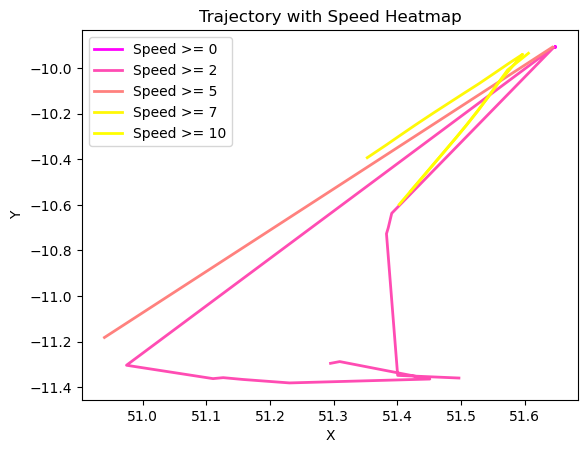

F/V FASTNET
369      53.187485
593      53.187485
145      53.187485
257      53.187485
33       53.187485
           ...    
20193    52.100453
21089    52.100453
20641    52.100453
20081    52.100453
21425    52.100453
Name: position_latitude, Length: 194, dtype: float64


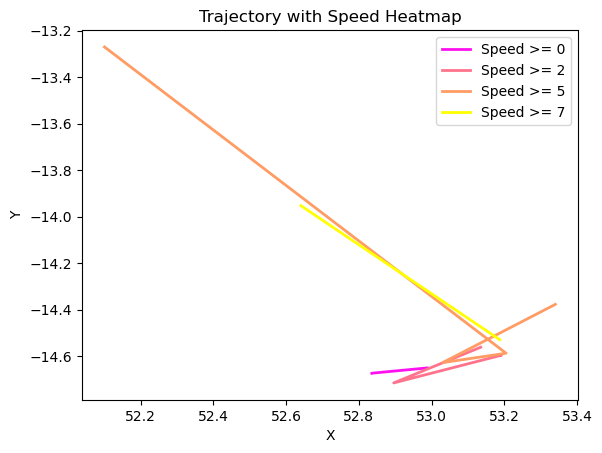

F/V CARLA
1050     43.657252
5306     43.657252
3738     43.657252
1835     43.657252
2058     43.657252
           ...    
19194    47.628400
13258    47.628400
21210    47.628400
18858    47.628400
13370    47.628400
Name: position_latitude, Length: 194, dtype: float64


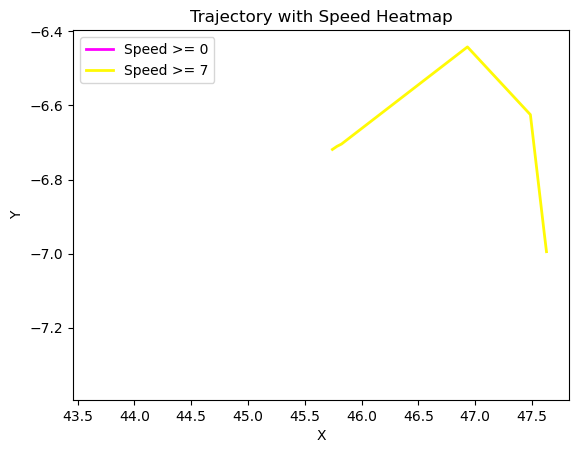

F/V ARMOR II
1174     50.990838
166      50.990838
1734     50.990838
726      50.990838
614      50.990838
           ...    
18310    50.911542
17638    50.911542
18646    50.911542
21558    50.911542
18758    50.911542
Name: position_latitude, Length: 194, dtype: float64


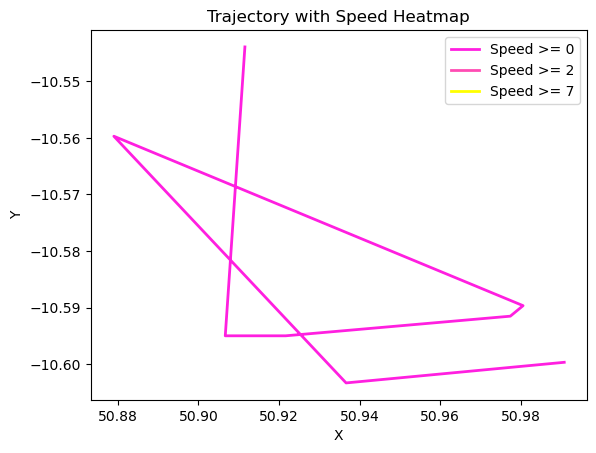

F/V M. LE ROCH 2
29       57.510192
477      57.510192
365      57.510192
589      57.510192
141      57.510192
           ...    
21533    57.953898
21421    57.953898
21309    57.953898
21197    57.953898
21645    57.973918
Name: position_latitude, Length: 194, dtype: float64


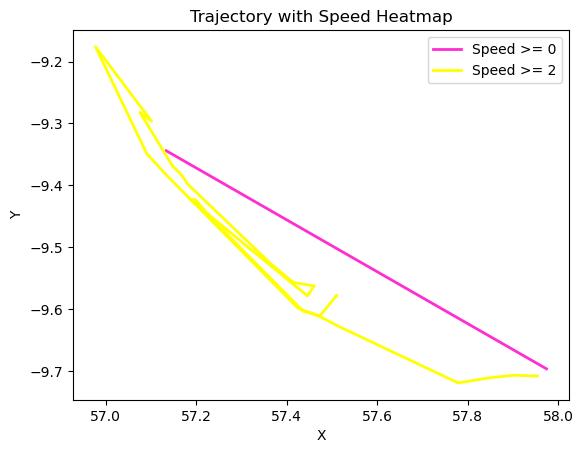

SCOMBRUS
309      56.906442
197      56.906442
421      56.906442
85       56.906442
533      57.290118
           ...    
21253    53.247445
21365    53.205827
21477    53.151448
21589    53.113488
21701    53.088313
Name: position_latitude, Length: 194, dtype: float64


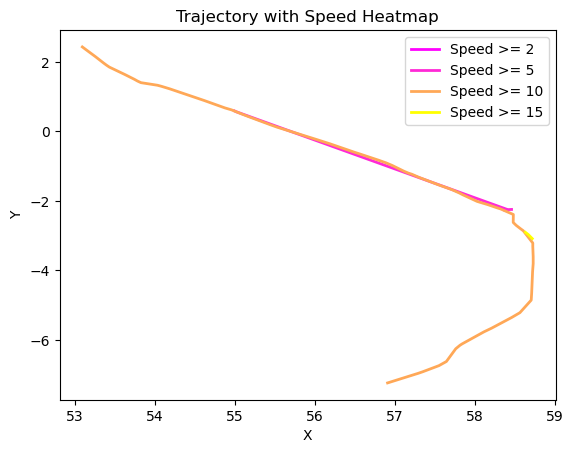

F/V JP LE ROCH
149      58.542457
485      58.542457
373      58.542457
261      58.542457
37       58.542457
           ...    
21205    57.849158
21541    57.812455
21317    57.812455
21653    57.812455
21429    57.812455
Name: position_latitude, Length: 194, dtype: float64


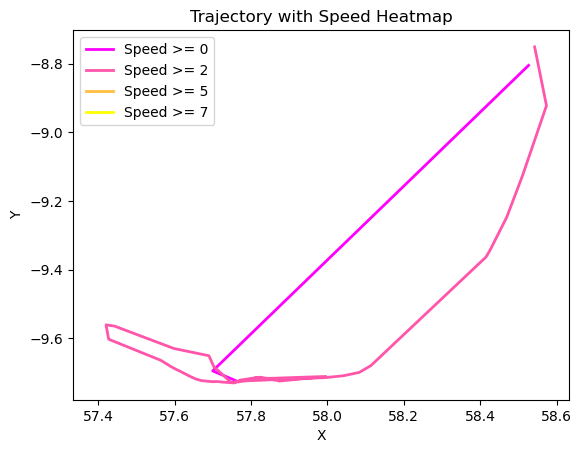

F/V LAPALOMA II
125      51.246000
13       51.246000
909      51.246000
797      51.246000
1917     51.246000
           ...    
21181    49.748970
21293    49.748970
21405    49.748970
21517    49.744273
21629    49.744273
Name: position_latitude, Length: 194, dtype: float64


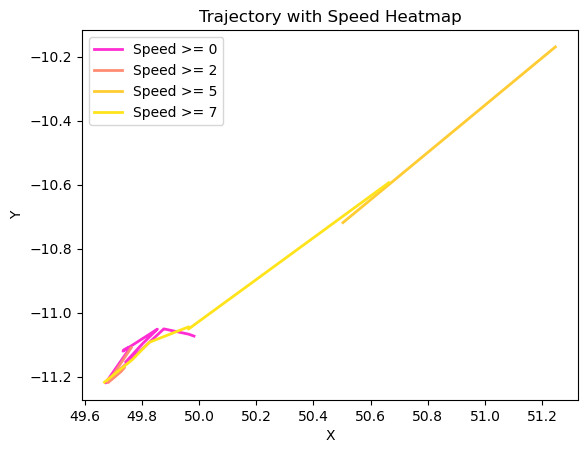

F/V GEVRED
289     -15.928333
177     -15.928333
65      -15.928333
513     -15.933315
1745    -15.933315
           ...    
21345   -16.304172
21233   -16.304172
21457   -16.333857
21681   -16.333857
21569   -16.333857
Name: position_latitude, Length: 194, dtype: float64


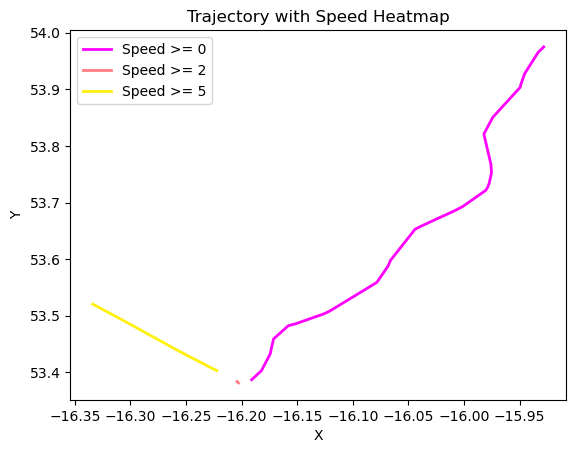

F\V LUDOVIC GEOFFRAY
799      49.981300
2815     49.981300
15       49.981300
2367     49.981300
1359     49.981300
           ...    
21519    50.101768
21183    50.101768
21295    50.101768
21407    50.101768
21631    50.101768
Name: position_latitude, Length: 194, dtype: float64


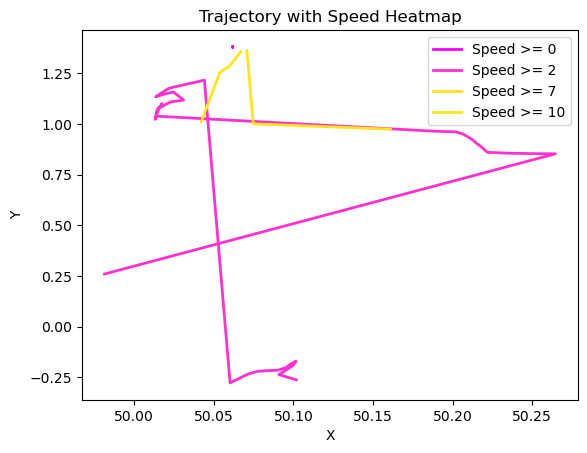

F/V FARO PICAMILLO
101      49.841455
213      49.841455
325      49.812532
437      49.799738
549      49.798887
           ...    
21269    45.091947
21381    45.045657
21493    45.002475
21605    44.946563
21717    44.906738
Name: position_latitude, Length: 194, dtype: float64


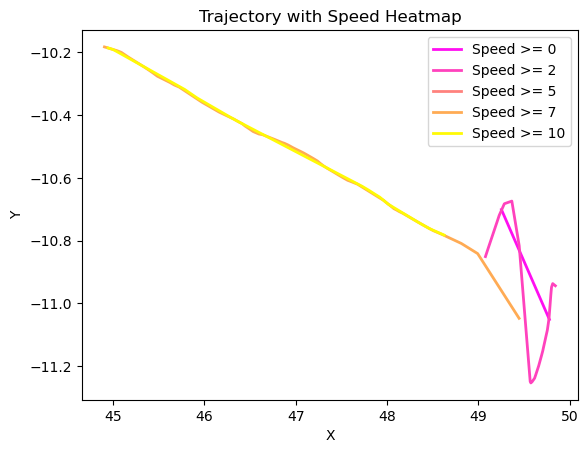

F/V CAP FINISTERE
74       49.734237
186      49.734237
298      49.726507
410      49.722527
522      49.720810
           ...    
21242    49.728500
21466    49.737393
21578    49.737393
21354    49.737393
21690    49.737393
Name: position_latitude, Length: 194, dtype: float64


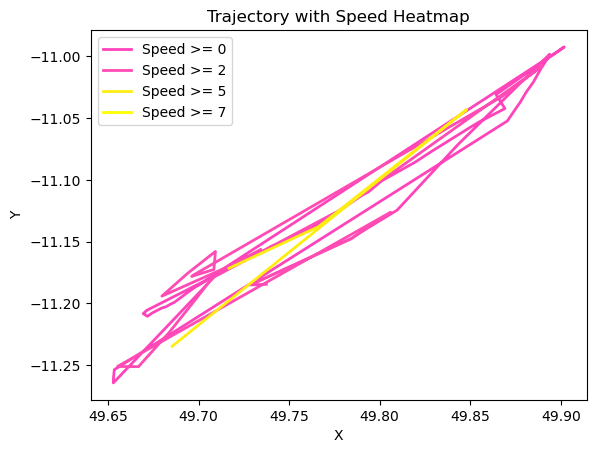

F/V NAONED
123      47.714543
11       47.714543
235      47.712087
347      47.712347
459      47.712785
           ...    
21067    47.446547
21291    47.386990
21515    47.401330
21403    47.401330
21627    47.437868
Name: position_latitude, Length: 194, dtype: float64


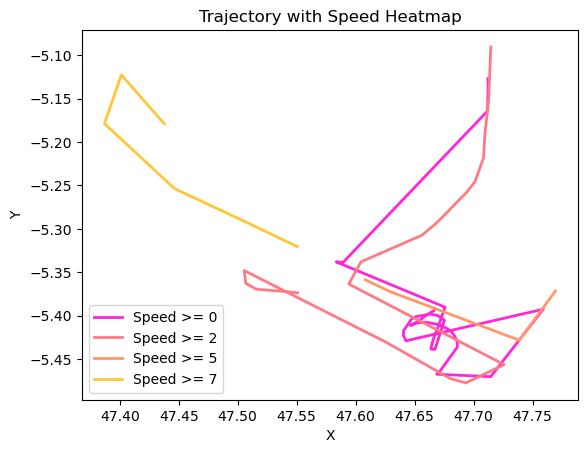

F/V VENT DU NORD II
99       43.354990
211      43.354990
435      43.354962
323      43.354962
547      43.354955
           ...    
21267    43.354997
21379    43.354970
21491    43.355073
21603    43.355013
21715    43.354983
Name: position_latitude, Length: 194, dtype: float64


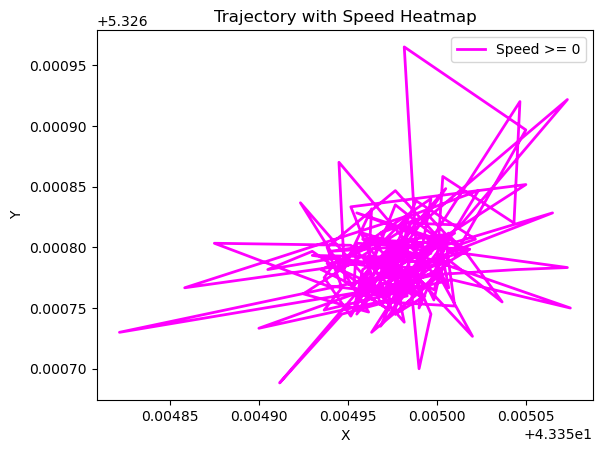

F/V PEDRA BLANCA II
105      49.491723
217      49.491723
441      49.490330
329      49.490330
553      49.489695
           ...    
21273    48.985283
21385    48.972782
21609    48.958707
21497    48.958707
21721    48.921653
Name: position_latitude, Length: 194, dtype: float64


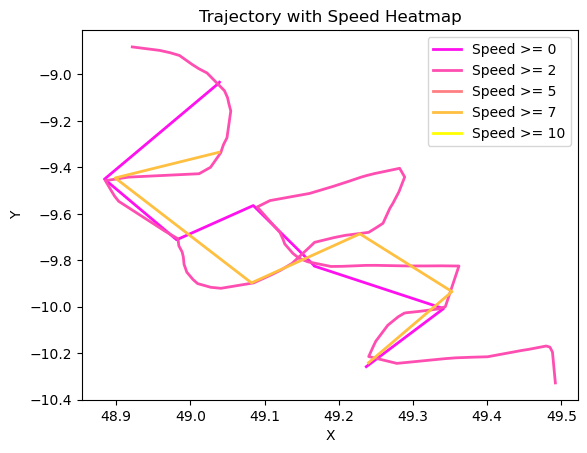

F/V MAR DE FLORES
192      49.879408
80       49.879408
304      49.876067
416      49.875083
528      49.875083
           ...    
21248    46.880602
21360    46.819510
21472    46.775712
21584    46.765013
21696    46.736928
Name: position_latitude, Length: 194, dtype: float64


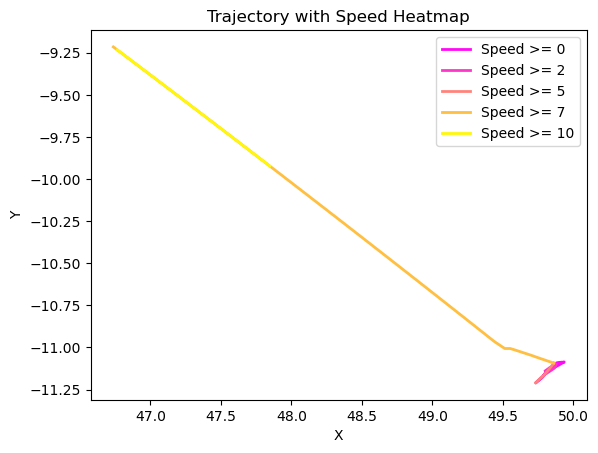

F/V IBARDIN
34       49.722808
146      49.722808
258      49.717288
370      49.712108
482      49.712108
           ...    
21202    49.736125
21538    49.736125
21650    49.736125
21426    49.736125
21314    49.736125
Name: position_latitude, Length: 194, dtype: float64


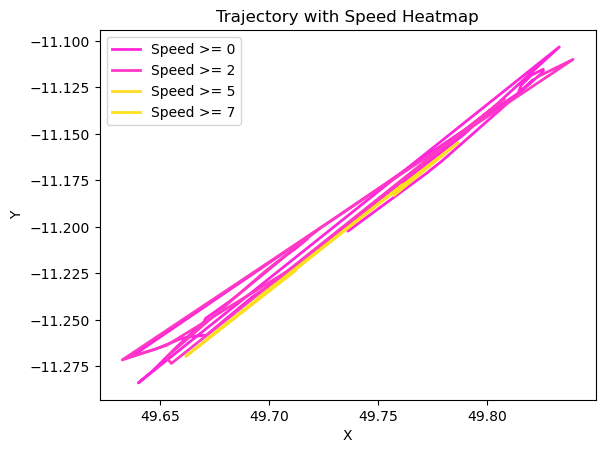

F/V AGORRETA
111      49.028753
223      49.028753
335      49.024250
447      49.020278
559      49.020278
           ...    
21279    47.074893
21391    47.021402
21615    46.966392
21503    46.966392
21727    46.925327
Name: position_latitude, Length: 194, dtype: float64


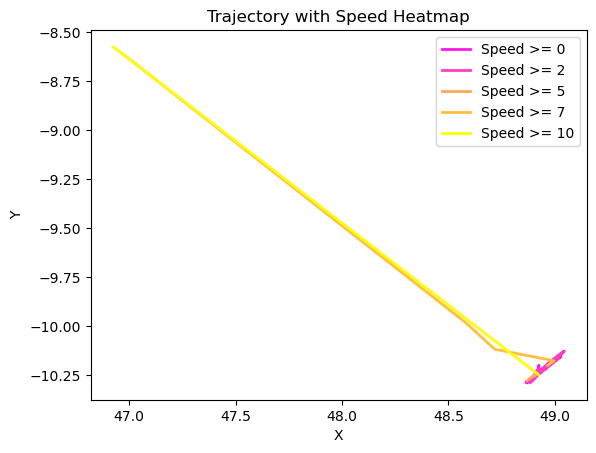

F/V LA TRINITE
116      50.626320
4        50.626320
228      50.613213
340      50.591702
452      50.586020
           ...    
21172    50.725515
21284    50.725510
21396    50.725517
21508    50.725537
21620    50.725488
Name: position_latitude, Length: 194, dtype: float64


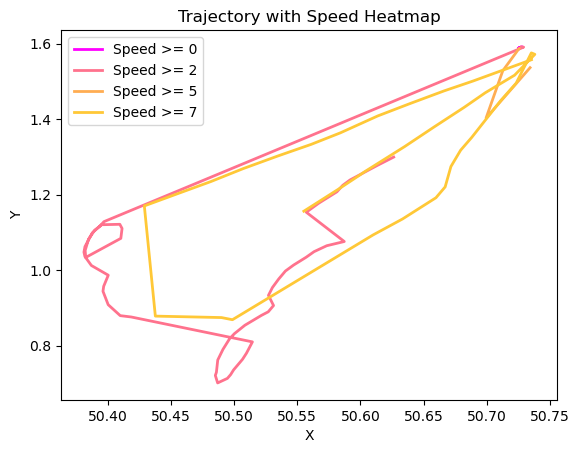

F/V MEABAN
176      49.168203
64       49.168203
288      49.164772
400      49.164772
512      49.156528
           ...    
21232    49.282738
21344    49.279832
21456    49.277063
21568    49.276675
21680    49.269995
Name: position_latitude, Length: 194, dtype: float64


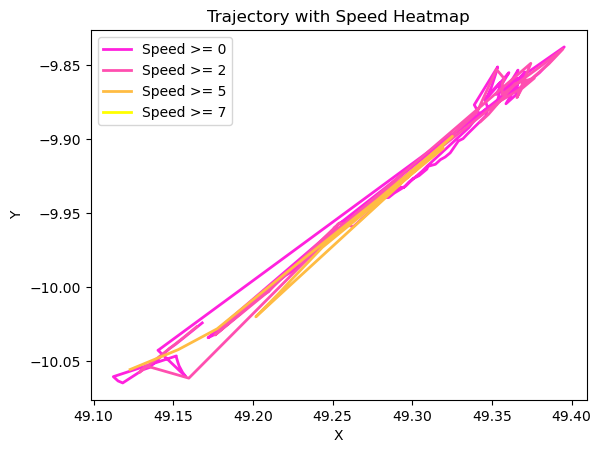

F/V EMERAUDE
113      53.795917
1        53.795917
225      53.857963
337      53.924003
449      54.007778
           ...    
21169    62.495127
21281    62.539545
21393    62.597543
21505    62.652342
21617    62.706675
Name: position_latitude, Length: 194, dtype: float64


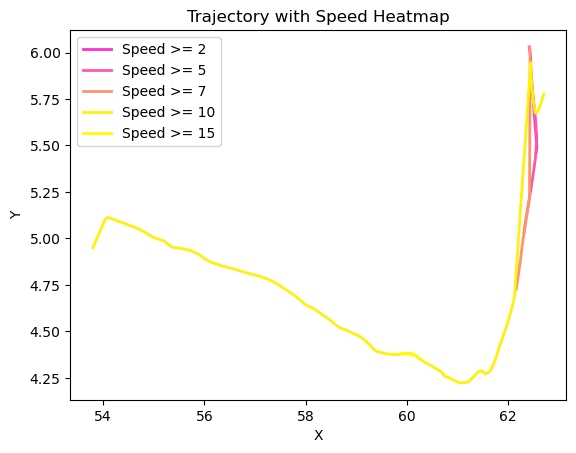

CAP ST MARIE
269     -4.616507
45      -4.616507
157     -4.616507
381     -4.616462
493     -4.616488
           ...   
20877   -4.617455
21437   -4.617455
20429   -4.617455
21661   -4.617515
21549   -4.617515
Name: position_latitude, Length: 194, dtype: float64


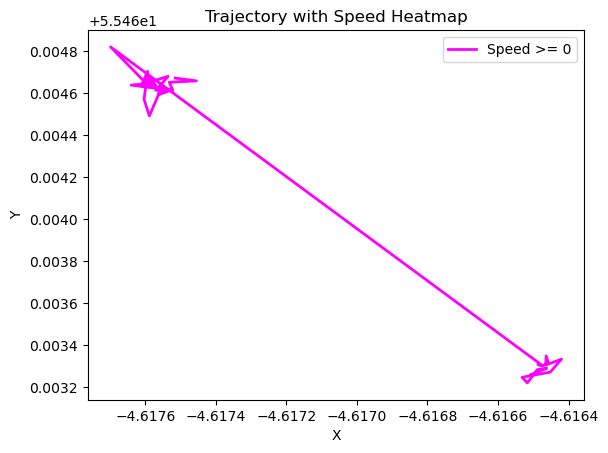

F/V NICOLAS JEREMY
204      51.397583
92       51.397583
316      51.398267
428      51.398050
540      51.395650
           ...    
21260    50.727083
21372    50.727083
21484    50.727067
21596    50.727067
21708    50.727083
Name: position_latitude, Length: 194, dtype: float64


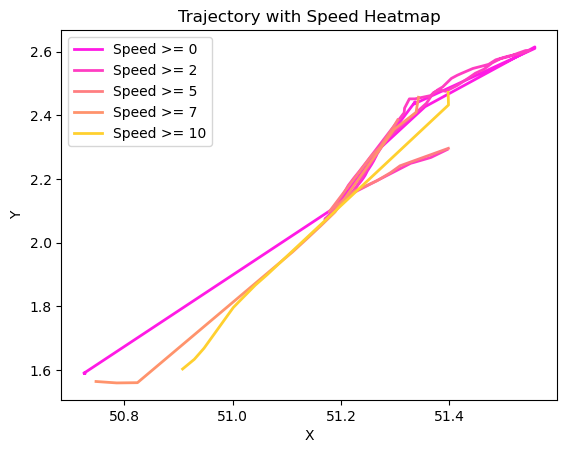

LE DOLMEN
48       47.710522
160      47.710522
272      47.709098
384      47.709673
496      47.709840
           ...    
21216    47.424237
21328    47.401310
21440    47.407520
21552    47.407520
21664    47.422953
Name: position_latitude, Length: 194, dtype: float64


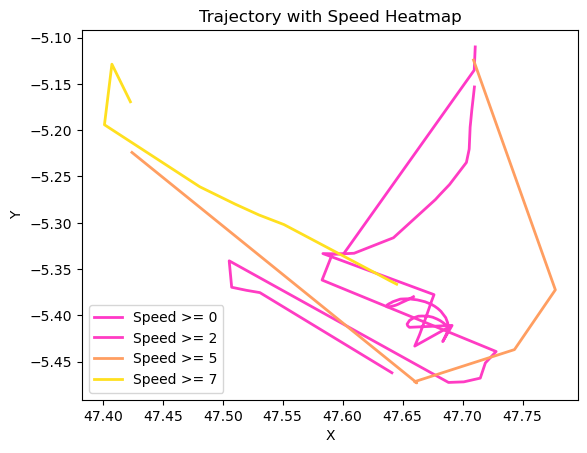

F/V MERCATOR
98       50.441930
210      50.441930
322      50.449657
434      50.456347
546      50.463935
           ...    
21266    50.723670
21378    50.723657
21490    50.723667
21602    50.723675
21714    50.723692
Name: position_latitude, Length: 194, dtype: float64


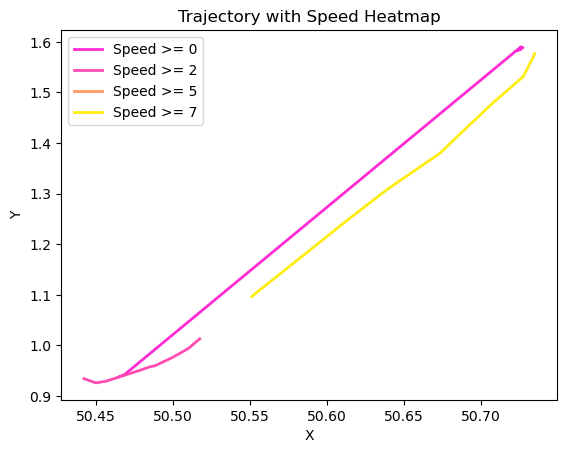

F/V PENDRUC
75      -4.620282
299     -4.620282
187     -4.620282
411     -4.620265
523     -4.620268
           ...   
21243   -4.620145
21355   -4.620145
21691   -4.620147
21579   -4.620147
21467   -4.620147
Name: position_latitude, Length: 194, dtype: float64


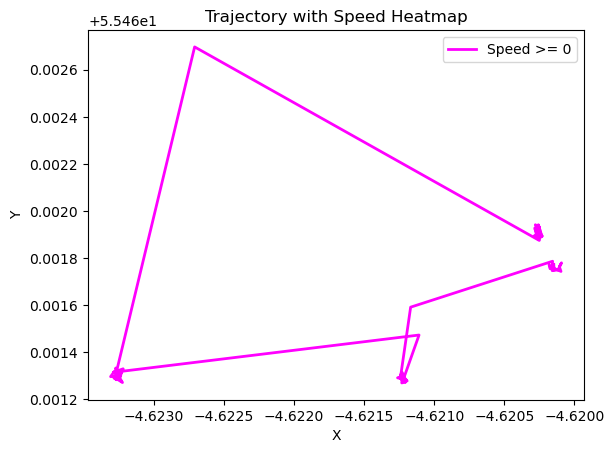

F/V LAREDO
35       50.241367
371      50.241367
2051     50.241367
2163     50.241367
4291     50.241367
           ...    
20419    50.437243
19523    50.437243
18627    50.437243
17731    50.437243
17619    50.437243
Name: position_latitude, Length: 194, dtype: float64


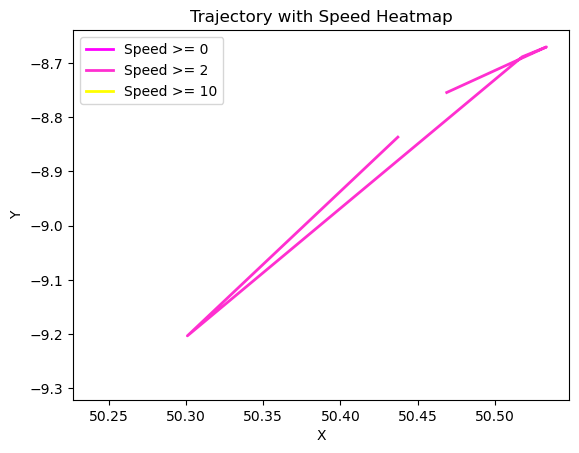

F/V RIO DA BOUZA
93       49.536567
205      49.536567
317      49.531167
429      49.520217
541      49.496900
           ...    
21261    49.531633
21373    49.527400
21485    49.529000
21597    49.535667
21709    49.566033
Name: position_latitude, Length: 194, dtype: float64


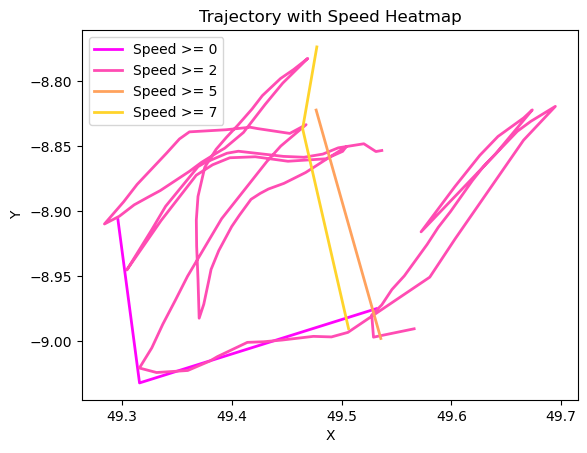

OTTER BANK F/V
163      57.120740
51       57.120740
275      57.120745
387      57.120737
499      57.120755
           ...    
21219    60.801882
21443    60.852743
21331    60.852743
21555    60.923917
21667    60.969618
Name: position_latitude, Length: 194, dtype: float64


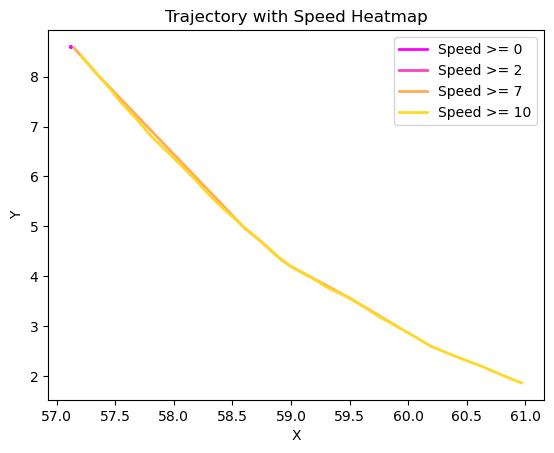

F/V GURE AMETZA II
6        44.591753
118      44.591753
230      44.559438
342      44.524793
454      44.498057
           ...    
21174    43.352675
21286    43.352580
21398    43.352588
21510    43.352588
21622    43.352587
Name: position_latitude, Length: 194, dtype: float64


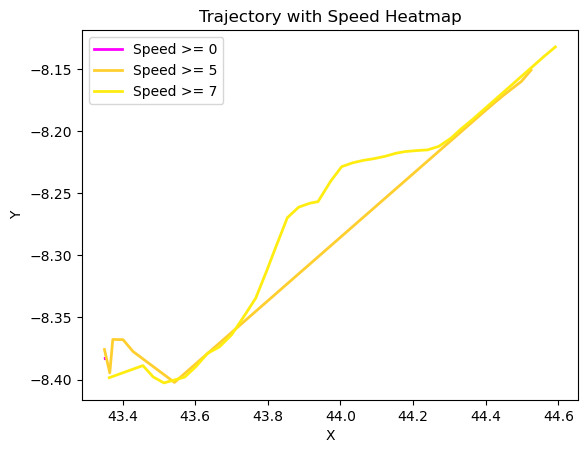

F/V VIA AVENIR
41       5.289293
153      5.289293
265      5.289305
377      5.289315
489      5.289317
           ...   
21209    5.289307
21321    5.289303
21433    5.289302
21545    5.289305
21657    5.289293
Name: position_latitude, Length: 194, dtype: float64


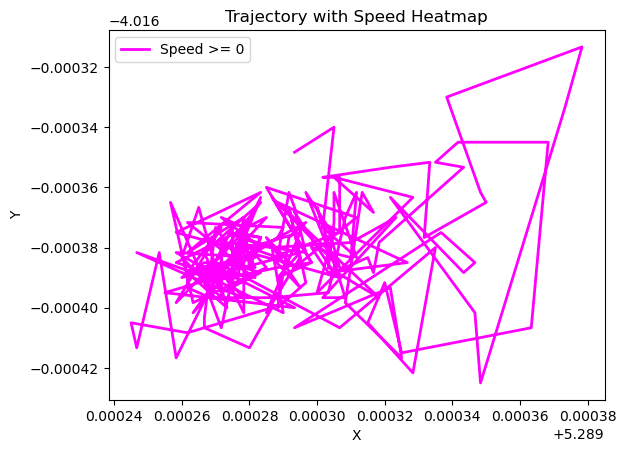

F/V FARPESCA
61       49.138952
173      49.143535
285      49.157630
397      49.167335
509      49.180652
           ...    
21229    48.852325
21341    48.825843
21453    48.806172
21565    48.782310
21677    48.742577
Name: position_latitude, Length: 194, dtype: float64


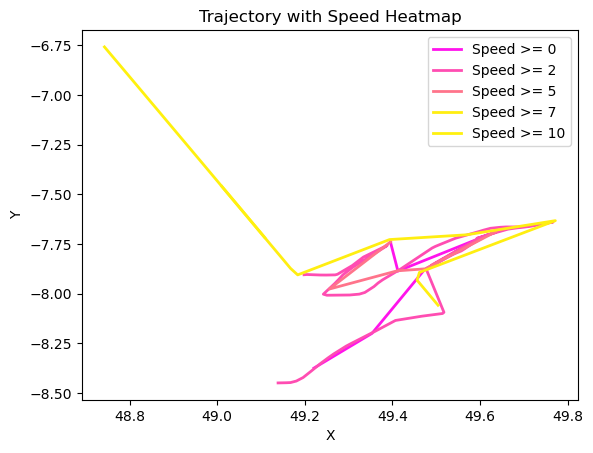

F/V LE MARMOUSET 3
2        50.726525
114      50.726525
226      50.726548
338      50.726527
450      50.726535
           ...    
21170    50.724042
21282    50.724045
21394    50.724052
21506    50.724053
21618    50.724042
Name: position_latitude, Length: 194, dtype: float64


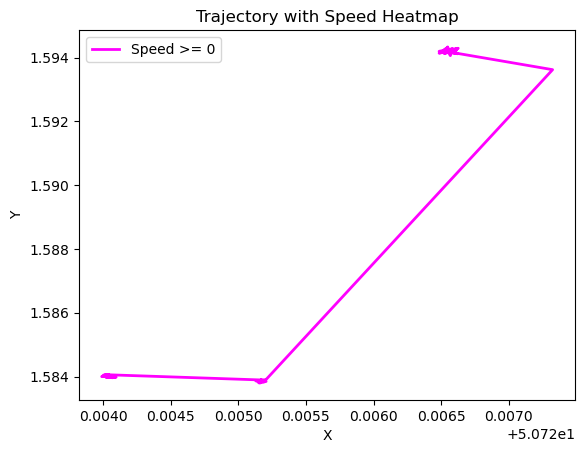

VIA ALIZE
104      5.290782
216      5.290782
328      5.290790
440      5.290828
552      5.290833
           ...   
21272    5.274947
21384    5.275022
21496    5.274908
21608    5.274882
21720    5.274882
Name: position_latitude, Length: 194, dtype: float64


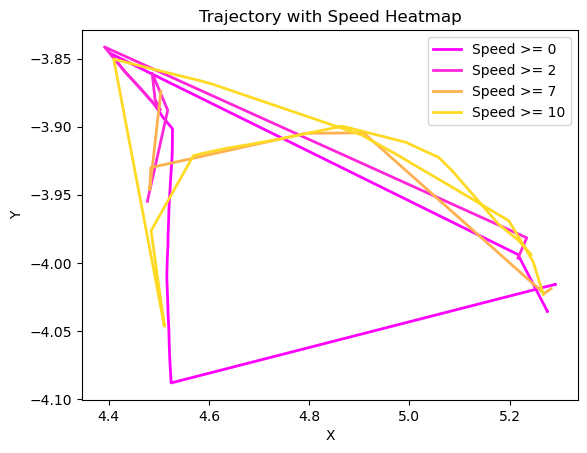

F/V NOTRE DAME DE B
9        51.356900
121      51.356900
233      51.339983
345      51.318733
457      51.291960
           ...    
21177    50.724153
21289    50.724137
21401    50.724153
21513    50.724163
21625    50.724153
Name: position_latitude, Length: 194, dtype: float64


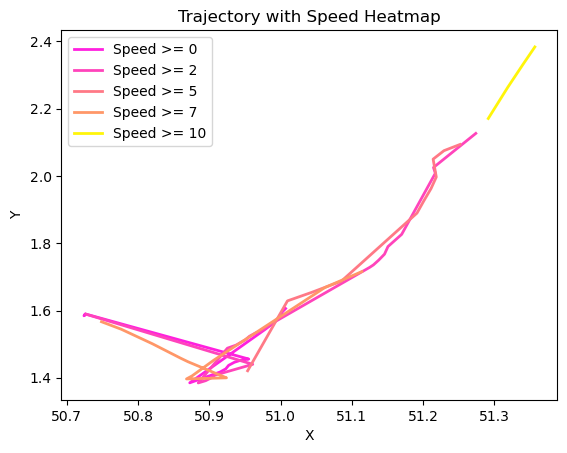

F/V TOURMALET
103      50.246970
215      50.246970
327      50.254190
439      50.304617
551      50.325923
           ...    
21271    50.723773
21383    50.723768
21495    50.723778
21607    50.723785
21719    50.723770
Name: position_latitude, Length: 194, dtype: float64


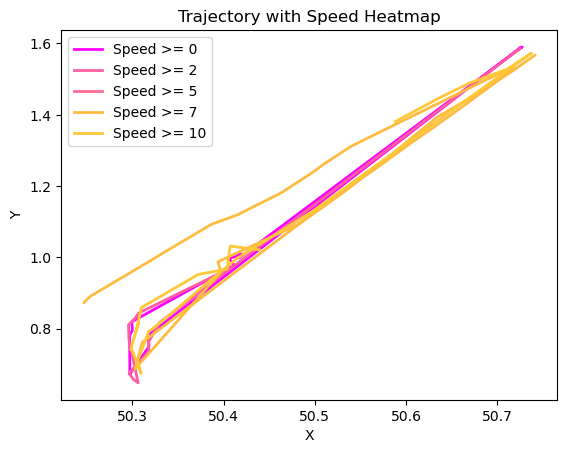

F/V MARIA MAGDALENA
158      43.680415
46       43.680415
270      43.680387
382      43.680387
494      43.680392
           ...    
20990    43.680408
15278    43.680408
13486    43.680408
19758    43.680408
17182    43.680408
Name: position_latitude, Length: 194, dtype: float64


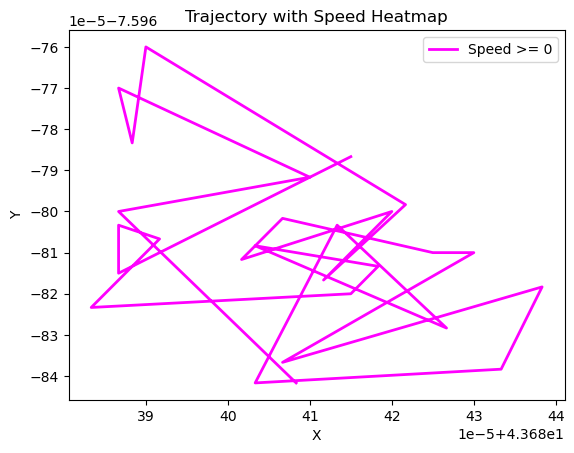

F/V VIA MISTRAL
180      5.289290
68       5.289290
292      5.289283
404      5.289287
516      5.289275
           ...   
6900     5.289213
13396    5.289213
15076    5.289213
7460     5.289213
14404    5.289213
Name: position_latitude, Length: 194, dtype: float64


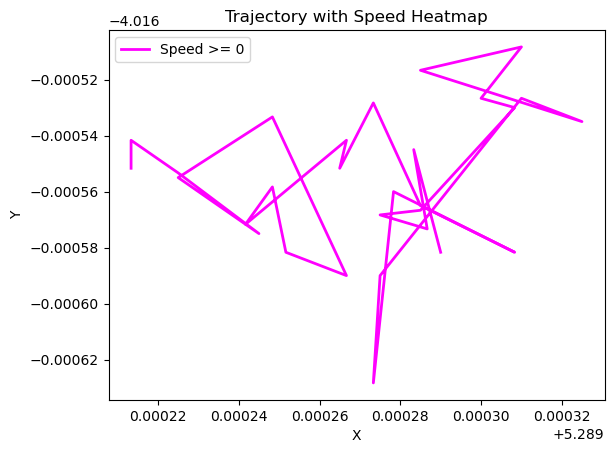

F/V J.L.RAPHAEL 2
252      43.403890
476      43.403890
28       43.403890
364      43.403890
140      43.403890
           ...    
21196    43.403872
21308    43.403857
21420    43.403907
21532    43.403897
21644    43.403853
Name: position_latitude, Length: 194, dtype: float64


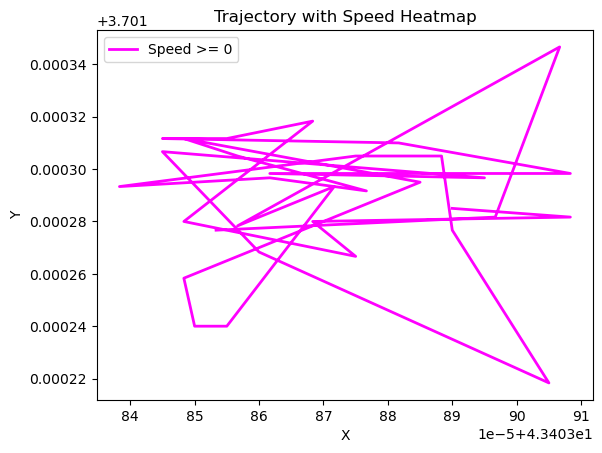

F/V PEDRA BLANCA
480      49.030183
368      49.030183
256      49.030183
144      49.030183
592      49.030183
           ...    
21200    49.148283
21312    49.154700
21424    49.162750
21536    49.162750
21648    49.171650
Name: position_latitude, Length: 194, dtype: float64


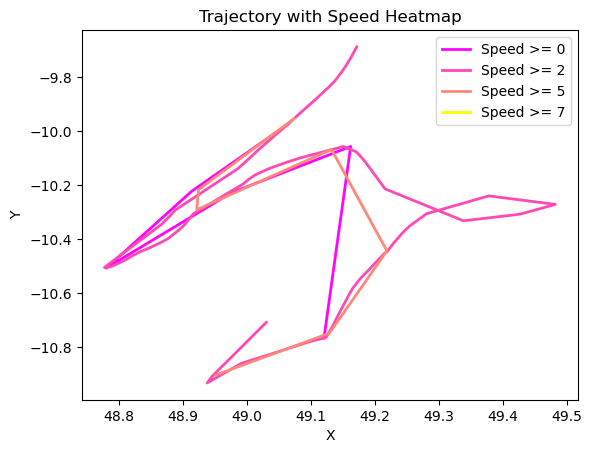

F/V J.M.CHRISTIAN 6
49       43.421008
161      43.421008
273      43.420995
385      43.420992
497      43.421013
           ...    
21217    43.421060
21441    43.421013
21329    43.421013
21553    43.421048
21665    43.421012
Name: position_latitude, Length: 194, dtype: float64


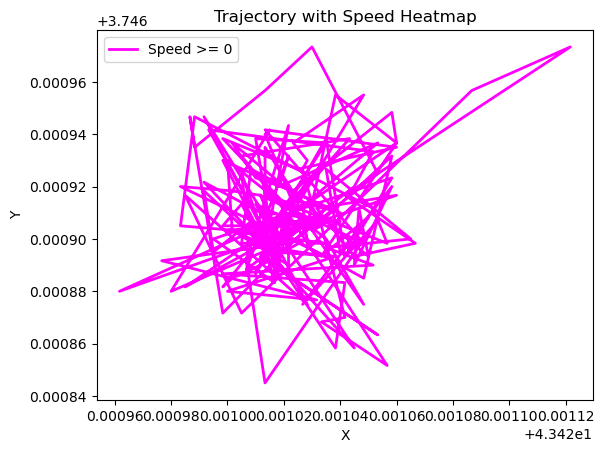

F/VJANVIER L.RAPHAEL
90       22.969740
202      22.969740
314      22.998642
426      23.045408
538      23.069405
           ...    
21258    29.298082
21370    29.342160
21482    29.386142
21594    29.443125
21706    29.501137
Name: position_latitude, Length: 194, dtype: float64


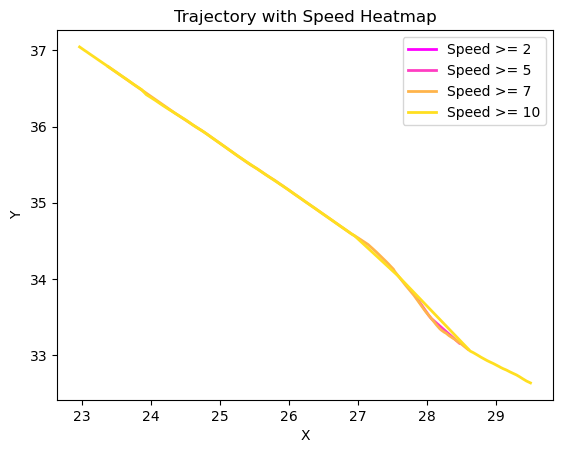

PRINS BERNHARD
97       52.457557
209      52.457557
321      52.457535
433      52.457567
545      52.457553
           ...    
21265    52.457572
21377    52.457517
21489    52.457583
21601    52.457588
21713    52.457572
Name: position_latitude, Length: 194, dtype: float64


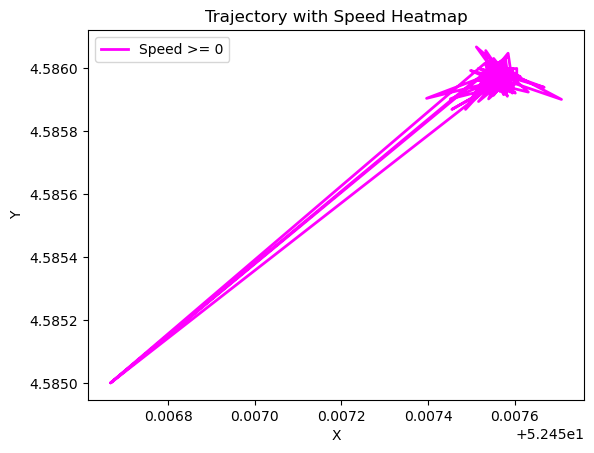

F/V JULIEN COLEOU
108      48.995475
220      48.995475
332      48.942282
444      48.894005
556      48.845315
           ...    
21276    47.728953
21388    47.728962
21500    47.728980
21612    47.728953
21724    47.728955
Name: position_latitude, Length: 194, dtype: float64


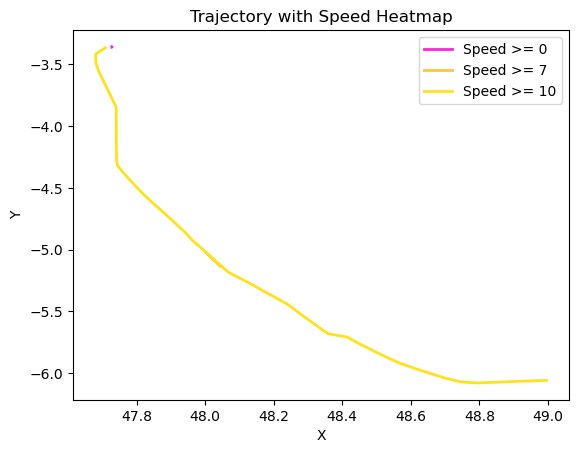

F/V GUERIDEN
170      5.266732
58       5.266732
282      5.266732
394      5.266695
506      5.266642
           ...   
21226    5.290842
21338    5.290843
21450    5.290853
21562    5.290858
21674    5.290868
Name: position_latitude, Length: 194, dtype: float64


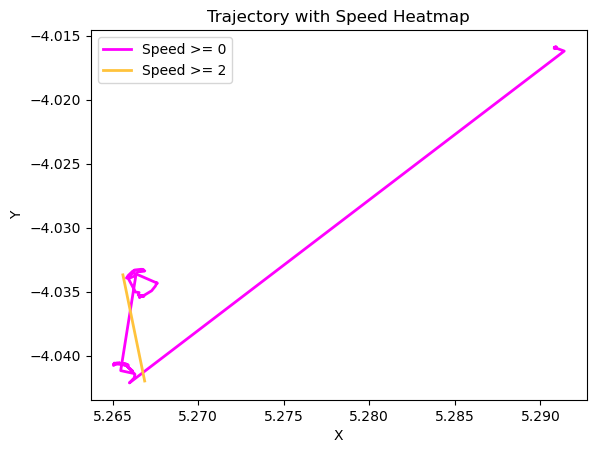

F/V MANUREVA
189      50.724973
77       50.724973
301      50.724972
413      50.724977
525      50.724962
           ...    
21245    50.724963
21357    50.724968
21469    50.724975
21581    50.724980
21693    50.724977
Name: position_latitude, Length: 194, dtype: float64


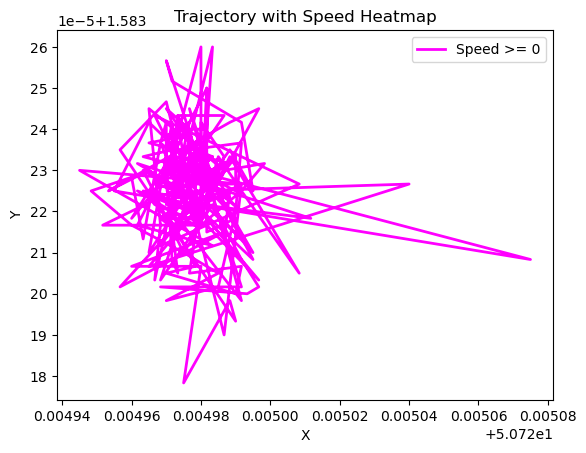

F/V MADELEINE
60       51.586305
172      51.586305
284      51.551110
396      51.529172
508      51.492358
           ...    
21228    50.724840
21340    50.724822
21452    50.724820
21564    50.724832
21676    50.724828
Name: position_latitude, Length: 194, dtype: float64


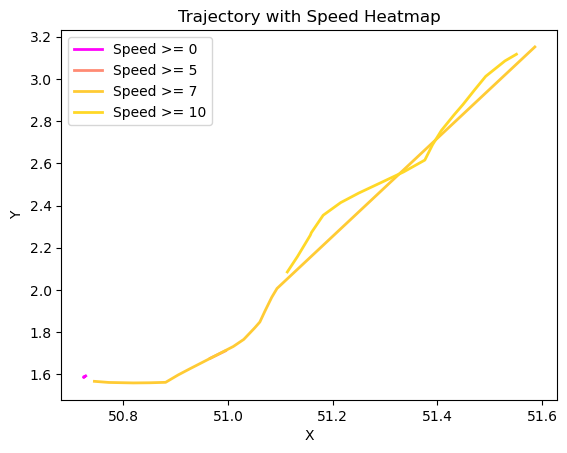

F/V ANDRE LEDUC
67       57.452738
179      57.452738
291      57.423793
403      57.393933
515      57.363335
           ...    
21235    61.170470
21347    61.189812
21459    61.212102
21571    61.272215
21683    61.306905
Name: position_latitude, Length: 194, dtype: float64


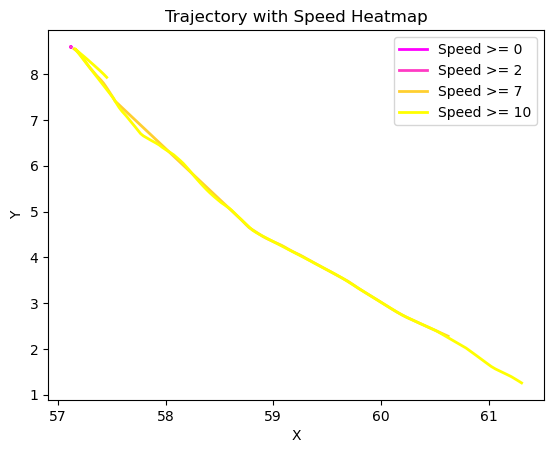

FISHER BANK
218      57.542720
106      57.542720
330      57.512713
442      57.482513
554      57.453760
           ...    
21050    59.986133
21610    60.015493
21498    60.015493
21386    60.015493
21722    60.015493
Name: position_latitude, Length: 194, dtype: float64


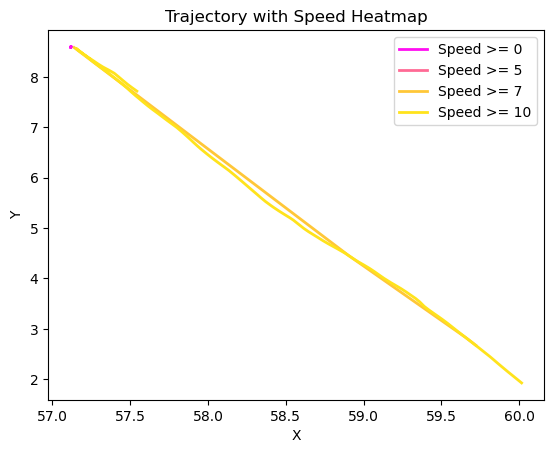

F/V PAX DEI II
196      51.580167
84       51.580167
308      51.545793
420      51.514600
532      51.491173
           ...    
21252    50.724982
21364    50.725000
21476    50.724967
21588    50.724970
21700    50.724965
Name: position_latitude, Length: 194, dtype: float64


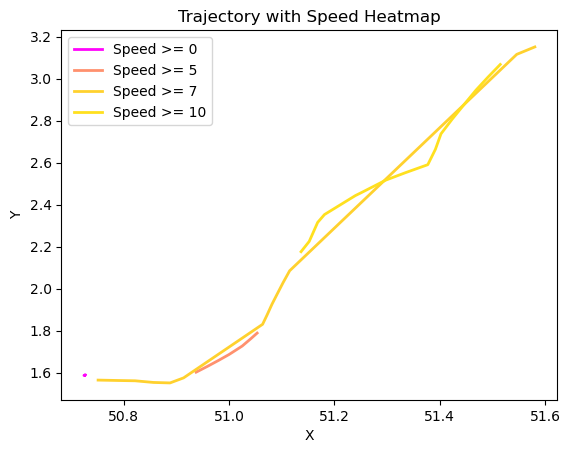

F/V J.M.CHRISTIAN 7
94       38.427533
206      38.427533
318      38.458555
430      38.501940
542      38.558143
           ...    
21262    41.955188
21374    41.915528
21486    41.874953
21598    41.834613
21710    41.793970
Name: position_latitude, Length: 194, dtype: float64


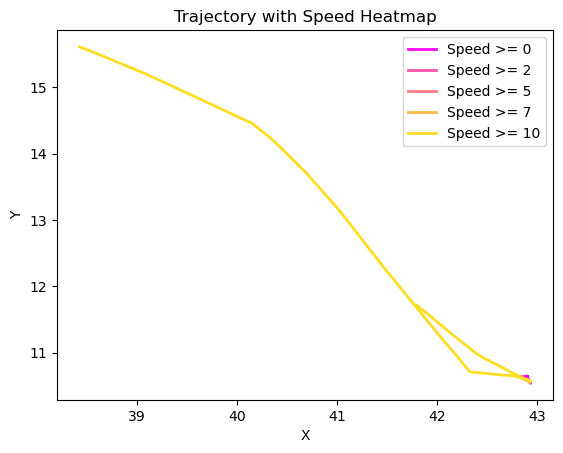

IndexError: index 112 is out of bounds for axis 0 with size 112

In [25]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

for j in range(200):
    df_ = df[(df['vessel_name'] == df['vessel_name'].unique()[j]) & (df['position_speed'] >=0)]
    print(df[(df['position_speed'] >=0)]['vessel_name'].unique()[j])
    if len(df_[df_['position_speed'] >= 0]) > 20 :
        x = df_['position_latitude']
        print(x)
        y = df_['position_longitude'] 
        speed = df_['position_speed']  
        num_points = len(df_)

        # Define speed thresholds for heatmap
        speed_thresholds = [-5, 0, 2, 5, 7, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]  # Example thresholds

        # Calculate speed segments
        speed_segments = np.digitize(speed, speed_thresholds)

        # Create colormap for heatmap
        cmap = plt.get_cmap('spring') #hot

        # Plot trajectory as lineplot with segments colored by speed
        for i in range(1, len(speed_thresholds) + 1):
            mask = speed_segments == i
            if np.any(mask):
                segment_x = x[mask]
                segment_y = y[mask]
                segment_speed = speed[mask]
                segment_color = cmap(Normalize(vmin=min(speed), vmax=max(speed))(segment_speed))
                plt.plot(segment_x, segment_y, color=segment_color[0], linewidth=2, label=f'Speed >= {speed_thresholds[i-1]}')

        # Add colorbar
        sm = ScalarMappable(cmap=cmap, norm=Normalize(vmin=min(speed), vmax=max(speed)))
        sm.set_array(speed)
        #plt.colorbar(sm, label='Speed')

        # Add labels and legend
        plt.xlabel('X')
        plt.ylabel('Y')
        plt.title('Trajectory with Speed Heatmap')
        plt.legend()

        # Show plot
        plt.show();


F/V GERALD-JEAN 3
2267     42.51664
16267    42.51664
18619    42.51664
12123    42.51664
7531     42.51664
           ...   
11451    42.51664
21195    42.51664
6411     42.51664
17051    42.51664
1371     42.51664
Name: position_latitude, Length: 194, dtype: float64


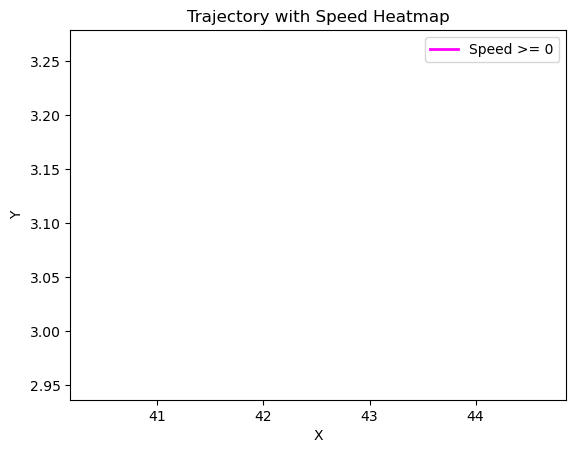

F/V ASPIN
16263    43.321483
12455    43.321483
17271    43.321483
11223    43.321483
14583    43.321483
           ...    
7303     43.321483
23       43.321483
10775    43.321483
1591     43.321483
3383     43.321483
Name: position_latitude, Length: 194, dtype: float64


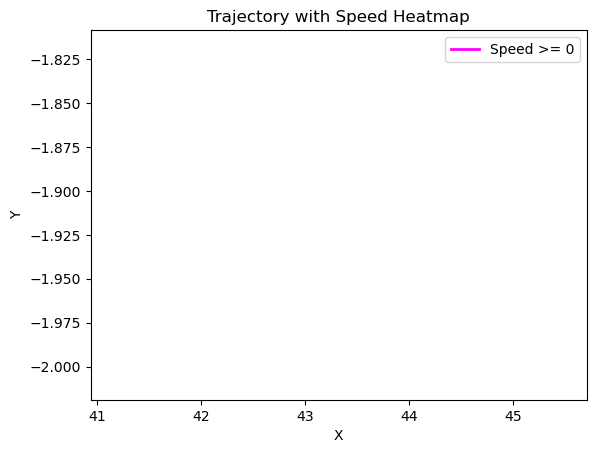

CHRISDERIC V
6572     42.6208
9148     42.6208
19900    42.6208
13292    42.6208
8028     42.6208
          ...   
5004     42.6208
16092    42.6208
14188    42.6208
20348    42.6208
17324    42.6208
Name: position_latitude, Length: 194, dtype: float64


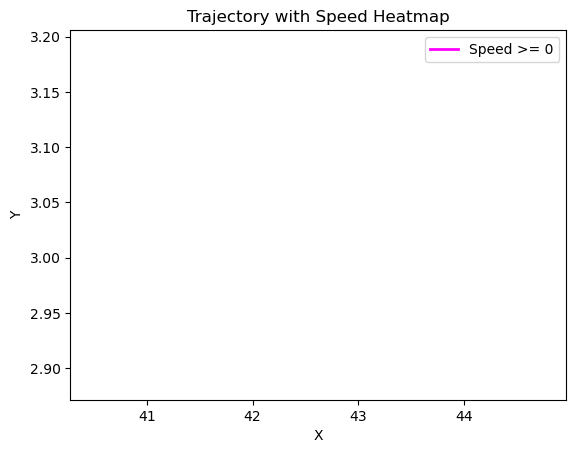

F/V GERALD JEAN IV
12670    42.516608
1022     42.516608
14350    42.516608
9198     42.516608
13790    42.516608
           ...    
17822    42.516608
350      42.516608
18606    42.516608
12110    42.516608
16702    42.516608
Name: position_latitude, Length: 194, dtype: float64


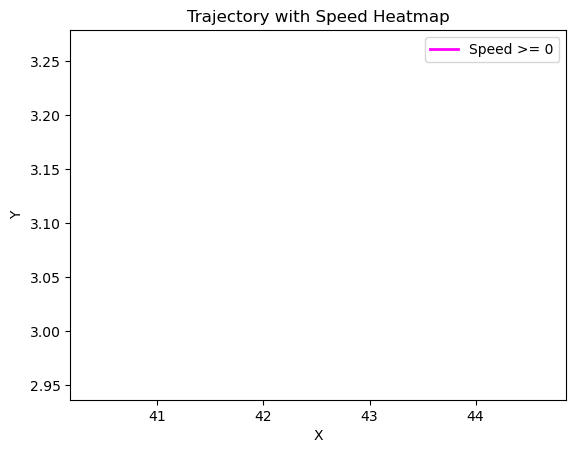

F/V  J.M.CHRISTIAN 4
7909     43.399867
7461     43.399867
965      43.399867
1413     43.399867
9813     43.399867
           ...    
21237    43.400393
21349    43.400373
21461    43.400397
21573    43.400410
21685    43.400392
Name: position_latitude, Length: 194, dtype: float64


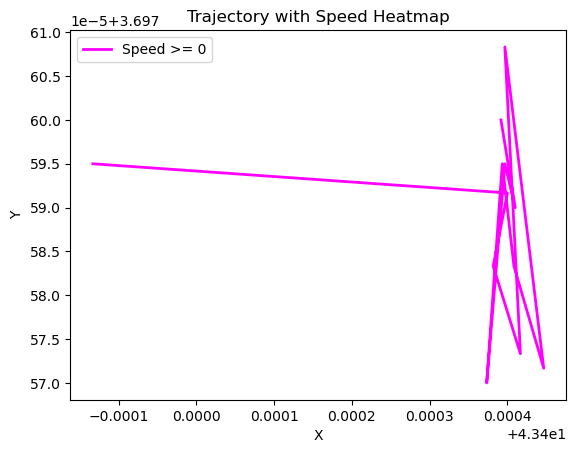

F/V GLENAN
7390    -4.616523
1566    -4.616523
20718   -4.616523
4926    -4.616523
3246    -4.616523
           ...   
18702   -4.616523
8846    -4.616523
5262    -4.616523
16126   -4.616523
4142    -4.616523
Name: position_latitude, Length: 194, dtype: float64


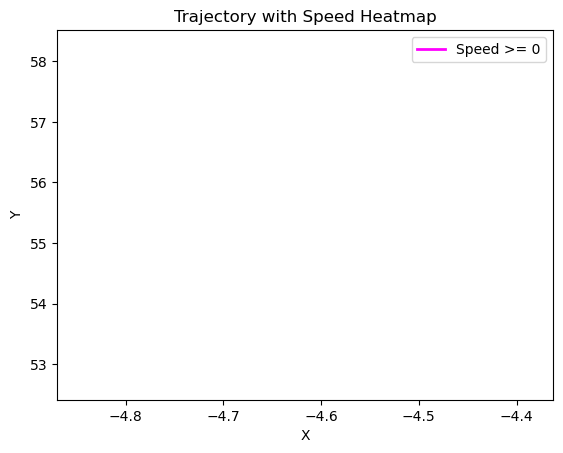

CAP SAINT VINCENT
F/V TH0MAS NICOLAS 2
AVEL VAD
NOTRE DAME CEDEIRA
F/V STEMARIELAMERII
CAP HORIZON
8440     43.401667
2616     43.401667
1496     43.401667
2392     43.401667
152      43.401667
           ...    
21208    43.403055
21320    43.403108
21432    43.403105
21544    43.403067
21656    43.403080
Name: position_latitude, Length: 194, dtype: float64


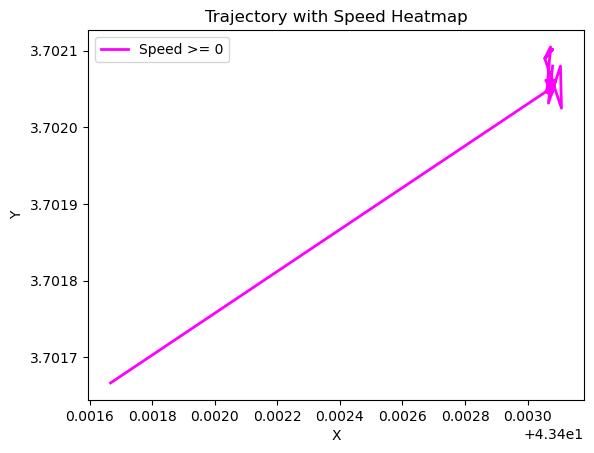

SCAPIRIA 1
F/V ERIC MARIN
13044    43.404427
11812    43.404427
18196    43.404427
15284    43.404427
5092     43.404427
           ...    
19540    43.404427
21332    43.404427
6996     43.404427
3860     43.404427
8900     43.404427
Name: position_latitude, Length: 194, dtype: float64


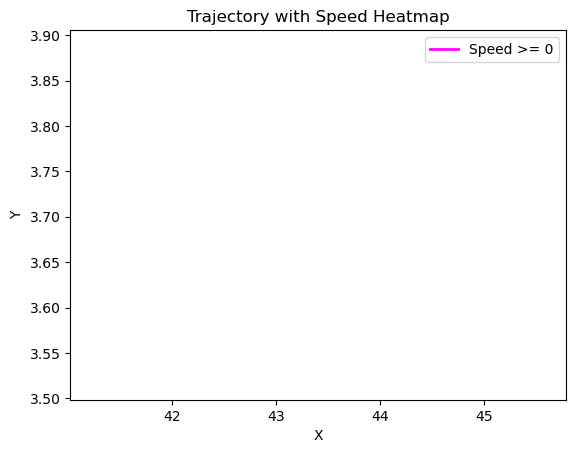

F/V VAUBAN
ROSE DE CASCIA
F/V CHRISDERIC2
16069    43.403542
16629    43.403542
8677     43.403542
16181    43.403542
3637     43.403542
           ...    
10133    43.403542
10805    43.403542
1173     43.403542
2069     43.403542
13269    43.403542
Name: position_latitude, Length: 194, dtype: float64


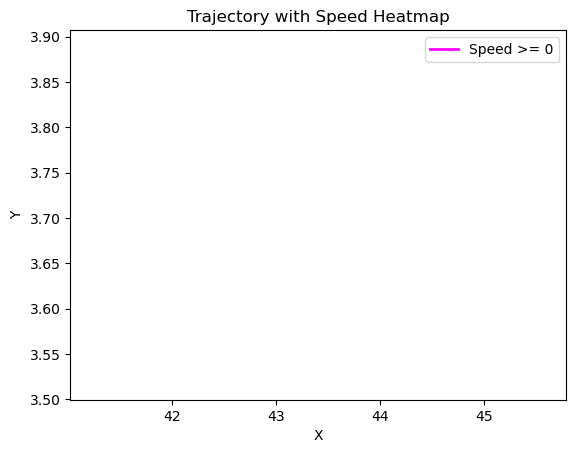

F/V GRAND ST BERNARD
PUNTA VIXIA
F/V J.M.CHRISTIAN 3
1923     43.399565
3603     43.399565
579      43.399565
18723    43.399565
3715     43.399565
           ...    
12675    43.399565
16931    43.399565
8195     43.399565
2371     43.399565
3491     43.399565
Name: position_latitude, Length: 194, dtype: float64


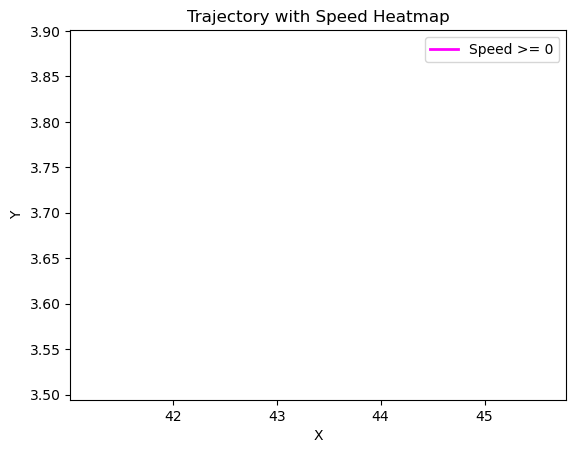

F/V CORONA DEL MAR
F/V ROSSOREN
F/V BIKAIN
F/V GERARD LUC 4
18003    43.294732
21027    43.294732
4227     43.294732
2099     43.294732
12628    43.294732
           ...    
9267     43.294732
8147     43.294732
5795     43.294732
11843    43.294732
9939     43.294732
Name: position_latitude, Length: 194, dtype: float64


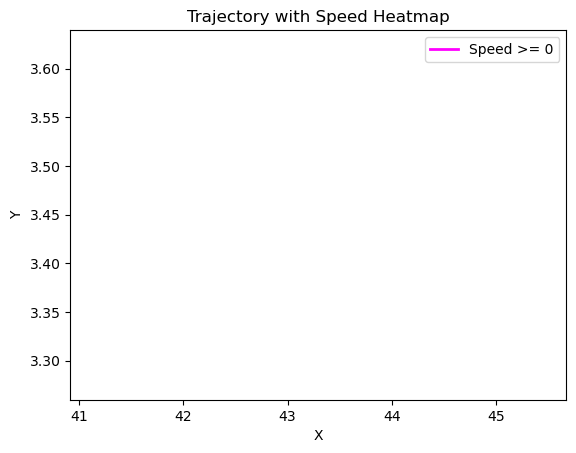

F/V JANVIER GIORDANO
9831     43.400828
20471    43.400828
6135     43.400828
8039     43.400828
10279    43.400828
           ...    
21367    43.400835
21255    43.400835
21703    43.400835
21591    43.400835
21479    43.400835
Name: position_latitude, Length: 194, dtype: float64


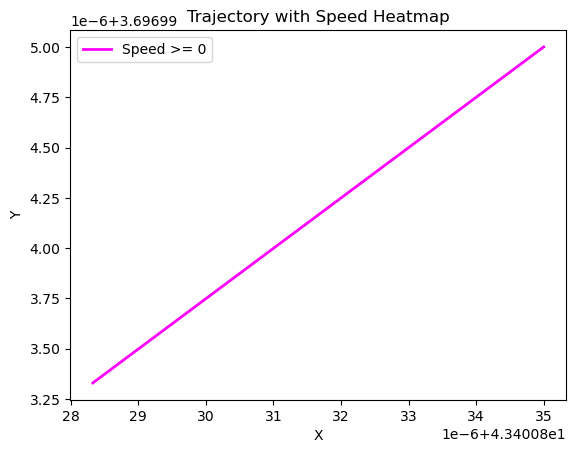

F/V G SAINTE RITA
F/V PIER JO SALVADOR
F/V STERENN
F/V CISBERLANDE 5
F/VSTSOPHIEFRANCOIS2
19785    43.402593
14745    43.402593
15865    43.402593
12729    43.402593
10937    43.402593
           ...    
1193     43.402593
5113     43.402593
13401    43.402593
13513    43.402593
13625    43.402593
Name: position_latitude, Length: 194, dtype: float64


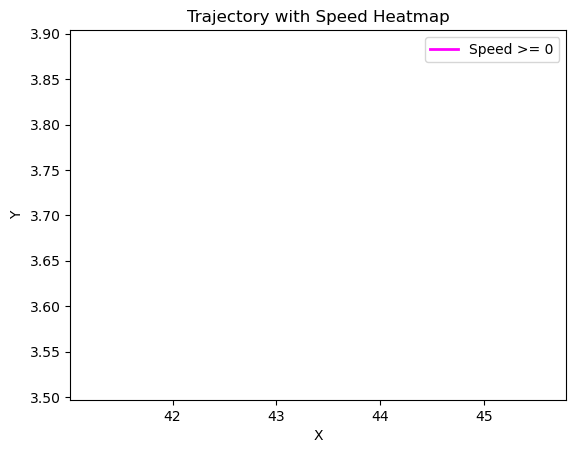

F/V PEPE BARREIRO
TIGERS III
21151    50.06177
19807    50.06177
13087    50.06177
7487     50.06177
319      50.06177
           ...   
18015    50.06177
11631    50.06177
16783    50.06177
12191    50.06177
19471    50.06177
Name: position_latitude, Length: 194, dtype: float64


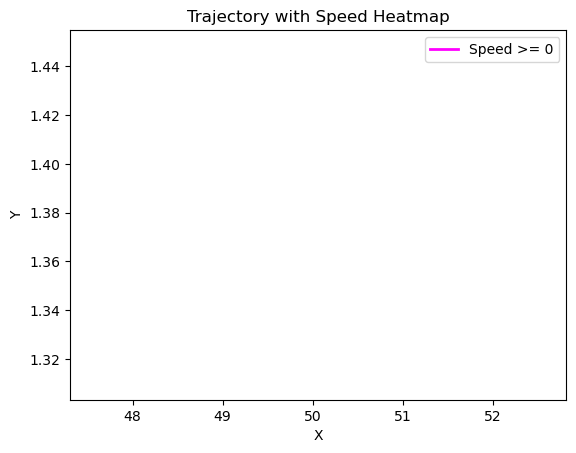

F/V SAINT GOTHARD
F/V PUENTEAREAS UNO
F/V ARGELES
F/V MAR MARES
F/V PLAYA DE TUYA
FV/BEOTHUK
F/V LANDORA
F/V RABELAIS
F/V CAP BOJADOR
F/V GUEOTEC
F/V SYLVANNA
FV FERREIRA MARTINEZ
F/V SIEMPRE VIRIATO
26       43.569783
138      43.569783
250      43.569807
362      43.569823
474      43.569772
           ...    
16938    43.569805
18506    43.569805
18730    43.569805
18282    43.569805
19514    43.569805
Name: position_latitude, Length: 194, dtype: float64


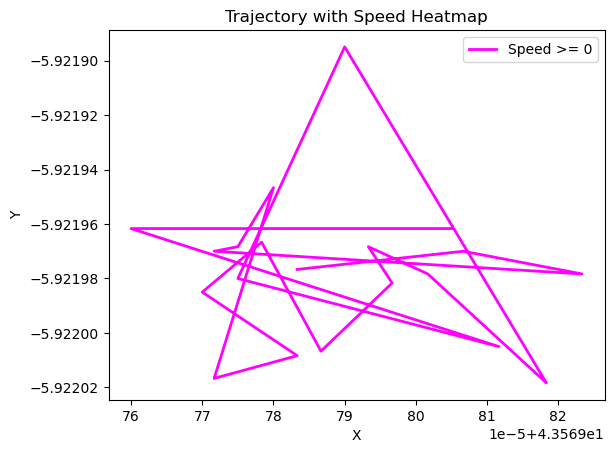

F/V LARCHE
F/V MELODIE
F/V LOIRA
2614     42.231115
2390     42.231115
38       42.231115
4406     42.231115
374      42.231115
           ...    
13590    42.231127
21542    42.231127
21430    42.231127
11686    42.231127
11574    42.231127
Name: position_latitude, Length: 194, dtype: float64


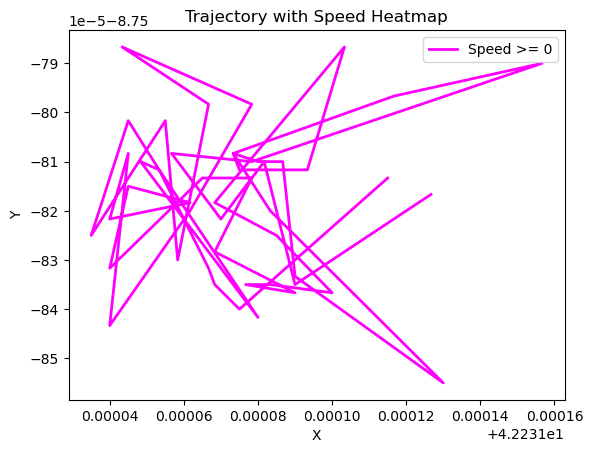

F/V ANTONIO MARIA
F/V CUCA
F/V GURE ANDRE
16596    42.800027
916      42.800027
9540     42.800027
692      42.800027
2484     42.800027
           ...    
4724     42.800027
3828     42.800027
21076    42.800027
9764     42.800027
2596     42.800027
Name: position_latitude, Length: 194, dtype: float64


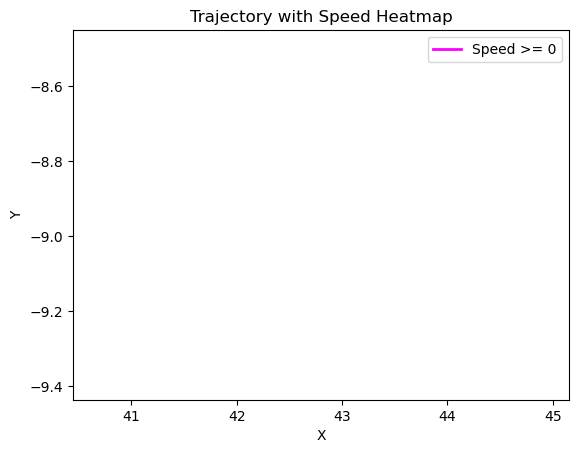

F/V ANNE ANTOINE 2
4658     43.400325
2754     43.400325
290      43.400325
4322     43.400325
738      43.400325
           ...    
15410    43.400330
13730    43.400330
12386    43.400330
13618    43.400330
19778    43.400330
Name: position_latitude, Length: 194, dtype: float64


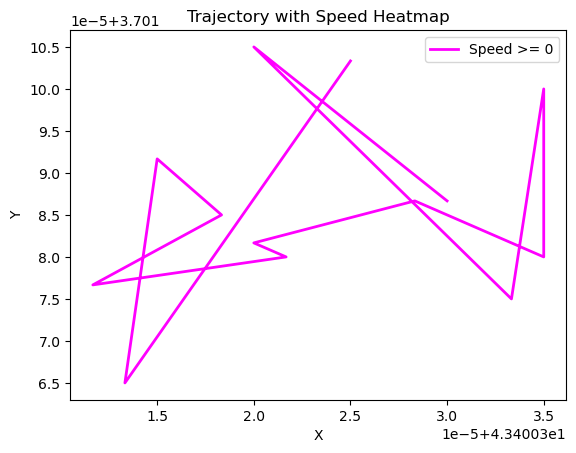

F/V LE RESSAC
F/V R0NSARD
F/V LE CROTELLOIS
F/V YANNICK
BRESSAY-BANK PAIR TR
CAP SAINT GEORGES
F/V LE STIFF
3449     43.352687
1433     43.352687
2217     43.352687
5353     43.352687
2441     43.352687
           ...    
14873    43.352677
9049     43.352677
18121    43.352677
10393    43.352677
17673    43.352677
Name: position_latitude, Length: 194, dtype: float64


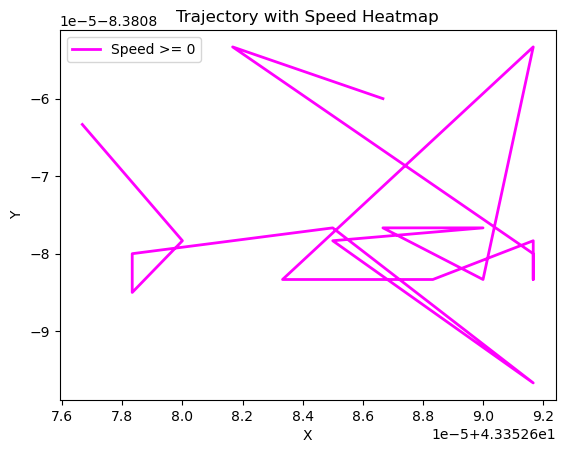

F/V SILURE
F/V CROIX MORAND
F/V RADOCHE TERCERO
F/V FASTNET
F/V CARLA
F/V ARMOR II
F/V M. LE ROCH 2
SCOMBRUS
F/V JP LE ROCH
F/V LAPALOMA II
F/V GEVRED
F\V LUDOVIC GEOFFRAY
F/V FARO PICAMILLO
F/V CAP FINISTERE
F/V NAONED
F/V VENT DU NORD II
99       43.354990
211      43.354990
435      43.354962
323      43.354962
547      43.354955
           ...    
21267    43.354997
21379    43.354970
21491    43.355073
21603    43.355013
21715    43.354983
Name: position_latitude, Length: 194, dtype: float64


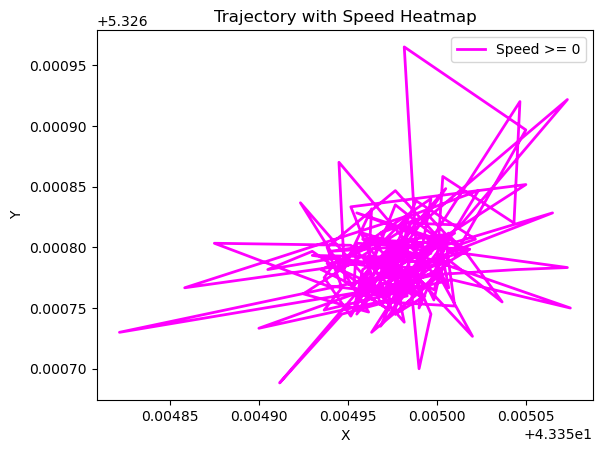

F/V PEDRA BLANCA II
F/V MAR DE FLORES
F/V IBARDIN
F/V AGORRETA
F/V LA TRINITE
F/V MEABAN
F/V EMERAUDE
CAP ST MARIE
F/V NICOLAS JEREMY
LE DOLMEN
F/V MERCATOR
F/V PENDRUC
F/V LAREDO
F/V RIO DA BOUZA
OTTER BANK F/V
F/V GURE AMETZA II
F/V VIA AVENIR
F/V FARPESCA
F/V LE MARMOUSET 3
2        50.726525
114      50.726525
226      50.726548
338      50.726527
450      50.726535
           ...    
21170    50.724042
21282    50.724045
21394    50.724052
21506    50.724053
21618    50.724042
Name: position_latitude, Length: 194, dtype: float64


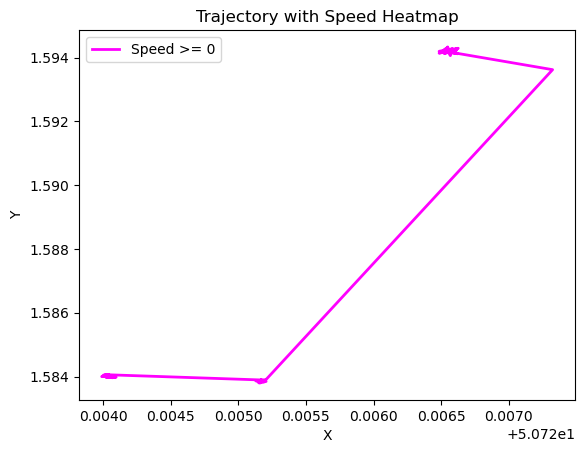

VIA ALIZE
F/V NOTRE DAME DE B
F/V TOURMALET
F/V MARIA MAGDALENA
158      43.680415
46       43.680415
270      43.680387
382      43.680387
494      43.680392
           ...    
20990    43.680408
15278    43.680408
13486    43.680408
19758    43.680408
17182    43.680408
Name: position_latitude, Length: 194, dtype: float64


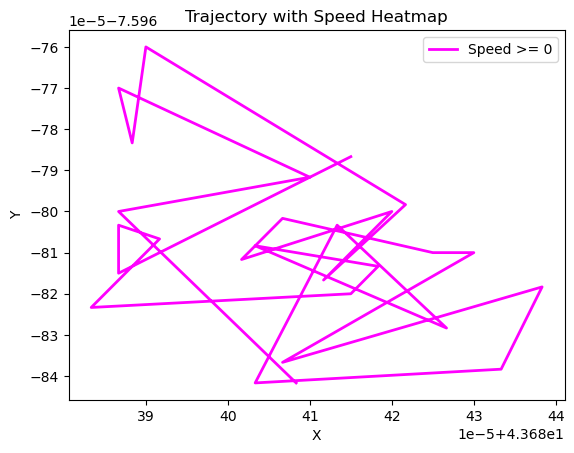

F/V VIA MISTRAL
180      5.289290
68       5.289290
292      5.289283
404      5.289287
516      5.289275
           ...   
6900     5.289213
13396    5.289213
15076    5.289213
7460     5.289213
14404    5.289213
Name: position_latitude, Length: 194, dtype: float64


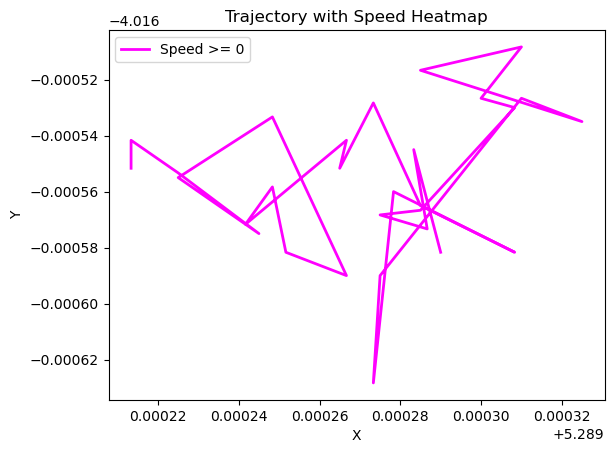

F/V J.L.RAPHAEL 2
252      43.403890
476      43.403890
28       43.403890
364      43.403890
140      43.403890
           ...    
21196    43.403872
21308    43.403857
21420    43.403907
21532    43.403897
21644    43.403853
Name: position_latitude, Length: 194, dtype: float64


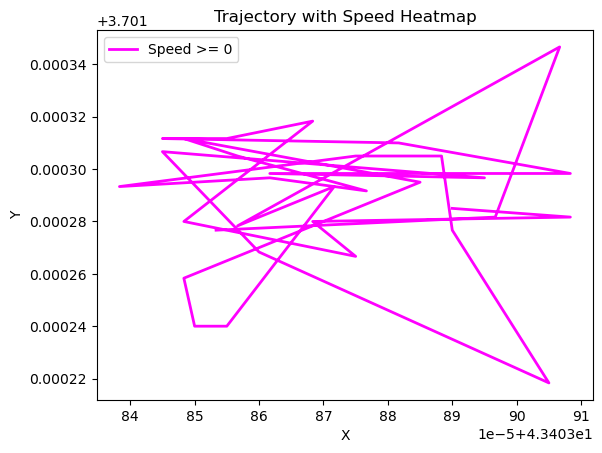

F/V PEDRA BLANCA
F/V J.M.CHRISTIAN 6
49       43.421008
161      43.421008
273      43.420995
385      43.420992
497      43.421013
           ...    
21217    43.421060
21441    43.421013
21329    43.421013
21553    43.421048
21665    43.421012
Name: position_latitude, Length: 194, dtype: float64


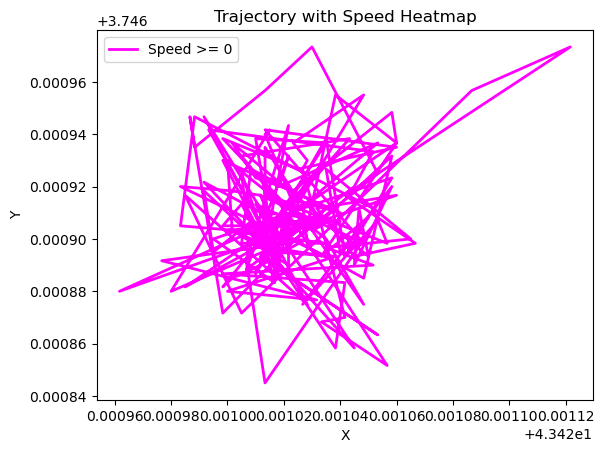

F/VJANVIER L.RAPHAEL
PRINS BERNHARD
97       52.457557
209      52.457557
321      52.457535
433      52.457567
545      52.457553
           ...    
21265    52.457572
21377    52.457517
21489    52.457583
21601    52.457588
21713    52.457572
Name: position_latitude, Length: 194, dtype: float64


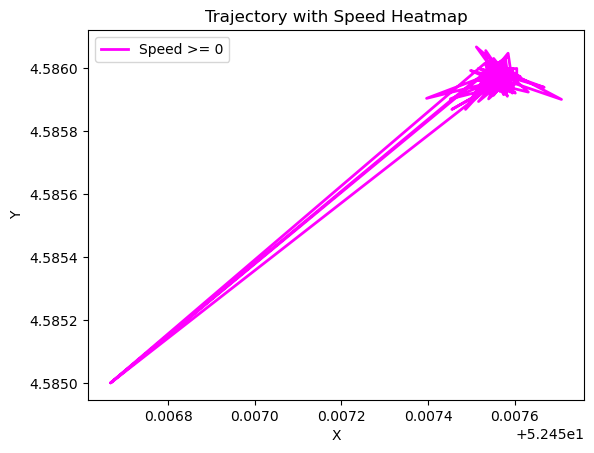

F/V JULIEN COLEOU
F/V GUERIDEN
F/V MANUREVA
189      50.724973
77       50.724973
301      50.724972
413      50.724977
525      50.724962
           ...    
21245    50.724963
21357    50.724968
21469    50.724975
21581    50.724980
21693    50.724977
Name: position_latitude, Length: 194, dtype: float64


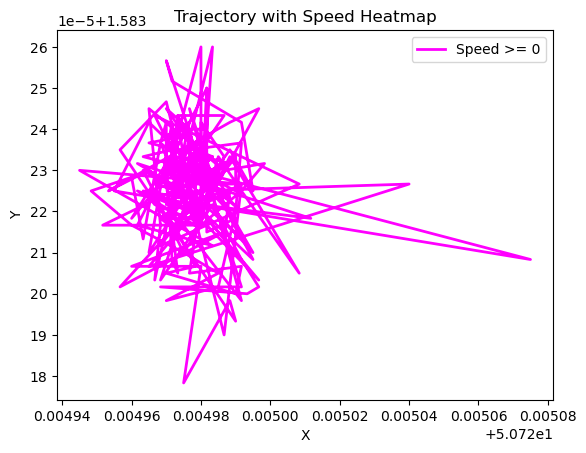

F/V MADELEINE
F/V ANDRE LEDUC
FISHER BANK
F/V PAX DEI II
F/V J.M.CHRISTIAN 7


IndexError: index 112 is out of bounds for axis 0 with size 112

In [32]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

for j in range(200):
    df_ = df[(df['vessel_name'] == df['vessel_name'].unique()[j]) & (df['position_speed'] >=0)]
    print(df[(df['position_speed'] >=0)]['vessel_name'].unique()[j])
    if len(df_[df_['position_speed'] >= 0]) > 20 :
        if (len(df_[df_['position_speed'] == 0]) == len(df_)) or (len(df_[df_['position_speed'] == 0]) == (len(df_) - 1)) :
            x = df_['position_latitude']
            y = df_['position_longitude'] 
            speed = df_['position_speed']  
            num_points = len(df_)

            # Define speed thresholds for heatmap
            speed_thresholds = [-5, 0, 2, 5, 7, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55]  # Example thresholds

            # Calculate speed segments
            speed_segments = np.digitize(speed, speed_thresholds)

            # Create colormap for heatmap
            cmap = plt.get_cmap('spring') #hot

            # Plot trajectory as lineplot with segments colored by speed
            for i in range(1, len(speed_thresholds) + 1):
                mask = speed_segments == i
                if np.any(mask):
                    segment_x = x[mask]
                    segment_y = y[mask]
                    segment_speed = speed[mask]
                    segment_color = cmap(Normalize(vmin=min(speed), vmax=max(speed))(segment_speed))
                    plt.plot(segment_x, segment_y, color=segment_color[0], linewidth=2, label=f'Speed >= {speed_thresholds[i-1]}')

            # Add colorbar
            sm = ScalarMappable(cmap=cmap, norm=Normalize(vmin=min(speed), vmax=max(speed)))
            sm.set_array(speed)
            #plt.colorbar(sm, label='Speed')

            # Add labels and legend
            plt.xlabel('X')
            plt.ylabel('Y')
            plt.title('Trajectory with Speed Heatmap')
            plt.legend()

            # Show plot
            plt.show();


In [ ]:
np.sort(df['position_speed'].unique())

In [ ]:
len(df)

In [ ]:
for j in range(50):
    df_ = df[df['vessel_name'] == df['vessel_name'].unique()[j]]
    if len(df_) > 10:
        sns.scatterplot(data = df_, x = 'position_latitude', y = 'position_longitude')
        plt.show();

In [ ]:
# On constate que la vitesse est souvent en dessous de 7 noeuds (si ce sont des noeuds)
# On pourrait aussi enlever la partie des records qui ont un certain nombre de même latitude et longitude ou valeur = 0
# On voit quelle est la répartition des vitesses avec les prints et les scatterplots
# On peut trouver des valeurs négatives

# Il faut mettre en évidence les épisodes potentiellement de pêche, les afficher et les proposer à la labélisation
# Il faut déterminer quel nombre de records est suffisant pour déterminer un pattern (à vue d'oeil on va dire 4 et on fera une étude ensuite)
# On voudrait que les points soient 1 ceux en dessous de 7 ou d'un seuil de 50% de la vitesse max
# On voudrait que ces points ce suivent (condition pour avoir des indices qui se suivent: pour chaque trajectoire dont on ne garde que la vitesse à 40% du max, on va vérifier que l'indice est bien + 1 et append sinon break plot et passer à la suite)
# Clique sur un bouton: itérateur dans le dataset - itération sur une trajectoire de récupérer la portion de trajectoire à vitesse réduite
# On envoie la réponse (sur un streamlit sous forme de graphe sur une carte)
# Proposer un label (pêche oui ou non)
# Inscrit le résultat dans une bdd connectée
# Réécrire un algo pour faire le reconnaissance sur une time series de patterns de pêche (1 il pêche, 0 pêche pas en faisant un input de la trajectoire en entier + début et fin épisode de pêche comme régression ou alors la trajectoire en entier labellée par pixels, sauf que l'on ne va pas avoir le même nombre de records pour chaque bateau)
# csv trajectoire ou un nom trajectoire et tu regardes les épisodes de pêches à travers l'appel à une api fonctionnel sur le streamlit de prédiction et on propose un map avec un tag de coloration de l'épisode de pêche


In [ ]:
len(df['vessel_name'].unique())

In [ ]:
# sélectionnons les portions de trajectoire avec une vitesse à 40% du max sur au moins 4 observations
# sélectionnons les portions de trajectoire avec une vitesse en dessous de 7.5 sur au moins 4 observations


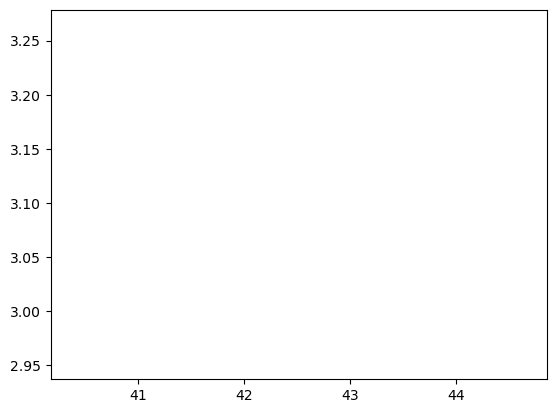

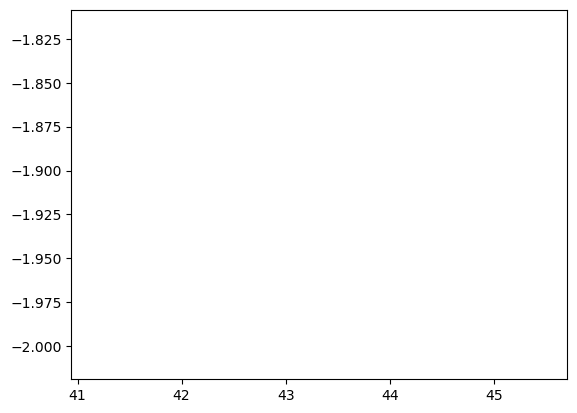

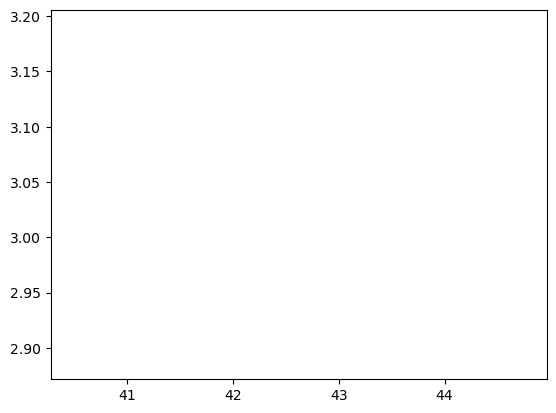

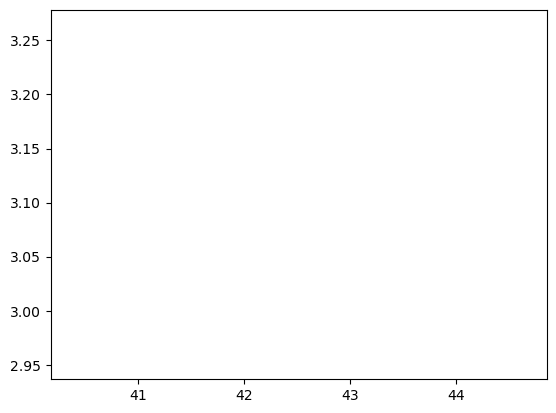

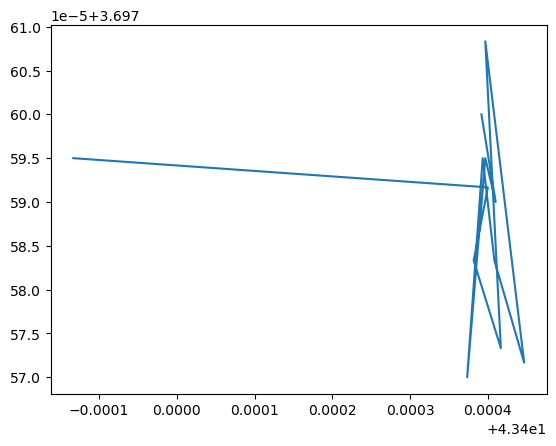

...

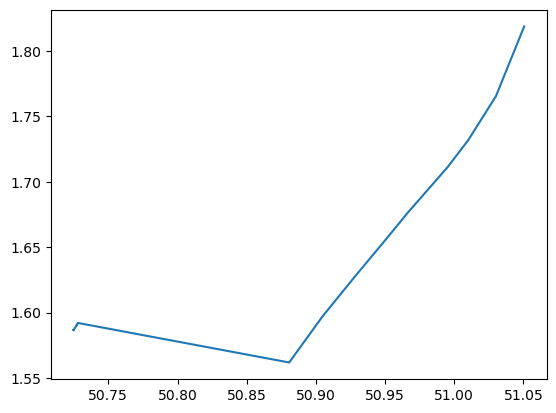

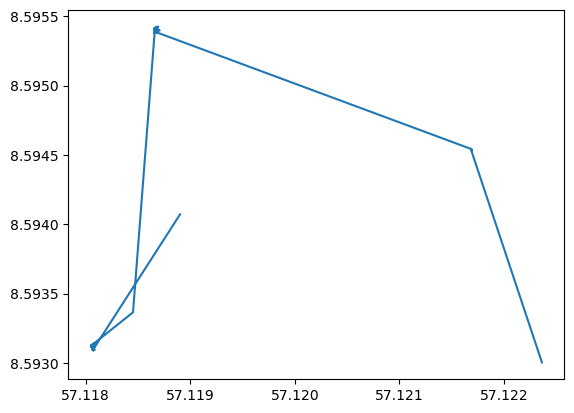

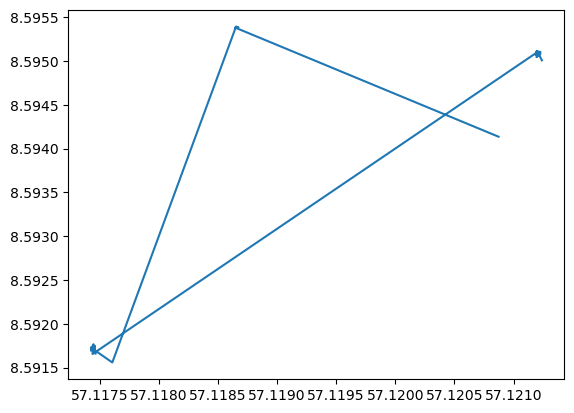

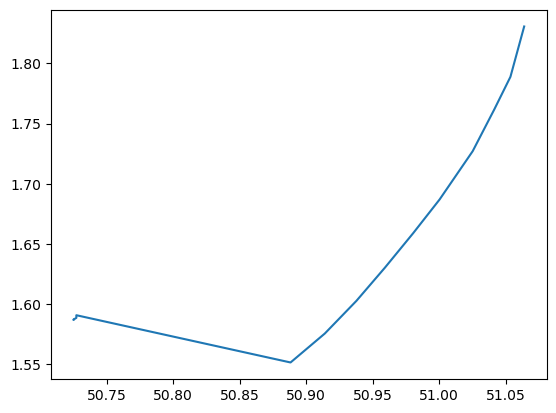

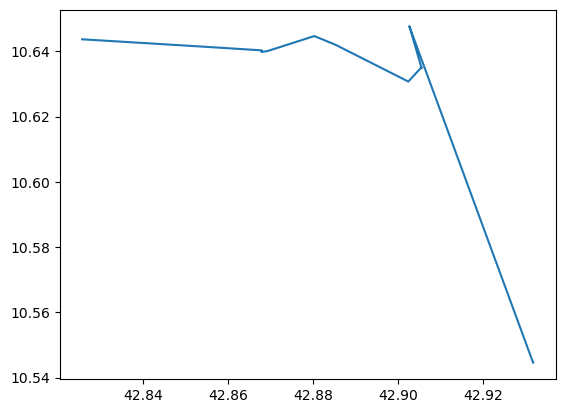

In [27]:
for vessel in df['vessel_name'].unique():
    df_vessel = df[(df['vessel_name'] == vessel) & (df['position_speed'] < 7.5)]
    if len(df_vessel) > 5:
        plt.plot(df_vessel['position_latitude'], df_vessel['position_longitude'])
        plt.show();

F/V GERALD-JEAN 3


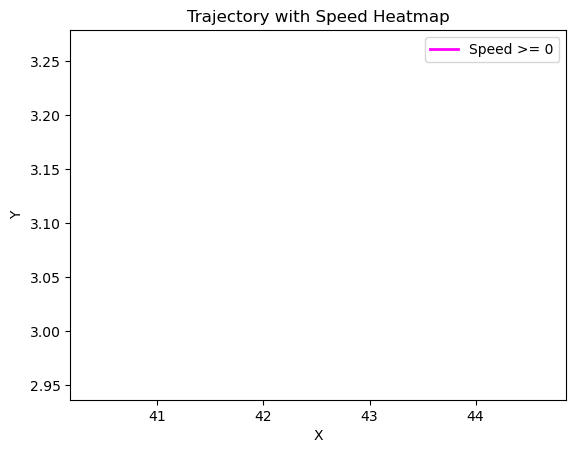

F/V ASPIN


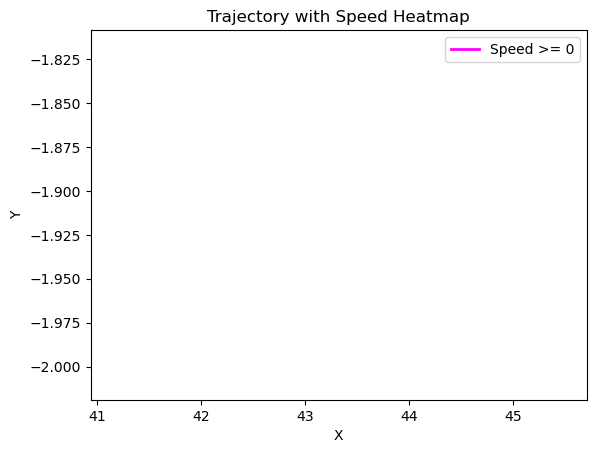

CHRISDERIC V


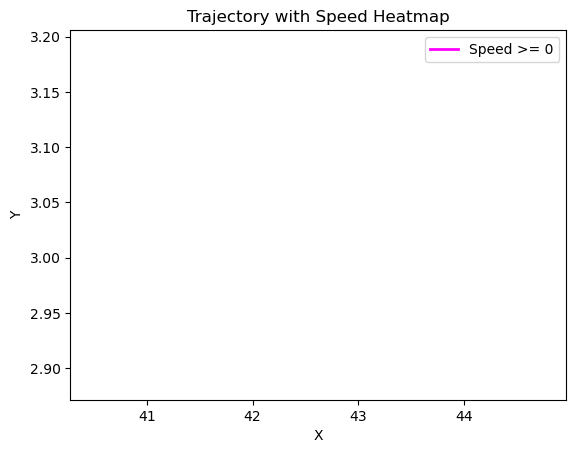

F/V GERALD JEAN IV


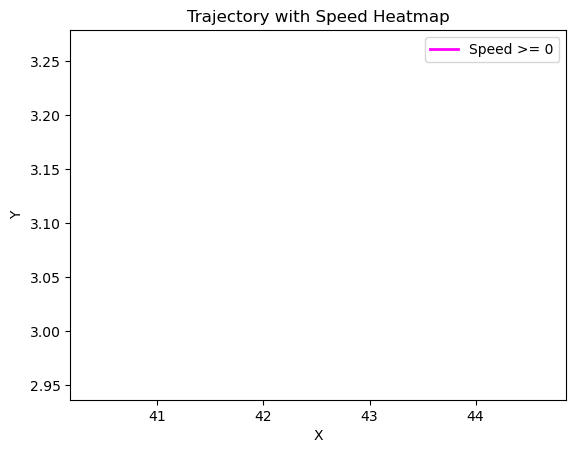

F/V  J.M.CHRISTIAN 4


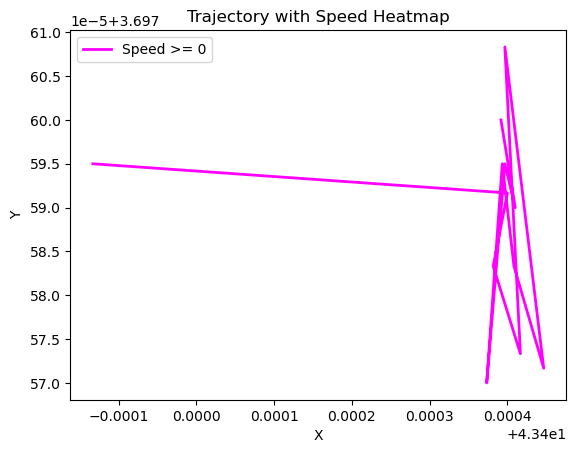

F/V GLENAN


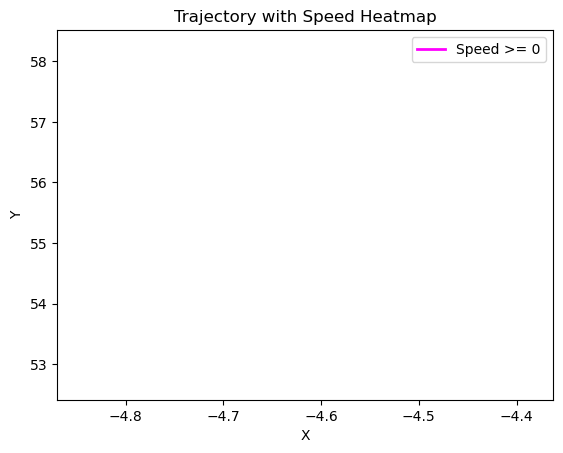

CAP SAINT VINCENT


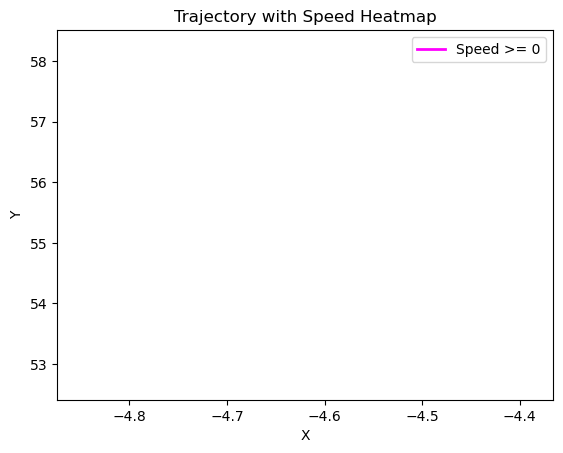

F/V TH0MAS NICOLAS 2


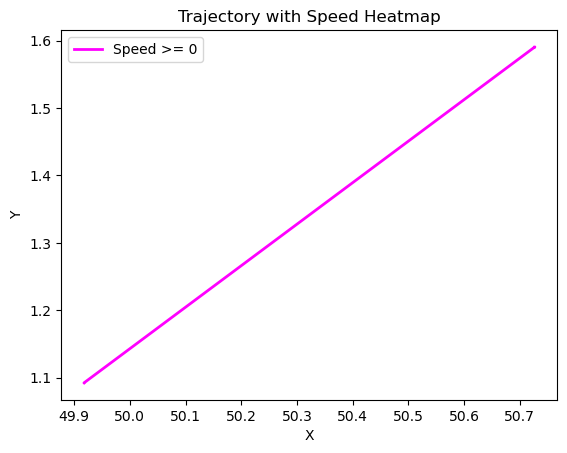

AVEL VAD
NOTRE DAME CEDEIRA


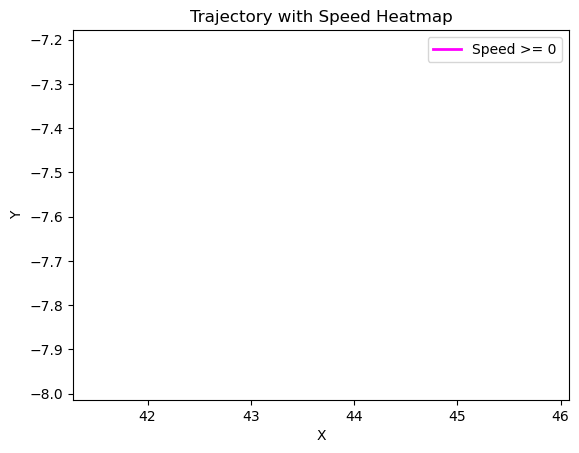

F/V STEMARIELAMERII


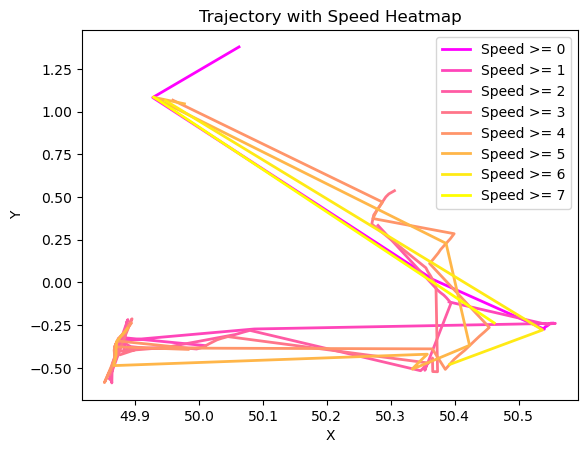

CAP HORIZON


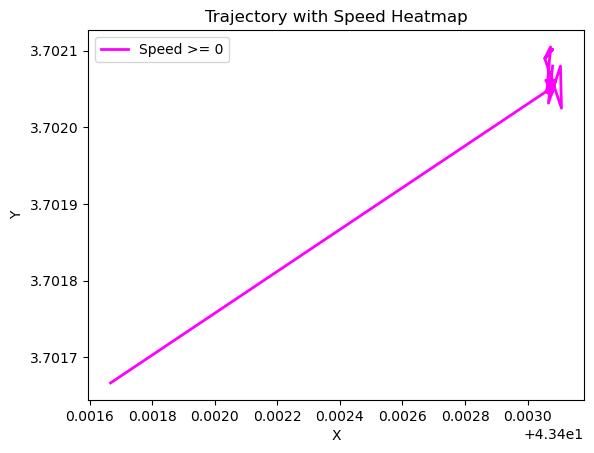

SCAPIRIA 1


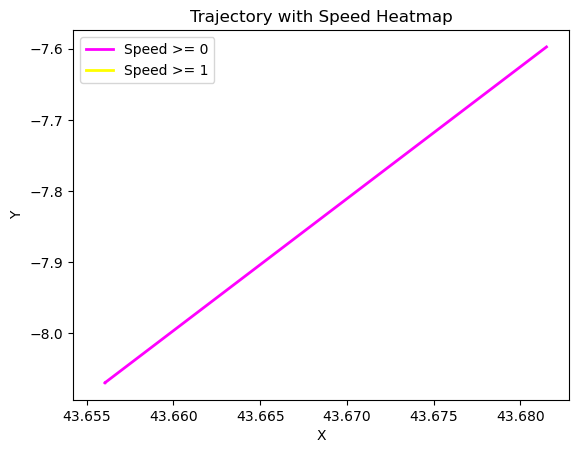

F/V ERIC MARIN


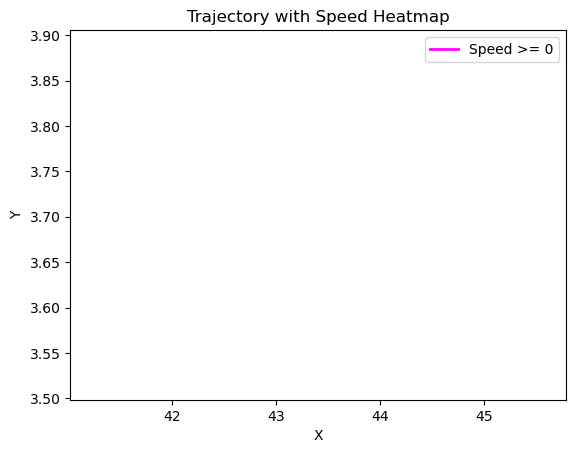

F/V VAUBAN


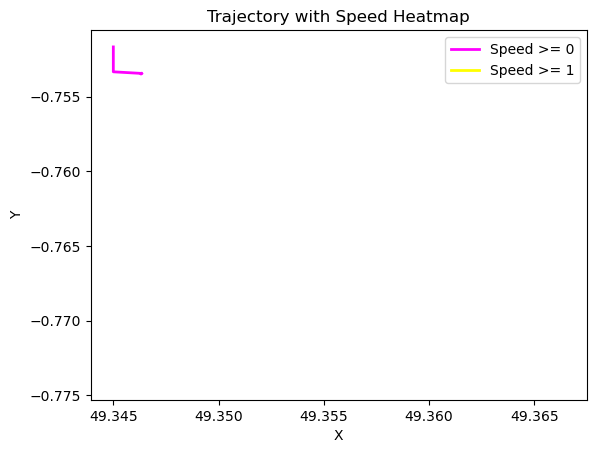

ROSE DE CASCIA


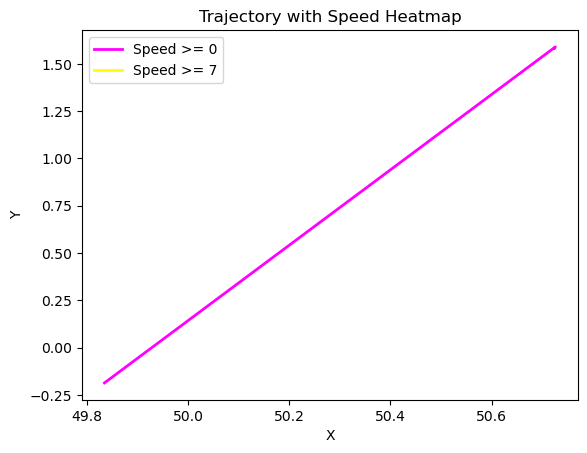

F/V CHRISDERIC2


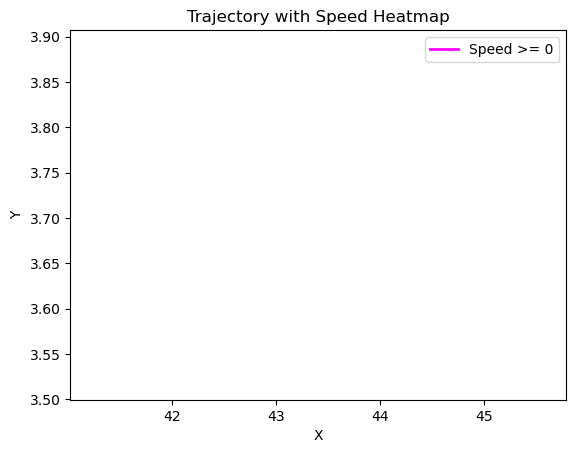

F/V GRAND ST BERNARD


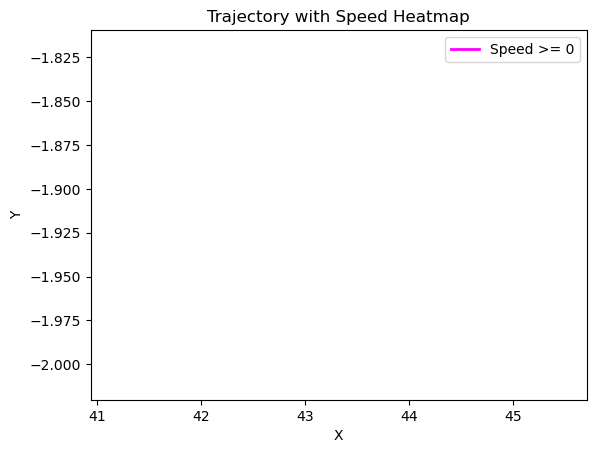

PUNTA VIXIA


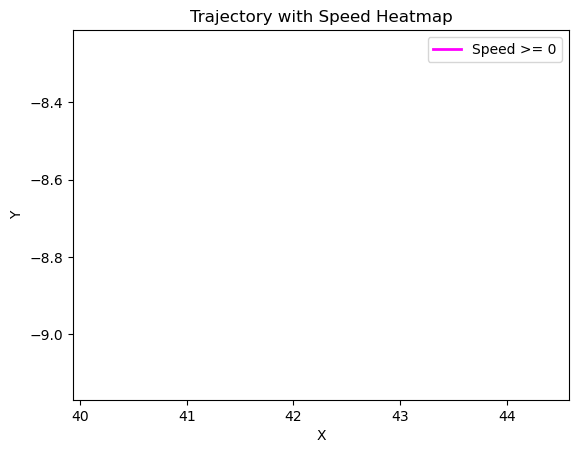

F/V J.M.CHRISTIAN 3


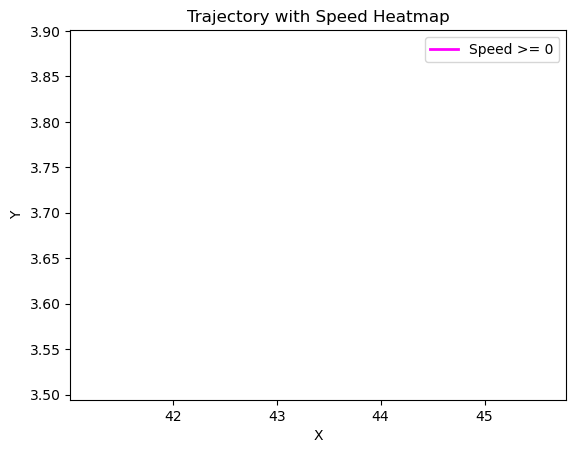

F/V CORONA DEL MAR


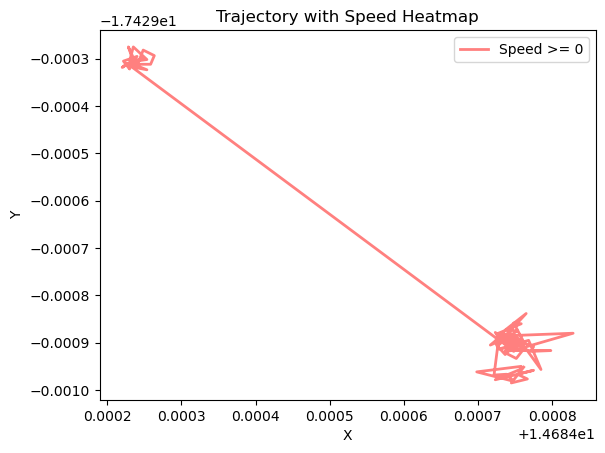

F/V ROSSOREN


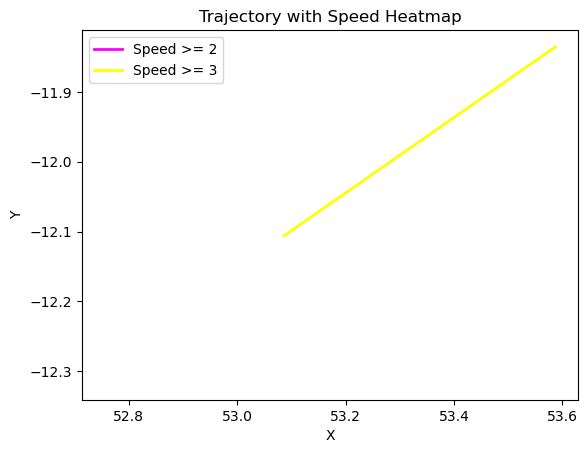

F/V BIKAIN
F/V GERARD LUC 4


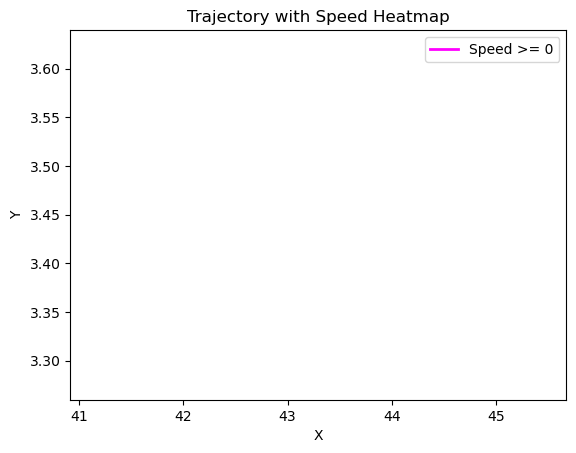

F/V JANVIER GIORDANO


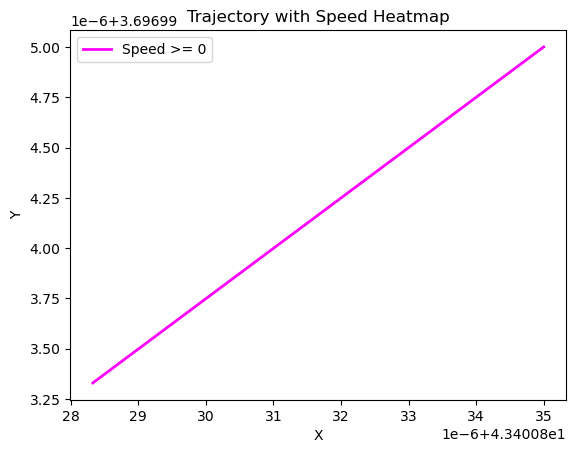

F/V G SAINTE RITA


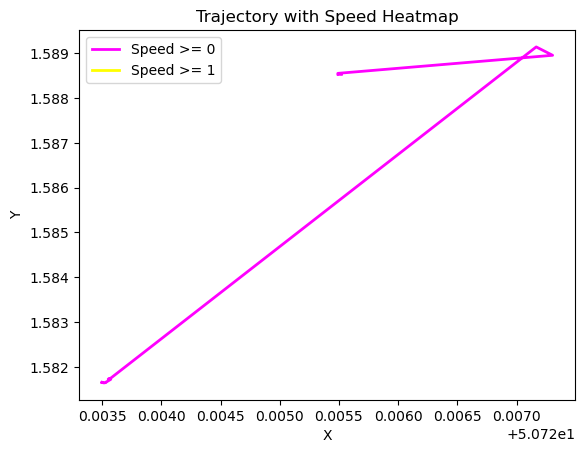

F/V PIER JO SALVADOR


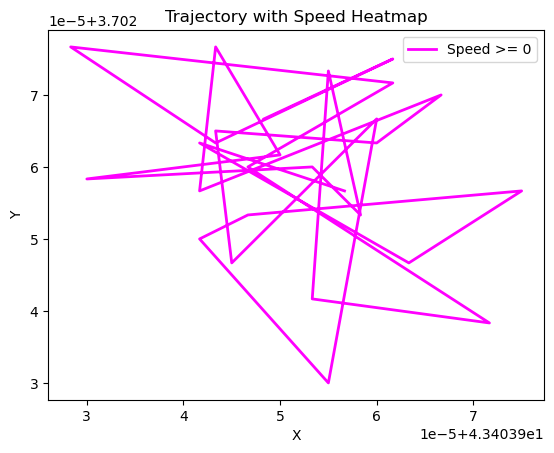

F/V STERENN


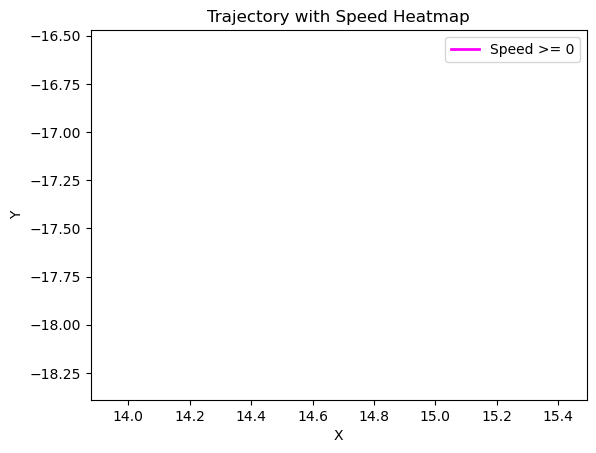

F/V CISBERLANDE 5


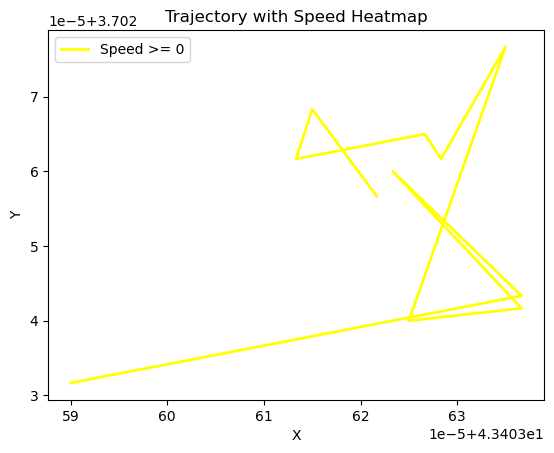

F/VSTSOPHIEFRANCOIS2


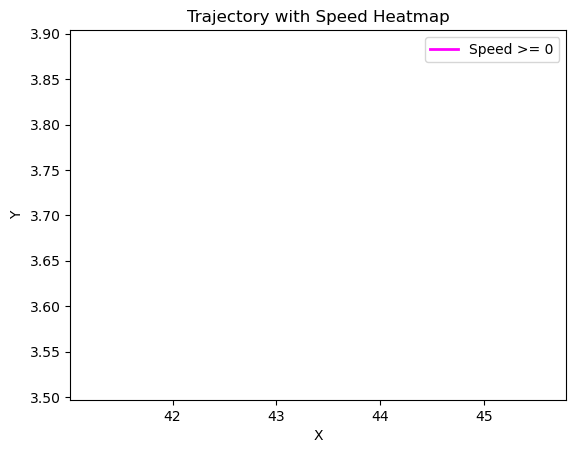

F/V PEPE BARREIRO


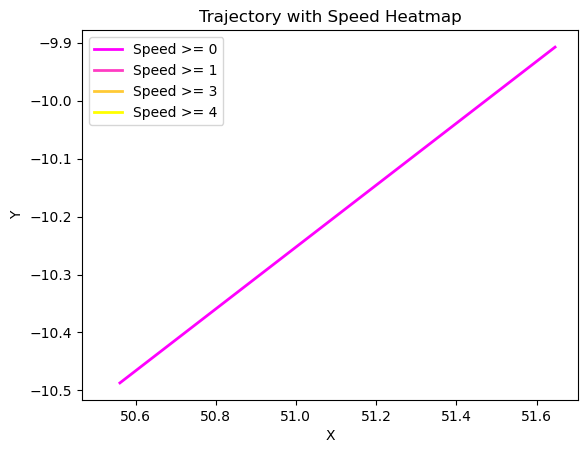

TIGERS III


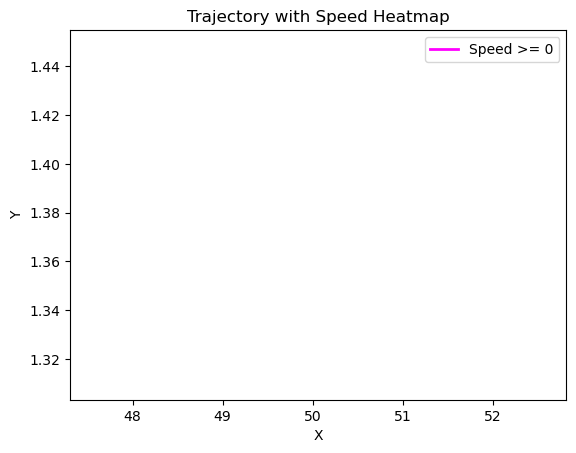

F/V SAINT GOTHARD


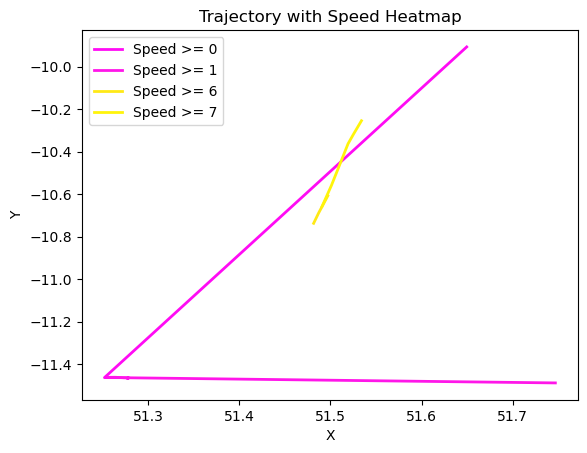

F/V PUENTEAREAS UNO


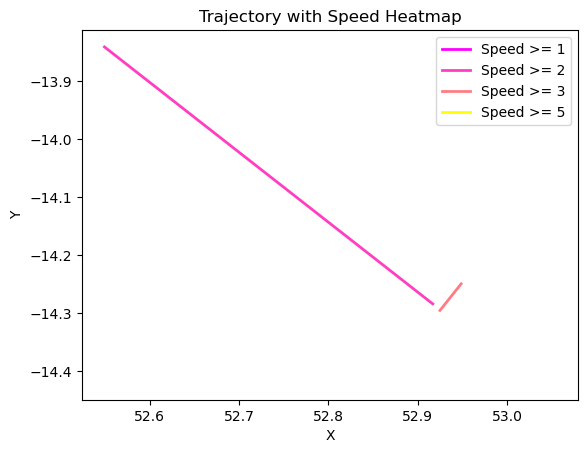

F/V ARGELES


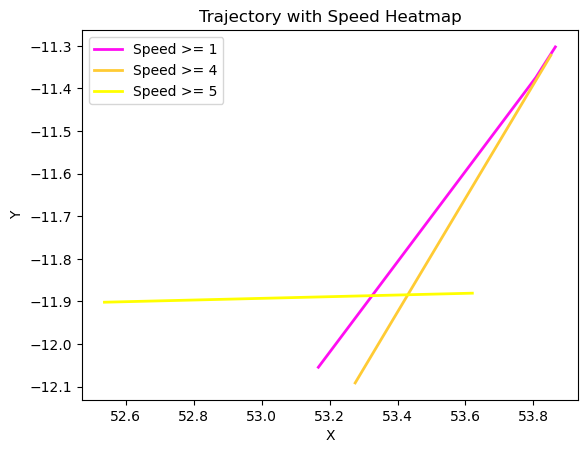

F/V MAR MARES


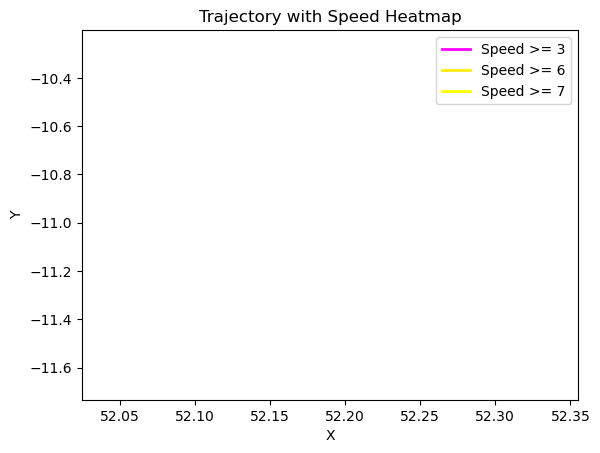

F/V PLAYA DE TUYA


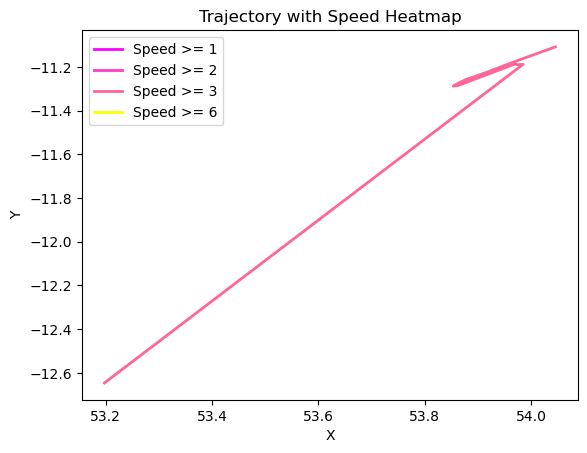

FV/BEOTHUK


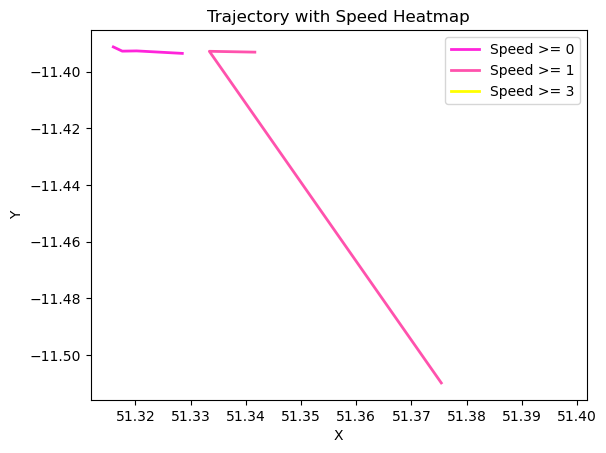

F/V LANDORA


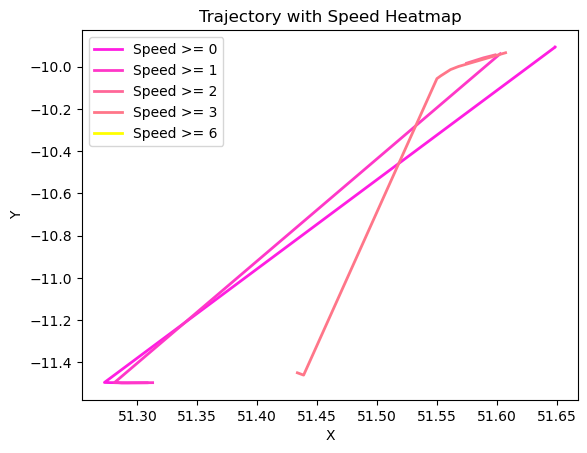

F/V RABELAIS


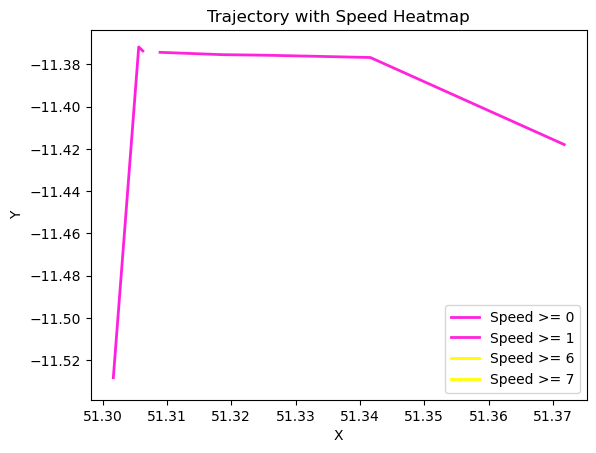

F/V CAP BOJADOR


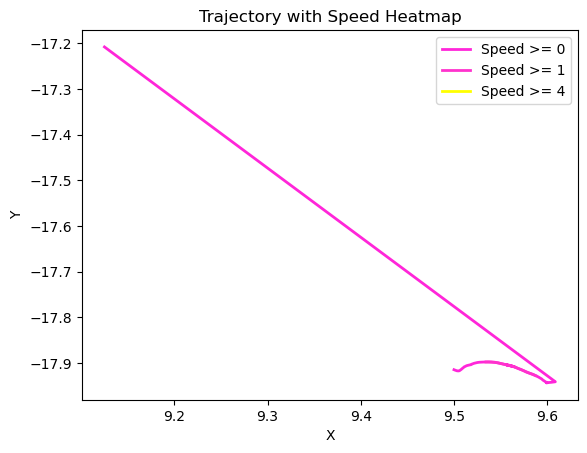

F/V GUEOTEC


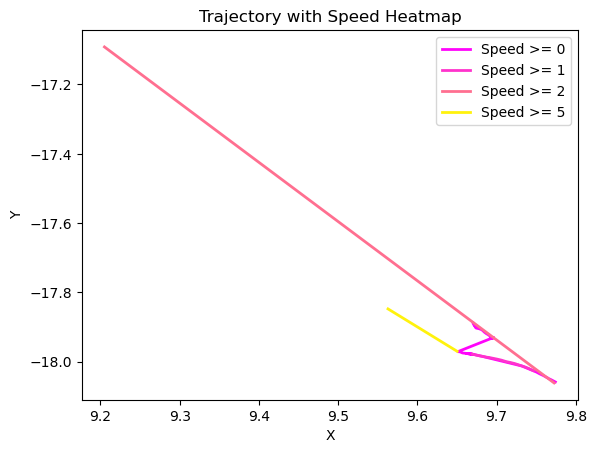

F/V SYLVANNA


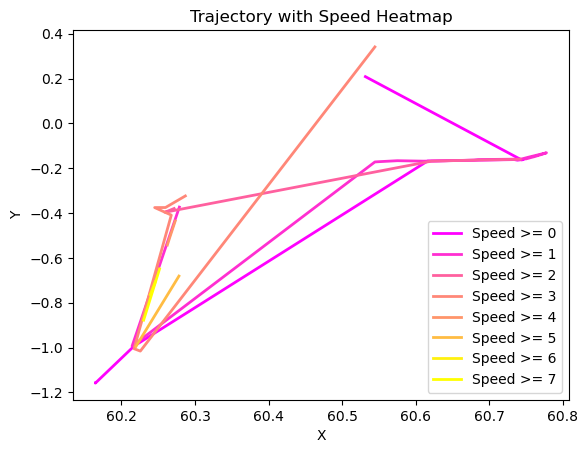

FV FERREIRA MARTINEZ


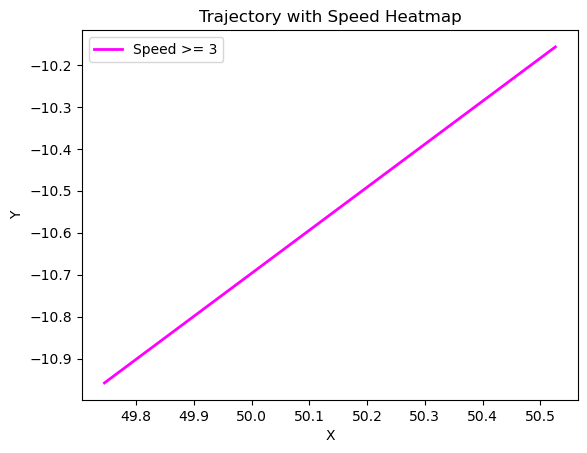

F/V SIEMPRE VIRIATO


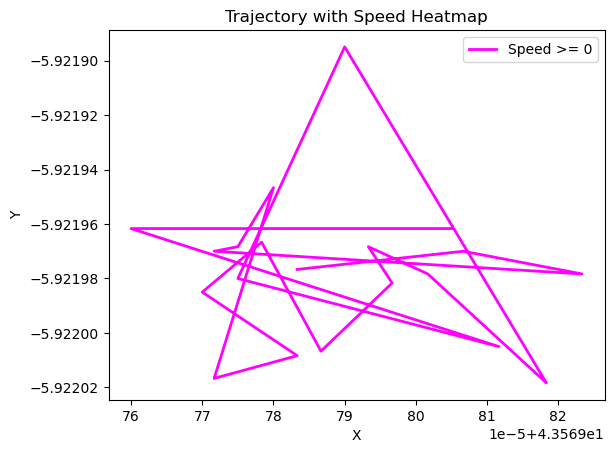

F/V LARCHE


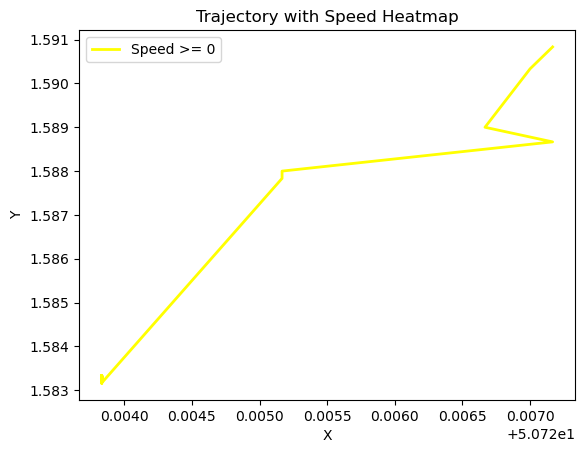

F/V MELODIE


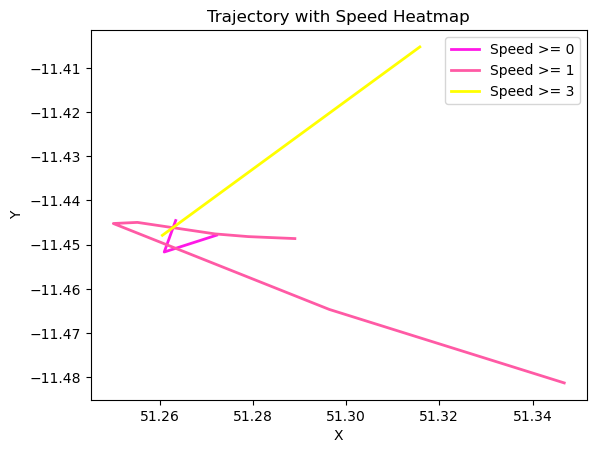

F/V LOIRA


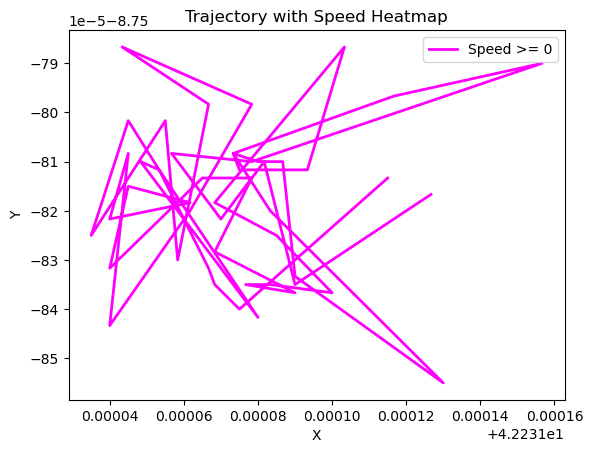

F/V ANTONIO MARIA


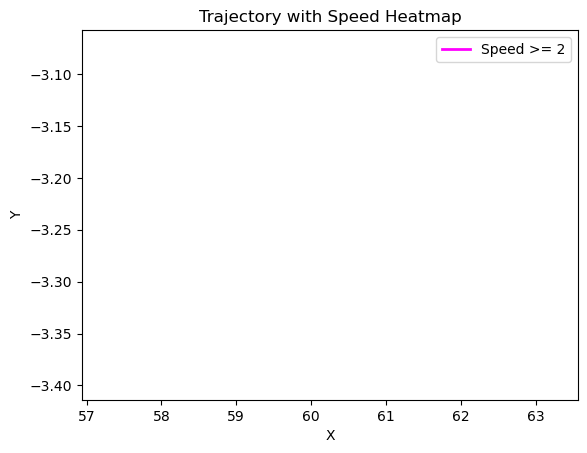

F/V CUCA


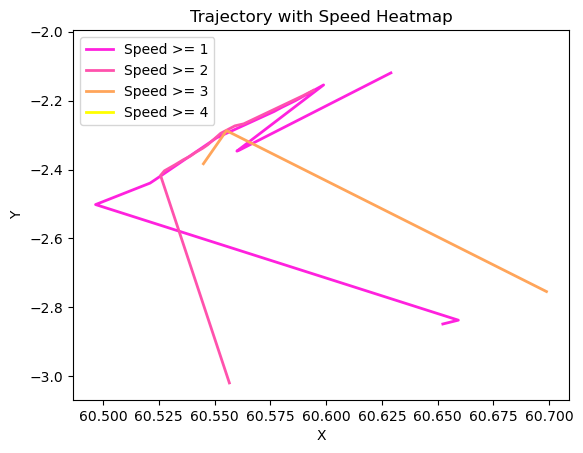

F/V GURE ANDRE


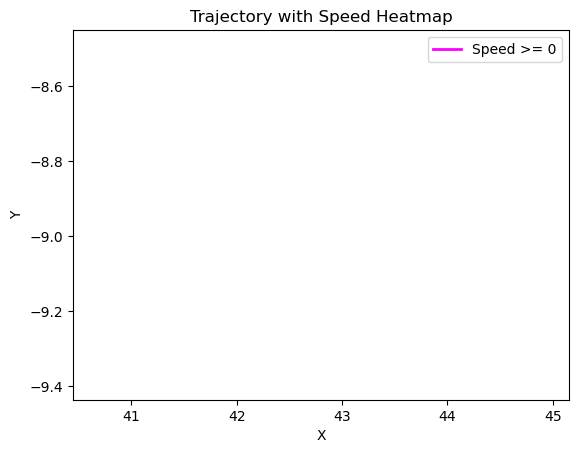

F/V ANNE ANTOINE 2


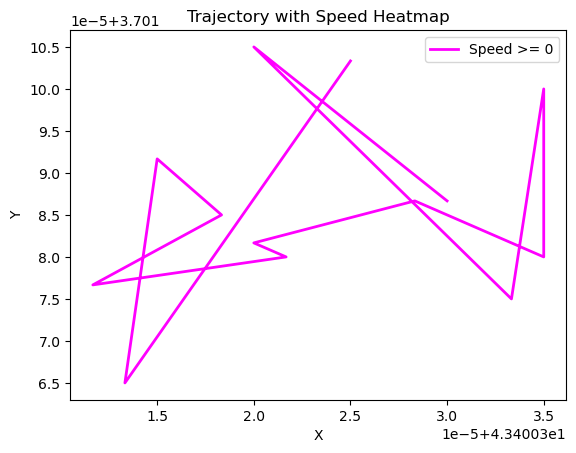

F/V LE RESSAC


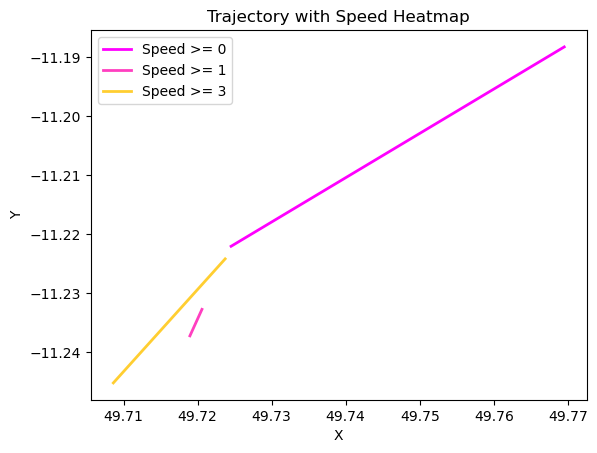

F/V R0NSARD


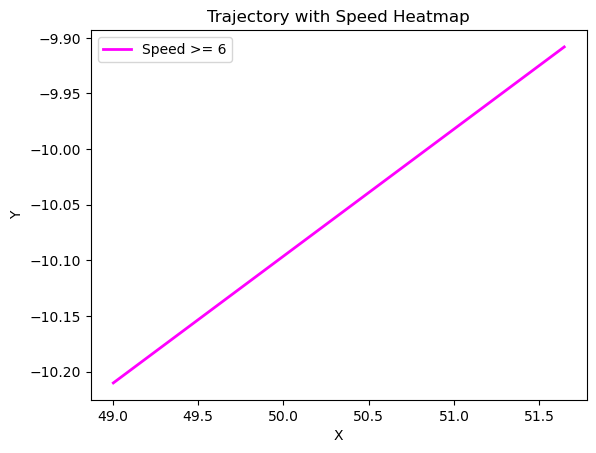

F/V LE CROTELLOIS


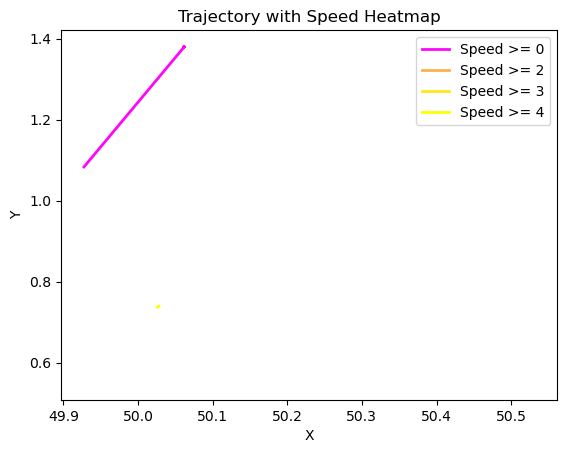

F/V YANNICK


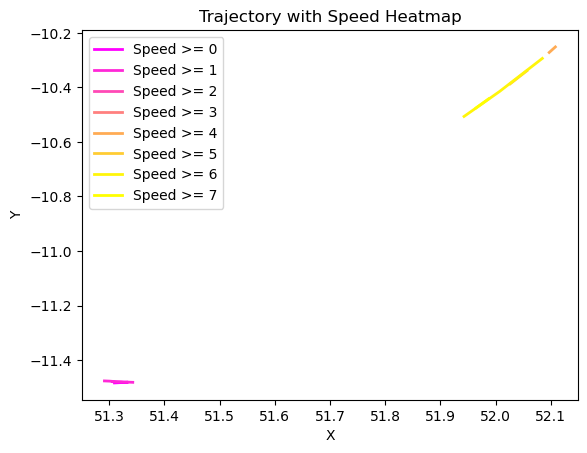

BRESSAY-BANK PAIR TR


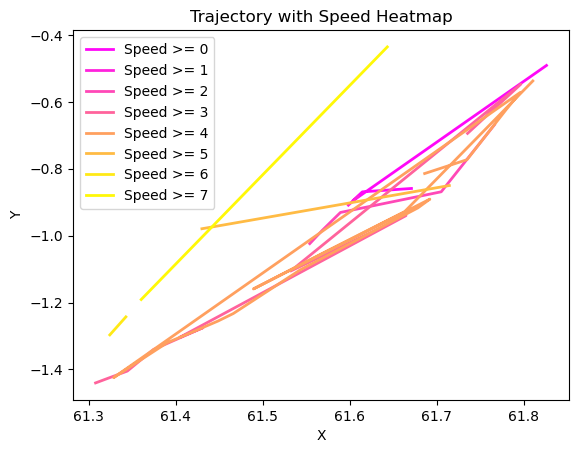

CAP SAINT GEORGES


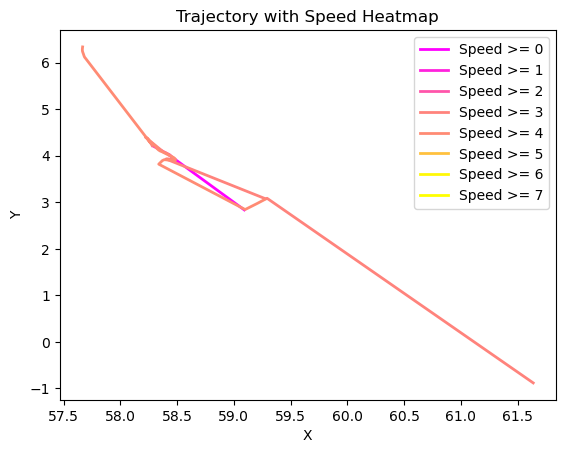

F/V LE STIFF


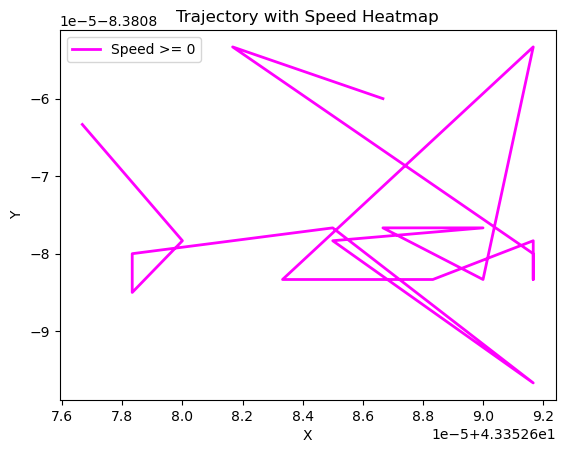

F/V SILURE


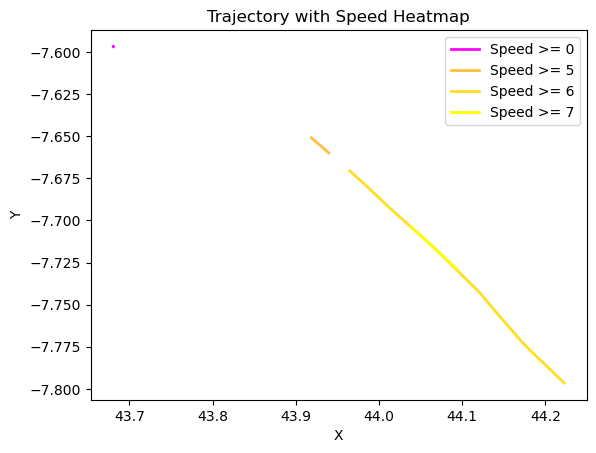

F/V CROIX MORAND


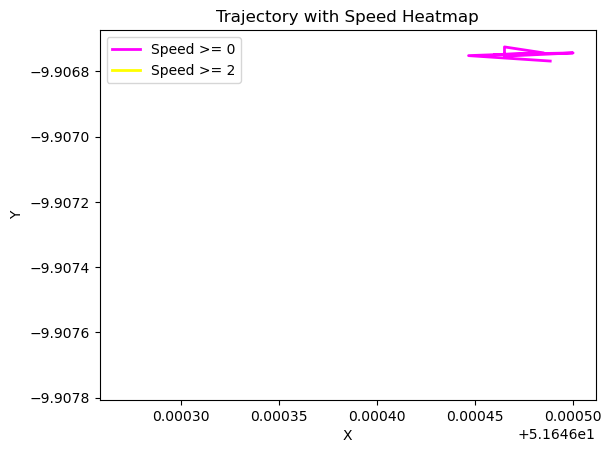

F/V RADOCHE TERCERO


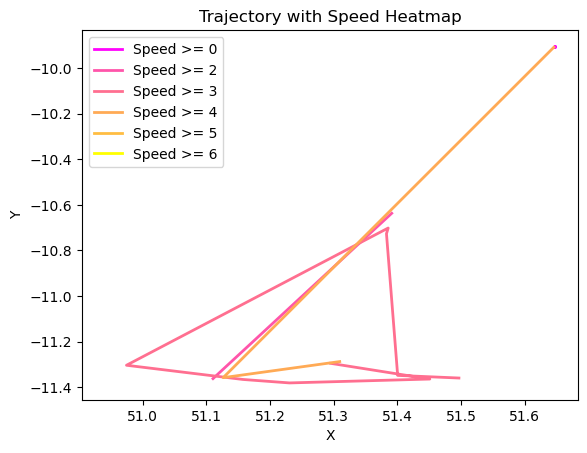

F/V FASTNET


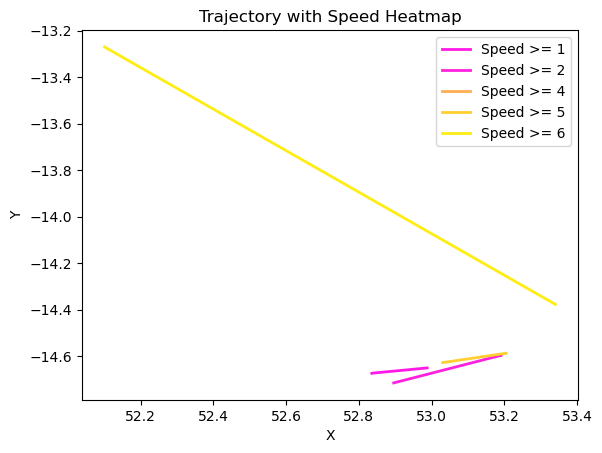

F/V CARLA


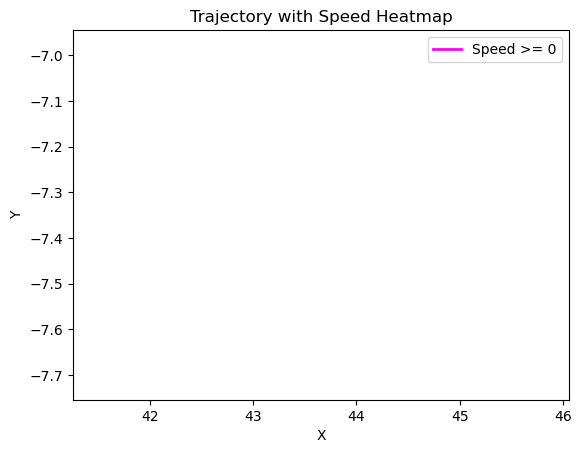

F/V ARMOR II


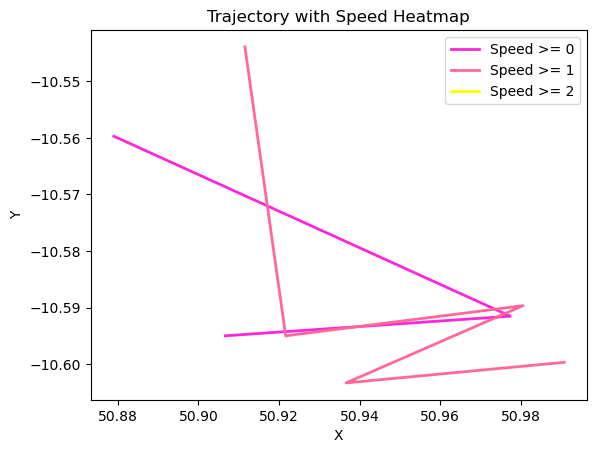

F/V M. LE ROCH 2


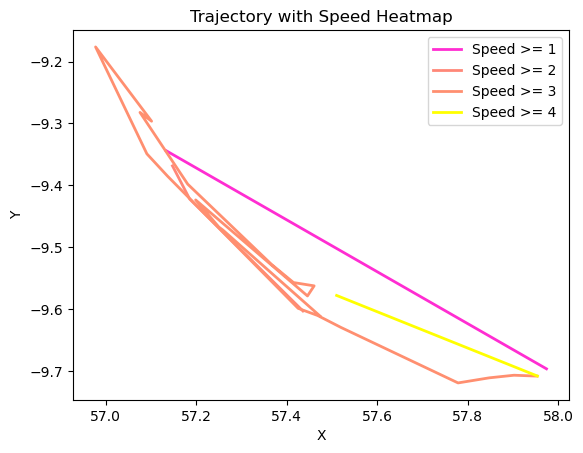

SCOMBRUS
F/V JP LE ROCH


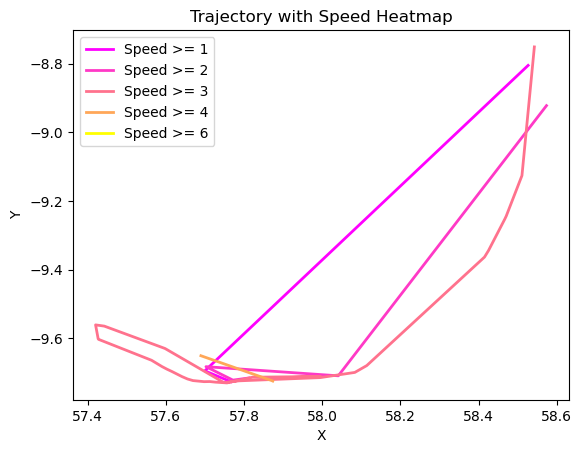

F/V LAPALOMA II


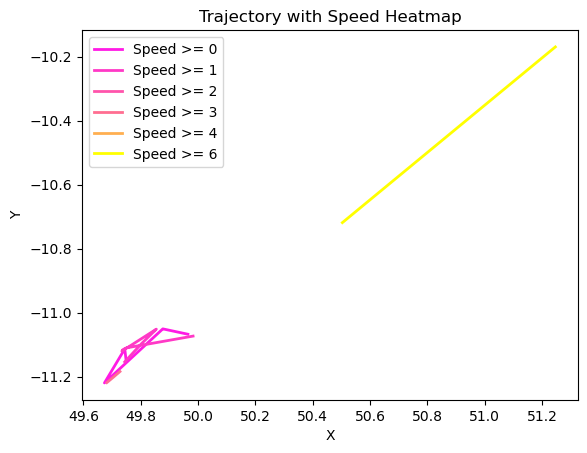

F/V GEVRED


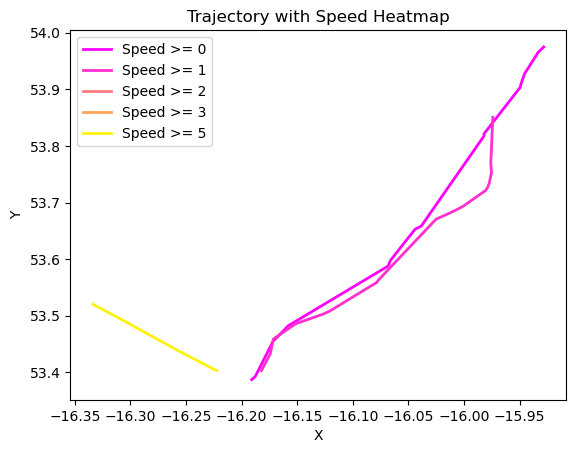

F\V LUDOVIC GEOFFRAY


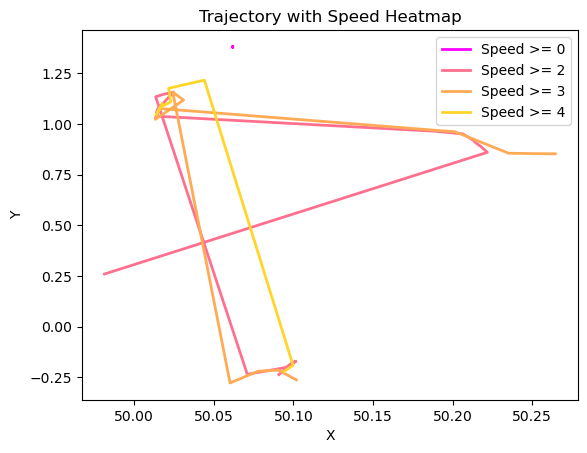

F/V FARO PICAMILLO


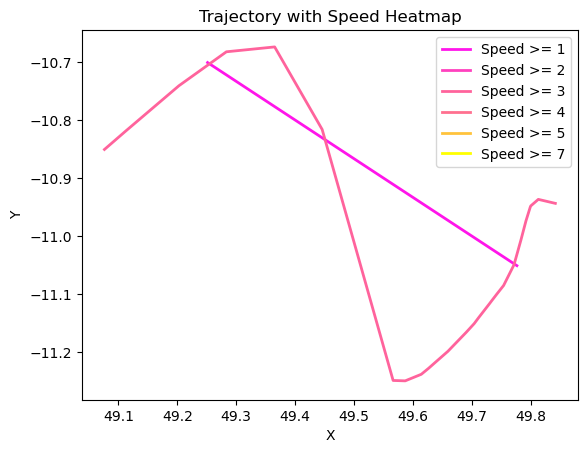

F/V CAP FINISTERE


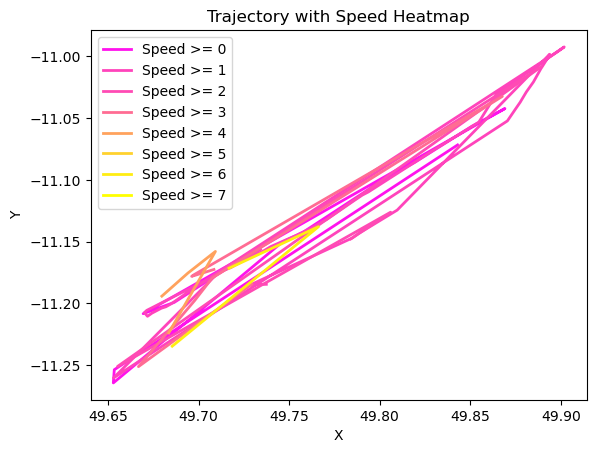

F/V NAONED


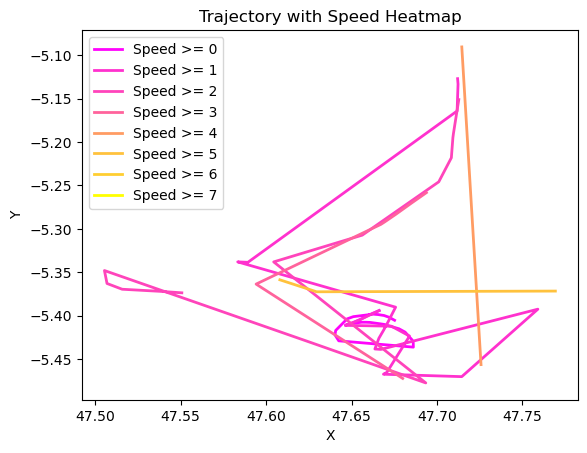

F/V VENT DU NORD II


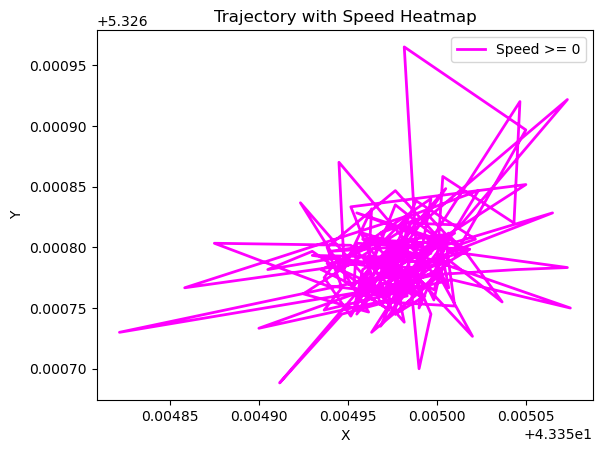

F/V PEDRA BLANCA II


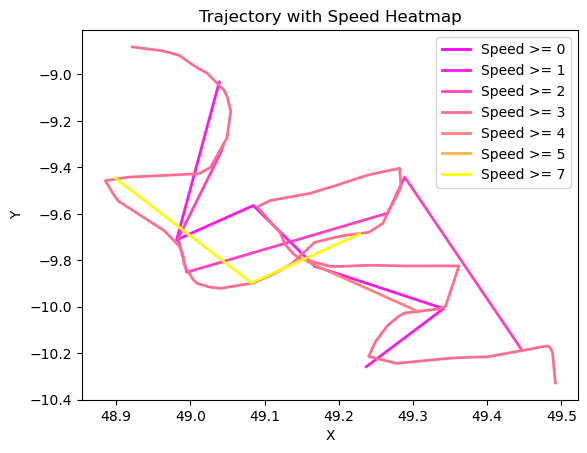

F/V MAR DE FLORES


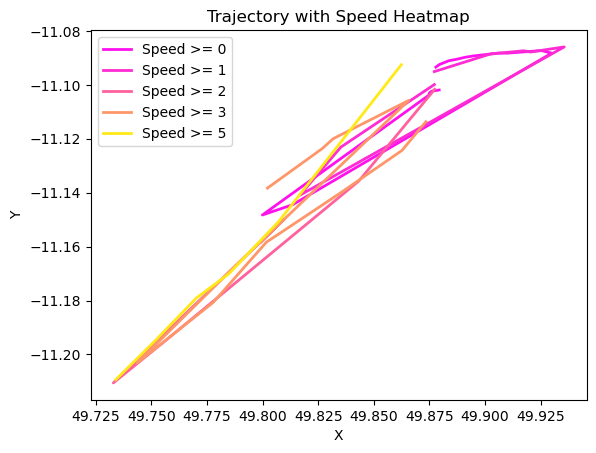

F/V IBARDIN


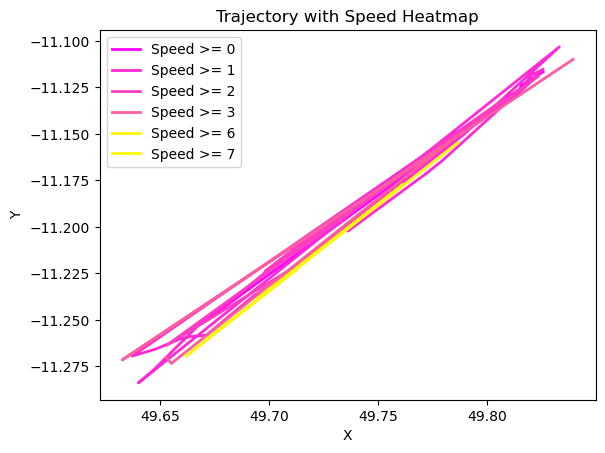

F/V AGORRETA


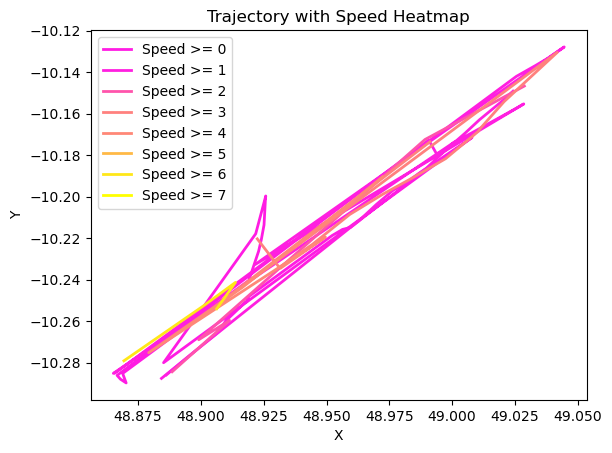

F/V LA TRINITE


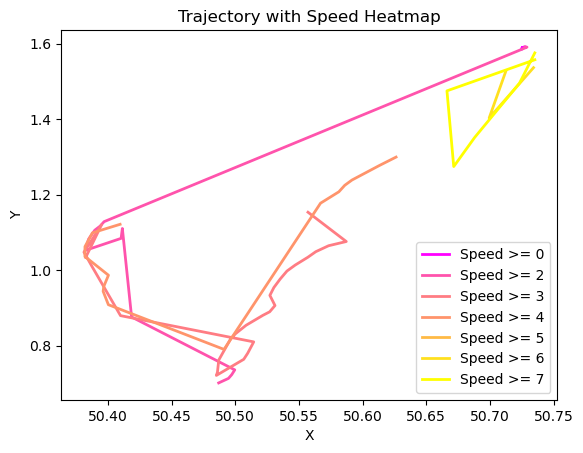

F/V MEABAN


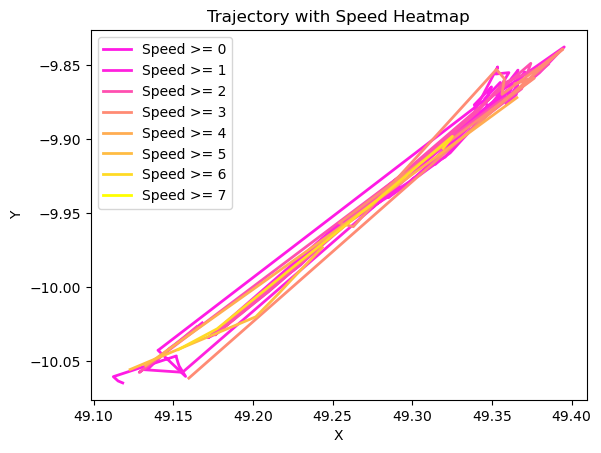

F/V EMERAUDE


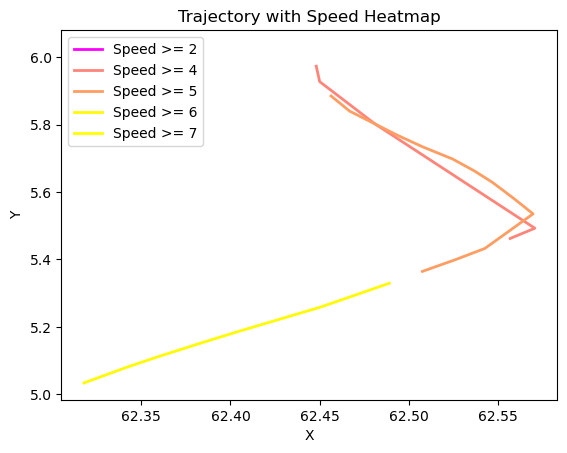

CAP ST MARIE


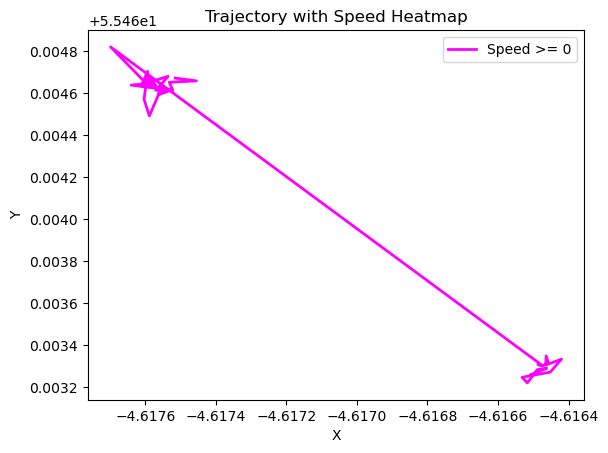

F/V NICOLAS JEREMY


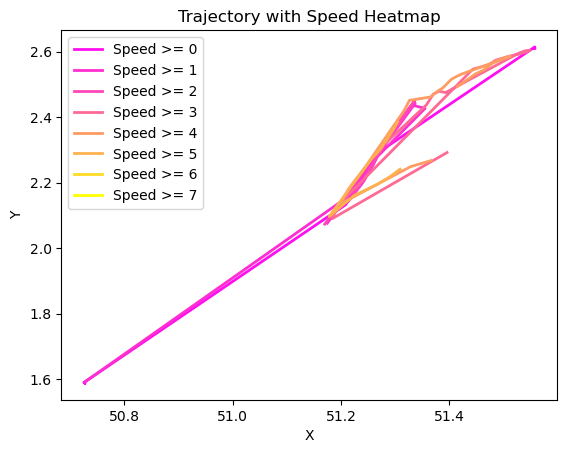

LE DOLMEN


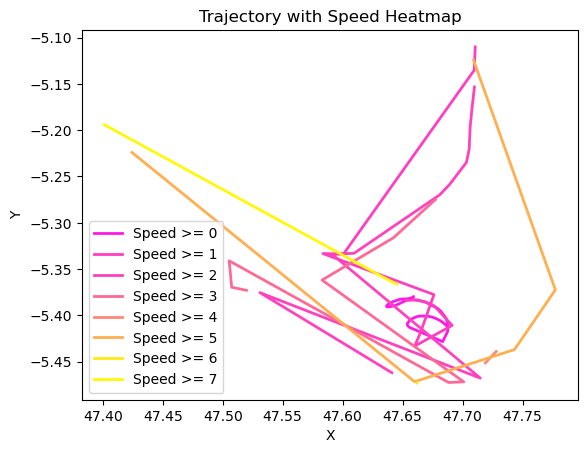

F/V MERCATOR


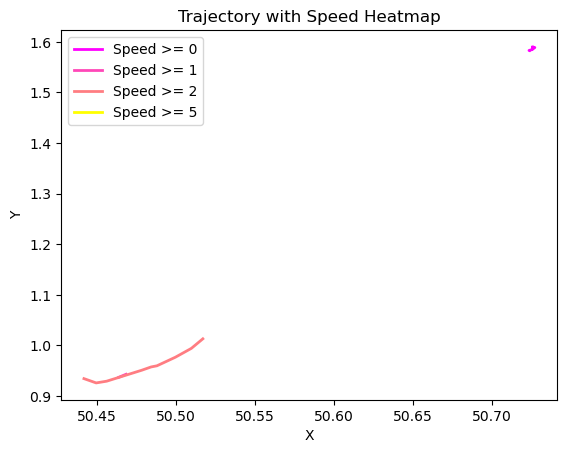

F/V PENDRUC


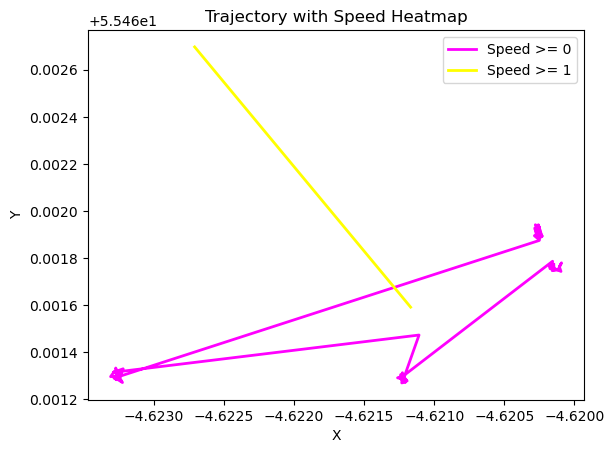

F/V LAREDO


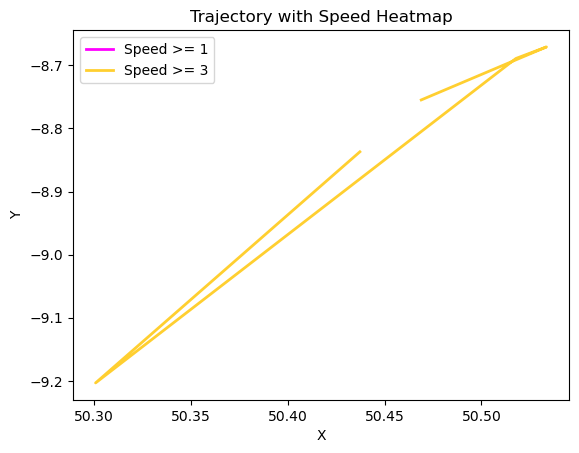

F/V RIO DA BOUZA


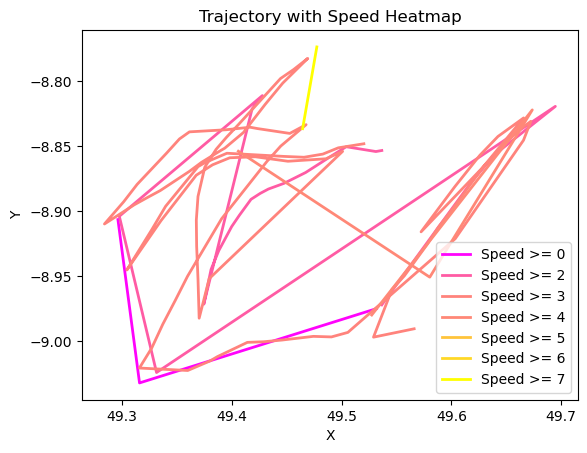

OTTER BANK F/V


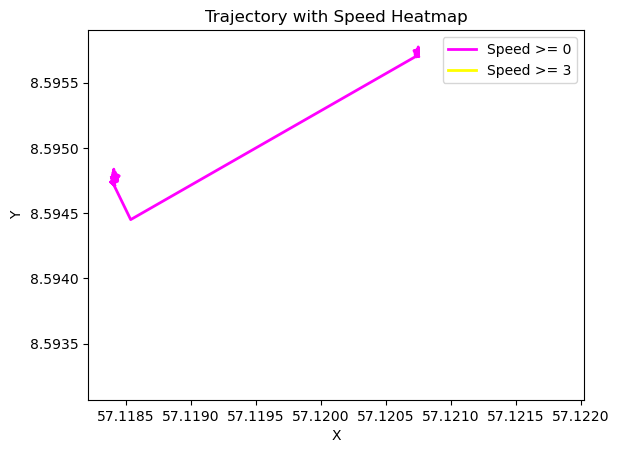

F/V GURE AMETZA II


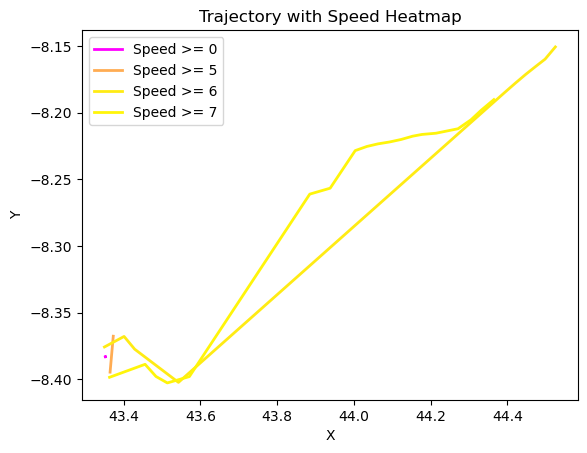

F/V VIA AVENIR


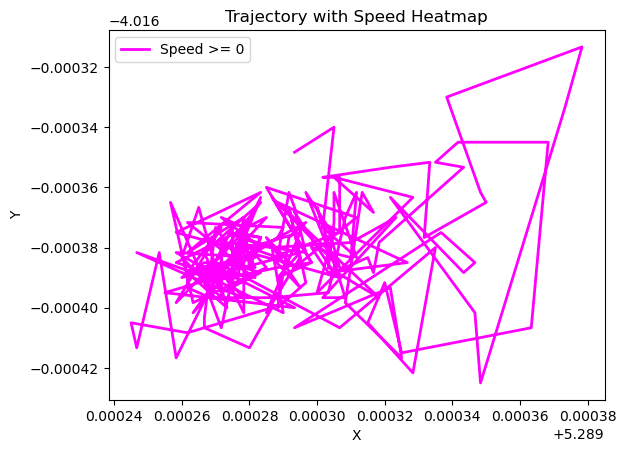

F/V FARPESCA


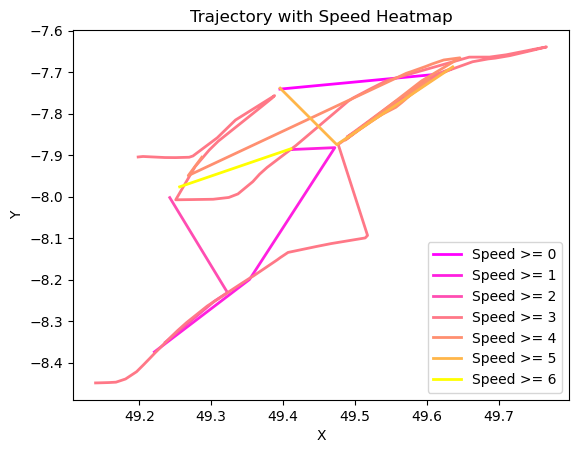

F/V LE MARMOUSET 3


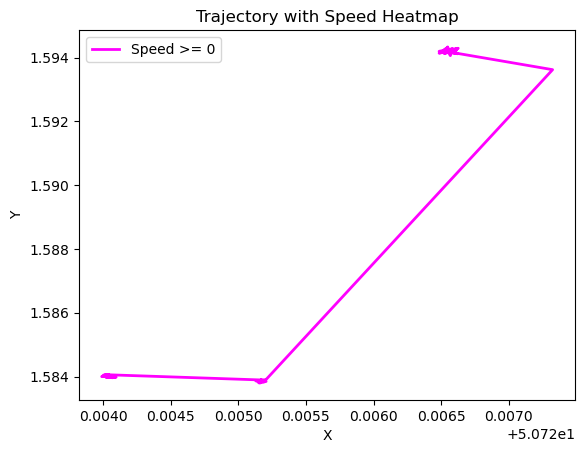

VIA ALIZE


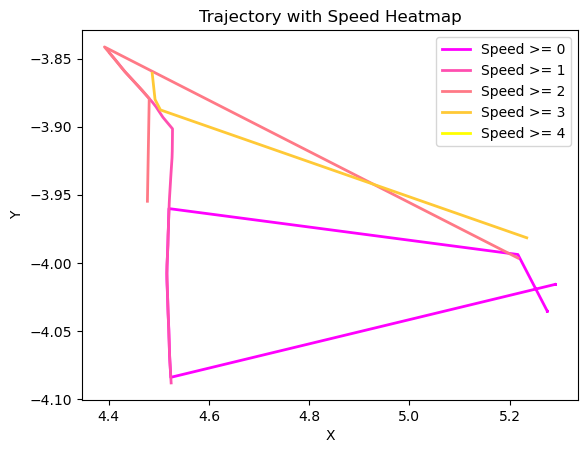

F/V NOTRE DAME DE B


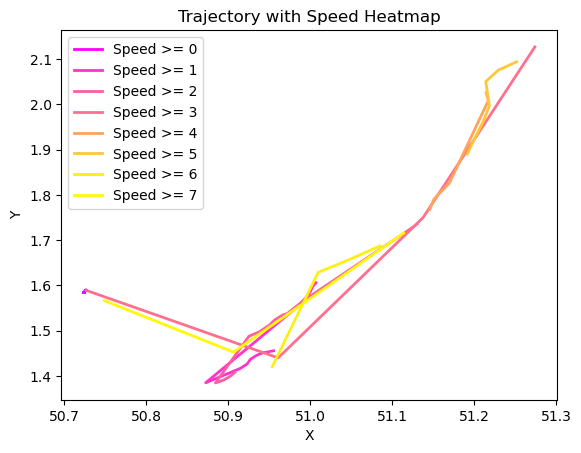

F/V TOURMALET


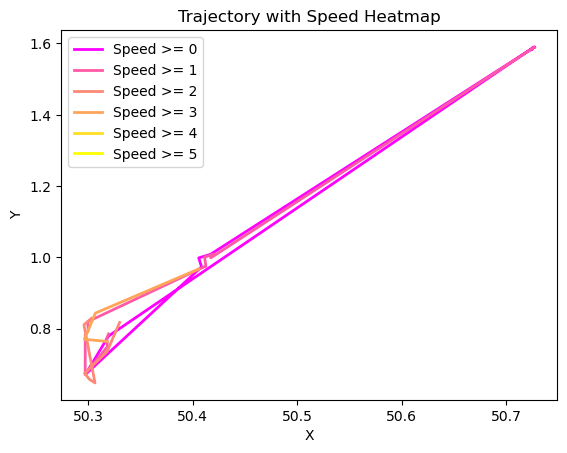

F/V MARIA MAGDALENA


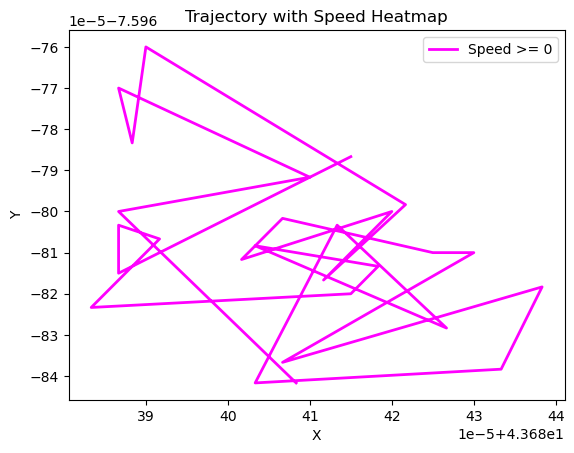

F/V VIA MISTRAL


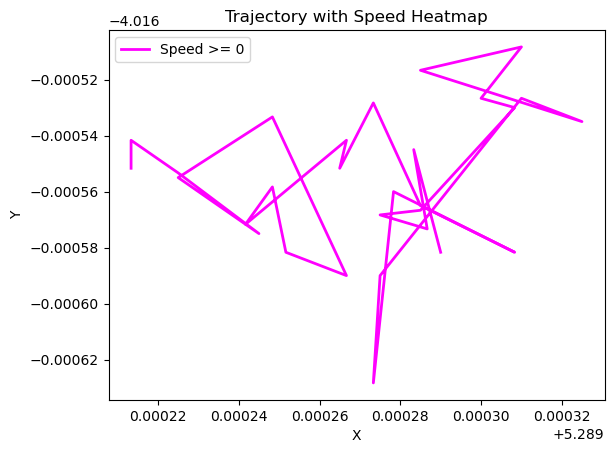

F/V J.L.RAPHAEL 2


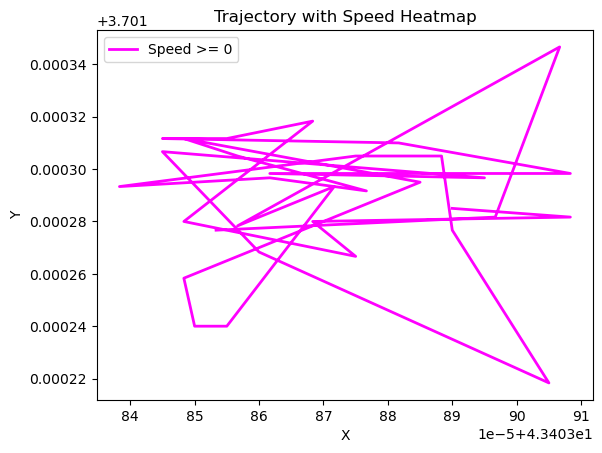

F/V PEDRA BLANCA


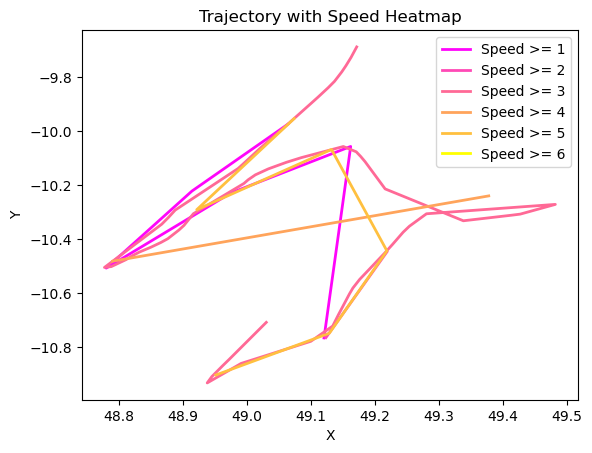

F/V J.M.CHRISTIAN 6


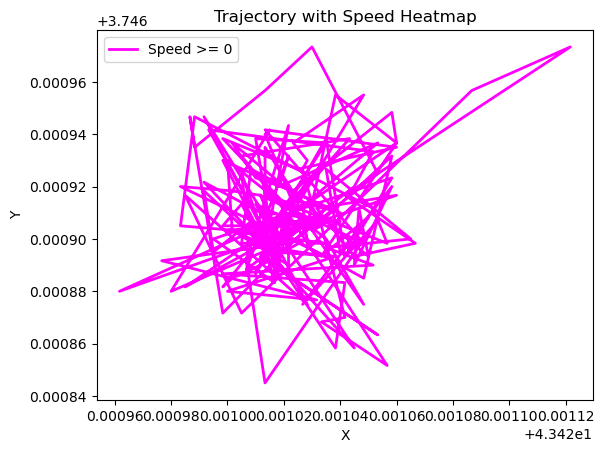

F/VJANVIER L.RAPHAEL
PRINS BERNHARD


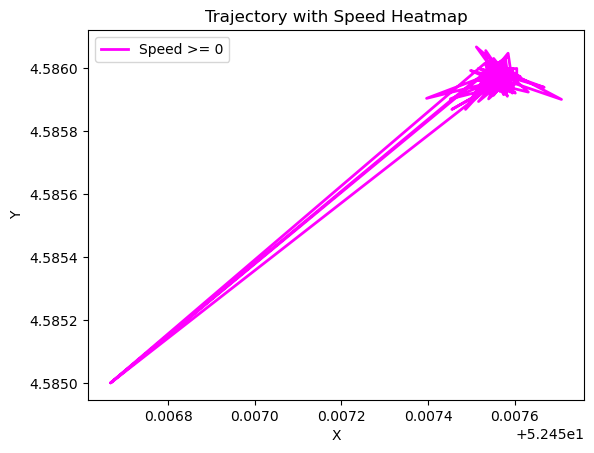

F/V JULIEN COLEOU


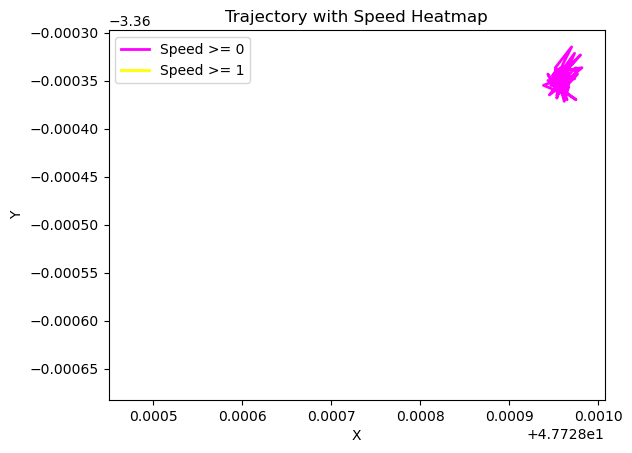

F/V GUERIDEN


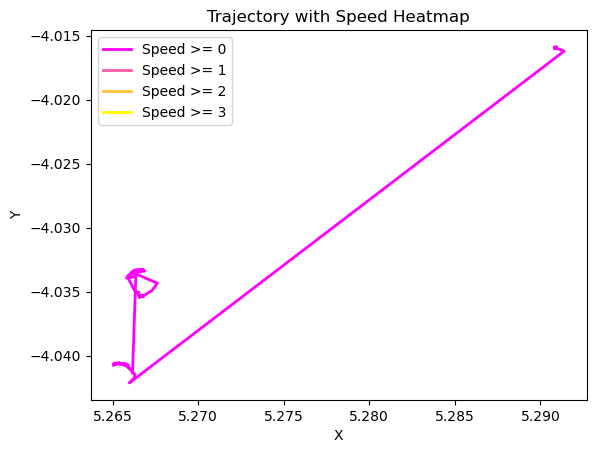

F/V MANUREVA


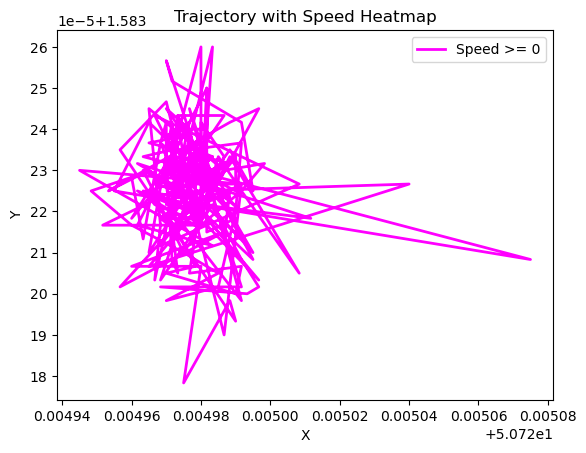

F/V MADELEINE


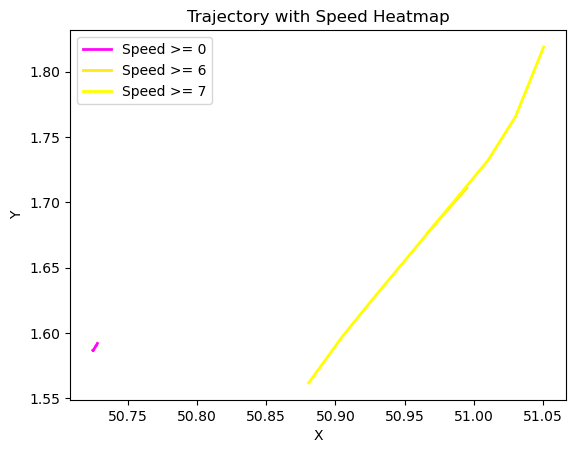

F/V ANDRE LEDUC


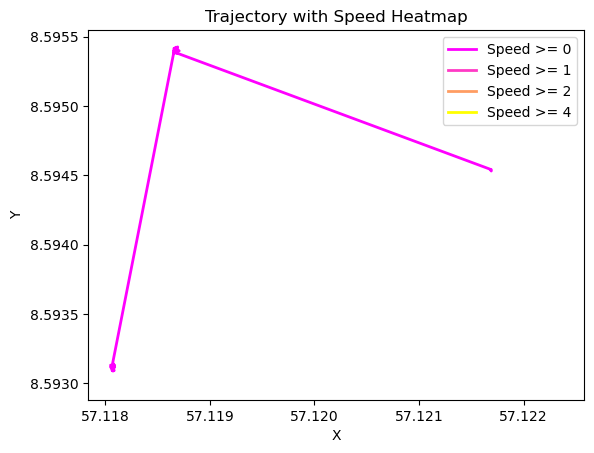

FISHER BANK


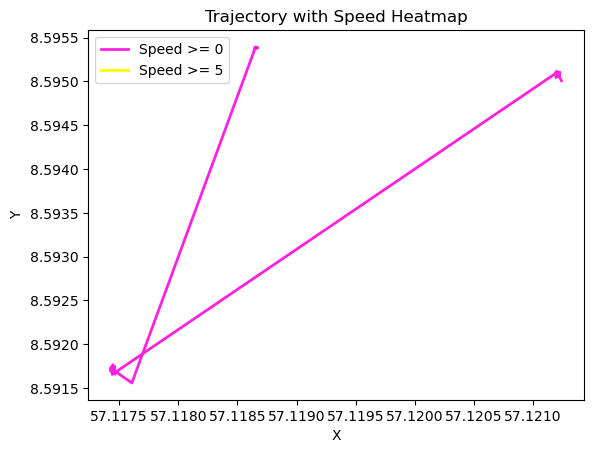

F/V PAX DEI II


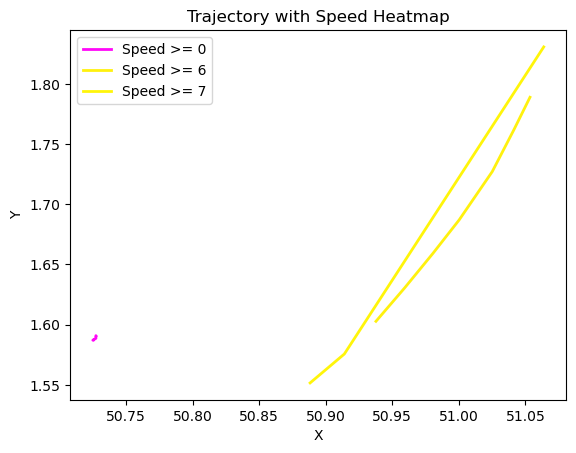

F/V J.M.CHRISTIAN 7


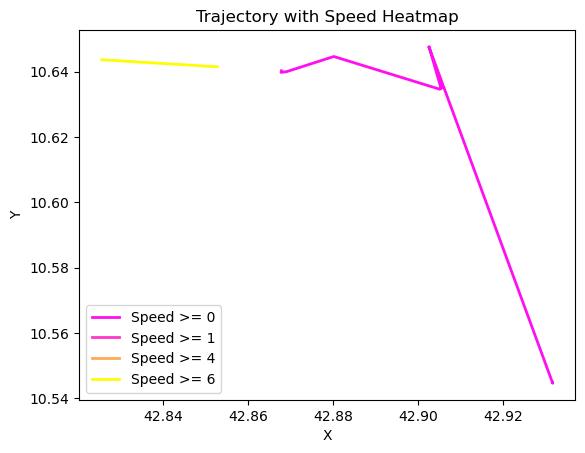

IndexError: index 112 is out of bounds for axis 0 with size 112

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

for j in range(200):
    df_ = df[(df['vessel_name'] == df['vessel_name'].unique()[j]) & (df['position_speed'] < 7.5)]
    print(df[(df['position_speed'] >=0)]['vessel_name'].unique()[j])
    if len(df_[df_['position_speed'] >= 0]) > 20 :
        x = df_['position_latitude']
        y = df_['position_longitude'] 
        speed = df_['position_speed']
        num_points = len(df_)

        # Define speed thresholds for heatmap
        speed_thresholds = [0,1,2,3,4,5,6,7]  # Example thresholds

        # Calculate speed segments
        speed_segments = np.digitize(speed, speed_thresholds)

        # Create colormap for heatmap
        cmap = plt.get_cmap('spring') #hot

        # Plot trajectory as lineplot with segments colored by speed
        for i in range(1, len(speed_thresholds) + 1):
            mask = speed_segments == i
            if np.any(mask):
                segment_x = x[mask]
                segment_y = y[mask]
                segment_speed = speed[mask]
                segment_color = cmap(Normalize(vmin=min(speed), vmax=max(speed))(segment_speed))
                plt.plot(segment_x, segment_y, color=segment_color[0], linewidth=2, label=f'Speed >= {speed_thresholds[i-1]}')

        # Add colorbar
        sm = ScalarMappable(cmap=cmap, norm=Normalize(vmin=min(speed), vmax=max(speed)))
        sm.set_array(speed)
        #plt.colorbar(sm, label='Speed')

        # Add labels and legend
        plt.xlabel('X')
        plt.ylabel('Y')
        plt.title('Trajectory with Speed Heatmap')
        plt.legend()

        # Show plot
        plt.show();


F/V GERALD-JEAN 3
2267     42.51664
16267    42.51664
18619    42.51664
12123    42.51664
7531     42.51664
           ...   
11451    42.51664
21195    42.51664
6411     42.51664
17051    42.51664
1371     42.51664
Name: position_latitude, Length: 194, dtype: float64


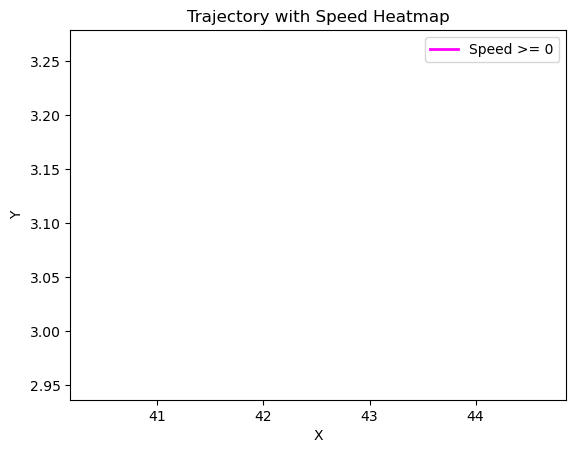

F/V ASPIN
16263    43.321483
12455    43.321483
17271    43.321483
11223    43.321483
14583    43.321483
           ...    
7303     43.321483
23       43.321483
10775    43.321483
1591     43.321483
3383     43.321483
Name: position_latitude, Length: 194, dtype: float64


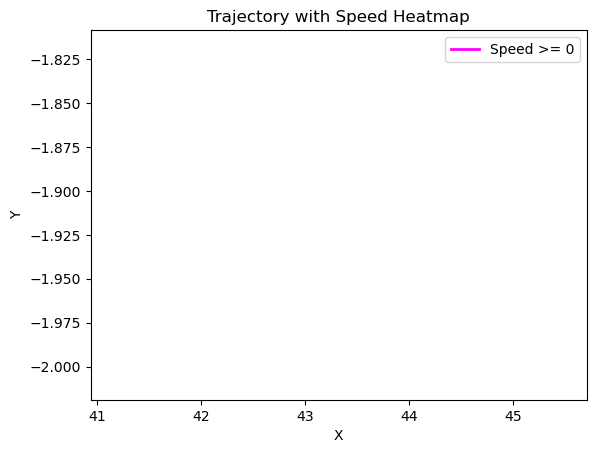

CHRISDERIC V
6572     42.6208
9148     42.6208
19900    42.6208
13292    42.6208
8028     42.6208
          ...   
5004     42.6208
16092    42.6208
14188    42.6208
20348    42.6208
17324    42.6208
Name: position_latitude, Length: 194, dtype: float64


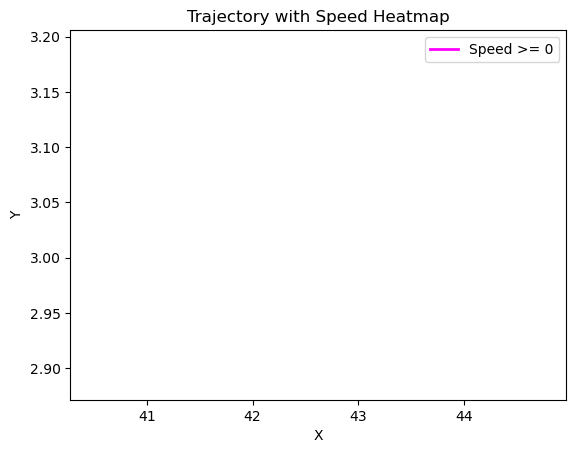

F/V GERALD JEAN IV
12670    42.516608
1022     42.516608
14350    42.516608
9198     42.516608
13790    42.516608
           ...    
17822    42.516608
350      42.516608
18606    42.516608
12110    42.516608
16702    42.516608
Name: position_latitude, Length: 194, dtype: float64


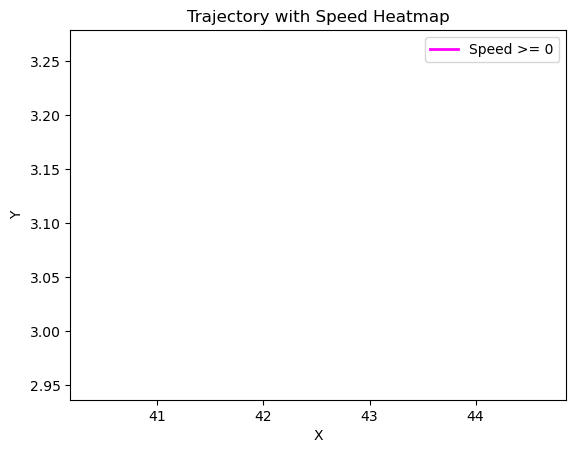

F/V  J.M.CHRISTIAN 4
7909     43.399867
7461     43.399867
965      43.399867
1413     43.399867
9813     43.399867
           ...    
21237    43.400393
21349    43.400373
21461    43.400397
21573    43.400410
21685    43.400392
Name: position_latitude, Length: 194, dtype: float64


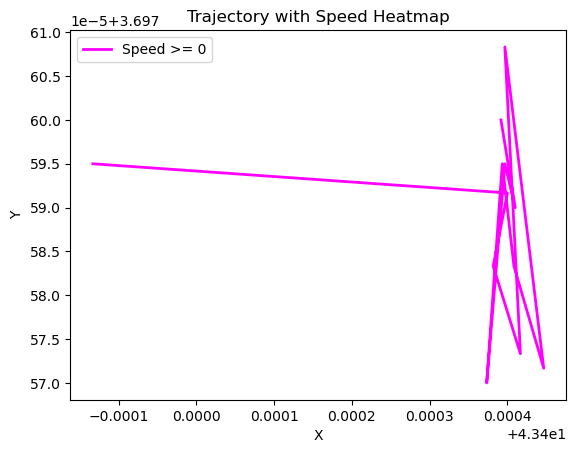

F/V GLENAN
7390    -4.616523
1566    -4.616523
20718   -4.616523
4926    -4.616523
3246    -4.616523
           ...   
18702   -4.616523
8846    -4.616523
5262    -4.616523
16126   -4.616523
4142    -4.616523
Name: position_latitude, Length: 194, dtype: float64


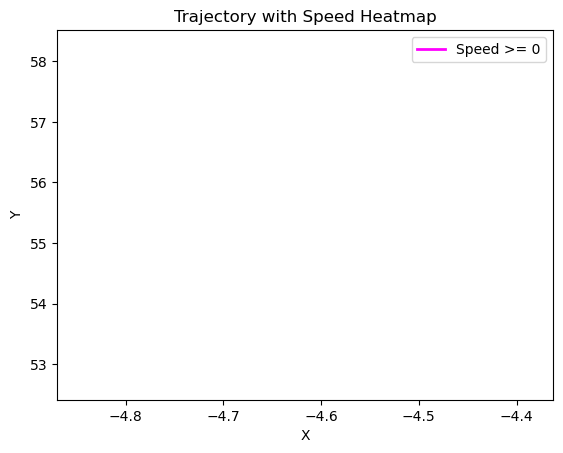

CAP SAINT VINCENT
5610    -4.620093
2362    -4.620093
2026    -4.620093
6506    -4.620093
2138    -4.620093
           ...   
20058   -3.184188
12218   -3.184188
15914   -3.184188
16362   -3.184188
15242   -3.184188
Name: position_latitude, Length: 194, dtype: float64


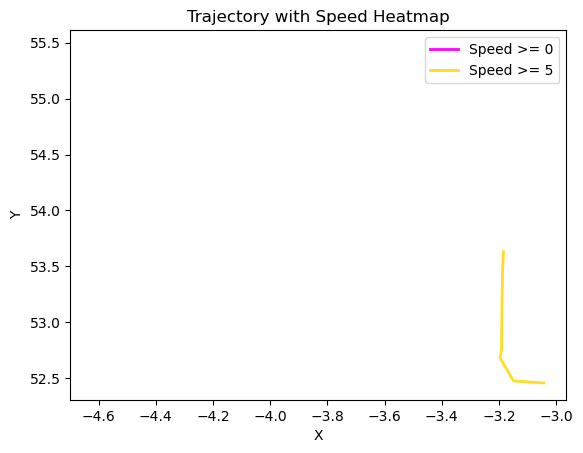

F/V TH0MAS NICOLAS 2
2128     50.351902
2912     50.351902
2352     50.351902
3472     50.351902
3024     50.351902
           ...    
18928    50.725885
15792    50.725885
16240    50.725885
20944    50.725885
16688    50.725885
Name: position_latitude, Length: 194, dtype: float64


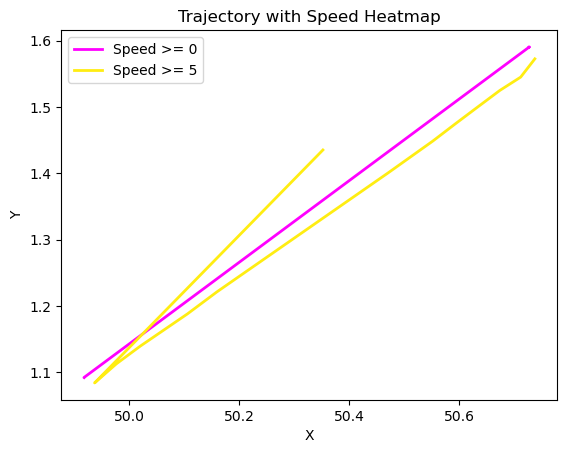

AVEL VAD
5119    -4.61601
4559    -4.61601
7584    -4.61601
7023    -4.61601
3551    -4.61601
          ...   
5007    -4.61601
10159   -4.61601
11615   -4.61601
4895    -4.61601
3103    -4.61601
Name: position_latitude, Length: 194, dtype: float64


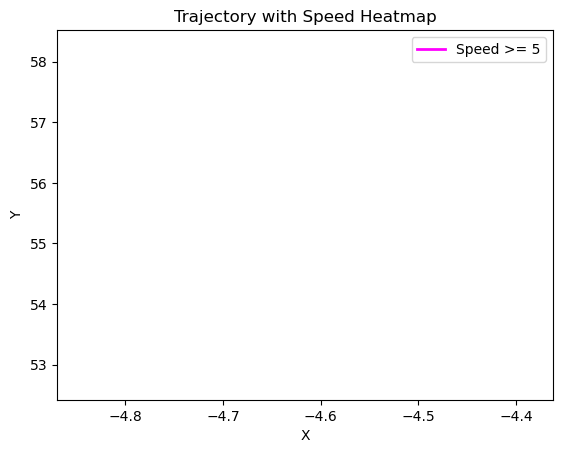

NOTRE DAME CEDEIRA
7910     43.679835
3430     43.679835
11718    43.679835
15974    43.679835
21126    43.679835
           ...    
6118     43.679835
4662     43.679835
17094    43.679835
20790    43.679835
9814     43.679835
Name: position_latitude, Length: 194, dtype: float64


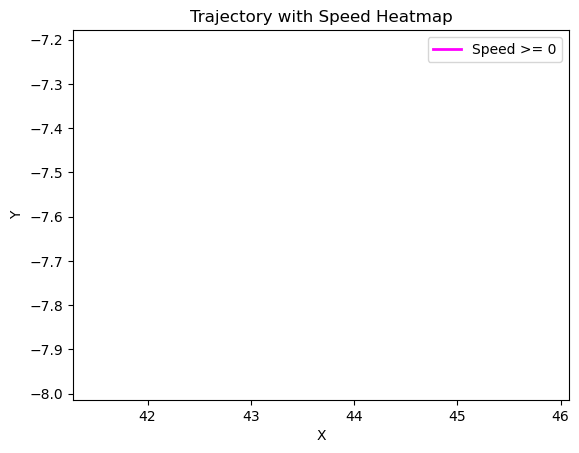

F/V STEMARIELAMERII
212      50.062538
660      50.062538
548      50.062538
436      50.062538
100      50.062538
           ...    
21268    49.972723
21380    49.982907
21492    49.996132
21604    50.004495
21716    50.010063
Name: position_latitude, Length: 194, dtype: float64


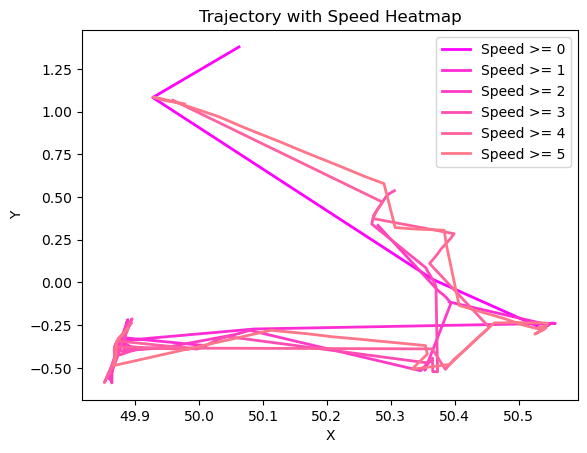

CAP HORIZON
8440     43.401667
2616     43.401667
1496     43.401667
2392     43.401667
152      43.401667
           ...    
21208    43.403055
21320    43.403108
21432    43.403105
21544    43.403067
21656    43.403080
Name: position_latitude, Length: 194, dtype: float64


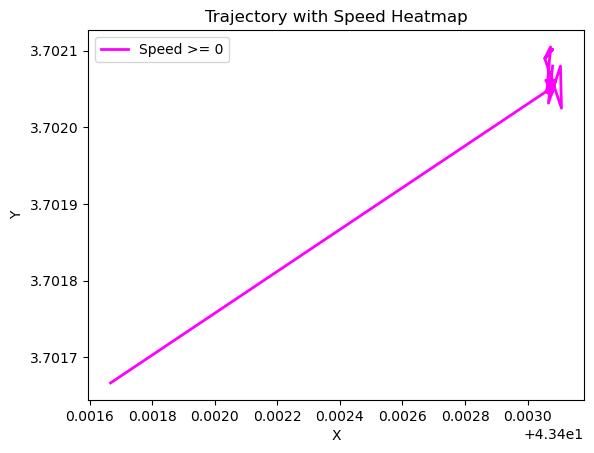

SCAPIRIA 1
3378     43.681505
1810     43.681505
4050     43.681505
578      43.681505
466      43.681505
           ...    
15810    43.656040
14130    43.656040
19170    43.656040
18946    43.656040
16482    43.656040
Name: position_latitude, Length: 194, dtype: float64


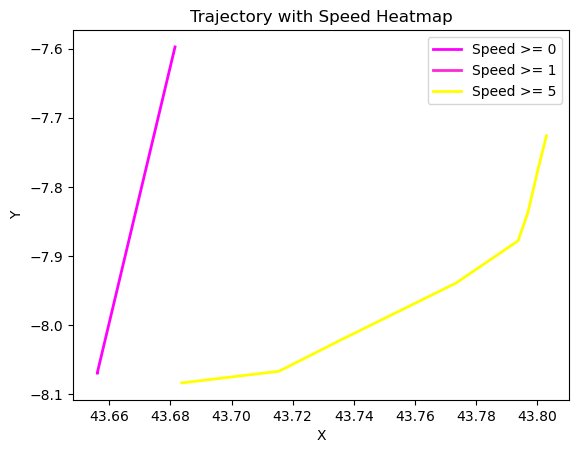

F/V ERIC MARIN
13044    43.404427
11812    43.404427
18196    43.404427
15284    43.404427
5092     43.404427
           ...    
19540    43.404427
21332    43.404427
6996     43.404427
3860     43.404427
8900     43.404427
Name: position_latitude, Length: 194, dtype: float64


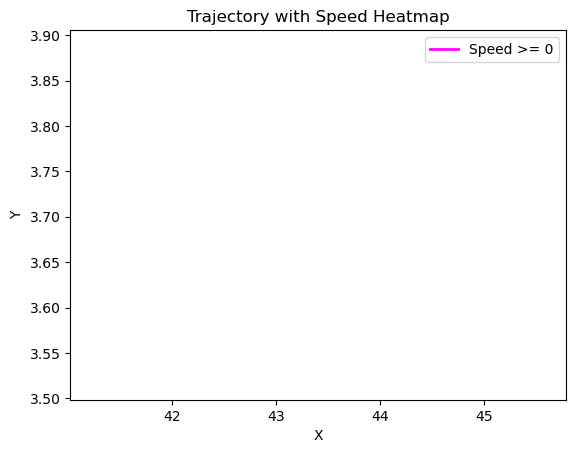

F/V VAUBAN
1163     49.345000
1051     49.345000
603      49.345000
155      49.345000
715      49.345000
           ...    
20987    49.346347
21435    49.346347
21099    49.346347
20427    49.346347
21323    49.346347
Name: position_latitude, Length: 194, dtype: float64


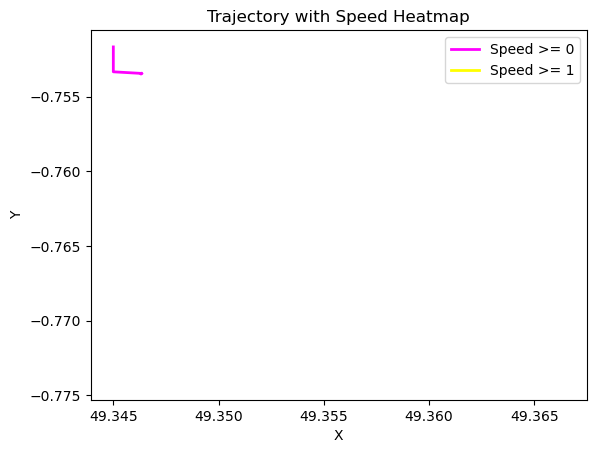

ROSE DE CASCIA
464      49.836320
912      49.836320
1136     49.836320
1024     49.836320
800      49.836320
           ...    
21184    50.723430
21296    50.723433
21408    50.723462
21520    50.723415
21632    50.723470
Name: position_latitude, Length: 194, dtype: float64


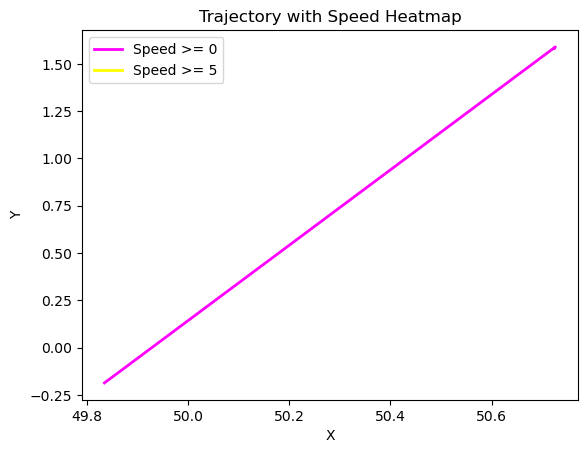

F/V CHRISDERIC2
16069    43.403542
16629    43.403542
8677     43.403542
16181    43.403542
3637     43.403542
           ...    
10133    43.403542
10805    43.403542
1173     43.403542
2069     43.403542
13269    43.403542
Name: position_latitude, Length: 194, dtype: float64


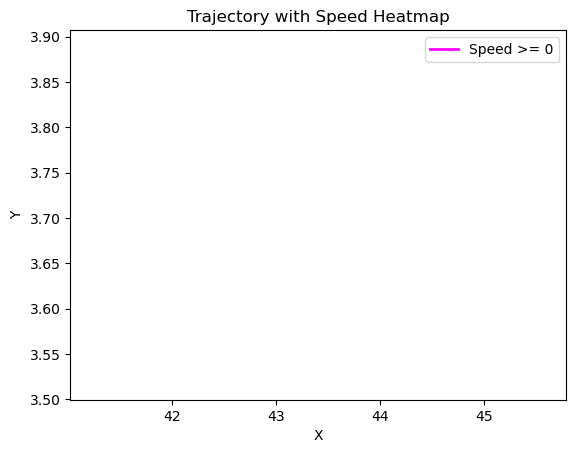

F/V GRAND ST BERNARD
1295     43.32218
11935    43.32218
2975     43.32218
10031    43.32218
15407    43.32218
           ...   
17423    43.32218
6111     43.32218
18319    43.32218
13503    43.32218
13951    43.32218
Name: position_latitude, Length: 194, dtype: float64


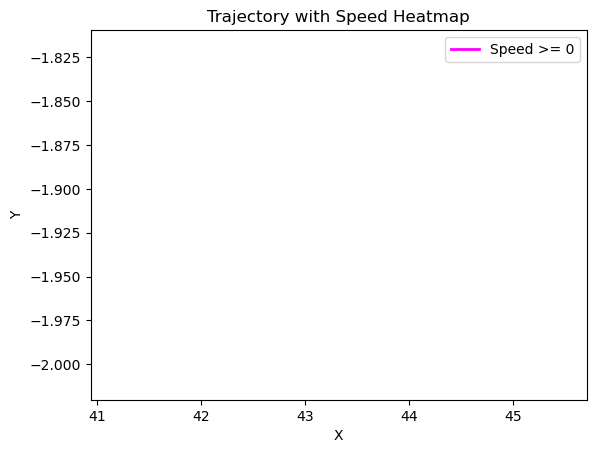

PUNTA VIXIA
9765     42.258372
2485     42.258372
4613     42.258372
18165    42.258372
15701    42.258372
           ...    
1141     42.258372
17493    42.258372
21       42.258372
1365     42.258372
11557    42.258372
Name: position_latitude, Length: 194, dtype: float64


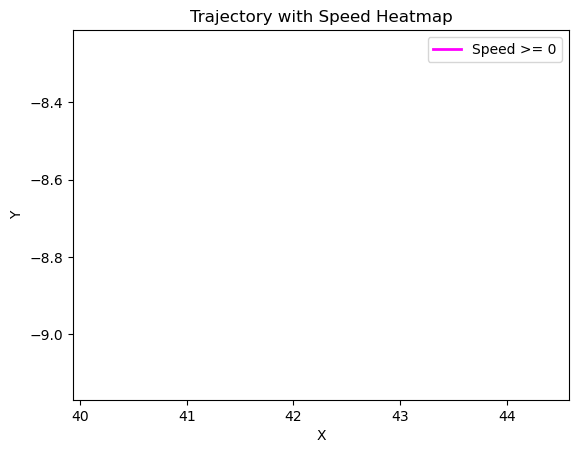

F/V J.M.CHRISTIAN 3
1923     43.399565
3603     43.399565
579      43.399565
18723    43.399565
3715     43.399565
           ...    
12675    43.399565
16931    43.399565
8195     43.399565
2371     43.399565
3491     43.399565
Name: position_latitude, Length: 194, dtype: float64


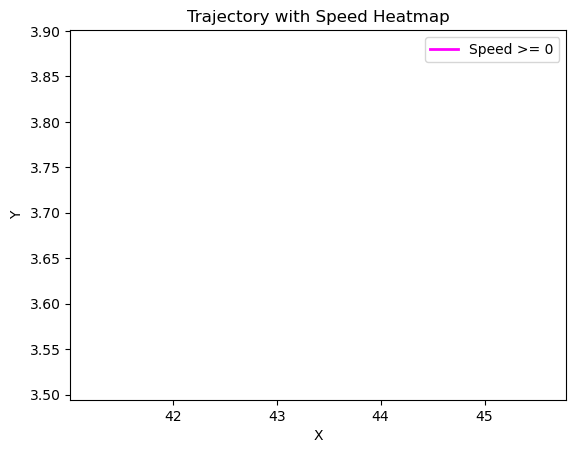

F/V CORONA DEL MAR
3272     14.684228
2040     14.684228
6072     14.684228
5176     14.684228
1144     14.684228
           ...    
21192    14.684775
21304    14.684753
21416    14.684767
21528    14.684745
21640    14.684762
Name: position_latitude, Length: 194, dtype: float64


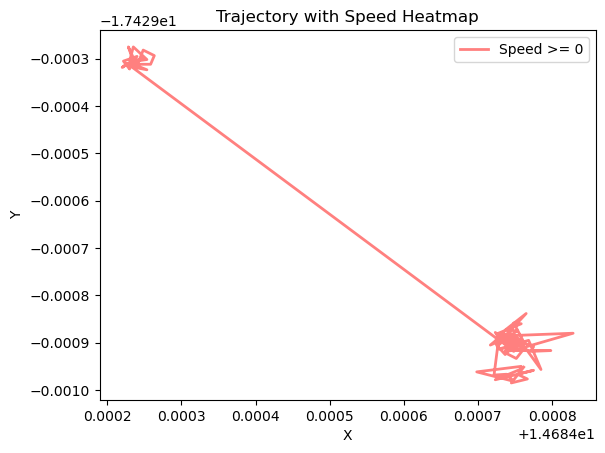

F/V ROSSOREN
1268     52.754833
148      52.754833
3172     52.754833
3284     52.754833
1492     52.754833
           ...    
17172    53.586865
16276    53.586865
17956    53.586865
20084    53.586865
15044    53.586865
Name: position_latitude, Length: 194, dtype: float64


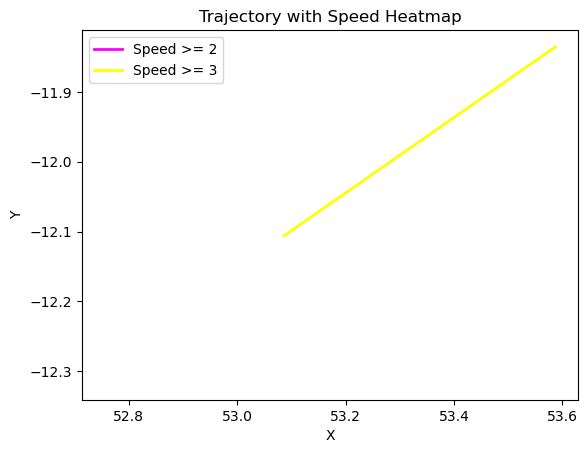

F/V BIKAIN
14591    43.334165
7871     43.334165
13135    43.334165
11119    43.334165
21423    43.334165
           ...    
13807    43.334165
20415    43.334165
16719    43.334165
8879     43.334165
13471    43.334165
Name: position_latitude, Length: 194, dtype: float64


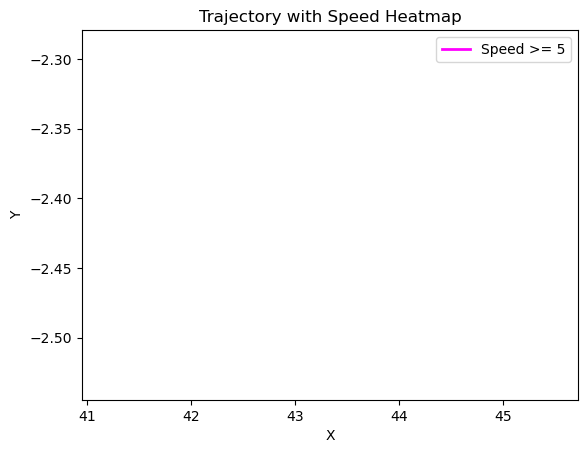

F/V GERARD LUC 4
18003    43.294732
21027    43.294732
4227     43.294732
2099     43.294732
12628    43.294732
           ...    
9267     43.294732
8147     43.294732
5795     43.294732
11843    43.294732
9939     43.294732
Name: position_latitude, Length: 194, dtype: float64


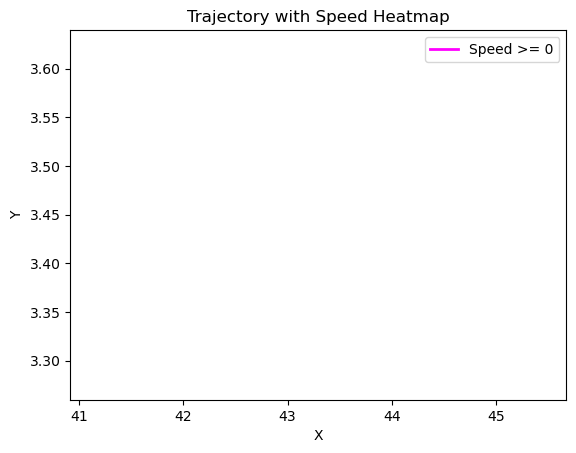

F/V JANVIER GIORDANO
9831     43.400828
20471    43.400828
6135     43.400828
8039     43.400828
10279    43.400828
           ...    
21367    43.400835
21255    43.400835
21703    43.400835
21591    43.400835
21479    43.400835
Name: position_latitude, Length: 194, dtype: float64


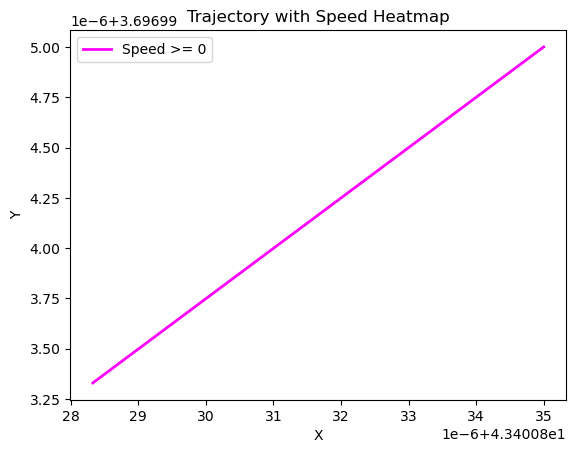

F/V G SAINTE RITA
958      49.547598
1070     49.547598
2302     49.547598
1406     49.547598
286      49.547598
           ...    
21230    50.723503
21342    50.723503
21454    50.723503
21566    50.723503
21678    50.723500
Name: position_latitude, Length: 194, dtype: float64


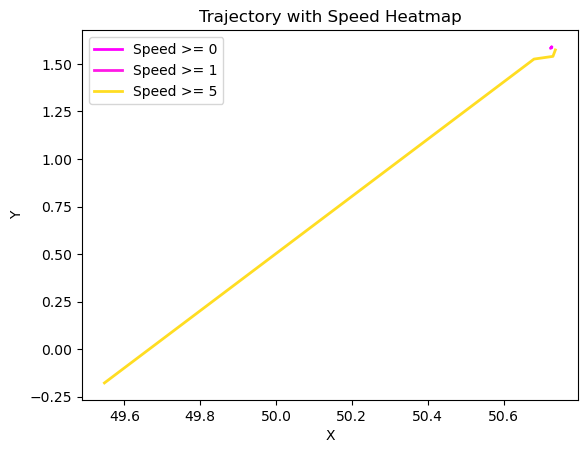

F/V PIER JO SALVADOR
3102     43.403957
4447     43.403957
862      43.403957
4894     43.403957
1870     43.403957
           ...    
21246    43.403928
21358    43.403943
21470    43.403943
21582    43.403962
21694    43.403948
Name: position_latitude, Length: 194, dtype: float64


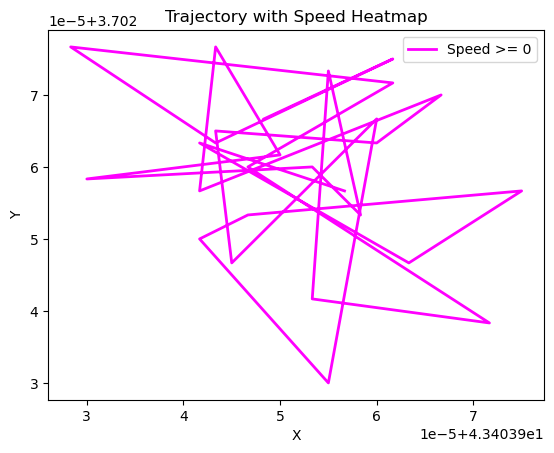

F/V STERENN
6816     14.68533
6928     14.68533
14208    14.68533
9392     14.68533
9280     14.68533
           ...   
11408    14.68533
17904    14.68533
17680    14.68533
8496     14.68533
11520    14.68533
Name: position_latitude, Length: 194, dtype: float64


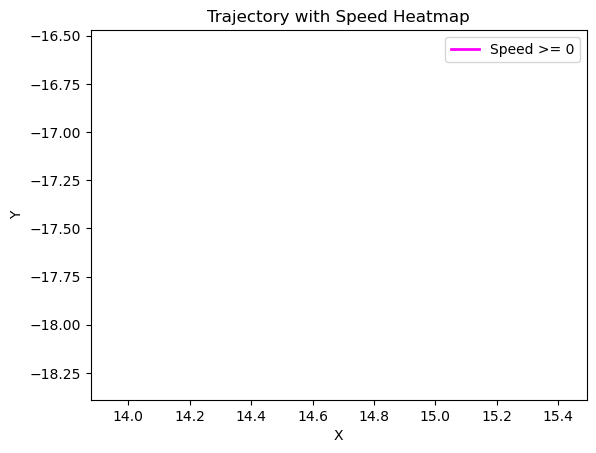

F/V CISBERLANDE 5
4958     43.403590
1374     43.403590
2718     43.403590
1262     43.403590
4846     43.403590
           ...    
21198    43.403627
21310    43.403613
21422    43.403613
21534    43.403615
21646    43.403622
Name: position_latitude, Length: 194, dtype: float64


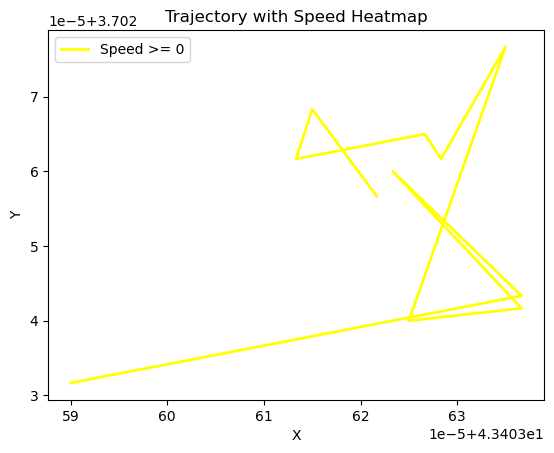

F/VSTSOPHIEFRANCOIS2
19785    43.402593
14745    43.402593
15865    43.402593
12729    43.402593
10937    43.402593
           ...    
1193     43.402593
5113     43.402593
13401    43.402593
13513    43.402593
13625    43.402593
Name: position_latitude, Length: 194, dtype: float64


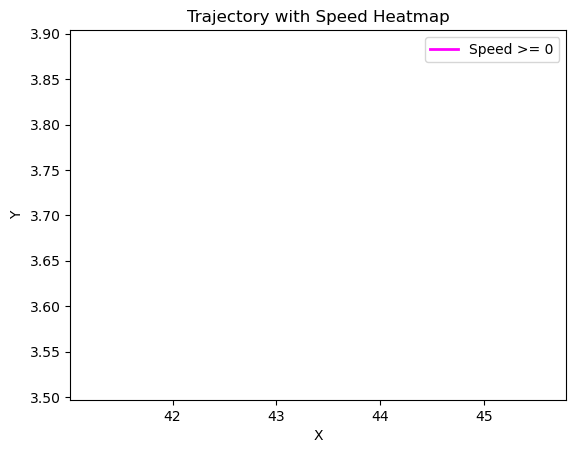

F/V PEPE BARREIRO
194      50.561082
5794     50.561082
1538     50.561082
3778     50.561082
2658     50.561082
           ...    
18786    51.577092
20914    51.577092
20690    51.577092
20242    51.577092
19794    51.577092
Name: position_latitude, Length: 194, dtype: float64


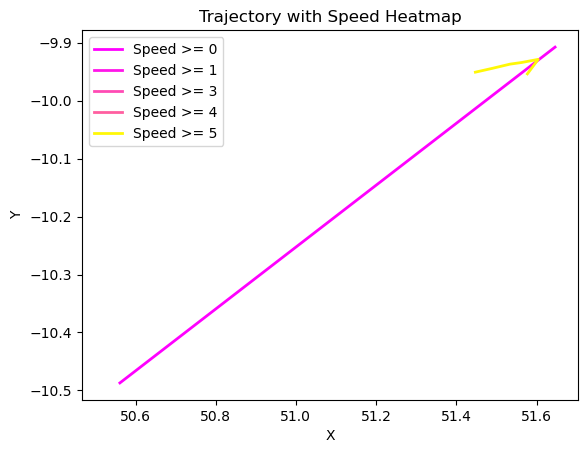

TIGERS III
21151    50.06177
19807    50.06177
13087    50.06177
7487     50.06177
319      50.06177
           ...   
18015    50.06177
11631    50.06177
16783    50.06177
12191    50.06177
19471    50.06177
Name: position_latitude, Length: 194, dtype: float64


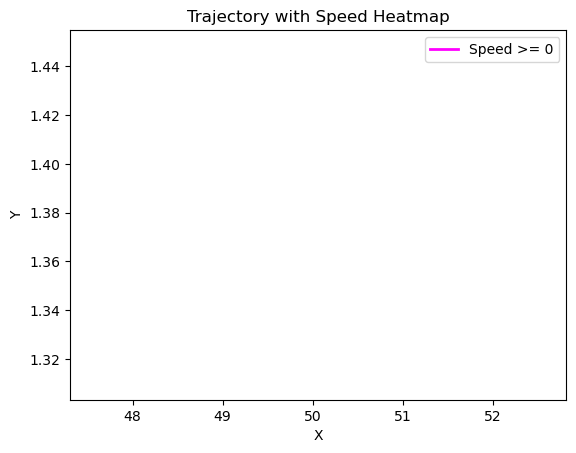

F/V SAINT GOTHARD
6165     51.746657
4709     51.746657
229      51.746657
8517     51.746657
3253     51.746657
           ...    
19157    51.481563
18709    51.481563
19829    51.481563
18821    51.481563
20053    51.481563
Name: position_latitude, Length: 194, dtype: float64


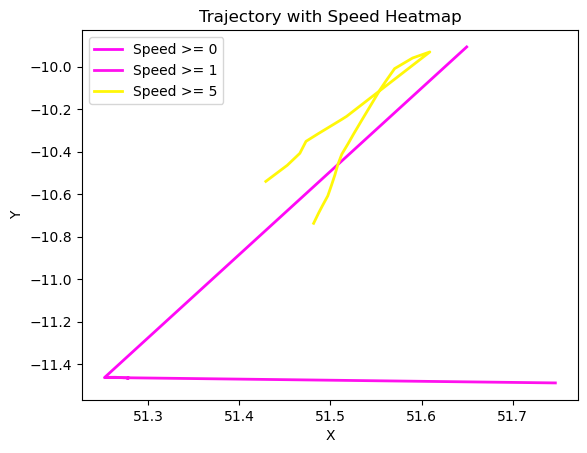

F/V PUENTEAREAS UNO
281      52.948763
1289     52.948763
505      52.948763
2633     52.948763
1401     52.948763
           ...    
20441    52.549390
20777    52.549390
21561    52.549390
20553    52.549390
21337    52.549390
Name: position_latitude, Length: 194, dtype: float64


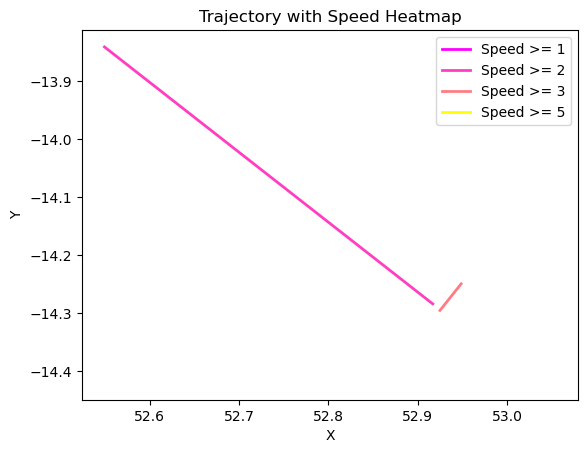

F/V ARGELES
520      52.537592
2424     52.537592
5224     52.537592
296      52.537592
4441     52.537592
           ...    
21240    53.851397
21129    53.851397
21352    53.851397
21576    53.851397
21688    53.851397
Name: position_latitude, Length: 194, dtype: float64


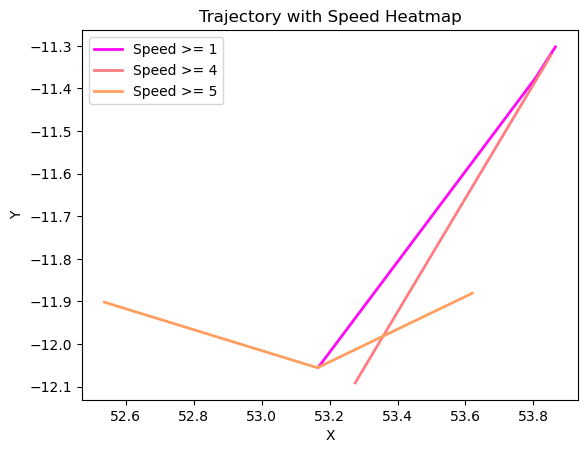

F/V MAR MARES
5272     52.340000
10536    52.340000
1688     52.340000
11320    52.340000
13224    52.340000
           ...    
21624    52.101022
19272    52.101022
17592    52.101022
15576    52.101022
18376    52.101022
Name: position_latitude, Length: 194, dtype: float64


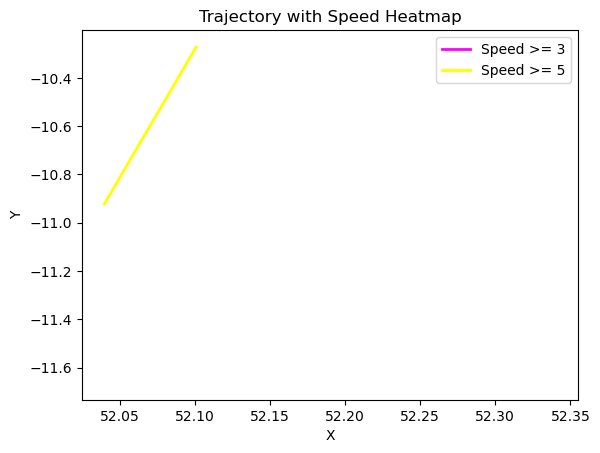

F/V PLAYA DE TUYA
151      54.045703
823      54.045703
375      54.045703
39       54.045703
711      54.045703
           ...    
21095    53.328727
21319    53.328727
19527    53.328727
21543    53.197828
21655    53.197828
Name: position_latitude, Length: 194, dtype: float64


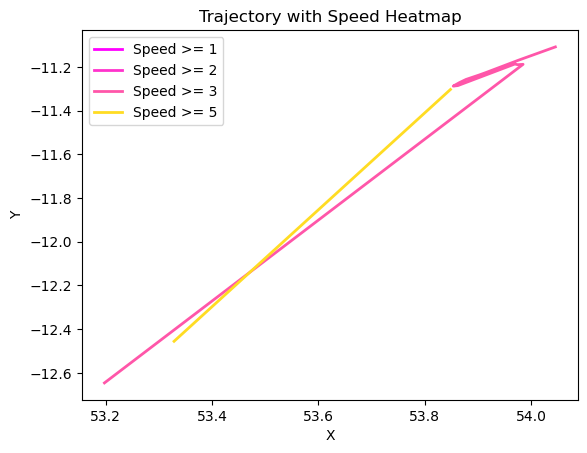

FV/BEOTHUK
8567     51.190952
6999     51.190952
7111     51.190952
4535     51.190952
3415     51.190952
           ...    
21223    51.397687
21559    51.397687
21447    51.397687
21671    51.397687
21335    51.397687
Name: position_latitude, Length: 194, dtype: float64


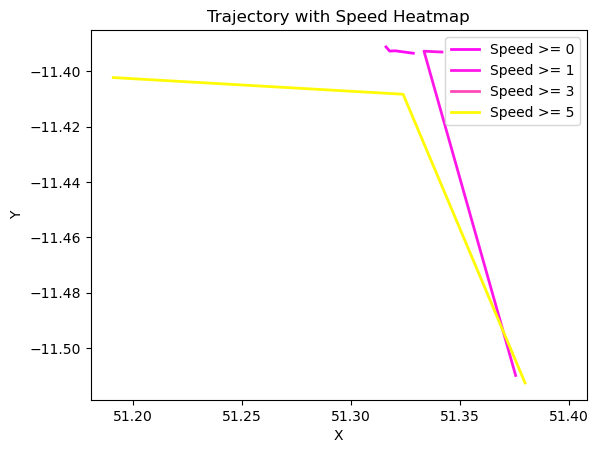

F/V LANDORA
3601     51.433477
3153     51.433477
801      51.433477
1809     51.433477
5393     51.433477
           ...    
18609    51.534623
19617    51.534623
20065    51.534623
17825    51.534623
18945    51.534623
Name: position_latitude, Length: 194, dtype: float64


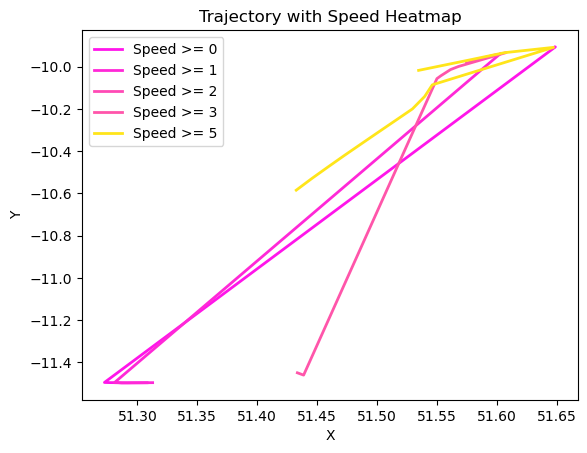

F/V RABELAIS
1512     51.371768
1400     51.371768
2744     51.371768
2632     51.371768
840      51.371768
           ...    
16632    51.336085
19656    51.336085
19880    51.336085
15960    51.336085
15624    51.336085
Name: position_latitude, Length: 194, dtype: float64


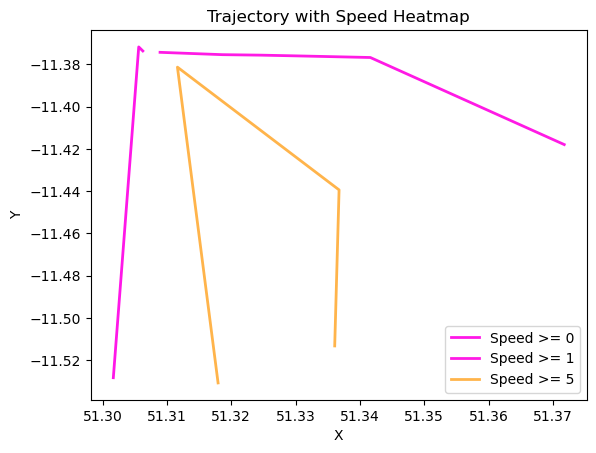

F/V CAP BOJADOR
107      9.125173
219      9.125173
443      9.125173
555      9.125173
331      9.125173
           ...   
21611    4.946552
21163    4.946552
21275    4.946552
21051    4.946552
21723    4.773715
Name: position_latitude, Length: 194, dtype: float64


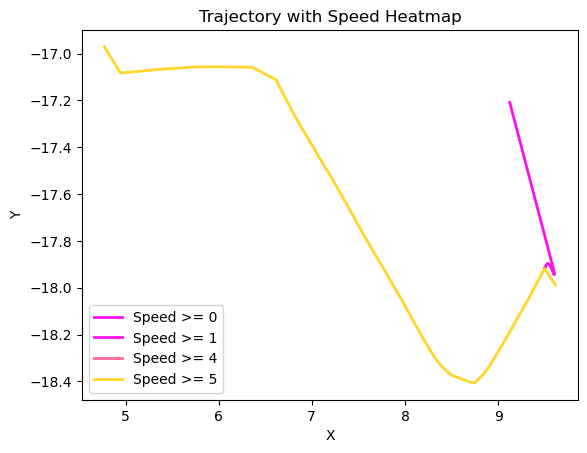

F/V GUEOTEC
246      9.205023
134      9.205023
22       9.205023
358      9.205023
470      9.744057
           ...   
18166    9.562865
20966    9.562865
21302    9.562865
18278    9.562865
20854    9.562865
Name: position_latitude, Length: 194, dtype: float64


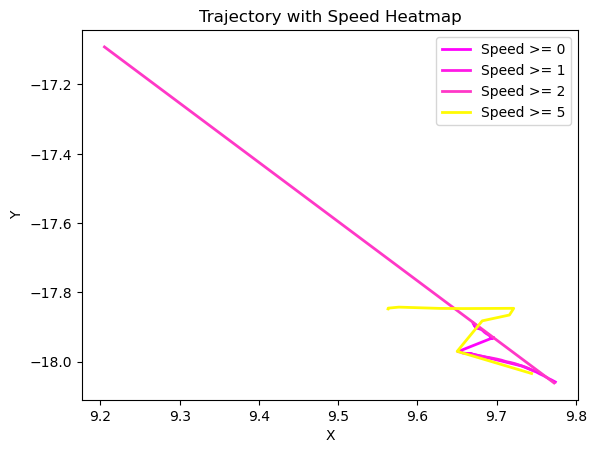

F/V SYLVANNA
1515     60.544587
1067     60.544587
171      60.544587
283      60.544587
1627     60.544587
           ...    
21227    60.259780
21339    60.271527
21451    60.271527
21563    60.278705
21675    60.286835
Name: position_latitude, Length: 194, dtype: float64


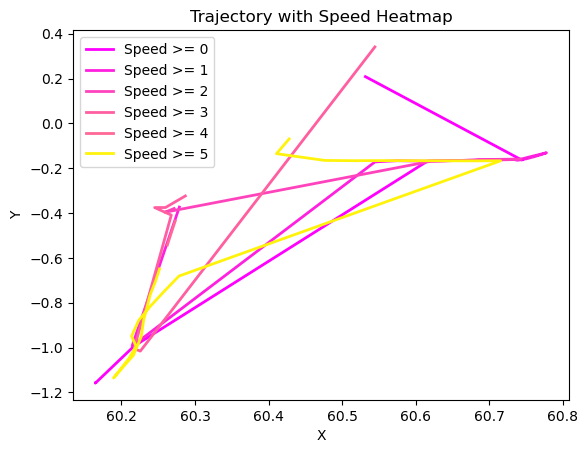

FV FERREIRA MARTINEZ
4327     49.745077
3767     49.745077
4887     49.745077
10711    49.745077
6119     49.745077
           ...    
16759    50.525938
14519    50.525938
14183    50.525938
20455    50.525938
21575    50.525938
Name: position_latitude, Length: 194, dtype: float64


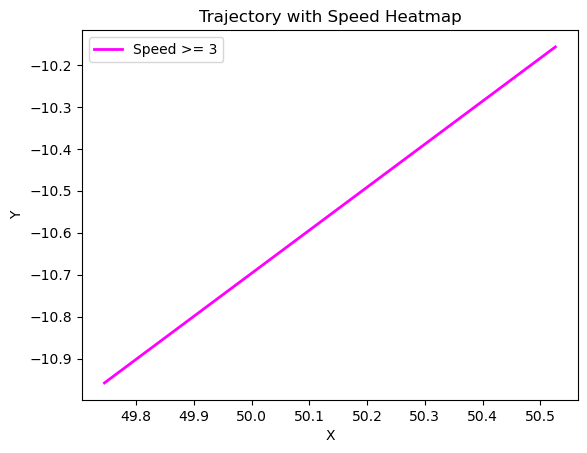

F/V SIEMPRE VIRIATO
26       43.569783
138      43.569783
250      43.569807
362      43.569823
474      43.569772
           ...    
16938    43.569805
18506    43.569805
18730    43.569805
18282    43.569805
19514    43.569805
Name: position_latitude, Length: 194, dtype: float64


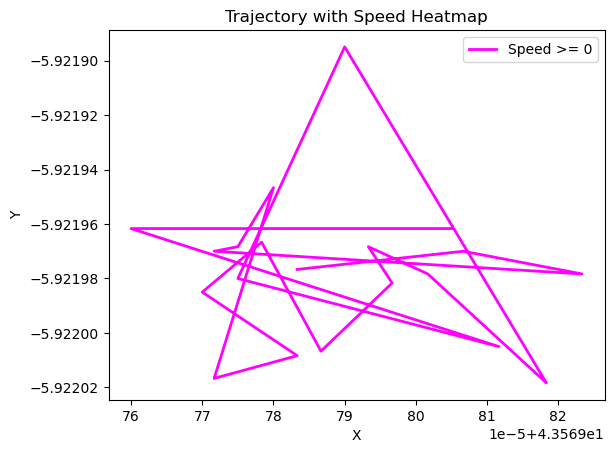

F/V LARCHE
5574     50.456167
1206     50.456167
6918     50.456167
6470     50.456167
10166    50.456167
           ...    
21254    50.723833
21366    50.723833
21478    50.723833
21590    50.723833
21702    50.723833
Name: position_latitude, Length: 194, dtype: float64


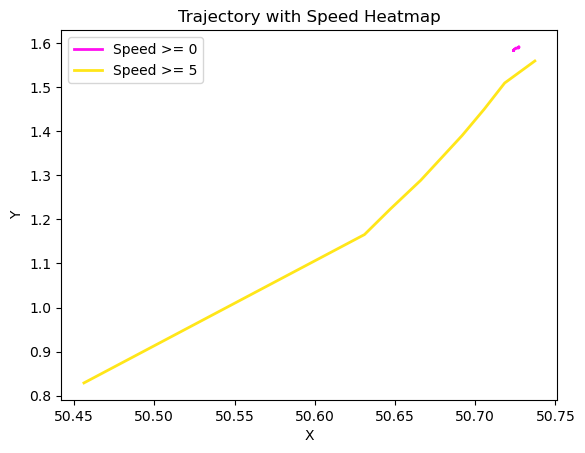

F/V MELODIE
5037     51.494302
7837     51.494302
2573     51.494302
3133     51.494302
7725     51.494302
           ...    
20717    51.296397
19933    51.296397
20381    51.296397
21613    51.346780
21725    51.346780
Name: position_latitude, Length: 194, dtype: float64


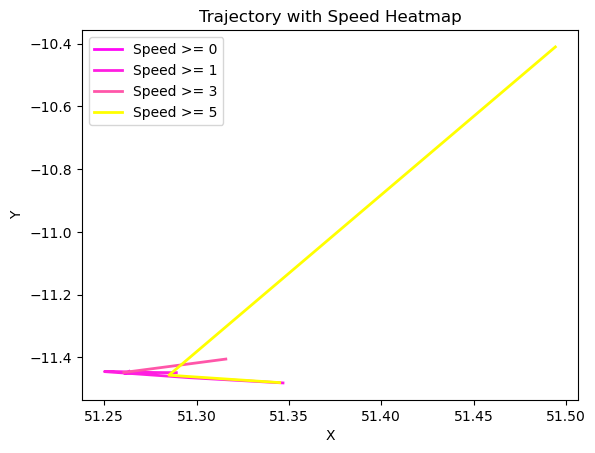

F/V LOIRA
2614     42.231115
2390     42.231115
38       42.231115
4406     42.231115
374      42.231115
           ...    
13590    42.231127
21542    42.231127
21430    42.231127
11686    42.231127
11574    42.231127
Name: position_latitude, Length: 194, dtype: float64


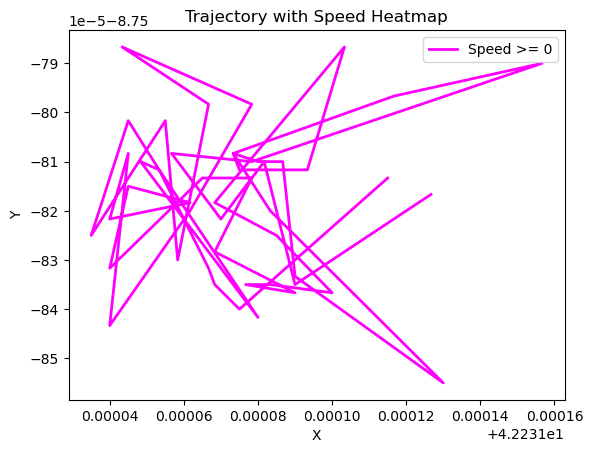

F/V ANTONIO MARIA
1547     58.612692
5579     58.612692
763      58.612692
3899     58.612692
427      58.612692
           ...    
18459    60.250822
19355    60.250822
19019    60.250822
21259    60.250822
20587    60.250822
Name: position_latitude, Length: 194, dtype: float64


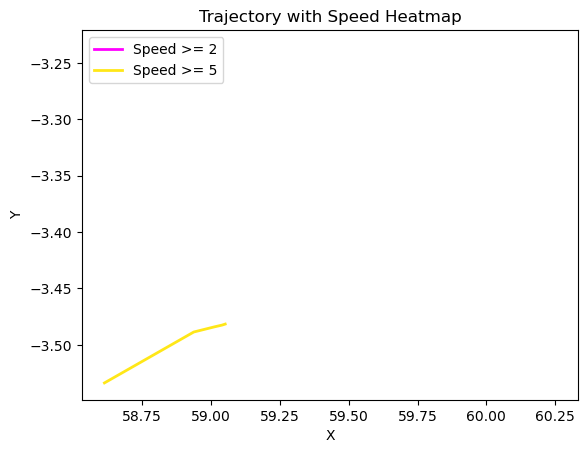

F/V CUCA
536      60.629035
1320     60.629035
984      60.629035
88       60.629035
312      60.629035
           ...    
20360    60.652320
21368    60.556642
21592    60.556642
21480    60.556642
21704    60.556642
Name: position_latitude, Length: 194, dtype: float64


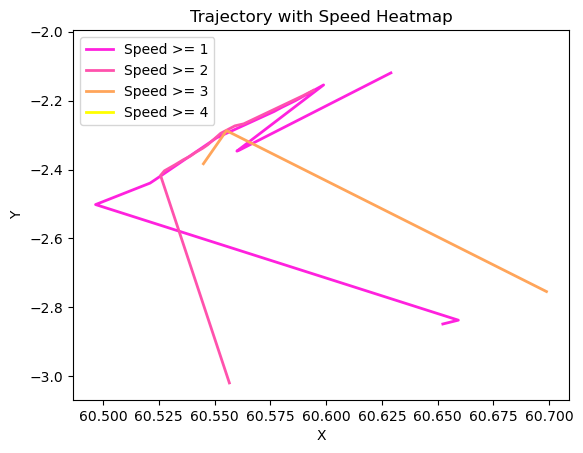

F/V GURE ANDRE
16596    42.800027
916      42.800027
9540     42.800027
692      42.800027
2484     42.800027
           ...    
4724     42.800027
3828     42.800027
21076    42.800027
9764     42.800027
2596     42.800027
Name: position_latitude, Length: 194, dtype: float64


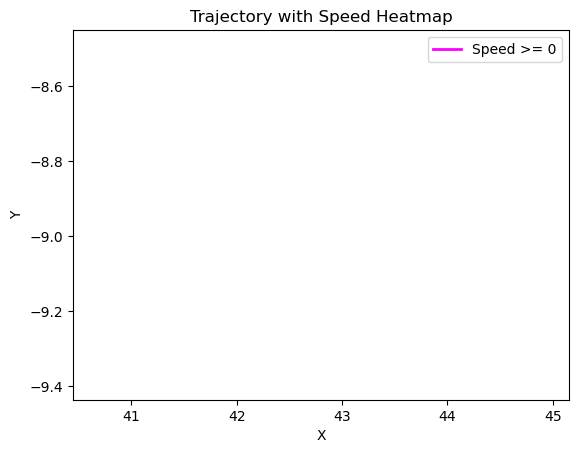

F/V ANNE ANTOINE 2
4658     43.400325
2754     43.400325
290      43.400325
4322     43.400325
738      43.400325
           ...    
15410    43.400330
13730    43.400330
12386    43.400330
13618    43.400330
19778    43.400330
Name: position_latitude, Length: 194, dtype: float64


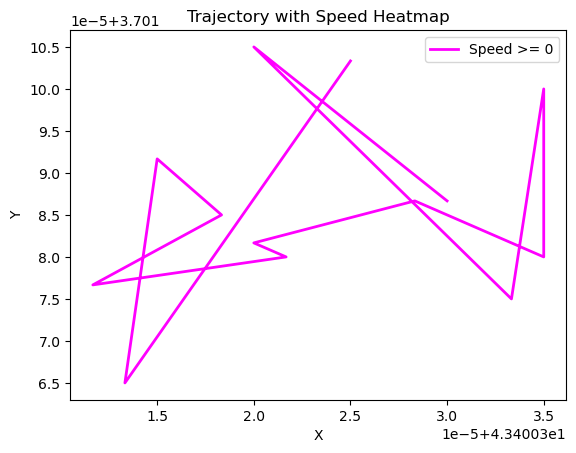

F/V LE RESSAC
2396     49.769508
1276     49.769508
1612     49.769508
940      49.769508
380      49.769508
           ...    
21212    45.597995
21324    45.523685
21436    45.464523
21548    45.462233
21660    45.462233
Name: position_latitude, Length: 194, dtype: float64


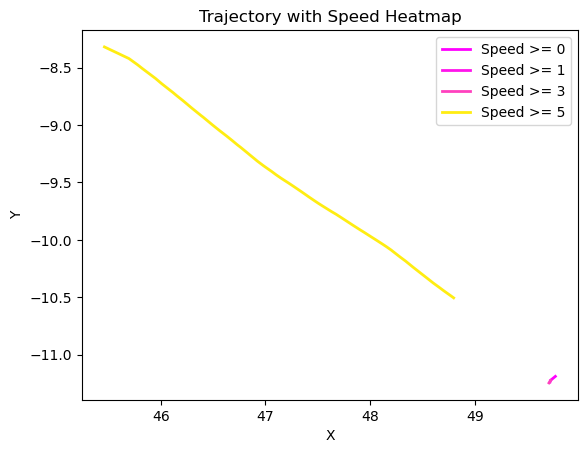

F/V R0NSARD
214      49.003715
886      49.003715
1222     49.003715
998      49.003715
326      49.003715
           ...    
21494    51.644960
17014    51.644960
18358    51.644960
21718    51.644960
20934    51.644960
Name: position_latitude, Length: 194, dtype: float64


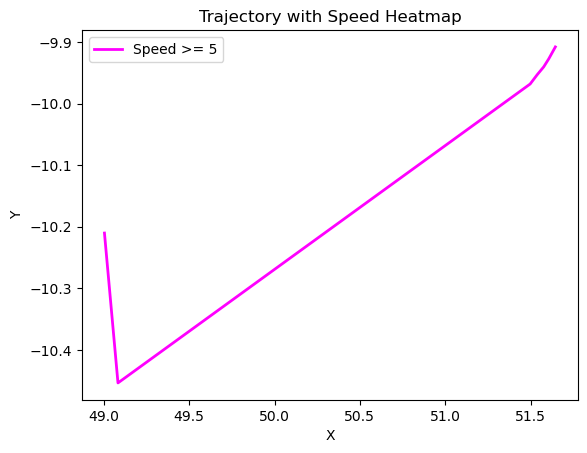

F/V LE CROTELLOIS
1537     50.531713
193      50.531713
81       50.531713
977      50.531713
417      50.531713
           ...    
21249    50.061638
21361    50.061618
21473    50.061672
21585    50.061620
21697    50.061615
Name: position_latitude, Length: 194, dtype: float64


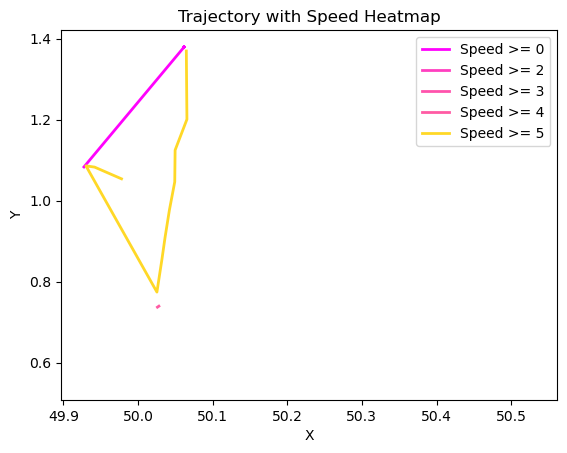

F/V YANNICK
6172     51.309705
8300     51.309705
6956     51.309705
7740     51.309705
4380     51.309705
           ...    
21180    51.880063
21292    51.856545
21404    51.834153
21516    51.810807
21628    51.786900
Name: position_latitude, Length: 194, dtype: float64


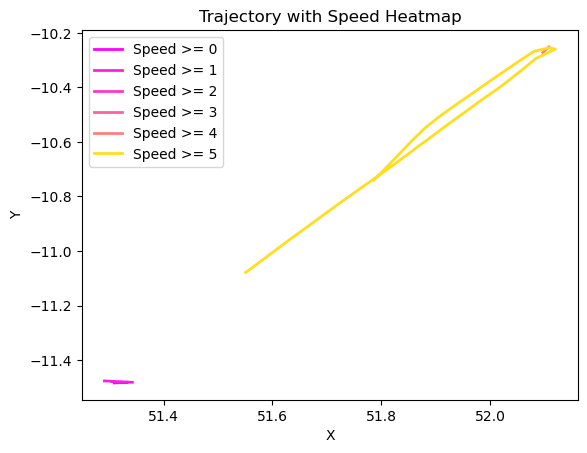

BRESSAY-BANK PAIR TR
473      61.686193
249      61.686193
137      61.686193
361      61.686193
697      61.686193
           ...    
21193    61.735527
21417    61.735527
21305    61.735527
21529    61.735527
21641    61.735527
Name: position_latitude, Length: 194, dtype: float64


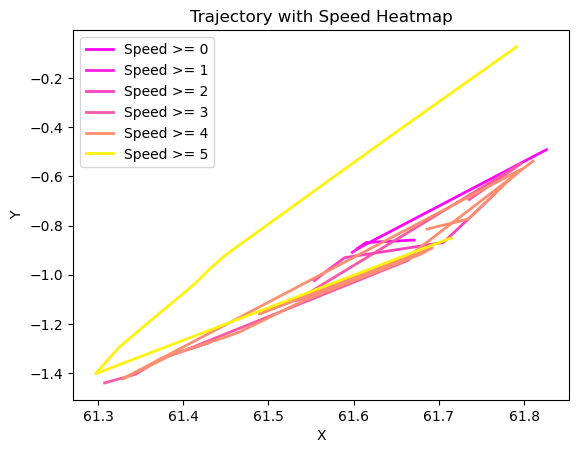

CAP SAINT GEORGES
50       61.636562
162      61.636562
386      61.636562
274      61.636562
498      61.636562
           ...    
21218    57.670363
21330    57.665848
21442    57.664508
21554    57.665725
21666    57.667018
Name: position_latitude, Length: 194, dtype: float64


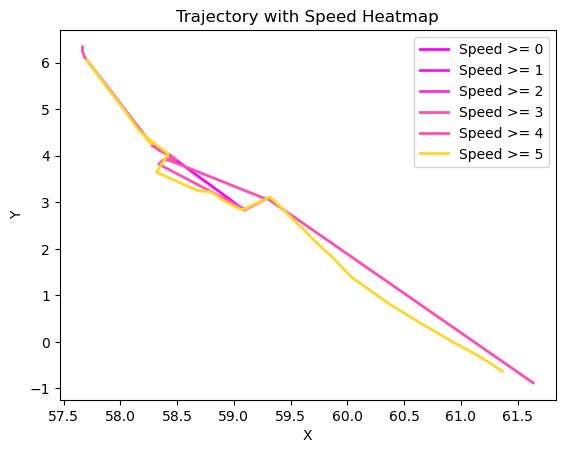

F/V LE STIFF
3449     43.352687
1433     43.352687
2217     43.352687
5353     43.352687
2441     43.352687
           ...    
14873    43.352677
9049     43.352677
18121    43.352677
10393    43.352677
17673    43.352677
Name: position_latitude, Length: 194, dtype: float64


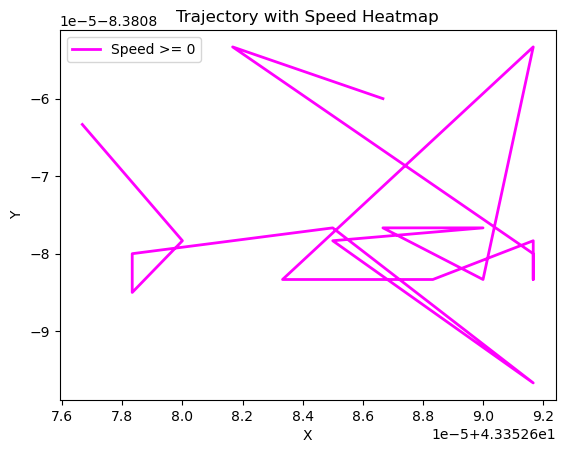

F/V SILURE
11991    43.680747
2471     43.680747
14455    43.680747
5831     43.680747
4152     43.680747
           ...    
21399    44.222570
21623    44.222570
21511    44.222570
21287    44.222570
21175    44.222570
Name: position_latitude, Length: 194, dtype: float64


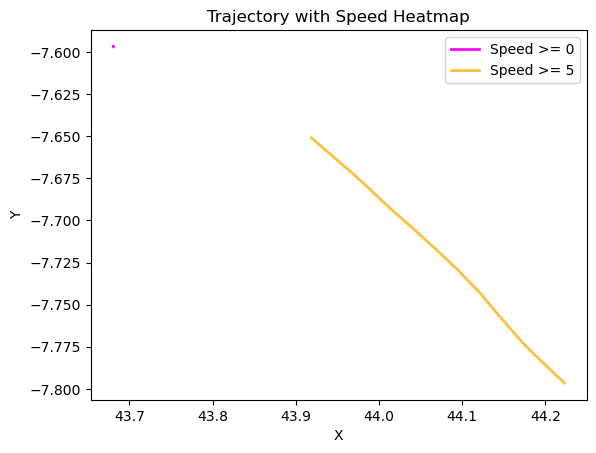

F/V CROIX MORAND
943      51.646270
1503     51.646270
3967     51.646270
1727     51.646270
3183     51.646270
           ...    
16399    51.301825
15279    51.301825
19983    51.301825
19647    51.301825
20991    51.301825
Name: position_latitude, Length: 194, dtype: float64


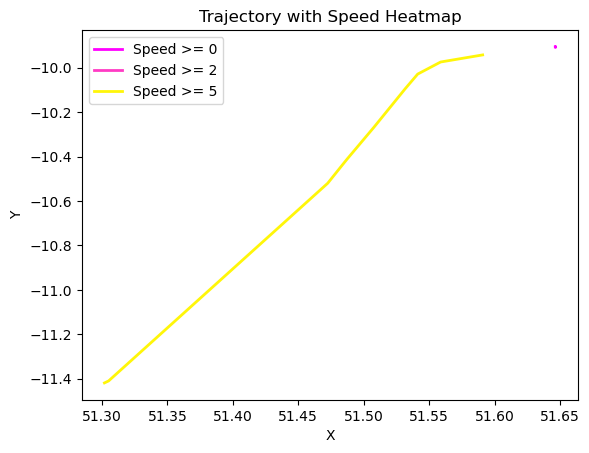

F/V RADOCHE TERCERO
227      51.496547
787      51.496547
115      51.496547
3        51.496547
675      51.496547
           ...    
21171    51.309502
21395    51.309502
21283    51.309502
21507    51.295080
21619    51.295080
Name: position_latitude, Length: 194, dtype: float64


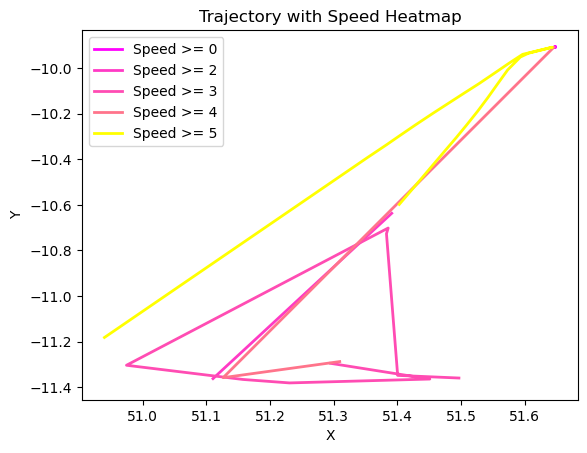

F/V FASTNET
369      53.187485
593      53.187485
145      53.187485
257      53.187485
33       53.187485
           ...    
20193    52.100453
21089    52.100453
20641    52.100453
20081    52.100453
21425    52.100453
Name: position_latitude, Length: 194, dtype: float64


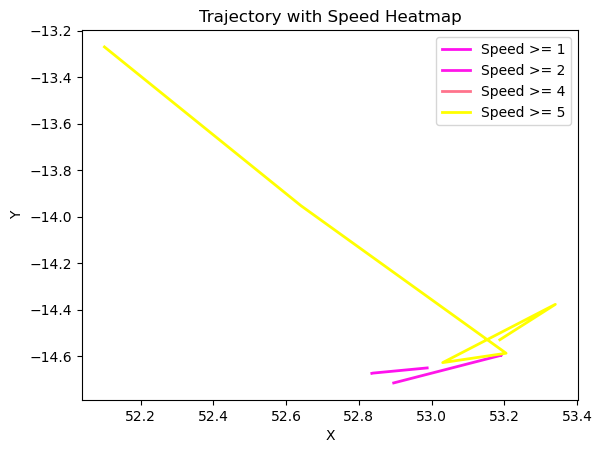

F/V CARLA
1050     43.657252
5306     43.657252
3738     43.657252
1835     43.657252
2058     43.657252
           ...    
19194    47.628400
13258    47.628400
21210    47.628400
18858    47.628400
13370    47.628400
Name: position_latitude, Length: 194, dtype: float64


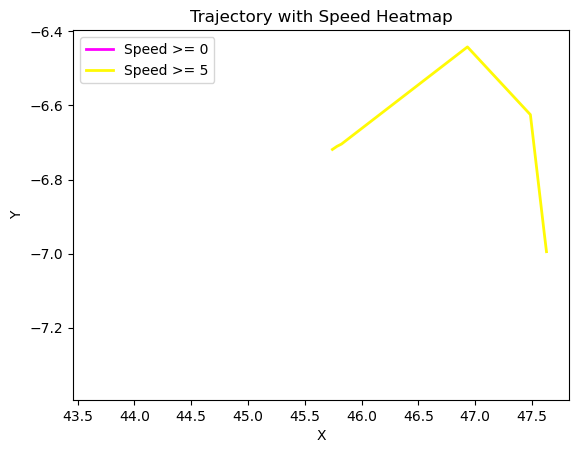

F/V ARMOR II
1174     50.990838
166      50.990838
1734     50.990838
726      50.990838
614      50.990838
           ...    
18310    50.911542
17638    50.911542
18646    50.911542
21558    50.911542
18758    50.911542
Name: position_latitude, Length: 194, dtype: float64


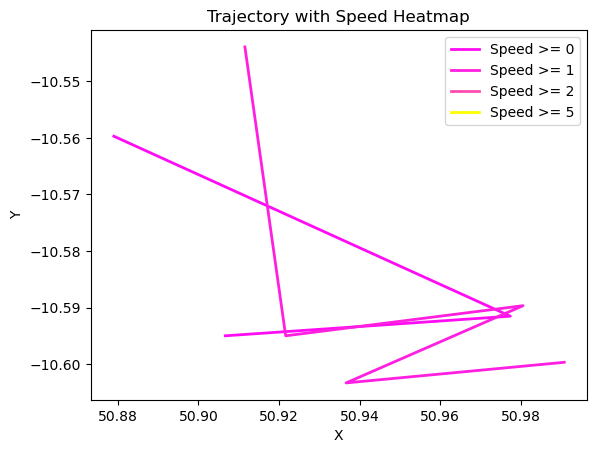

F/V M. LE ROCH 2
29       57.510192
477      57.510192
365      57.510192
589      57.510192
141      57.510192
           ...    
21533    57.953898
21421    57.953898
21309    57.953898
21197    57.953898
21645    57.973918
Name: position_latitude, Length: 194, dtype: float64


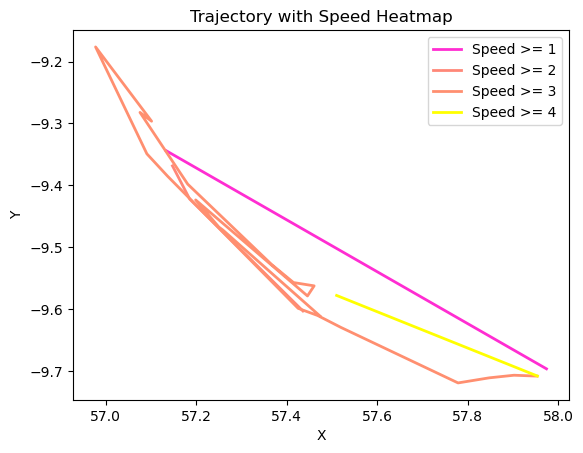

SCOMBRUS
309      56.906442
197      56.906442
421      56.906442
85       56.906442
533      57.290118
           ...    
21253    53.247445
21365    53.205827
21477    53.151448
21589    53.113488
21701    53.088313
Name: position_latitude, Length: 194, dtype: float64


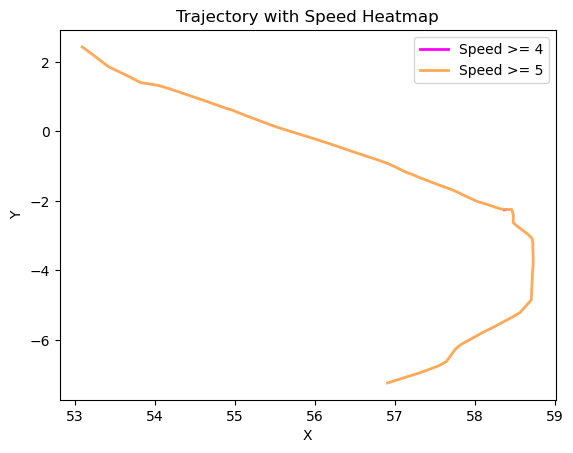

F/V JP LE ROCH
149      58.542457
485      58.542457
373      58.542457
261      58.542457
37       58.542457
           ...    
21205    57.849158
21541    57.812455
21317    57.812455
21653    57.812455
21429    57.812455
Name: position_latitude, Length: 194, dtype: float64


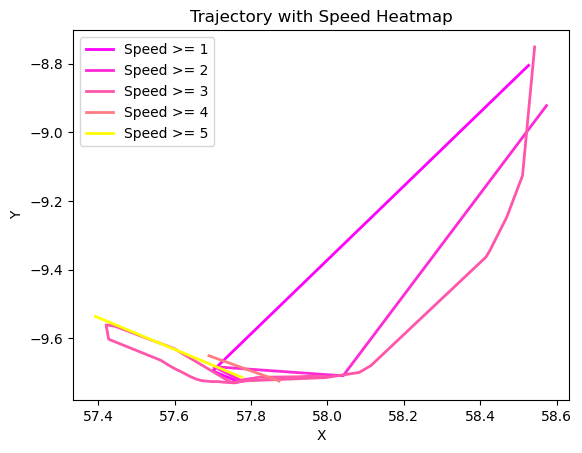

F/V LAPALOMA II
125      51.246000
13       51.246000
909      51.246000
797      51.246000
1917     51.246000
           ...    
21181    49.748970
21293    49.748970
21405    49.748970
21517    49.744273
21629    49.744273
Name: position_latitude, Length: 194, dtype: float64


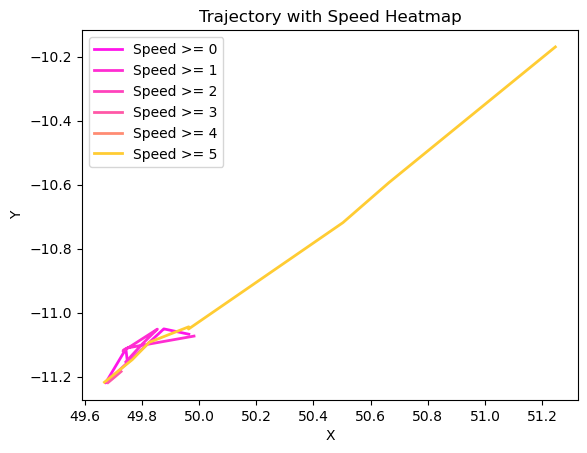

F/V GEVRED
289     -15.928333
177     -15.928333
65      -15.928333
513     -15.933315
1745    -15.933315
           ...    
21345   -16.304172
21233   -16.304172
21457   -16.333857
21681   -16.333857
21569   -16.333857
Name: position_latitude, Length: 194, dtype: float64


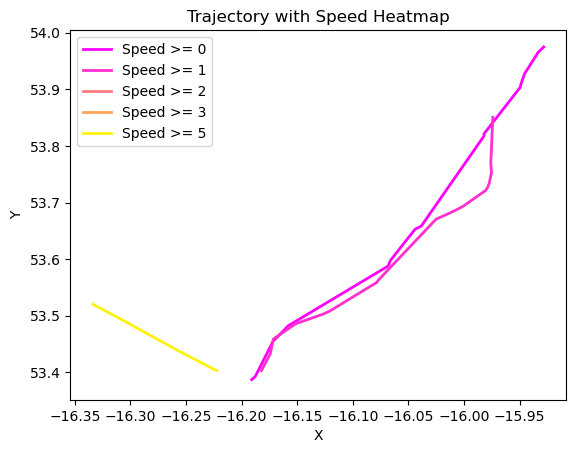

F\V LUDOVIC GEOFFRAY
799      49.981300
2815     49.981300
15       49.981300
2367     49.981300
1359     49.981300
           ...    
21519    50.101768
21183    50.101768
21295    50.101768
21407    50.101768
21631    50.101768
Name: position_latitude, Length: 194, dtype: float64


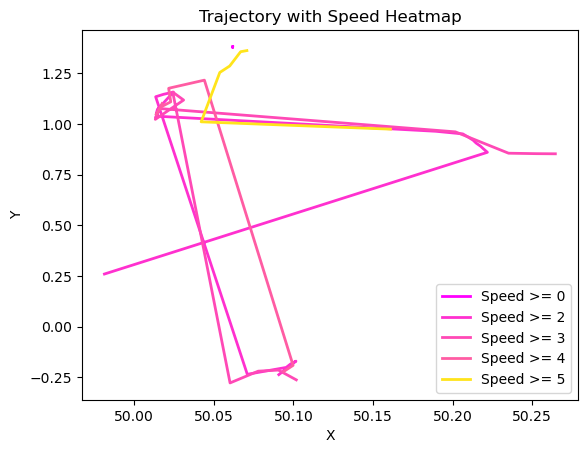

F/V FARO PICAMILLO
101      49.841455
213      49.841455
325      49.812532
437      49.799738
549      49.798887
           ...    
21269    45.091947
21381    45.045657
21493    45.002475
21605    44.946563
21717    44.906738
Name: position_latitude, Length: 194, dtype: float64


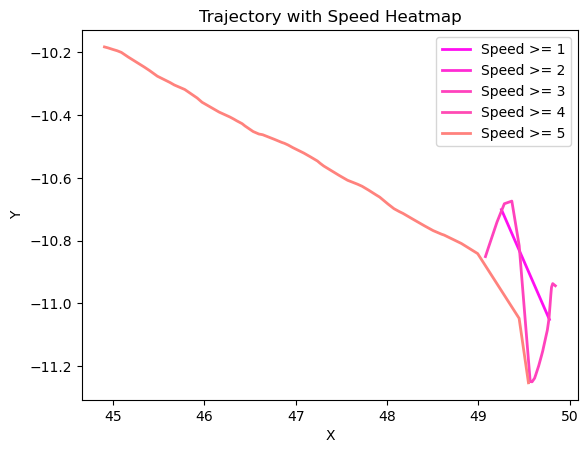

F/V CAP FINISTERE
74       49.734237
186      49.734237
298      49.726507
410      49.722527
522      49.720810
           ...    
21242    49.728500
21466    49.737393
21578    49.737393
21354    49.737393
21690    49.737393
Name: position_latitude, Length: 194, dtype: float64


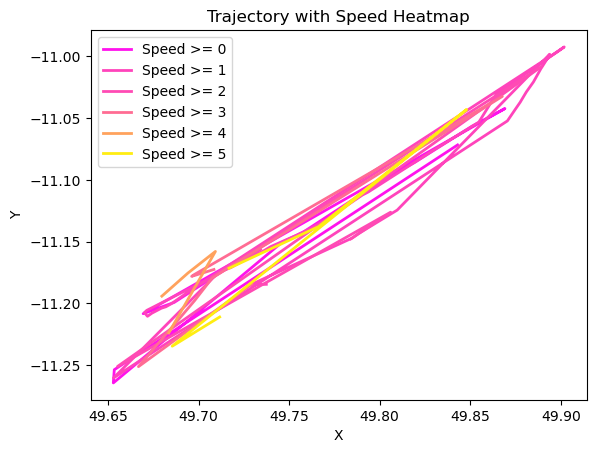

F/V NAONED
123      47.714543
11       47.714543
235      47.712087
347      47.712347
459      47.712785
           ...    
21067    47.446547
21291    47.386990
21515    47.401330
21403    47.401330
21627    47.437868
Name: position_latitude, Length: 194, dtype: float64


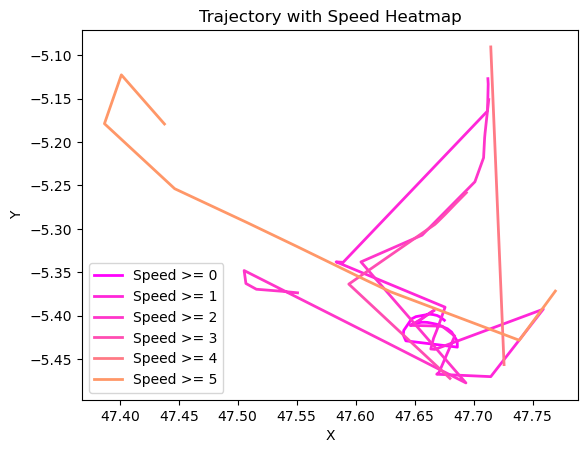

F/V VENT DU NORD II
99       43.354990
211      43.354990
435      43.354962
323      43.354962
547      43.354955
           ...    
21267    43.354997
21379    43.354970
21491    43.355073
21603    43.355013
21715    43.354983
Name: position_latitude, Length: 194, dtype: float64


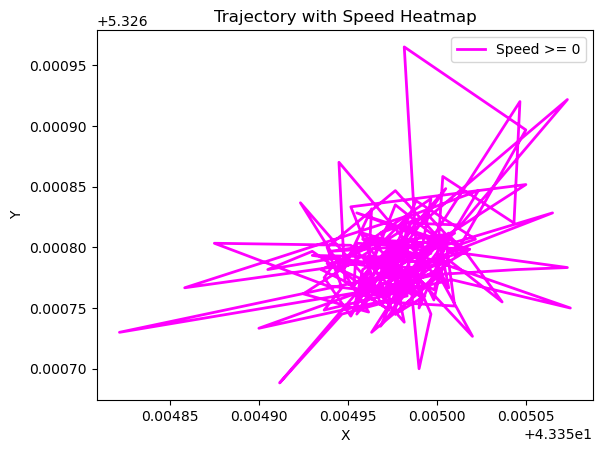

F/V PEDRA BLANCA II
105      49.491723
217      49.491723
441      49.490330
329      49.490330
553      49.489695
           ...    
21273    48.985283
21385    48.972782
21609    48.958707
21497    48.958707
21721    48.921653
Name: position_latitude, Length: 194, dtype: float64


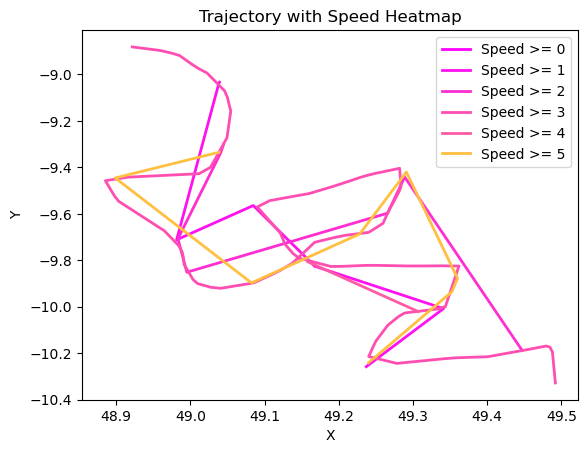

F/V MAR DE FLORES
192      49.879408
80       49.879408
304      49.876067
416      49.875083
528      49.875083
           ...    
21248    46.880602
21360    46.819510
21472    46.775712
21584    46.765013
21696    46.736928
Name: position_latitude, Length: 194, dtype: float64


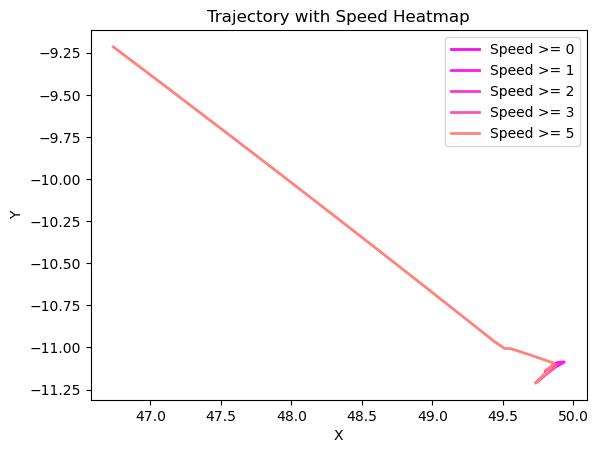

F/V IBARDIN
34       49.722808
146      49.722808
258      49.717288
370      49.712108
482      49.712108
           ...    
21202    49.736125
21538    49.736125
21650    49.736125
21426    49.736125
21314    49.736125
Name: position_latitude, Length: 194, dtype: float64


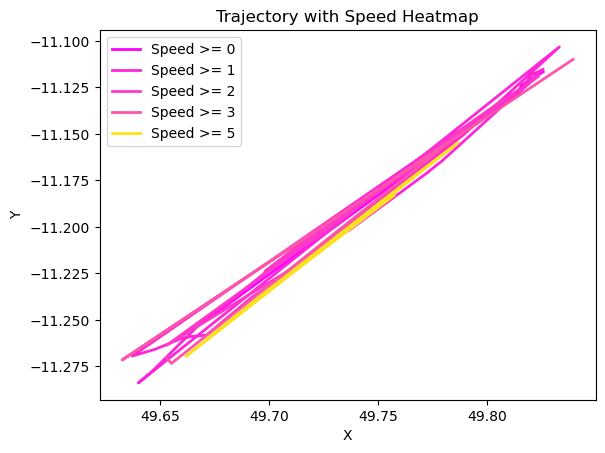

F/V AGORRETA
111      49.028753
223      49.028753
335      49.024250
447      49.020278
559      49.020278
           ...    
21279    47.074893
21391    47.021402
21615    46.966392
21503    46.966392
21727    46.925327
Name: position_latitude, Length: 194, dtype: float64


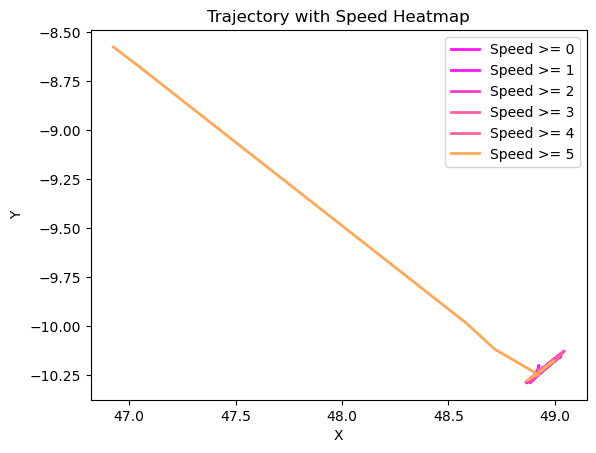

F/V LA TRINITE
116      50.626320
4        50.626320
228      50.613213
340      50.591702
452      50.586020
           ...    
21172    50.725515
21284    50.725510
21396    50.725517
21508    50.725537
21620    50.725488
Name: position_latitude, Length: 194, dtype: float64


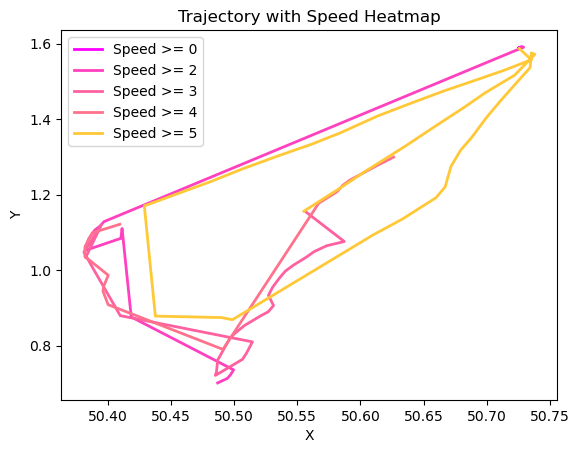

F/V MEABAN
176      49.168203
64       49.168203
288      49.164772
400      49.164772
512      49.156528
           ...    
21232    49.282738
21344    49.279832
21456    49.277063
21568    49.276675
21680    49.269995
Name: position_latitude, Length: 194, dtype: float64


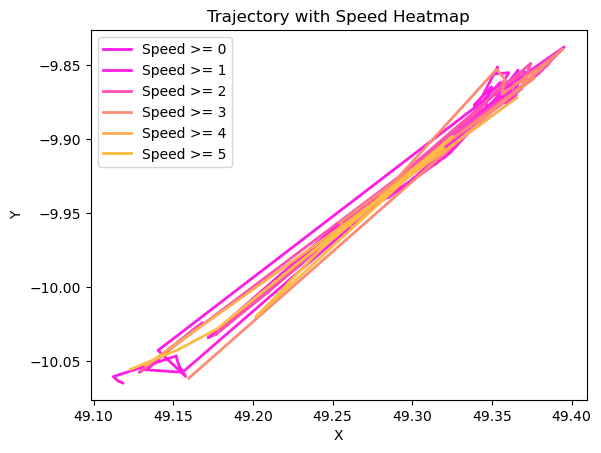

F/V EMERAUDE
113      53.795917
1        53.795917
225      53.857963
337      53.924003
449      54.007778
           ...    
21169    62.495127
21281    62.539545
21393    62.597543
21505    62.652342
21617    62.706675
Name: position_latitude, Length: 194, dtype: float64


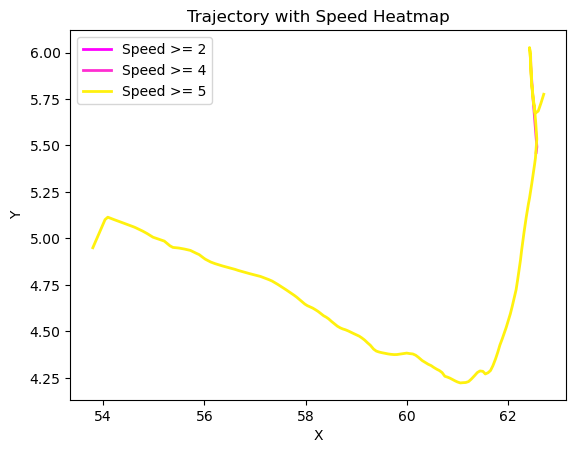

CAP ST MARIE
269     -4.616507
45      -4.616507
157     -4.616507
381     -4.616462
493     -4.616488
           ...   
20877   -4.617455
21437   -4.617455
20429   -4.617455
21661   -4.617515
21549   -4.617515
Name: position_latitude, Length: 194, dtype: float64


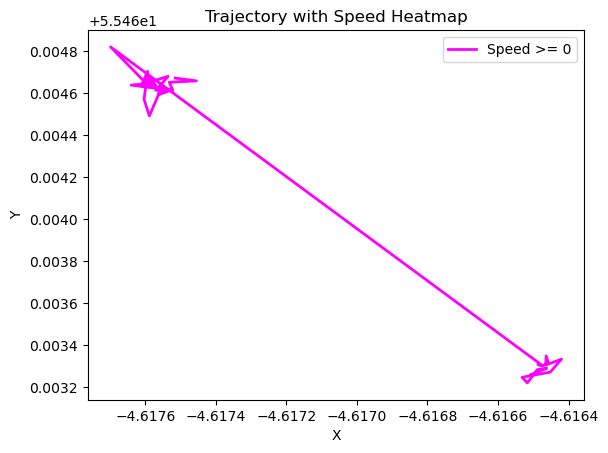

F/V NICOLAS JEREMY
204      51.397583
92       51.397583
316      51.398267
428      51.398050
540      51.395650
           ...    
21260    50.727083
21372    50.727083
21484    50.727067
21596    50.727067
21708    50.727083
Name: position_latitude, Length: 194, dtype: float64


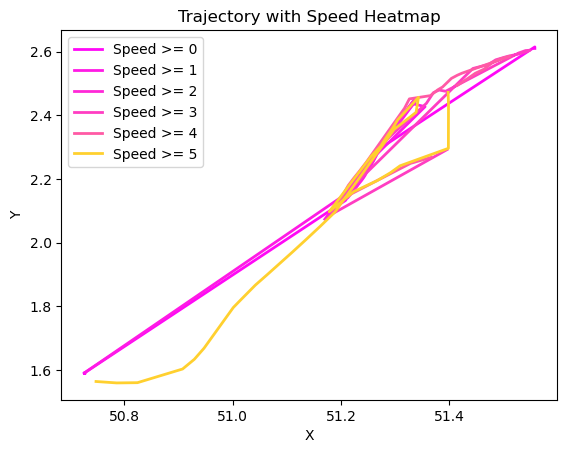

LE DOLMEN
48       47.710522
160      47.710522
272      47.709098
384      47.709673
496      47.709840
           ...    
21216    47.424237
21328    47.401310
21440    47.407520
21552    47.407520
21664    47.422953
Name: position_latitude, Length: 194, dtype: float64


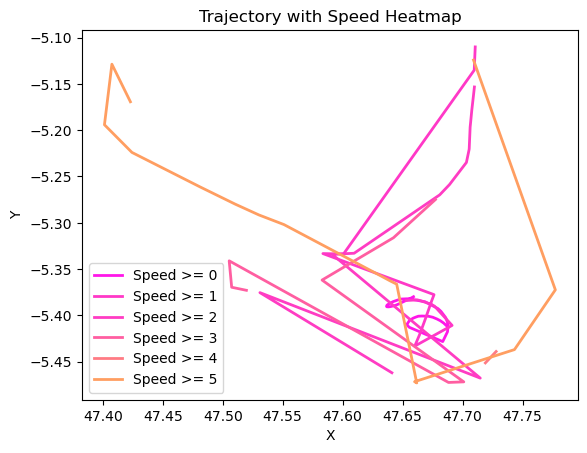

F/V MERCATOR
98       50.441930
210      50.441930
322      50.449657
434      50.456347
546      50.463935
           ...    
21266    50.723670
21378    50.723657
21490    50.723667
21602    50.723675
21714    50.723692
Name: position_latitude, Length: 194, dtype: float64


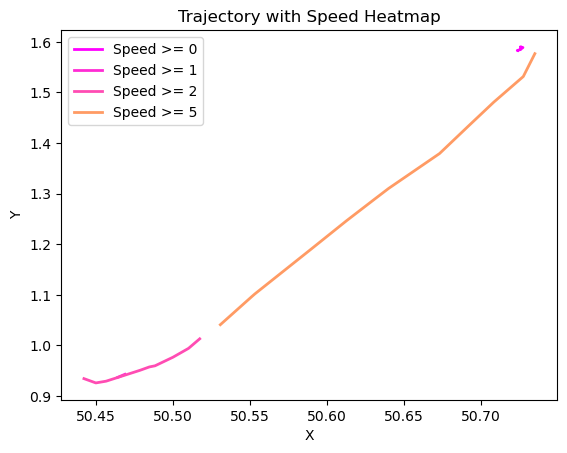

F/V PENDRUC
75      -4.620282
299     -4.620282
187     -4.620282
411     -4.620265
523     -4.620268
           ...   
21243   -4.620145
21355   -4.620145
21691   -4.620147
21579   -4.620147
21467   -4.620147
Name: position_latitude, Length: 194, dtype: float64


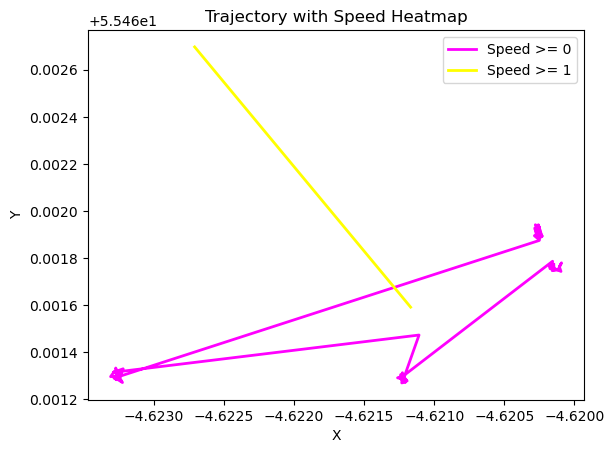

F/V LAREDO
35       50.241367
371      50.241367
2051     50.241367
2163     50.241367
4291     50.241367
           ...    
20419    50.437243
19523    50.437243
18627    50.437243
17731    50.437243
17619    50.437243
Name: position_latitude, Length: 194, dtype: float64


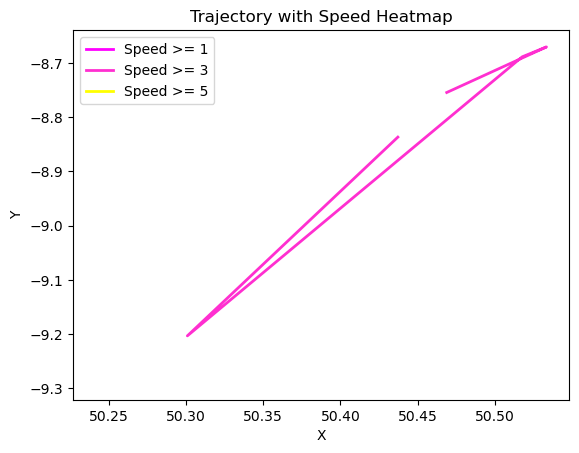

F/V RIO DA BOUZA
93       49.536567
205      49.536567
317      49.531167
429      49.520217
541      49.496900
           ...    
21261    49.531633
21373    49.527400
21485    49.529000
21597    49.535667
21709    49.566033
Name: position_latitude, Length: 194, dtype: float64


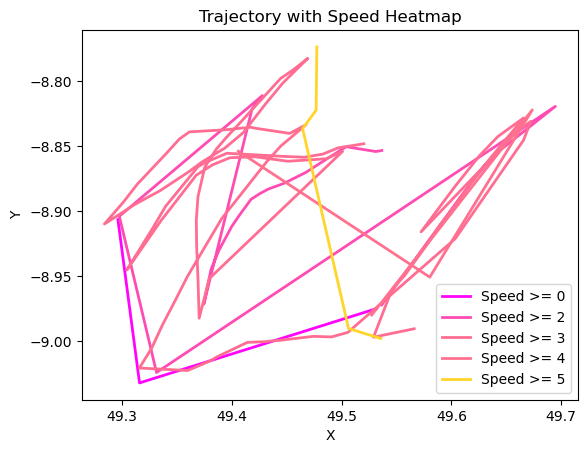

OTTER BANK F/V
163      57.120740
51       57.120740
275      57.120745
387      57.120737
499      57.120755
           ...    
21219    60.801882
21443    60.852743
21331    60.852743
21555    60.923917
21667    60.969618
Name: position_latitude, Length: 194, dtype: float64


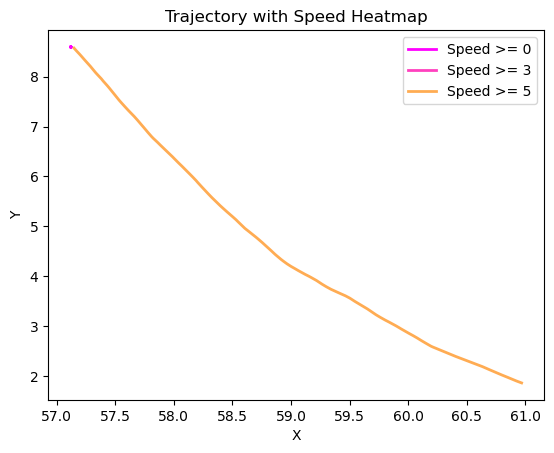

F/V GURE AMETZA II
6        44.591753
118      44.591753
230      44.559438
342      44.524793
454      44.498057
           ...    
21174    43.352675
21286    43.352580
21398    43.352588
21510    43.352588
21622    43.352587
Name: position_latitude, Length: 194, dtype: float64


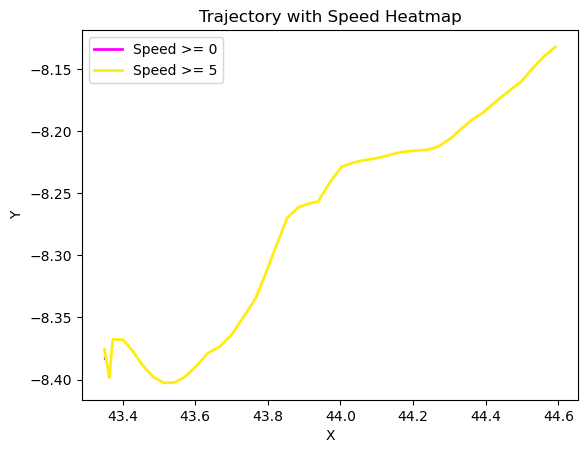

F/V VIA AVENIR
41       5.289293
153      5.289293
265      5.289305
377      5.289315
489      5.289317
           ...   
21209    5.289307
21321    5.289303
21433    5.289302
21545    5.289305
21657    5.289293
Name: position_latitude, Length: 194, dtype: float64


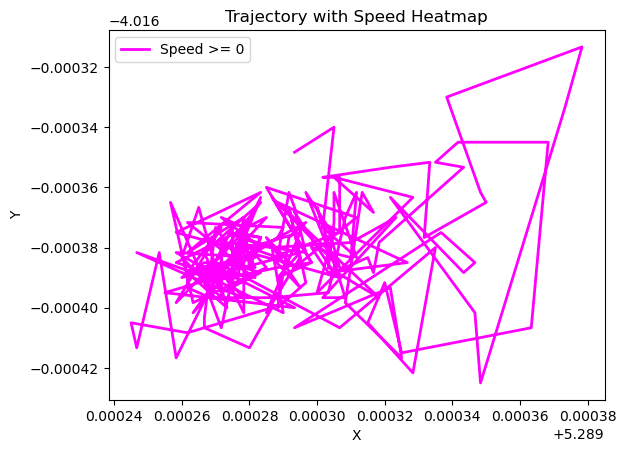

F/V FARPESCA
61       49.138952
173      49.143535
285      49.157630
397      49.167335
509      49.180652
           ...    
21229    48.852325
21341    48.825843
21453    48.806172
21565    48.782310
21677    48.742577
Name: position_latitude, Length: 194, dtype: float64


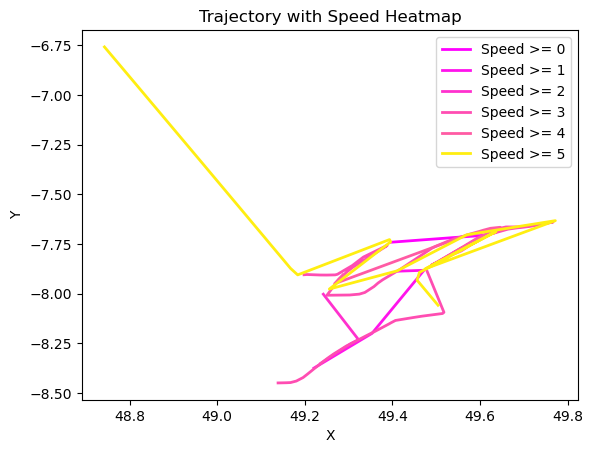

F/V LE MARMOUSET 3
2        50.726525
114      50.726525
226      50.726548
338      50.726527
450      50.726535
           ...    
21170    50.724042
21282    50.724045
21394    50.724052
21506    50.724053
21618    50.724042
Name: position_latitude, Length: 194, dtype: float64


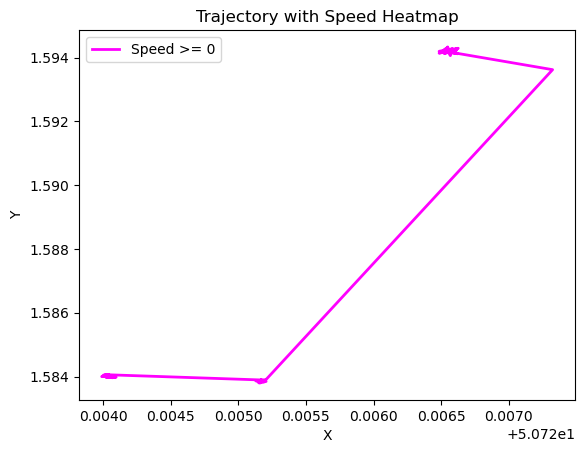

VIA ALIZE
104      5.290782
216      5.290782
328      5.290790
440      5.290828
552      5.290833
           ...   
21272    5.274947
21384    5.275022
21496    5.274908
21608    5.274882
21720    5.274882
Name: position_latitude, Length: 194, dtype: float64


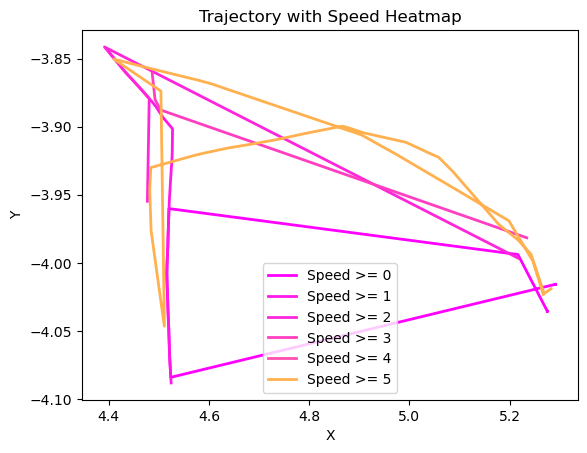

F/V NOTRE DAME DE B
9        51.356900
121      51.356900
233      51.339983
345      51.318733
457      51.291960
           ...    
21177    50.724153
21289    50.724137
21401    50.724153
21513    50.724163
21625    50.724153
Name: position_latitude, Length: 194, dtype: float64


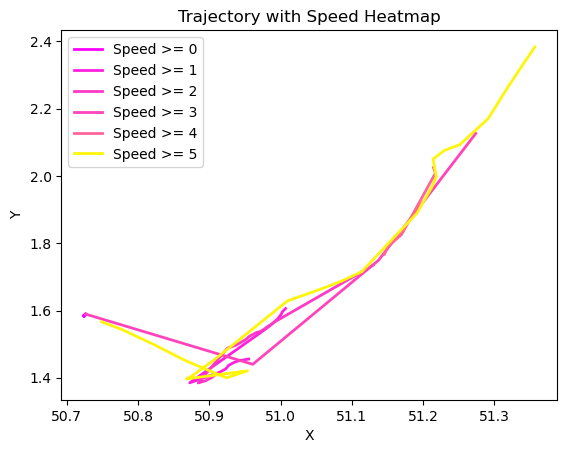

F/V TOURMALET
103      50.246970
215      50.246970
327      50.254190
439      50.304617
551      50.325923
           ...    
21271    50.723773
21383    50.723768
21495    50.723778
21607    50.723785
21719    50.723770
Name: position_latitude, Length: 194, dtype: float64


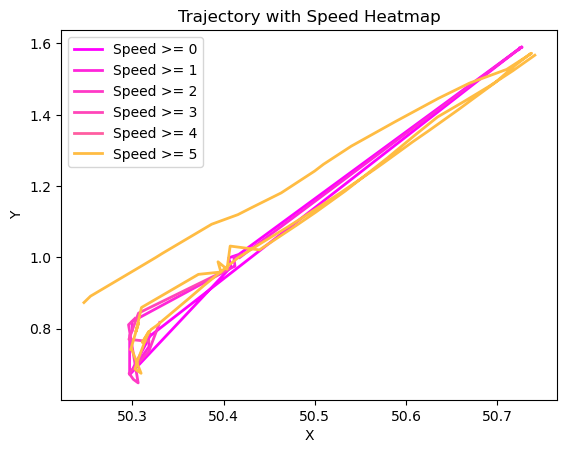

F/V MARIA MAGDALENA
158      43.680415
46       43.680415
270      43.680387
382      43.680387
494      43.680392
           ...    
20990    43.680408
15278    43.680408
13486    43.680408
19758    43.680408
17182    43.680408
Name: position_latitude, Length: 194, dtype: float64


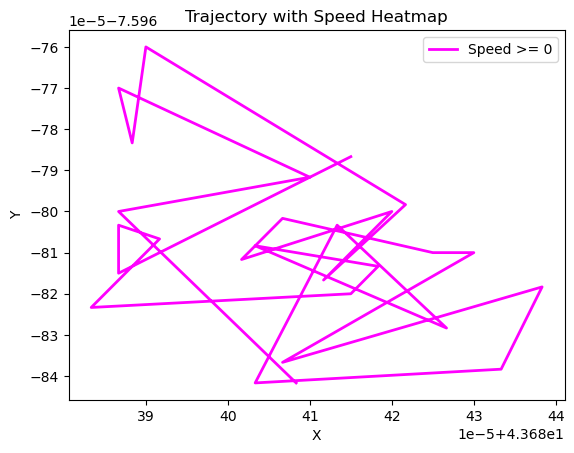

F/V VIA MISTRAL
180      5.289290
68       5.289290
292      5.289283
404      5.289287
516      5.289275
           ...   
6900     5.289213
13396    5.289213
15076    5.289213
7460     5.289213
14404    5.289213
Name: position_latitude, Length: 194, dtype: float64


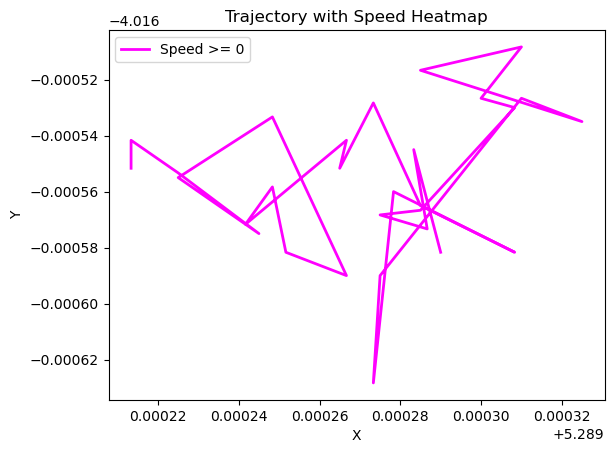

F/V J.L.RAPHAEL 2
252      43.403890
476      43.403890
28       43.403890
364      43.403890
140      43.403890
           ...    
21196    43.403872
21308    43.403857
21420    43.403907
21532    43.403897
21644    43.403853
Name: position_latitude, Length: 194, dtype: float64


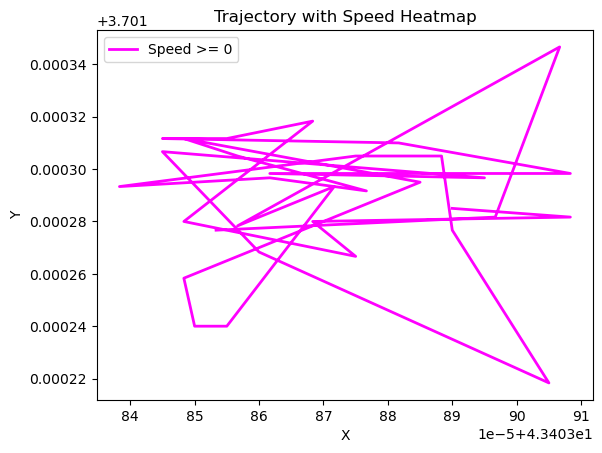

F/V PEDRA BLANCA
480      49.030183
368      49.030183
256      49.030183
144      49.030183
592      49.030183
           ...    
21200    49.148283
21312    49.154700
21424    49.162750
21536    49.162750
21648    49.171650
Name: position_latitude, Length: 194, dtype: float64


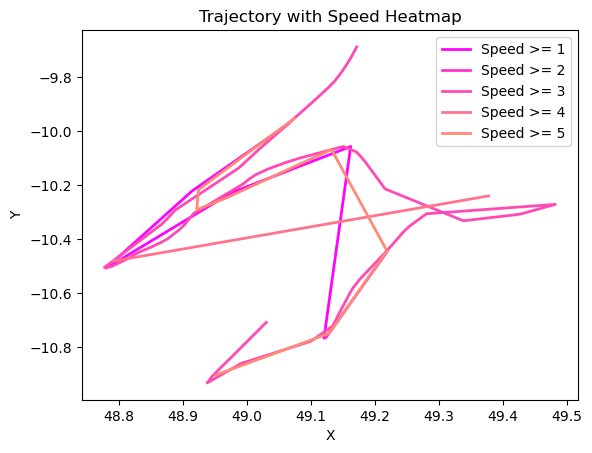

F/V J.M.CHRISTIAN 6
49       43.421008
161      43.421008
273      43.420995
385      43.420992
497      43.421013
           ...    
21217    43.421060
21441    43.421013
21329    43.421013
21553    43.421048
21665    43.421012
Name: position_latitude, Length: 194, dtype: float64


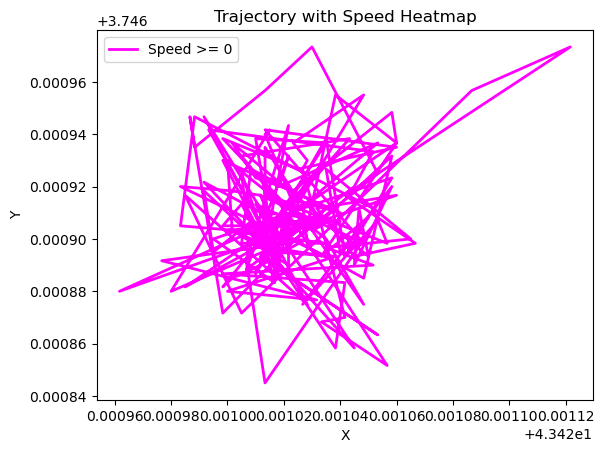

F/VJANVIER L.RAPHAEL
90       22.969740
202      22.969740
314      22.998642
426      23.045408
538      23.069405
           ...    
21258    29.298082
21370    29.342160
21482    29.386142
21594    29.443125
21706    29.501137
Name: position_latitude, Length: 194, dtype: float64


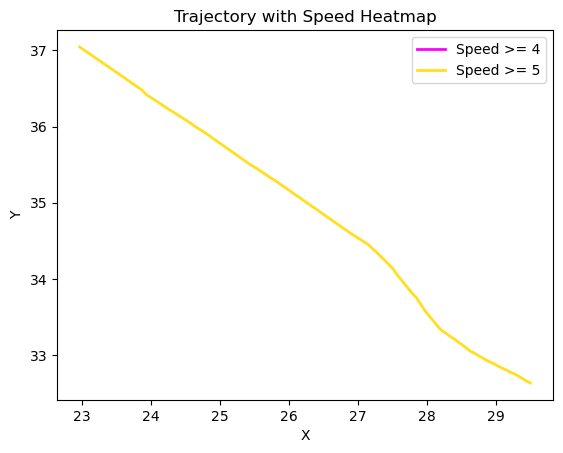

PRINS BERNHARD
97       52.457557
209      52.457557
321      52.457535
433      52.457567
545      52.457553
           ...    
21265    52.457572
21377    52.457517
21489    52.457583
21601    52.457588
21713    52.457572
Name: position_latitude, Length: 194, dtype: float64


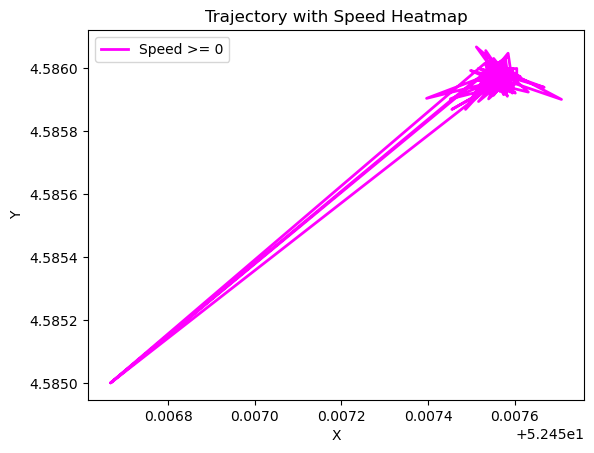

F/V JULIEN COLEOU
108      48.995475
220      48.995475
332      48.942282
444      48.894005
556      48.845315
           ...    
21276    47.728953
21388    47.728962
21500    47.728980
21612    47.728953
21724    47.728955
Name: position_latitude, Length: 194, dtype: float64


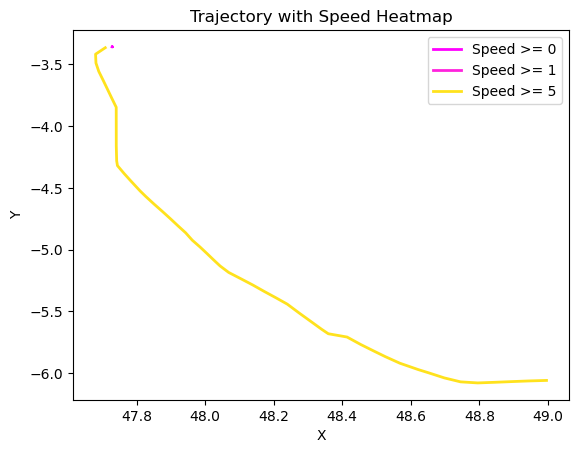

F/V GUERIDEN
170      5.266732
58       5.266732
282      5.266732
394      5.266695
506      5.266642
           ...   
21226    5.290842
21338    5.290843
21450    5.290853
21562    5.290858
21674    5.290868
Name: position_latitude, Length: 194, dtype: float64


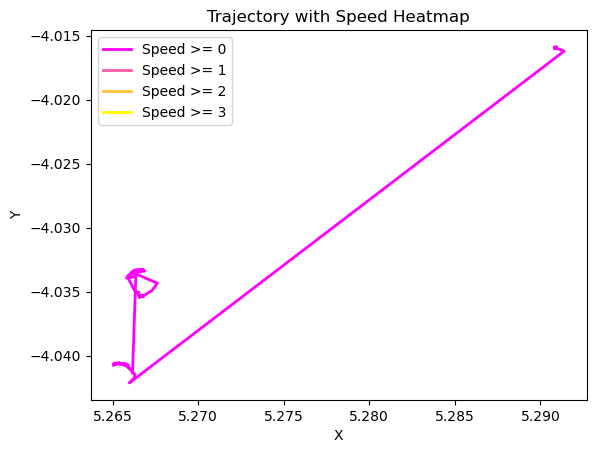

F/V MANUREVA
189      50.724973
77       50.724973
301      50.724972
413      50.724977
525      50.724962
           ...    
21245    50.724963
21357    50.724968
21469    50.724975
21581    50.724980
21693    50.724977
Name: position_latitude, Length: 194, dtype: float64


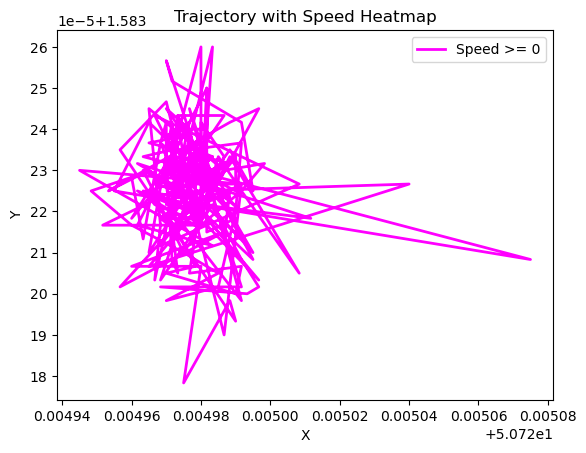

F/V MADELEINE
60       51.586305
172      51.586305
284      51.551110
396      51.529172
508      51.492358
           ...    
21228    50.724840
21340    50.724822
21452    50.724820
21564    50.724832
21676    50.724828
Name: position_latitude, Length: 194, dtype: float64


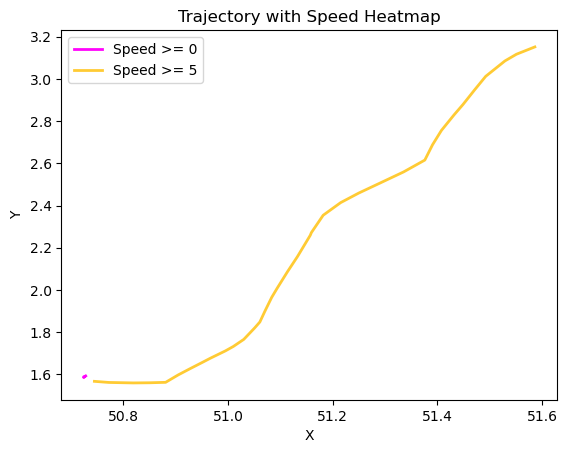

F/V ANDRE LEDUC
67       57.452738
179      57.452738
291      57.423793
403      57.393933
515      57.363335
           ...    
21235    61.170470
21347    61.189812
21459    61.212102
21571    61.272215
21683    61.306905
Name: position_latitude, Length: 194, dtype: float64


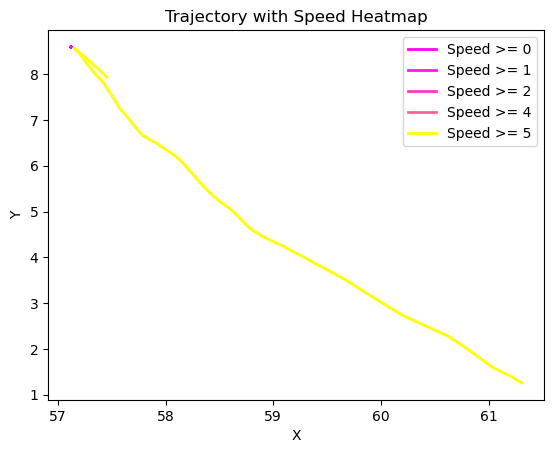

FISHER BANK
218      57.542720
106      57.542720
330      57.512713
442      57.482513
554      57.453760
           ...    
21050    59.986133
21610    60.015493
21498    60.015493
21386    60.015493
21722    60.015493
Name: position_latitude, Length: 194, dtype: float64


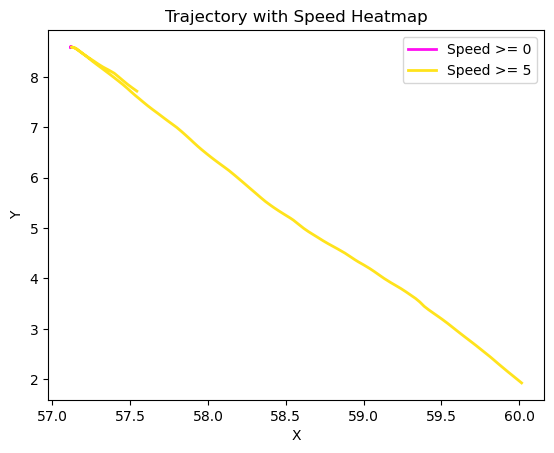

F/V PAX DEI II
196      51.580167
84       51.580167
308      51.545793
420      51.514600
532      51.491173
           ...    
21252    50.724982
21364    50.725000
21476    50.724967
21588    50.724970
21700    50.724965
Name: position_latitude, Length: 194, dtype: float64


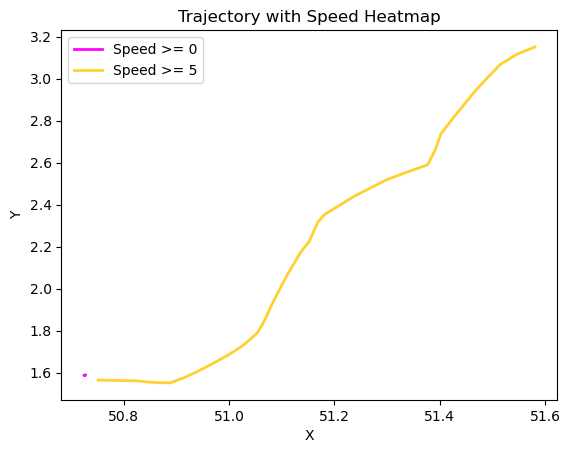

F/V J.M.CHRISTIAN 7
94       38.427533
206      38.427533
318      38.458555
430      38.501940
542      38.558143
           ...    
21262    41.955188
21374    41.915528
21486    41.874953
21598    41.834613
21710    41.793970
Name: position_latitude, Length: 194, dtype: float64


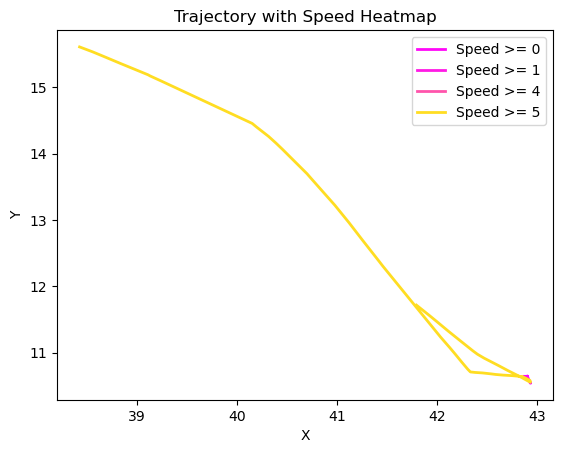

IndexError: index 112 is out of bounds for axis 0 with size 112

In [33]:
# Faire se suivre les records, les intégrer dans la trajectoire 
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

for j in range(200):
    df_ = df[(df['vessel_name'] == df['vessel_name'].unique()[j]) & (df['position_speed'] >=0)]
    print(df[(df['position_speed'] >=0)]['vessel_name'].unique()[j])
    if len(df_[df_['position_speed'] >= 0]) > 20 :
        x = df_['position_latitude']
        print(x)
        y = df_['position_longitude'] 
        speed = df_['position_speed']  
        num_points = len(df_)

        # Define speed thresholds for heatmap
        speed_thresholds = [0,1,2,3,4,5]  # Example thresholds

        # Calculate speed segments
        speed_segments = np.digitize(speed, speed_thresholds)

        # Create colormap for heatmap
        cmap = plt.get_cmap('spring') #hot

        # Plot trajectory as lineplot with segments colored by speed
        for i in range(1, len(speed_thresholds) + 1):
            mask = speed_segments == i
            if np.any(mask):
                segment_x = x[mask]
                segment_y = y[mask]
                segment_speed = speed[mask]
                segment_color = cmap(Normalize(vmin=min(speed), vmax=max(speed))(segment_speed))
                plt.plot(segment_x, segment_y, color=segment_color[0], linewidth=2, label=f'Speed >= {speed_thresholds[i-1]}')

        # Add colorbar
        sm = ScalarMappable(cmap=cmap, norm=Normalize(vmin=min(speed), vmax=max(speed)))
        sm.set_array(speed)
        #plt.colorbar(sm, label='Speed')

        # Add labels and legend
        plt.xlabel('X')
        plt.ylabel('Y')
        plt.title('Trajectory with Speed Heatmap')
        plt.legend()

        # Show plot
        plt.show();


In [ ]:
# Enlever les graphes blancs

In [34]:
df.columns

Index(['id', 'spire_update_statement', 'vessel_ais_class', 'vessel_flag',
       'vessel_name', 'vessel_callsign', 'vessel_timestamp',
       'vessel_update_timestamp', 'vessel_ship_type', 'vessel_sub_ship_type',
       'vessel_mmsi', 'vessel_imo', 'vessel_width', 'vessel_length',
       'position_accuracy', 'position_collection_type', 'position_course',
       'position_heading', 'position_latitude', 'position_longitude',
       'position_maneuver', 'position_navigational_status', 'position_rot',
       'position_speed', 'position_timestamp', 'position_update_timestamp',
       'voyage_destination', 'voyage_draught', 'voyage_eta',
       'voyage_timestamp', 'voyage_update_timestamp', 'created_at'],
      dtype='object')

     position_speed  position_latitude  position_longitude
0               0.1          43.679835           -7.596252
1               0.1          43.679835           -7.596252
2               0.1          43.679835           -7.596252
3               0.1          43.679835           -7.596252
4               0.1          43.679835           -7.596252
5               0.1          43.679835           -7.596252
6               0.1          43.679835           -7.596252
7               0.1          43.679835           -7.596252
8               0.1          43.679835           -7.596252
9               0.1          43.679835           -7.596252
10              0.1          43.679835           -7.596252
11              0.1          43.679835           -7.596252
12              0.1          43.679835           -7.596252
13              0.1          43.679835           -7.596252
14              0.1          43.679835           -7.596252
15              0.1          43.679835           -7.5962

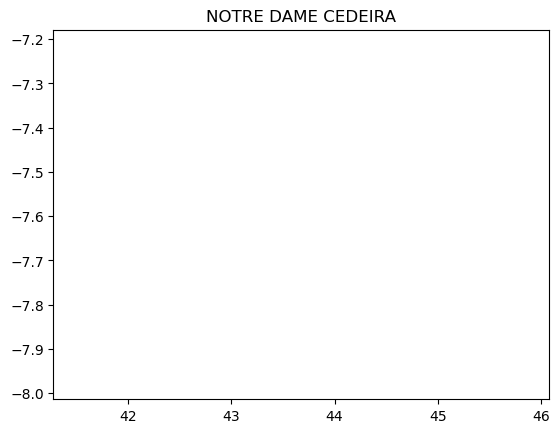

     position_speed  position_latitude  position_longitude
0               0.4           43.32218           -1.914893
1               0.4           43.32218           -1.914893
2               0.4           43.32218           -1.914893
3               0.4           43.32218           -1.914893
4               0.4           43.32218           -1.914893
5               0.4           43.32218           -1.914893
6               0.4           43.32218           -1.914893
7               0.4           43.32218           -1.914893
8               0.4           43.32218           -1.914893
9               0.4           43.32218           -1.914893
10              0.4           43.32218           -1.914893
11              0.4           43.32218           -1.914893
12              0.4           43.32218           -1.914893
13              0.4           43.32218           -1.914893
14              0.4           43.32218           -1.914893
15              0.4           43.32218           -1.9148

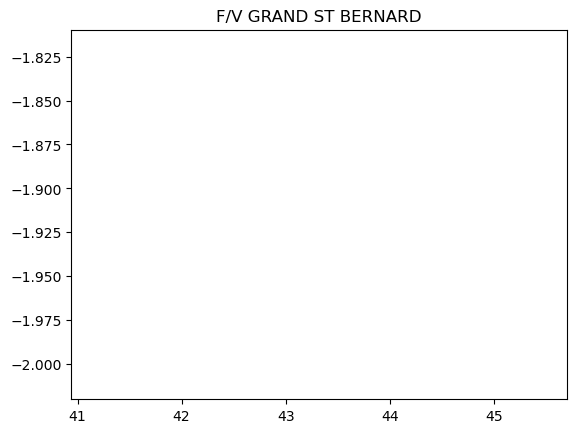

     position_speed  position_latitude  position_longitude
0               0.2          42.258372           -8.691205
1               0.2          42.258372           -8.691205
2               0.2          42.258372           -8.691205
3               0.2          42.258372           -8.691205
4               0.2          42.258372           -8.691205
5               0.2          42.258372           -8.691205
6               0.2          42.258372           -8.691205
7               0.2          42.258372           -8.691205
8               0.2          42.258372           -8.691205
9               0.2          42.258372           -8.691205
10              0.2          42.258372           -8.691205
11              0.2          42.258372           -8.691205
12              0.2          42.258372           -8.691205
13              0.2          42.258372           -8.691205
14              0.2          42.258372           -8.691205
15              0.2          42.258372           -8.6912

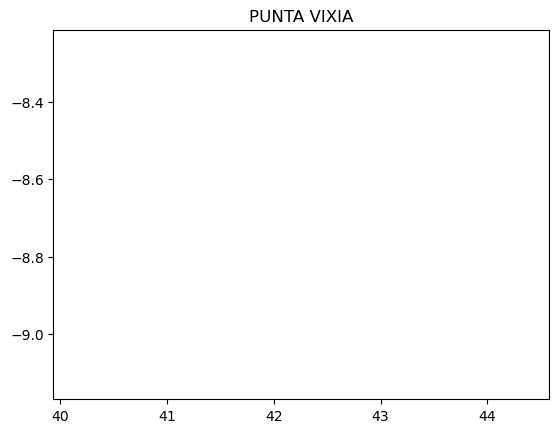

     position_speed  position_latitude  position_longitude
0               0.1          14.684228          -17.429313
1               0.1          14.684228          -17.429313
2               0.1          14.684228          -17.429313
3               0.1          14.684228          -17.429313
4               0.1          14.684228          -17.429313
5               0.1          14.684228          -17.429313
6               0.1          14.684228          -17.429313
7               0.1          14.684228          -17.429313
8               0.1          14.684228          -17.429313
9               0.1          14.684228          -17.429313
10              0.1          14.684228          -17.429313
11              0.1          14.684228          -17.429313
12              0.1          14.684228          -17.429313
13              0.1          14.684228          -17.429313
14              0.1          14.684228          -17.429313
15              0.1          14.684228          -17.4293

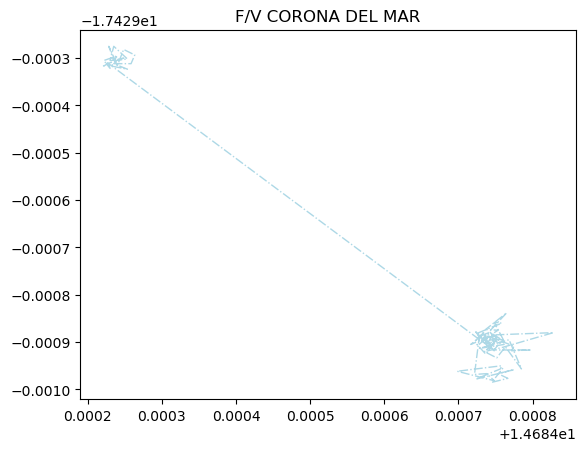

     position_speed  position_latitude  position_longitude
0               2.8          52.754833          -12.317030
1               2.8          52.754833          -12.317030
2               2.8          52.754833          -12.317030
3               2.8          52.754833          -12.317030
4               2.8          52.754833          -12.317030
5               2.8          52.754833          -12.317030
6               2.8          52.754833          -12.317030
7               2.8          52.754833          -12.317030
8               2.8          52.754833          -12.317030
9               2.8          52.754833          -12.317030
10              2.8          52.754833          -12.317030
11              2.8          52.754833          -12.317030
12              2.8          52.754833          -12.317030
13              2.8          52.754833          -12.317030
14              2.8          52.754833          -12.317030
15              2.8          52.754833          -12.3170

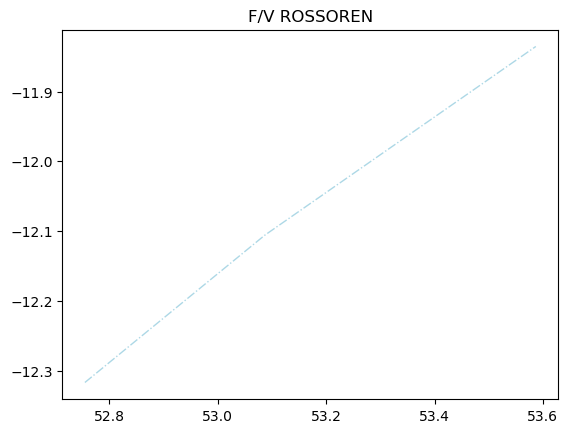

     position_speed  position_latitude  position_longitude
0               0.5           14.68533          -17.430223
1               0.5           14.68533          -17.430223
2               0.5           14.68533          -17.430223
3               0.5           14.68533          -17.430223
4               0.5           14.68533          -17.430223
5               0.5           14.68533          -17.430223
6               0.5           14.68533          -17.430223
7               0.5           14.68533          -17.430223
8               0.5           14.68533          -17.430223
9               0.5           14.68533          -17.430223
10              0.5           14.68533          -17.430223
11              0.5           14.68533          -17.430223
12              0.5           14.68533          -17.430223
13              0.5           14.68533          -17.430223
14              0.5           14.68533          -17.430223
15              0.5           14.68533          -17.4302

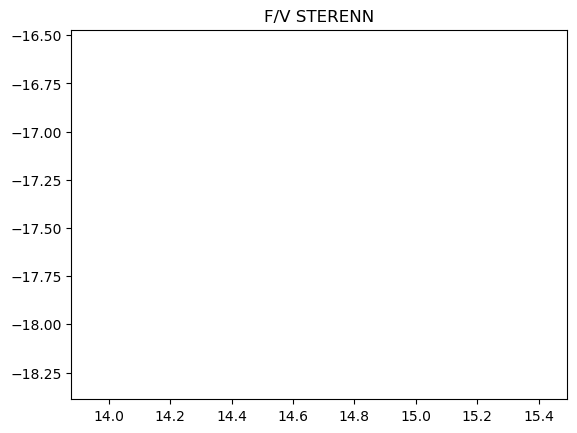

     position_speed  position_latitude  position_longitude
0               0.1          43.403590            3.702032
1               0.1          43.403590            3.702032
2               0.1          43.403590            3.702032
3               0.1          43.403590            3.702032
4               0.1          43.403590            3.702032
5               0.1          43.403590            3.702032
6               0.1          43.403590            3.702032
7               0.1          43.403590            3.702032
8               0.1          43.403590            3.702032
9               0.1          43.403590            3.702032
10              0.1          43.403590            3.702032
11              0.1          43.403590            3.702032
12              0.1          43.403590            3.702032
13              0.1          43.403590            3.702032
14              0.1          43.403590            3.702032
15              0.1          43.403590            3.7020

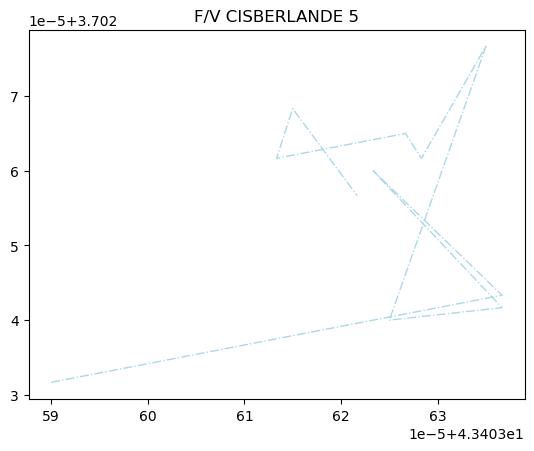

     position_speed  position_latitude  position_longitude
0               0.5          50.561082          -10.487038
1               0.5          50.561082          -10.487038
2               0.5          50.561082          -10.487038
3               0.5          50.561082          -10.487038
4               0.5          50.561082          -10.487038
5               0.5          50.561082          -10.487038
6               0.5          50.561082          -10.487038
7               0.5          50.561082          -10.487038
8               0.5          50.561082          -10.487038
9               0.5          50.561082          -10.487038
10              0.5          50.561082          -10.487038
11              0.5          50.561082          -10.487038
12              0.5          50.561082          -10.487038
13              0.5          50.561082          -10.487038
14              0.5          50.561082          -10.487038
15              0.5          50.561082          -10.4870

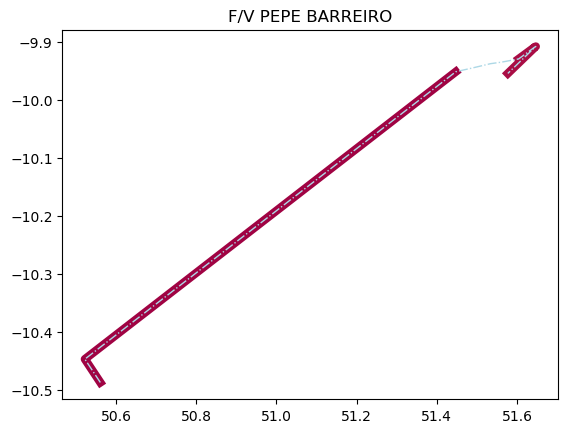

     position_speed  position_latitude  position_longitude
0               1.2          51.746657          -11.488778
1               1.2          51.746657          -11.488778
2               1.2          51.746657          -11.488778
3               1.2          51.746657          -11.488778
4               1.2          51.746657          -11.488778
5               1.2          51.746657          -11.488778
6               1.2          51.746657          -11.488778
7               1.2          51.746657          -11.488778
8               1.2          51.746657          -11.488778
9               1.2          51.746657          -11.488778
10              1.2          51.746657          -11.488778
11              1.2          51.746657          -11.488778
12              1.2          51.746657          -11.488778
13              1.2          51.746657          -11.488778
14              1.2          51.746657          -11.488778
15              1.2          51.746657          -11.4887

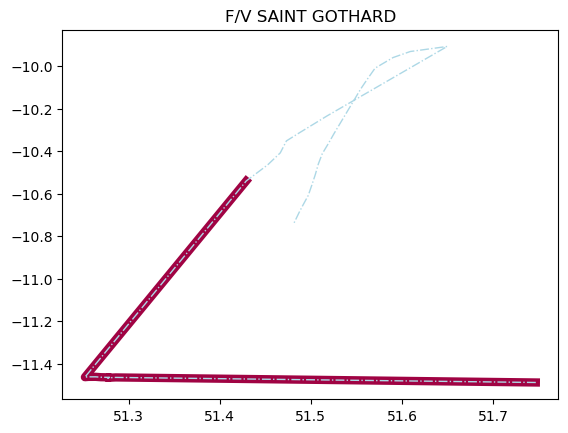

     position_speed  position_latitude  position_longitude
0               5.4          52.948763          -14.312168
1               5.4          52.948763          -14.312168
2               5.4          52.948763          -14.312168
3               5.4          52.948763          -14.312168
4               5.4          52.948763          -14.312168
5               5.4          52.948763          -14.312168
6               5.4          52.948763          -14.312168
7               5.4          52.948763          -14.312168
8               5.4          52.948763          -14.312168
9               5.4          52.948763          -14.312168
10              5.4          52.948763          -14.312168
11              5.4          52.948763          -14.312168
12              5.4          52.948763          -14.312168
13              5.4          52.948763          -14.312168
14              5.4          52.948763          -14.312168
15              5.4          52.948763          -14.3121

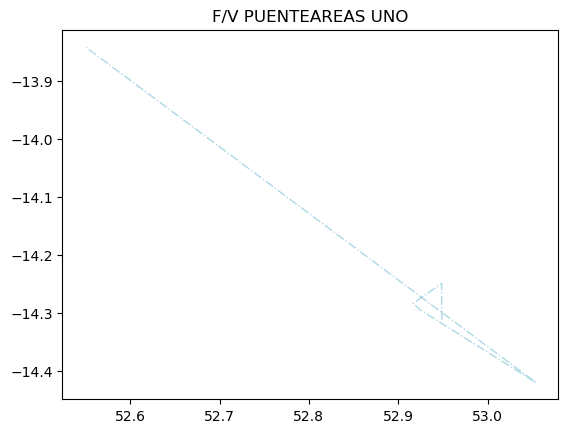

     position_speed  position_latitude  position_longitude
0               5.6          52.537592          -11.901778
1               5.6          52.537592          -11.901778
2               5.6          52.537592          -11.901778
3               5.6          52.537592          -11.901778
4               5.6          52.537592          -11.901778
5               5.6          52.537592          -11.901778
6               5.6          52.537592          -11.901778
7               5.6          52.537592          -11.901778
8               5.6          52.537592          -11.901778
9               5.6          52.537592          -11.901778
10              5.6          52.537592          -11.901778
11              5.6          52.537592          -11.901778
12              5.6          52.537592          -11.901778
13              5.6          52.537592          -11.901778
14              5.6          52.537592          -11.901778
15              5.6          52.537592          -11.9017

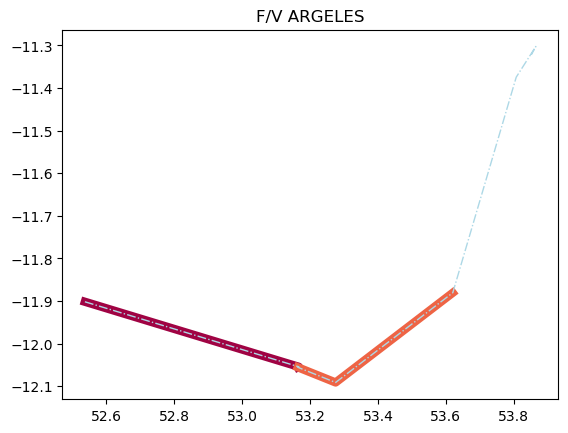

     position_speed  position_latitude  position_longitude
0               3.0          52.340000          -11.663333
1               3.0          52.340000          -11.663333
2               3.0          52.340000          -11.663333
3               3.0          52.340000          -11.663333
4               3.0          52.340000          -11.663333
5               3.0          52.340000          -11.663333
6               3.0          52.340000          -11.663333
7               3.0          52.340000          -11.663333
8               3.0          52.340000          -11.663333
9               3.0          52.340000          -11.663333
10              3.0          52.340000          -11.663333
11              3.0          52.340000          -11.663333
12              3.0          52.340000          -11.663333
13              3.0          52.340000          -11.663333
14              3.0          52.340000          -11.663333
15              3.0          52.340000          -11.6633

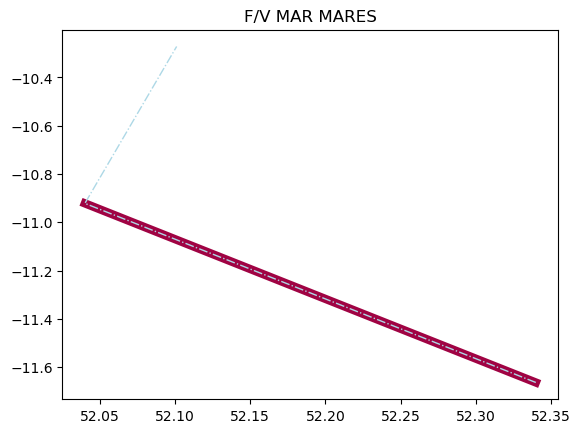

     position_speed  position_latitude  position_longitude
0               3.4          54.045703          -11.108653
1               3.4          54.045703          -11.108653
2               3.4          54.045703          -11.108653
3               3.4          54.045703          -11.108653
4               3.4          54.045703          -11.108653
5               3.4          54.045703          -11.108653
6               3.4          54.045703          -11.108653
7               3.4          54.045703          -11.108653
8               3.3          53.976422          -11.169360
9               3.3          53.976422          -11.169360
10              3.3          53.976422          -11.169360
11              3.3          53.976422          -11.169360
12              3.3          53.976422          -11.169360
13              3.3          53.976422          -11.169360
14              3.3          53.976422          -11.169360
15              3.3          53.976422          -11.1693

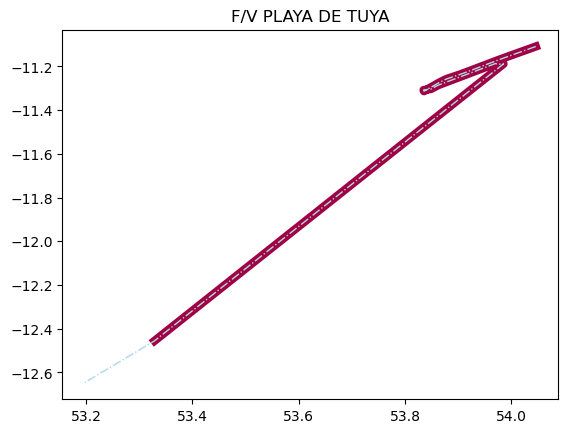

     position_speed  position_latitude  position_longitude
0               3.2          51.433477          -11.449643
1               3.2          51.433477          -11.449643
2               3.2          51.433477          -11.449643
3               3.2          51.433477          -11.449643
4               3.2          51.433477          -11.449643
5               3.2          51.433477          -11.449643
6               3.2          51.433477          -11.449643
7               3.2          51.433477          -11.449643
8               3.2          51.433477          -11.449643
9               3.2          51.433477          -11.449643
10              3.2          51.433477          -11.449643
11              3.2          51.433477          -11.449643
12              3.2          51.433477          -11.449643
13              3.2          51.433477          -11.449643
14              3.2          51.433477          -11.449643
15              3.2          51.433477          -11.4496

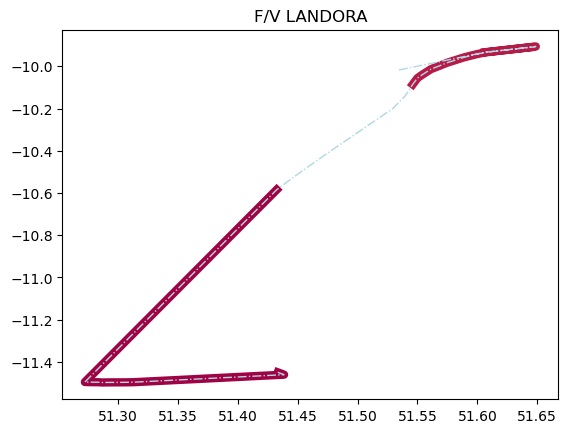

     position_speed  position_latitude  position_longitude
0               1.0          51.371768          -11.417992
1               1.0          51.371768          -11.417992
2               1.0          51.371768          -11.417992
3               1.0          51.371768          -11.417992
4               1.0          51.371768          -11.417992
5               1.0          51.371768          -11.417992
6               1.0          51.371768          -11.417992
7               1.0          51.371768          -11.417992
8               1.0          51.371768          -11.417992
9               1.0          51.371768          -11.417992
10              1.0          51.371768          -11.417992
11              1.0          51.371768          -11.417992
12              1.0          51.371768          -11.417992
13              1.0          51.371768          -11.417992
14              1.0          51.371768          -11.417992
15              1.0          51.371768          -11.4179

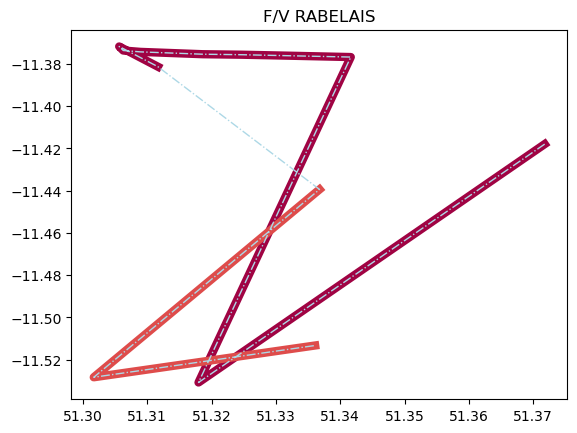

     position_speed  position_latitude  position_longitude
0               0.8           9.125173          -17.208292
1               0.8           9.125173          -17.208292
2               0.8           9.125173          -17.208292
3               0.8           9.125173          -17.208292
4               0.8           9.125173          -17.208292
5               0.8           9.125173          -17.208292
6               0.8           9.125173          -17.208292
7               9.8           9.614947          -17.987732
8               4.7           9.607348          -17.939993
9               0.6           9.608492          -17.941083
10              0.7           9.606677          -17.941567
11              0.5           9.603895          -17.942313
12              0.5           9.602382          -17.942525
13              0.5           9.600103          -17.943142
14              0.1           9.599022          -17.943598
15              0.3           9.598927          -17.9435

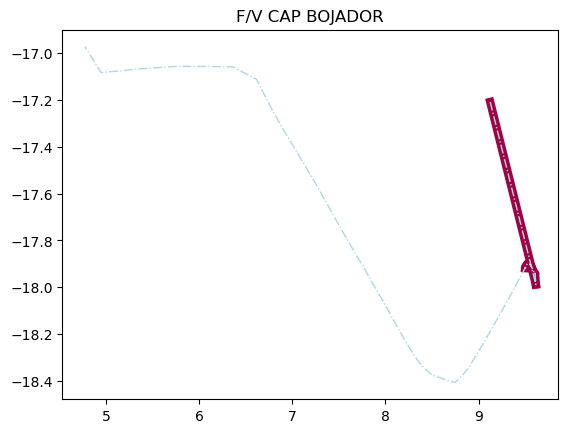

     position_speed  position_latitude  position_longitude
0               2.5           9.205023          -17.091690
1               2.5           9.205023          -17.091690
2               2.5           9.205023          -17.091690
3               2.5           9.205023          -17.091690
4              10.8           9.744057          -18.033833
5               2.0           9.772423          -18.061033
6               0.2           9.774045          -18.058368
7               0.5           9.772108          -18.055947
8               0.7           9.771205          -18.054900
9               0.7           9.771205          -18.054900
10              0.8           9.768205          -18.051265
11              0.7           9.765577          -18.048520
12              0.7           9.764722          -18.047178
13              0.9           9.762143          -18.043928
14              0.9           9.759545          -18.040600
15              0.7           9.757255          -18.0379

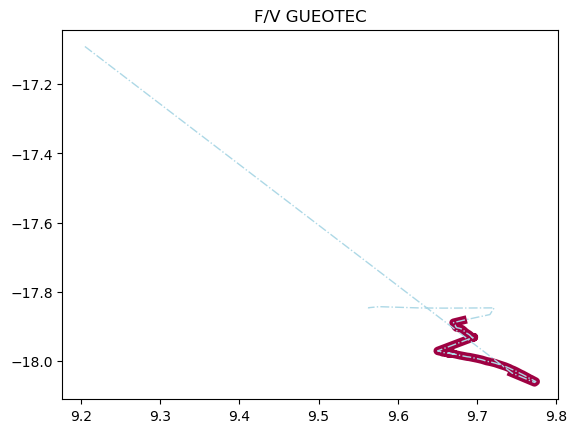

     position_speed  position_latitude  position_longitude
0               3.8          60.544587            0.340900
1               3.8          60.544587            0.340900
2               3.8          60.544587            0.340900
3               3.8          60.544587            0.340900
4               3.8          60.544587            0.340900
5               3.8          60.544587            0.340900
6               3.8          60.544587            0.340900
7               3.8          60.544587            0.340900
8               3.8          60.544587            0.340900
9               3.8          60.544587            0.340900
10              3.8          60.544587            0.340900
11              3.8          60.544587            0.340900
12              3.8          60.544587            0.340900
13              3.8          60.544587            0.340900
14              3.8          60.544587            0.340900
15              3.8          60.544587            0.3409

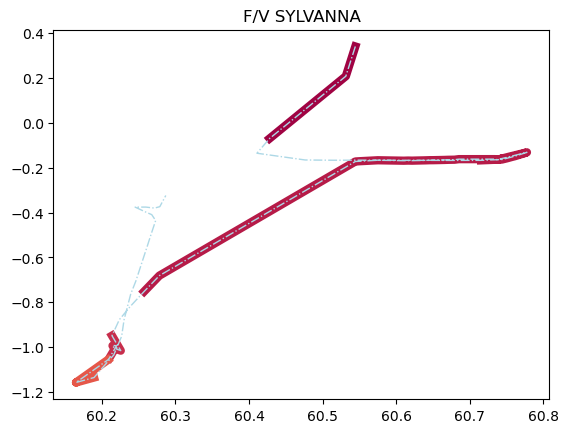

     position_speed  position_latitude  position_longitude
0               3.6          49.745077          -10.957972
1               3.6          49.745077          -10.957972
2               3.6          49.745077          -10.957972
3               3.6          49.745077          -10.957972
4               3.6          49.745077          -10.957972
5               3.6          49.745077          -10.957972
6               3.6          49.745077          -10.957972
7               3.6          49.745077          -10.957972
8               3.6          49.745077          -10.957972
9               3.6          49.745077          -10.957972
10              3.6          49.745077          -10.957972
11              3.6          49.745077          -10.957972
12              3.6          49.745077          -10.957972
13              3.6          49.745077          -10.957972
14              3.6          49.745077          -10.957972
15              3.6          49.745077          -10.9579

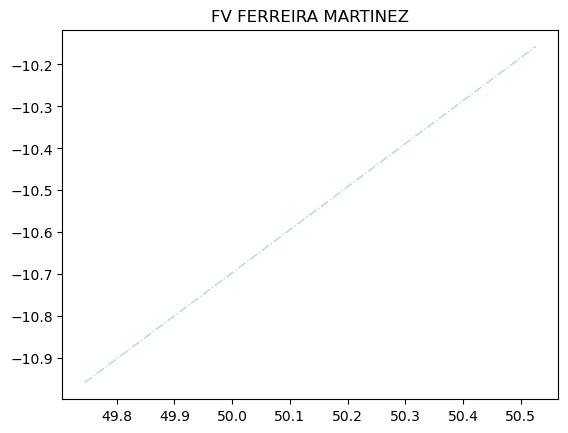

     position_speed  position_latitude  position_longitude
0               1.4          60.629035           -2.119787
1               1.4          60.629035           -2.119787
2               1.4          60.629035           -2.119787
3               1.4          60.629035           -2.119787
4               1.4          60.629035           -2.119787
5               1.4          60.629035           -2.119787
6               1.4          60.629035           -2.119787
7               1.4          60.629035           -2.119787
8               1.4          60.629035           -2.119787
9               1.4          60.629035           -2.119787
10              1.4          60.629035           -2.119787
11              1.4          60.629035           -2.119787
12              1.4          60.629035           -2.119787
13              1.4          60.629035           -2.119787
14              1.5          60.561163           -2.343645
15              1.5          60.561163           -2.3436

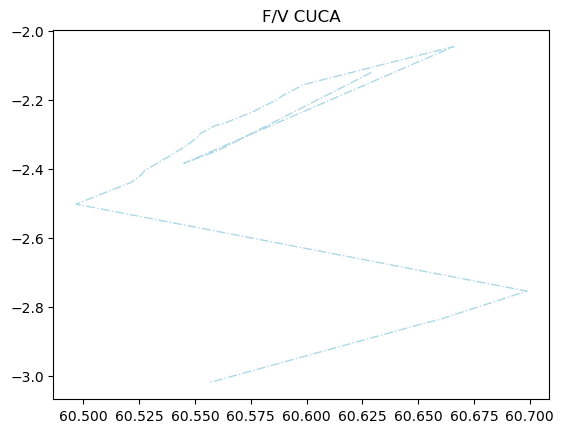

     position_speed  position_latitude  position_longitude
0               0.3          49.769508          -11.188280
1               0.3          49.769508          -11.188280
2               0.3          49.769508          -11.188280
3               0.3          49.769508          -11.188280
4               0.3          49.769508          -11.188280
5               0.3          49.769508          -11.188280
6               0.3          49.769508          -11.188280
7               0.3          49.769508          -11.188280
8               0.3          49.769508          -11.188280
9               0.3          49.769508          -11.188280
10              0.3          49.769508          -11.188280
11              0.3          49.769508          -11.188280
12              0.3          49.769508          -11.188280
13              0.3          49.769508          -11.188280
14              0.3          49.769508          -11.188280
15              0.3          49.769508          -11.1882

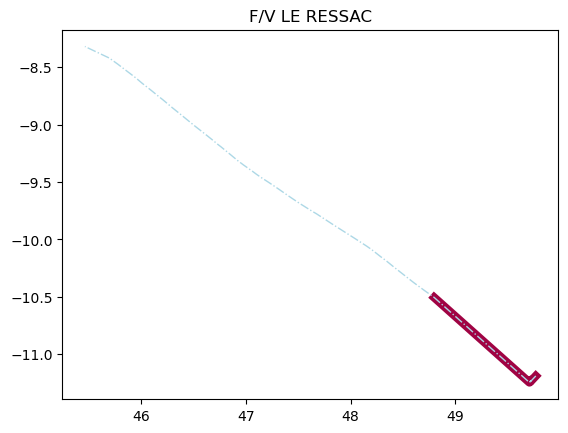

     position_speed  position_latitude  position_longitude
0               6.0          49.003715          -10.210257
1               6.0          49.003715          -10.210257
2               6.0          49.003715          -10.210257
3               6.0          49.003715          -10.210257
4               6.0          49.003715          -10.210257
5               6.0          49.003715          -10.210257
6               6.0          49.003715          -10.210257
7               6.0          49.003715          -10.210257
8               6.0          49.003715          -10.210257
9               6.0          49.003715          -10.210257
10              6.0          49.003715          -10.210257
11              8.7          49.082950          -10.453513
12              8.7          49.082950          -10.453513
13              8.7          49.082950          -10.453513
14              8.7          49.082950          -10.453513
15              8.7          49.082950          -10.4535

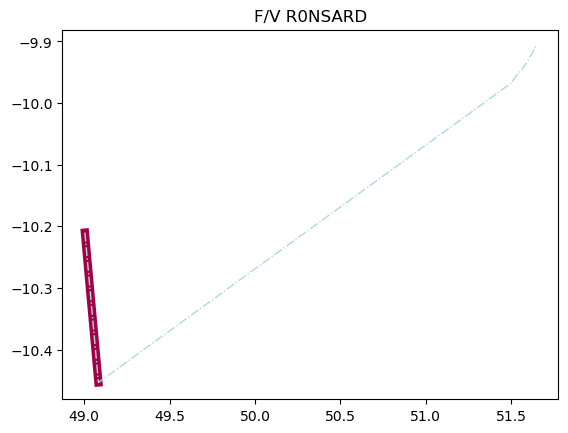

     position_speed  position_latitude  position_longitude
0               2.9          50.531713            0.549555
1               2.9          50.531713            0.549555
2               2.9          50.531713            0.549555
3               2.9          50.531713            0.549555
4               2.9          50.531713            0.549555
5               2.9          50.531713            0.549555
6               2.9          50.531713            0.549555
7               2.9          50.531713            0.549555
8               2.9          50.531713            0.549555
9               2.9          50.531713            0.549555
10              2.9          50.531713            0.549555
11              2.9          50.531713            0.549555
12              2.9          50.531713            0.549555
13              2.9          50.531713            0.549555
14              2.9          50.531713            0.549555
15              9.9          49.977853            1.0538

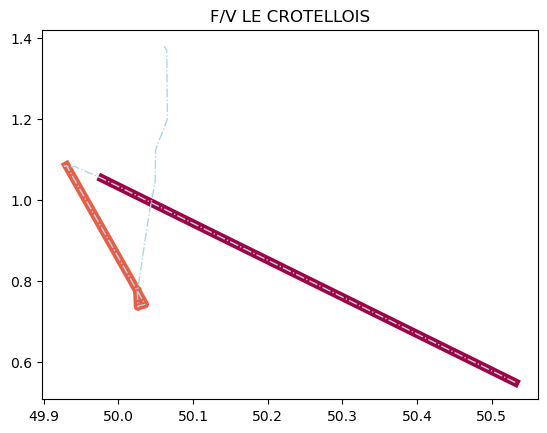

     position_speed  position_latitude  position_longitude
0               0.2          51.309705          -11.483388
1               0.2          51.309705          -11.483388
2               0.2          51.309705          -11.483388
3               0.2          51.309705          -11.483388
4               0.2          51.309705          -11.483388
5               0.2          51.309705          -11.483388
6               0.2          51.309705          -11.483388
7               0.2          51.309705          -11.483388
8               0.2          51.309705          -11.483388
9               0.2          51.309705          -11.483388
10              0.2          51.309705          -11.483388
11              0.2          51.309705          -11.483388
12              0.2          51.309705          -11.483388
13              0.2          51.309705          -11.483388
14              0.2          51.309705          -11.483388
15              0.2          51.309705          -11.4833

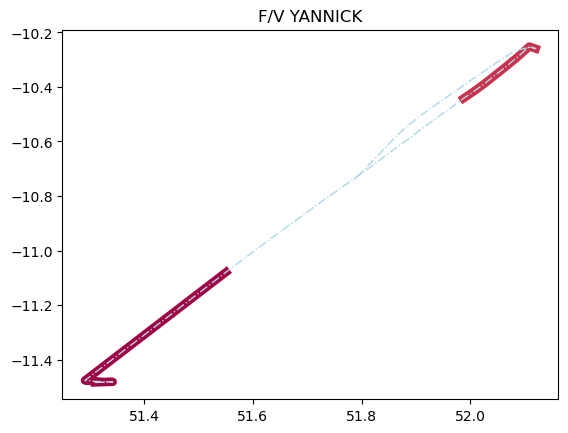

     position_speed  position_latitude  position_longitude
0               4.8          61.686193           -0.814257
1               4.8          61.686193           -0.814257
2               4.8          61.686193           -0.814257
3               4.8          61.686193           -0.814257
4               4.8          61.686193           -0.814257
5               4.8          61.686193           -0.814257
6               4.8          61.686193           -0.814257
7               4.1          61.734853           -0.772873
8               4.1          61.734853           -0.772873
9               4.1          61.734853           -0.772873
10              4.1          61.734853           -0.772873
11              4.1          61.734853           -0.772873
12              2.5          61.766422           -0.668502
13              2.5          61.766422           -0.668502
14              2.5          61.766422           -0.668502
15              2.5          61.766422           -0.6685

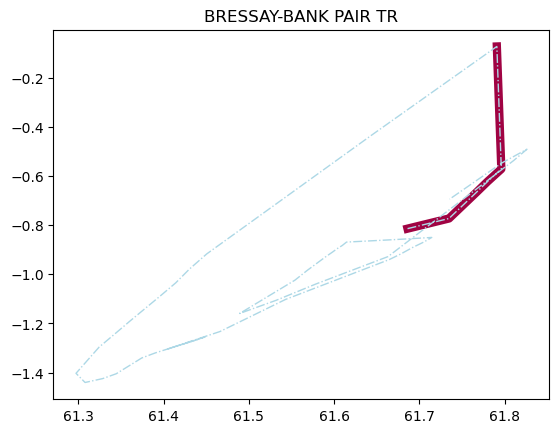

     position_speed  position_latitude  position_longitude
0               3.8          61.636562           -0.880395
1               3.8          61.636562           -0.880395
2               3.8          61.636562           -0.880395
3               3.8          61.636562           -0.880395
4               3.8          61.636562           -0.880395
5               9.9          61.365297           -0.633253
6               9.9          61.365297           -0.633253
7               9.9          61.365297           -0.633253
8               9.9          61.365297           -0.633253
9              10.4          61.177757           -0.331542
10             10.4          61.177757           -0.331542
11             10.4          61.177757           -0.331542
12             10.4          61.177757           -0.331542
13             10.7          61.058355           -0.171457
14             10.7          61.058355           -0.171457
15             11.0          60.983168           -0.0720

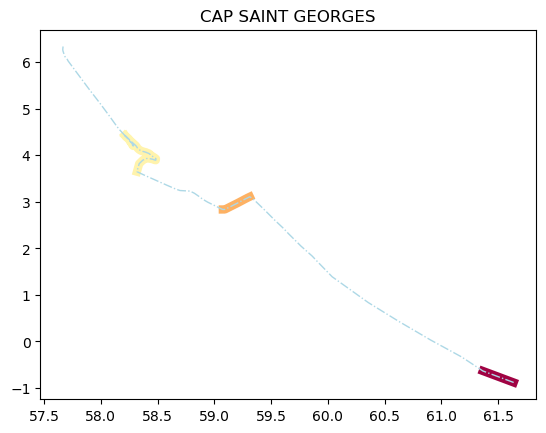

     position_speed  position_latitude  position_longitude
0               0.1          43.680747           -7.596992
1               0.1          43.680747           -7.596992
2               0.1          43.680747           -7.596992
3               0.1          43.680747           -7.596992
4               0.1          43.680747           -7.596992
5               0.1          43.680747           -7.596992
6               0.1          43.680747           -7.596992
7               0.1          43.680747           -7.596992
8               0.1          43.680747           -7.596992
9               0.1          43.680747           -7.596992
10              0.1          43.680747           -7.596992
11              0.1          43.680747           -7.596992
12              0.1          43.680747           -7.596992
13              0.1          43.680747           -7.596992
14              0.1          43.680747           -7.596992
15              0.1          43.680747           -7.5969

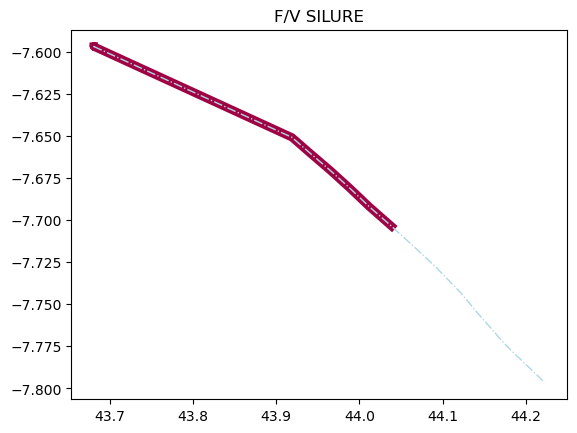

     position_speed  position_latitude  position_longitude
0               2.5          51.646270           -9.907755
1               2.5          51.646270           -9.907755
2               2.5          51.646270           -9.907755
3               2.5          51.646270           -9.907755
4               2.5          51.646270           -9.907755
5               2.5          51.646270           -9.907755
6               2.5          51.646270           -9.907755
7               2.5          51.646270           -9.907755
8               2.5          51.646270           -9.907755
9               2.5          51.646270           -9.907755
10              2.5          51.646270           -9.907755
11              2.5          51.646270           -9.907755
12              2.5          51.646270           -9.907755
13              2.5          51.646270           -9.907755
14              2.5          51.646270           -9.907755
15              2.5          51.646270           -9.9077

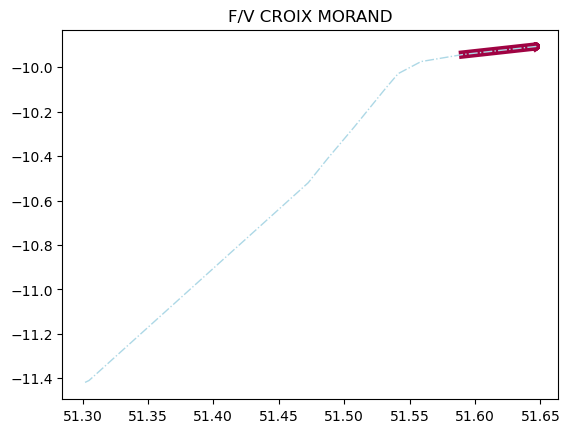

     position_speed  position_latitude  position_longitude
0               3.0          51.496547          -11.359993
1               3.0          51.496547          -11.359993
2               3.0          51.496547          -11.359993
3               3.0          51.496547          -11.359993
4               3.0          51.496547          -11.359993
5               3.0          51.496547          -11.359993
6               3.0          51.496547          -11.359993
7               3.0          51.496547          -11.359993
8               3.0          51.400427          -11.348427
9               3.0          51.400427          -11.348427
10              3.0          51.400427          -11.348427
11              3.0          51.400427          -11.348427
12              3.0          51.400427          -11.348427
13              3.0          51.400427          -11.348427
14              3.0          51.400427          -11.348427
15              3.0          51.400427          -11.3484

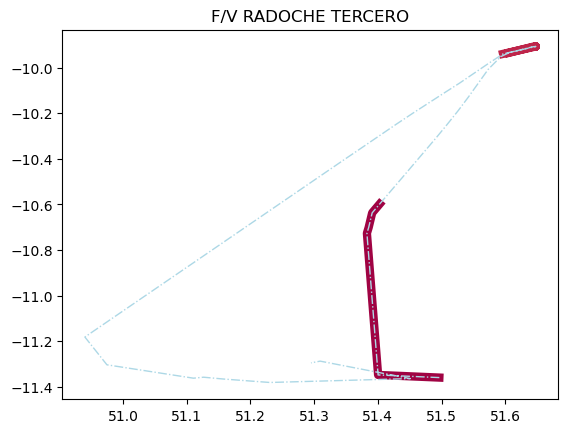

     position_speed  position_latitude  position_longitude
0               0.1          43.657252           -7.349448
1               0.1          43.657252           -7.349448
2               0.1          43.657252           -7.349448
3               0.1          43.657252           -7.349448
4               0.1          43.657252           -7.349448
5               0.1          43.657252           -7.349448
6               0.1          43.657252           -7.349448
7               0.1          43.657252           -7.349448
8               0.1          43.657252           -7.349448
9               0.1          43.657252           -7.349448
10              0.1          43.657252           -7.349448
11              0.1          43.657252           -7.349448
12              0.1          43.657252           -7.349448
13              0.1          43.657252           -7.349448
14              0.1          43.657252           -7.349448
15              0.1          43.657252           -7.3494

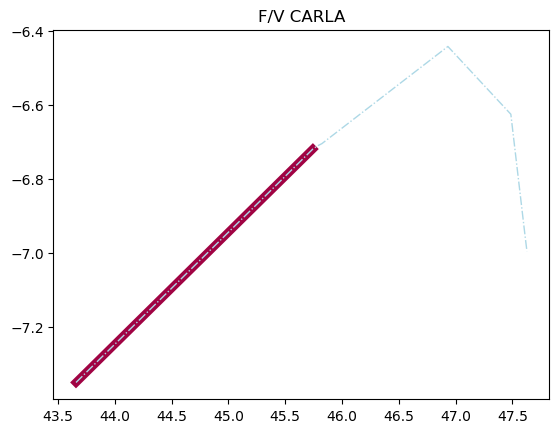

     position_speed  position_latitude  position_longitude
0               1.1          50.990838          -10.599687
1               1.1          50.990838          -10.599687
2               1.1          50.990838          -10.599687
3               1.1          50.990838          -10.599687
4               1.1          50.990838          -10.599687
5               1.1          50.990838          -10.599687
6               1.1          50.990838          -10.599687
7               1.1          50.990838          -10.599687
8               1.1          50.990838          -10.599687
9               1.1          50.990838          -10.599687
10              1.1          50.990838          -10.599687
11              1.1          50.990838          -10.599687
12              1.1          50.990838          -10.599687
13              1.1          50.990838          -10.599687
14              1.1          50.990838          -10.599687
15              1.1          50.990838          -10.5996

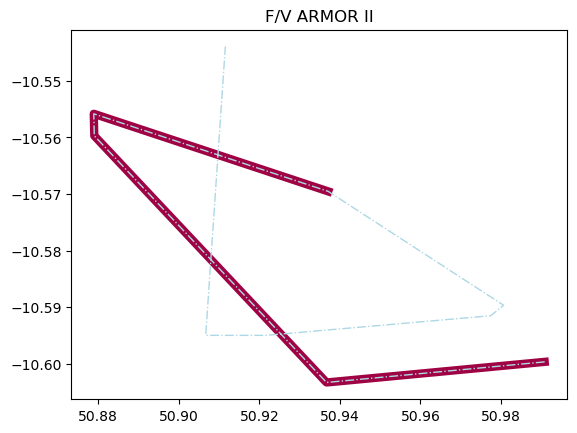

     position_speed  position_latitude  position_longitude
0               4.5          57.510192           -9.577457
1               4.5          57.510192           -9.577457
2               4.5          57.510192           -9.577457
3               4.5          57.510192           -9.577457
4               4.5          57.510192           -9.577457
5               4.5          57.510192           -9.577457
6               3.0          57.473318           -9.610563
7               3.0          57.473318           -9.610563
8               2.9          57.435793           -9.602525
9               2.9          57.435793           -9.602525
10              2.9          57.435793           -9.602525
11              2.9          57.435793           -9.602525
12              2.9          57.435793           -9.602525
13              2.9          57.435793           -9.602525
14              2.9          57.435793           -9.602525
15              2.9          57.435793           -9.6025

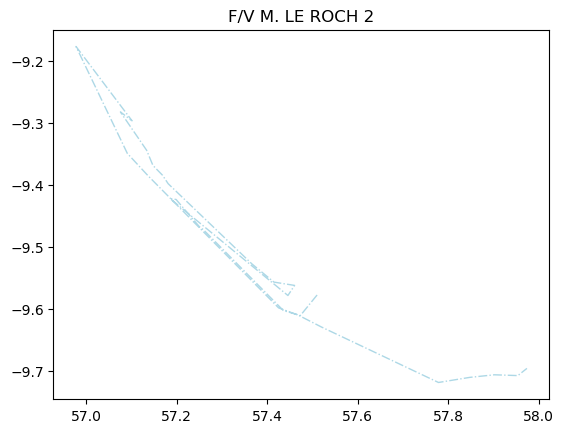

     position_speed  position_latitude  position_longitude
0               3.3          58.542457           -8.750945
1               3.3          58.542457           -8.750945
2               3.3          58.542457           -8.750945
3               3.3          58.542457           -8.750945
4               3.3          58.542457           -8.750945
5               3.3          58.542457           -8.750945
6               1.1          58.526527           -8.804783
7               1.1          58.526527           -8.804783
8               2.2          58.573467           -8.922063
9               2.2          58.573467           -8.922063
10              2.2          58.573467           -8.922063
11              2.2          58.573467           -8.922063
12              3.3          58.510723           -9.126010
13              3.3          58.510723           -9.126010
14              3.3          58.510723           -9.126010
15              3.3          58.510723           -9.1260

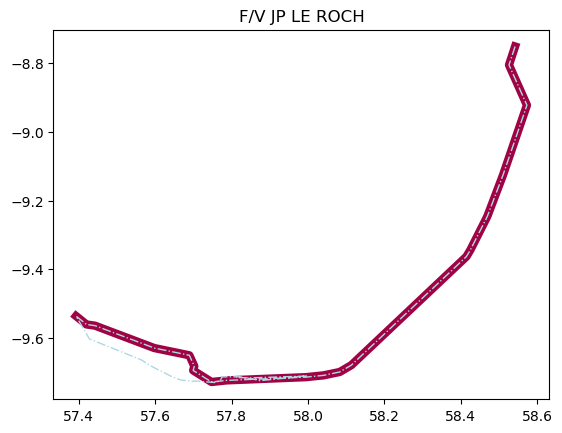

     position_speed  position_latitude  position_longitude
0               6.9          51.246000          -10.169285
1               6.9          51.246000          -10.169285
2               6.9          51.246000          -10.169285
3               6.9          51.246000          -10.169285
4               6.9          51.246000          -10.169285
5               6.9          51.246000          -10.169285
6               6.9          51.246000          -10.169285
7               6.9          51.246000          -10.169285
8               6.9          51.246000          -10.169285
9               6.9          51.246000          -10.169285
10              6.9          51.246000          -10.169285
11              6.9          51.246000          -10.169285
12              6.9          51.246000          -10.169285
13              6.9          51.246000          -10.169285
14              6.9          51.246000          -10.169285
15              6.9          51.246000          -10.1692

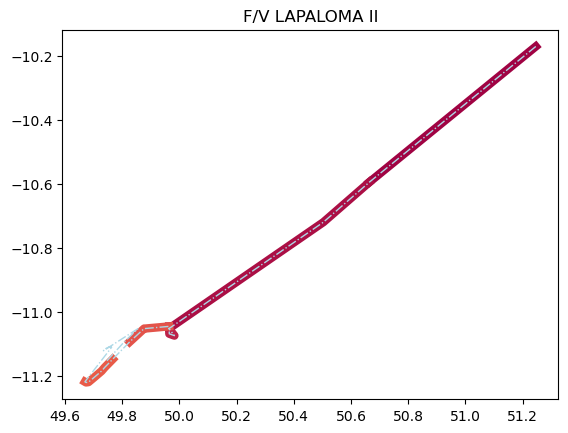

     position_speed  position_latitude  position_longitude
0               9.3          53.187485          -14.530107
1               9.3          53.187485          -14.530107
2               9.3          53.187485          -14.530107
3               9.3          53.187485          -14.530107
4               9.3          53.187485          -14.530107
5               9.3          53.187485          -14.530107
6               6.2          53.340132          -14.377778
7               6.2          53.340132          -14.377778
8               6.2          53.340132          -14.377778
9               6.2          53.340132          -14.377778
10              6.2          53.340132          -14.377778
11              6.2          53.340132          -14.377778
12              6.2          53.340132          -14.377778
13              6.2          53.340132          -14.377778
14              6.2          53.340132          -14.377778
15              6.2          53.340132          -14.3777

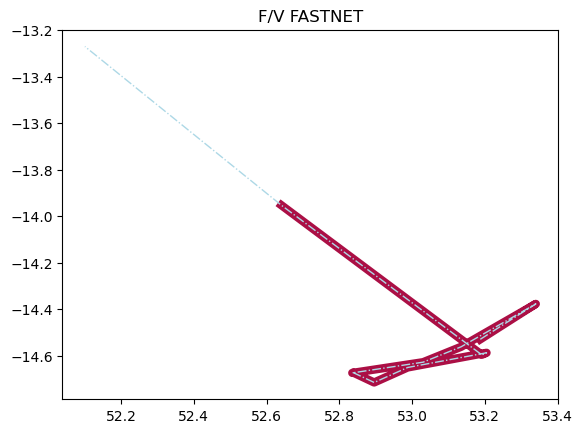

     position_speed  position_latitude  position_longitude
0               2.1          49.981300            0.259300
1               2.1          49.981300            0.259300
2               2.1          49.981300            0.259300
3               2.1          49.981300            0.259300
4               2.1          49.981300            0.259300
5               2.1          49.981300            0.259300
6               2.1          49.981300            0.259300
7               2.1          49.981300            0.259300
8               2.1          49.981300            0.259300
9               2.1          49.981300            0.259300
10              2.1          49.981300            0.259300
11              2.1          49.981300            0.259300
12              2.1          49.981300            0.259300
13              2.1          49.981300            0.259300
14              2.1          49.981300            0.259300
15              2.1          49.981300            0.2593

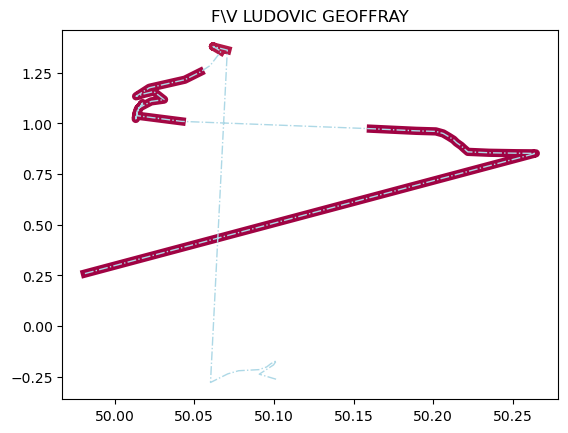

     position_speed  position_latitude  position_longitude
0               3.7          49.841455          -10.943632
1               3.7          49.841455          -10.943632
2               3.5          49.812532          -10.936733
3               3.5          49.799738          -10.948012
4               3.3          49.798887          -10.949923
5               3.6          49.791580          -10.973820
6               3.5          49.783095          -11.006617
7               3.8          49.777172          -11.028183
8               3.8          49.777172          -11.028183
9               3.5          49.771278          -11.049578
10              1.9          49.776200          -11.051047
11              1.9          49.776200          -11.051047
12              3.7          49.753672          -11.085237
13              3.2          49.741973          -11.100323
14              3.5          49.733245          -11.111862
15              3.6          49.730017          -11.1162

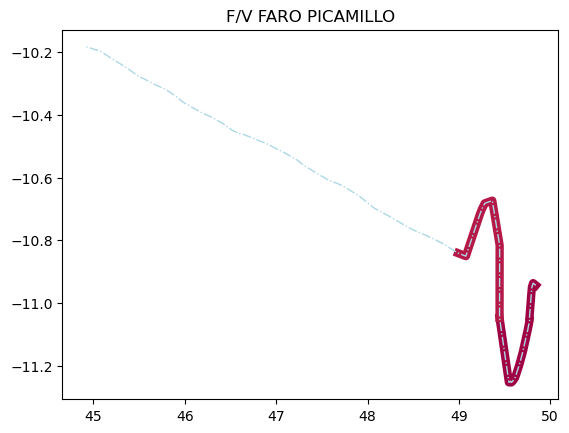

     position_speed  position_latitude  position_longitude
0               2.1          49.734237          -11.156408
1               2.1          49.734237          -11.156408
2               1.9          49.726507          -11.162200
3               1.7          49.722527          -11.165370
4               0.5          49.720810          -11.166680
5               2.1          49.718277          -11.168967
6               1.1          49.713160          -11.174123
7               1.1          49.713160          -11.174123
8               1.5          49.708340          -11.178112
9               1.7          49.704127          -11.181700
10              1.1          49.699583          -11.185652
11              1.3          49.697720          -11.187218
12              1.2          49.694263          -11.190810
13              0.5          49.686547          -11.199200
14              1.1          49.684897          -11.200308
15              1.0          49.681933          -11.2027

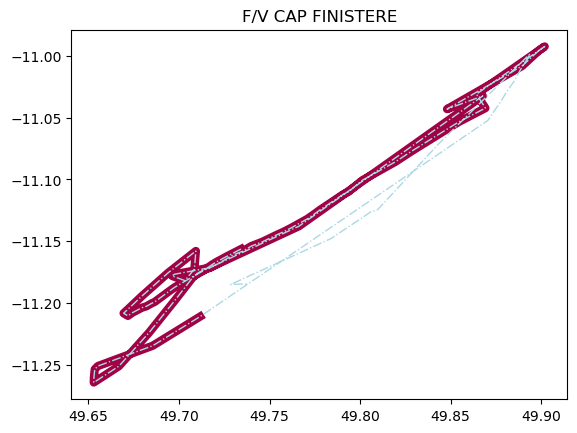

     position_speed  position_latitude  position_longitude
0               4.7          47.714543           -5.090395
1               4.7          47.714543           -5.090395
2               1.9          47.712087           -5.126952
3               1.9          47.712347           -5.133187
4               2.4          47.712785           -5.151058
5               1.9          47.711803           -5.164193
6               2.2          47.710702           -5.176997
7               2.0          47.709660           -5.190095
8               2.1          47.709338           -5.194853
9               2.2          47.708435           -5.218072
10              2.2          47.708435           -5.218072
11              2.9          47.701068           -5.245783
12              3.2          47.693832           -5.258235
13              3.1          47.685003           -5.270412
14              3.0          47.676008           -5.283100
15              3.1          47.669438           -5.2919

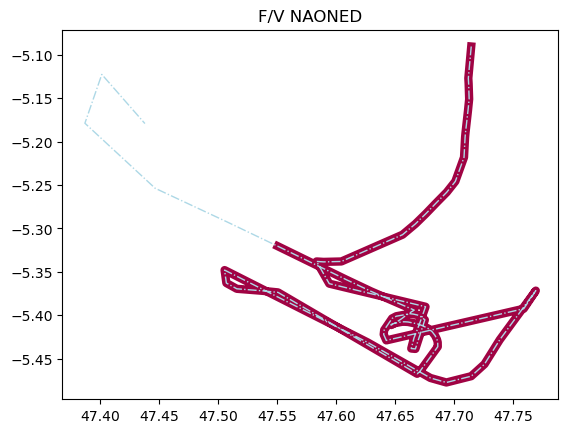

     position_speed  position_latitude  position_longitude
0               3.5          49.491723          -10.328490
1               3.5          49.491723          -10.328490
2               3.4          49.490330          -10.282770
3               3.4          49.490330          -10.282770
4               3.4          49.489695          -10.260622
5               3.6          49.488555          -10.220702
6               3.2          49.487818          -10.195600
7               3.2          49.487818          -10.195600
8               3.7          49.484395          -10.174247
9               3.9          49.479323          -10.169540
10              3.9          49.455630          -10.184007
11              3.9          49.455630          -10.184007
12              2.3          49.446915          -10.188362
13              3.3          49.422735          -10.202808
14              3.5          49.416928          -10.206422
15              3.5          49.416928          -10.2064

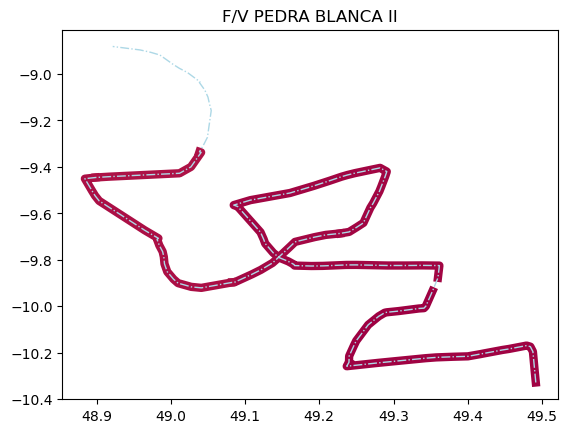

     position_speed  position_latitude  position_longitude
0               0.5          49.879408          -11.101905
1               0.5          49.879408          -11.101905
2               0.3          49.876067          -11.102347
3               0.7          49.875083          -11.102925
4               0.7          49.875083          -11.102925
5               0.1          49.874638          -11.103910
6               1.1          49.877232          -11.099880
7               2.3          49.877397          -11.101638
8               3.5          49.873442          -11.113653
9               3.4          49.862672          -11.124318
10              2.9          49.843258          -11.135672
11              3.3          49.835783          -11.139643
12              3.3          49.822752          -11.146815
13              3.3          49.806348          -11.155812
14              3.0          49.801728          -11.158313
15              3.0          49.777820          -11.1806

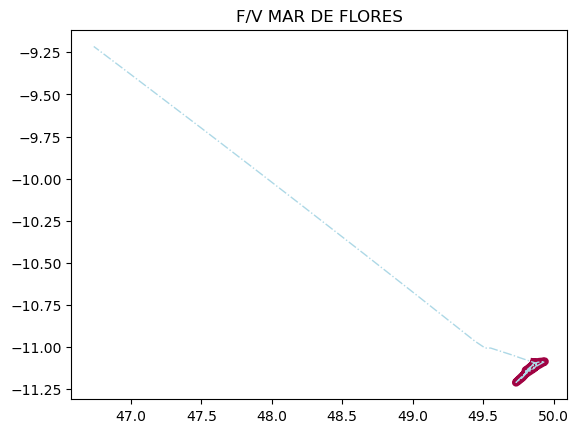

     position_speed  position_latitude  position_longitude
0               2.2          49.722808          -11.201203
1               2.2          49.722808          -11.201203
2               1.7          49.717288          -11.206682
3               1.1          49.712108          -11.211642
4               1.1          49.712108          -11.211642
5               1.8          49.707607          -11.215487
6               2.1          49.698070          -11.223962
7               2.1          49.698070          -11.223962
8               2.1          49.698070          -11.223962
9               1.3          49.686080          -11.236157
10              1.2          49.681500          -11.240337
11              1.2          49.681500          -11.240337
12              1.2          49.681500          -11.240337
13              1.2          49.681500          -11.240337
14              1.9          49.670770          -11.249262
15              0.6          49.670163          -11.2509

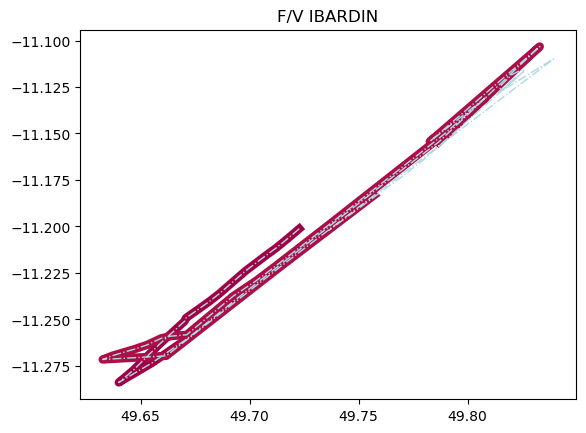

     position_speed  position_latitude  position_longitude
0               2.5          49.028753          -10.146657
1               2.5          49.028753          -10.146657
2               1.0          49.024250          -10.149115
3               1.2          49.020278          -10.153557
4               1.2          49.020278          -10.153557
5               1.0          49.010918          -10.162880
6               1.4          49.005258          -10.169255
7               1.4          49.005258          -10.169255
8               1.1          49.001848          -10.172870
9               0.9          48.997832          -10.177025
10              0.1          48.993817          -10.179393
11              0.1          48.993817          -10.179393
12              3.8          48.991143          -10.173572
13              0.1          48.990700          -10.172715
14              2.6          48.989207          -10.172433
15              2.6          48.989207          -10.1724

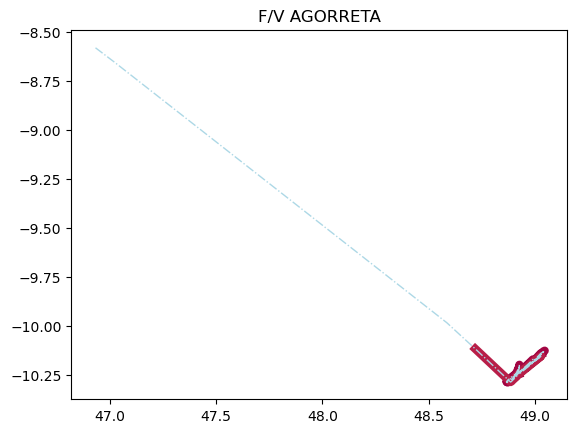

     position_speed  position_latitude  position_longitude
0               4.3          50.626320            1.299702
1               4.3          50.626320            1.299702
2               4.4          50.613213            1.277390
3               4.2          50.591702            1.238920
4               4.3          50.586020            1.224918
5               4.1          50.581407            1.207735
6               4.1          50.567013            1.177568
7               3.6          50.557160            1.153640
8               7.5          50.555230            1.156365
9               7.9          50.582617            1.214705
10              7.9          50.599528            1.252173
11              7.8          50.603205            1.260665
12              7.7          50.634915            1.327347
13              7.9          50.658507            1.379943
14              7.7          50.681997            1.431238
15              8.4          50.698797            1.4701

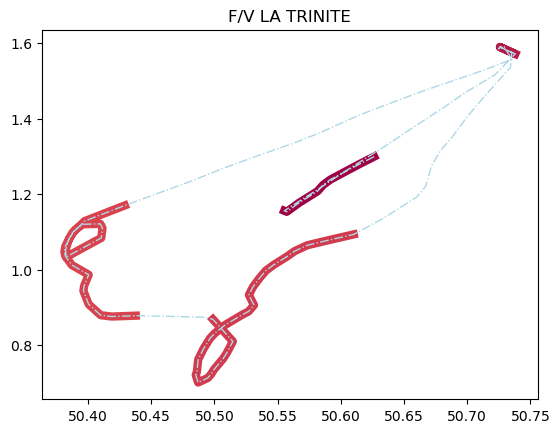

     position_speed  position_latitude  position_longitude
0               1.1          49.168203          -10.024075
1               1.1          49.168203          -10.024075
2               2.3          49.164772          -10.026643
3               2.3          49.164772          -10.026643
4               2.7          49.156528          -10.033975
5               1.2          49.151587          -10.038452
6               1.5          49.147392          -10.041575
7               1.5          49.147392          -10.041575
8               1.3          49.135170          -10.054212
9               1.6          49.131192          -10.055685
10              2.0          49.128690          -10.057575
11              2.0          49.128690          -10.057575
12              0.9          49.118325          -10.064675
13              0.6          49.115433          -10.063372
14              0.8          49.112420          -10.060442
15              5.2          49.122965          -10.0556

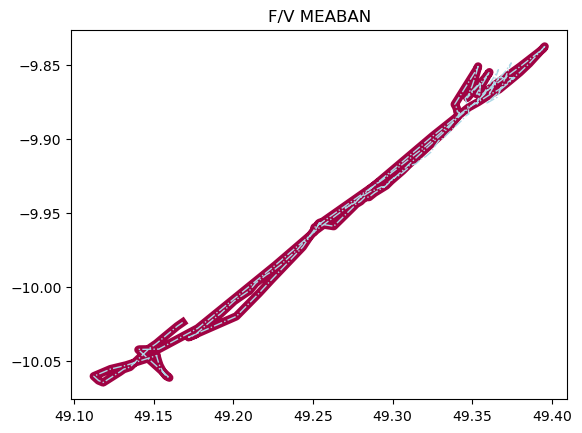

     position_speed  position_latitude  position_longitude
0               1.9          47.710522           -5.110160
1               1.9          47.710522           -5.110160
2               5.1          47.709098           -5.124320
3               1.5          47.709673           -5.135258
4               2.0          47.709840           -5.153388
5               2.1          47.708765           -5.165887
6               2.1          47.707655           -5.178468
7               2.2          47.706700           -5.191278
8               2.3          47.706270           -5.196792
9               2.2          47.705512           -5.219755
10              2.1          47.705422           -5.220917
11              2.7          47.703167           -5.234865
12              2.8          47.689085           -5.258702
13              2.9          47.680918           -5.269803
14              3.1          47.677347           -5.274875
15              3.1          47.677347           -5.2748

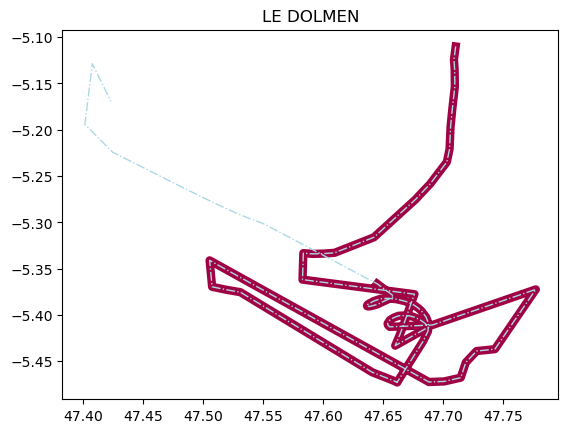

     position_speed  position_latitude  position_longitude
0               2.8          50.441930            0.934480
1               2.8          50.441930            0.934480
2               2.3          50.449657            0.925977
3               2.1          50.456347            0.929428
4               1.6          50.463935            0.937048
5               1.8          50.468532            0.943015
6               2.2          50.478445            0.950998
7               2.2          50.484440            0.957543
8               2.3          50.488118            0.959803
9               2.5          50.499800            0.976777
10              2.9          50.509902            0.994258
11              2.9          50.509902            0.994258
12              2.8          50.517172            1.013128
13              5.7          50.530580            1.041027
14              8.7          50.551023            1.096552
15              8.6          50.553030            1.1018

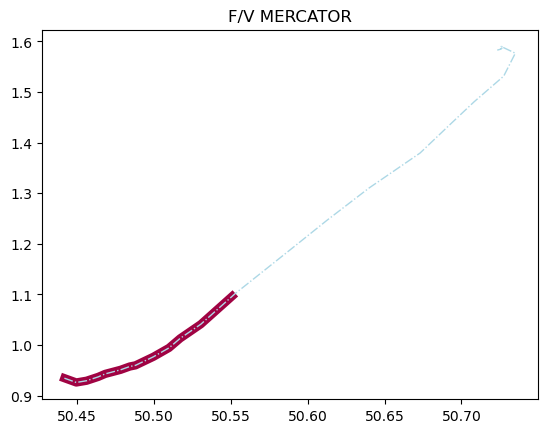

     position_speed  position_latitude  position_longitude
0               2.9          49.536567           -8.853217
1               2.9          49.536567           -8.853217
2               2.1          49.531167           -8.854017
3               3.9          49.520217           -8.848033
4               3.3          49.496900           -8.851167
5               3.3          49.482783           -8.856000
6               3.6          49.468200           -8.858133
7               3.6          49.465683           -8.858417
8               3.7          49.447200           -8.857750
9               3.4          49.446867           -8.857750
10              4.0          49.405867           -8.853783
11              3.5          49.395417           -8.855333
12              3.7          49.375417           -8.862567
13              3.6          49.369150           -8.865650
14              3.6          49.369150           -8.865650
15              3.8          49.339567           -8.8961

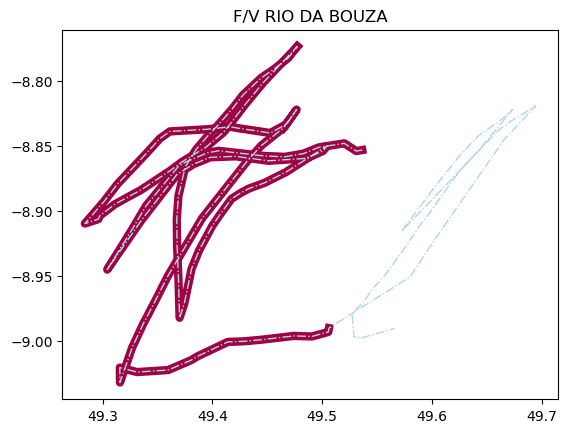

     position_speed  position_latitude  position_longitude
0               3.4          49.138952           -8.448528
1               3.4          49.143535           -8.448357
2               3.4          49.157630           -8.447637
3               3.4          49.167335           -8.446737
4               3.6          49.180652           -8.439085
5               3.7          49.196085           -8.421477
6               3.6          49.205900           -8.404542
7               3.4          49.215017           -8.388297
8               3.3          49.221387           -8.376783
9               1.1          49.220877           -8.373818
10              2.3          49.235977           -8.350673
11              3.1          49.244705           -8.336438
12              3.1          49.253485           -8.321900
13              3.0          49.265813           -8.302883
14              3.2          49.272638           -8.293453
15              3.0          49.282328           -8.2800

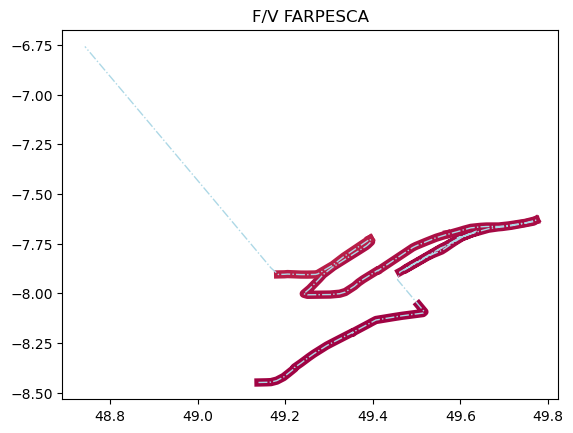

     position_speed  position_latitude  position_longitude
0               3.3          49.030183          -10.707533
1               3.3          49.030183          -10.707533
2               3.3          49.030183          -10.707533
3               3.3          49.030183          -10.707533
4               3.3          49.030183          -10.707533
5               3.3          49.030183          -10.707533
6               3.5          48.991583          -10.798750
7               3.5          48.991583          -10.798750
8               3.6          48.982433          -10.820267
9               3.7          48.971983          -10.844983
10              3.6          48.961833          -10.868383
11              3.6          48.961833          -10.868383
12              3.7          48.951317          -10.893583
13              3.6          48.944967          -10.908467
14              3.6          48.944967          -10.908467
15              3.1          48.937767          -10.9317

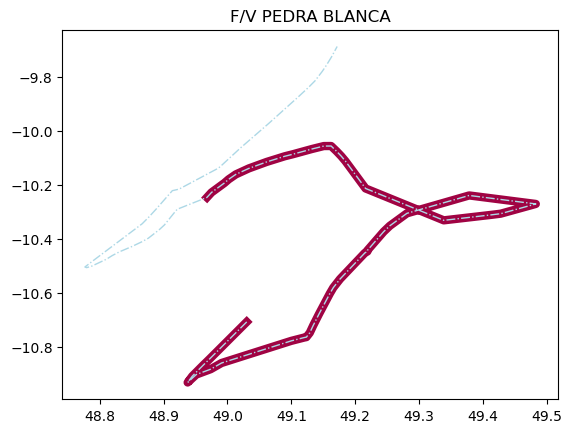

     position_speed  position_latitude  position_longitude
0               0.0         -15.928333           53.975000
1               0.0         -15.928333           53.975000
2               0.0         -15.928333           53.975000
3               0.7         -15.933315           53.965530
4               0.7         -15.933315           53.965530
5               0.7         -15.933315           53.965530
6               0.7         -15.933315           53.965530
7               0.7         -15.933315           53.965530
8               0.7         -15.933315           53.965530
9               0.7         -15.933315           53.965530
10              0.7         -15.933315           53.965530
11              0.7         -15.933315           53.965530
12              0.7         -15.933315           53.965530
13              0.7         -15.933315           53.965530
14              0.7         -15.933315           53.965530
15              0.7         -15.933315           53.9655

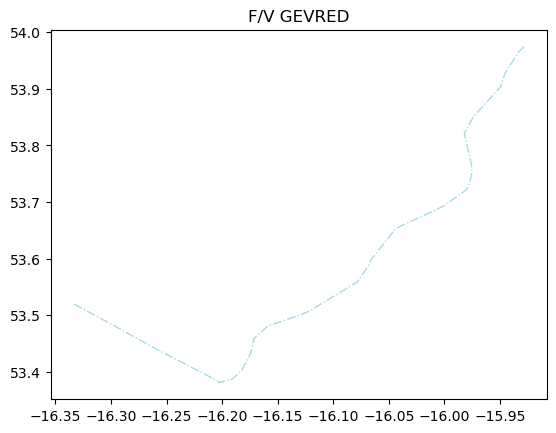

     position_speed  position_latitude  position_longitude
0              10.2          51.397583            2.472033
1              10.2          51.397583            2.472033
2              10.3          51.398267            2.432367
3               6.2          51.398050            2.296117
4               3.0          51.395650            2.292117
5               4.4          51.366583            2.268050
6               4.7          51.364883            2.266917
7               4.4          51.333050            2.251183
8               4.4          51.328567            2.249167
9               5.0          51.308883            2.241200
10              5.5          51.291150            2.219400
11              5.7          51.266400            2.194317
12              5.7          51.266400            2.194317
13              5.6          51.223733            2.160350
14              4.6          51.213900            2.148550
15              4.6          51.213900            2.1485

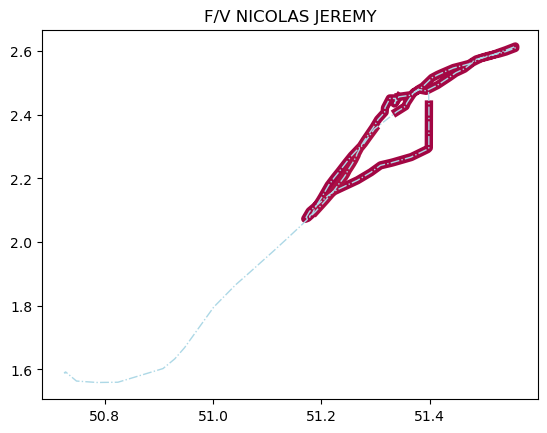

     position_speed  position_latitude  position_longitude
0               7.8          44.591753           -8.131868
1               7.8          44.591753           -8.131868
2               7.7          44.559438           -8.139817
3               6.8          44.524793           -8.150578
4               6.8          44.498057           -8.159747
5               6.7          44.475358           -8.164822
6               6.8          44.448078           -8.171057
7               6.6          44.420440           -8.177797
8               6.8          44.392755           -8.184773
9               7.1          44.364648           -8.190110
10              7.2          44.331597           -8.198085
11              7.3          44.305033           -8.205247
12              7.2          44.271207           -8.211987
13              7.5          44.240125           -8.214867
14              7.2          44.213812           -8.215343
15              7.3          44.177410           -8.2162

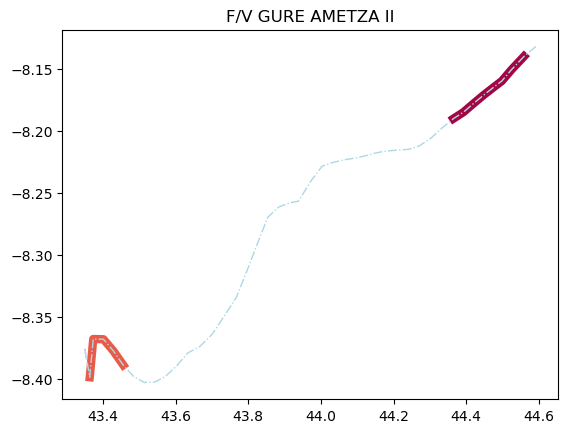

     position_speed  position_latitude  position_longitude
0               0.0           5.266732           -4.033380
1               0.0           5.266732           -4.033380
2               0.0           5.266732           -4.033380
3               0.0           5.266695           -4.033423
4               0.1           5.266642           -4.033432
5               0.0           5.266493           -4.033423
6               0.0           5.266453           -4.033468
7               0.0           5.266492           -4.033413
8               0.0           5.266653           -4.033357
9               0.0           5.266877           -4.033380
10              0.0           5.266802           -4.033400
11              0.0           5.266805           -4.033382
12              0.1           5.266722           -4.033333
13              0.0           5.266728           -4.033368
14              0.0           5.266780           -4.033303
15              0.0           5.266783           -4.0332

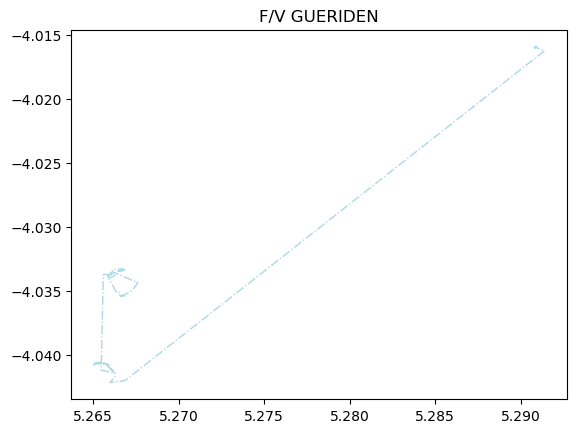

     position_speed  position_latitude  position_longitude
0              11.5          51.356900            2.383603
1              11.5          51.356900            2.383603
2              11.4          51.339983            2.330828
3              11.3          51.318733            2.263075
4              12.0          51.291960            2.172338
5              11.6          51.291527            2.170793
6               3.2          51.274023            2.126498
7               5.7          51.251807            2.093560
8               5.4          51.229377            2.075198
9               5.2          51.214137            2.049975
10              4.7          51.214650            2.025180
11              4.3          51.217243            2.008137
12              5.2          51.218563            1.996743
13              5.8          51.211213            1.962538
14              5.3          51.200953            1.925510
15              5.3          51.200953            1.9255

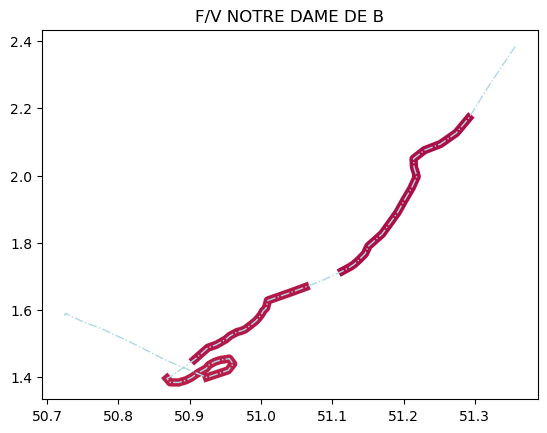

     position_speed  position_latitude  position_longitude
0               0.0          50.062538            1.379585
1               0.0          50.062538            1.379585
2               0.0          50.062538            1.379585
3               0.0          50.062538            1.379585
4               0.0          50.062538            1.379585
5               0.0          50.062538            1.379585
6               0.0          50.062538            1.379585
7               0.0          50.062538            1.379585
8               5.0          49.977100            1.046422
9               5.0          49.977100            1.046422
10              4.1          49.959030            1.067535
11              6.4          49.947407            1.065018
12              5.2          49.928413            1.084928
13              5.2          49.928413            1.084928
14              0.1          49.927532            1.083205
15              7.0          49.929175            1.0855

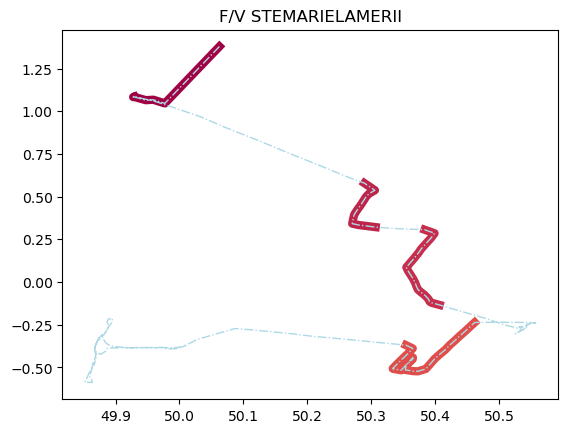

     position_speed  position_latitude  position_longitude
0              11.6          57.452738            7.931167
1              11.6          57.452738            7.931167
2              11.3          57.423793            8.001535
3              11.2          57.393933            8.068865
4              11.2          57.363335            8.133902
5              11.1          57.332828            8.198343
6              11.1          57.302207            8.262088
7              11.1          57.271617            8.325893
8              11.0          57.240527            8.388482
9              11.0          57.209213            8.449803
10             10.8          57.178158            8.513093
11             11.0          57.158165            8.555745
12              2.7          57.118902            8.594072
13              0.0          57.118073            8.593100
14              0.0          57.118050            8.593118
15              0.0          57.118085            8.5930

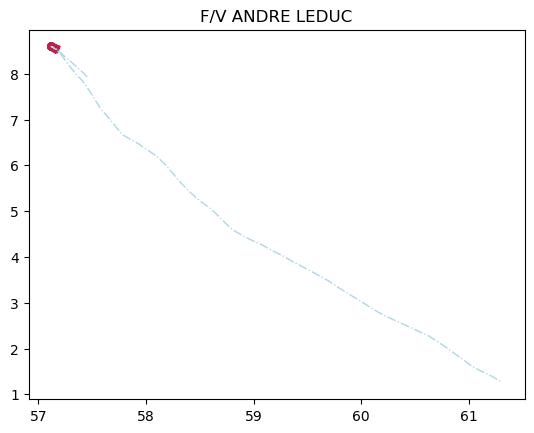

     position_speed  position_latitude  position_longitude
0              11.3          57.542720            7.717900
1              11.3          57.542720            7.717900
2              11.6          57.512713            7.783998
3              11.9          57.482513            7.854042
4              11.7          57.453760            7.927202
5              11.5          57.425293            8.002090
6              11.2          57.396520            8.074513
7              11.7          57.361853            8.135740
8              11.4          57.325327            8.195777
9              11.4          57.293660            8.256677
10             11.7          57.262247            8.322242
11             11.1          57.230620            8.387037
12             11.1          57.199400            8.452208
13             11.9          57.168453            8.522392
14              9.9          57.139360            8.583608
15              0.7          57.121240            8.5950

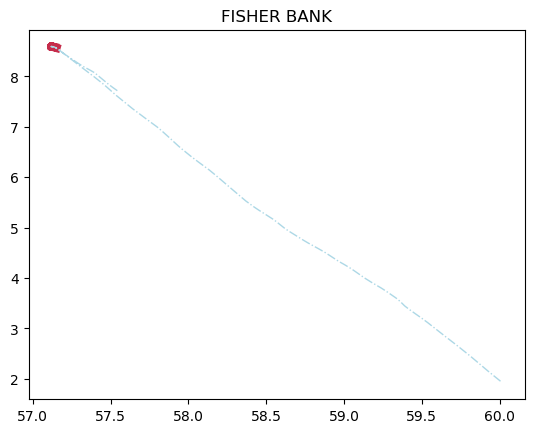

     position_speed  position_latitude  position_longitude
0               9.4          50.246970            0.873485
1               9.4          50.246970            0.873485
2               9.5          50.254190            0.891423
3               9.5          50.304617            0.967732
4               9.7          50.325923            1.000173
5               9.7          50.333138            1.011688
6               9.3          50.386980            1.093140
7               9.8          50.415737            1.120023
8               9.8          50.430690            1.139547
9               9.8          50.463182            1.180960
10              9.9          50.499897            1.242250
11              9.9          50.509542            1.261152
12              9.8          50.540067            1.312112
13             10.0          50.588267            1.380803
14             10.4          50.635403            1.445902
15             10.6          50.669658            1.4888

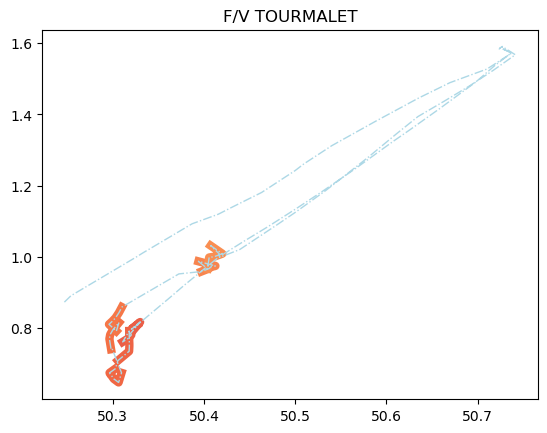

     position_speed  position_latitude  position_longitude
0               9.9          51.580167            3.151508
1               9.9          51.580167            3.151508
2               9.9          51.545793            3.116073
3              10.6          51.514600            3.068093
4              10.8          51.491173            3.007403
5              11.3          51.468447            2.945682
6              11.6          51.445783            2.876780
7              11.7          51.423393            2.807663
8              11.7          51.402143            2.737748
9              11.5          51.391512            2.663763
10             11.6          51.377103            2.590767
11             12.1          51.334505            2.552473
12             12.0          51.297622            2.517468
13             12.1          51.251537            2.458278
14             11.9          51.239782            2.443655
15             12.0          51.181132            2.3532

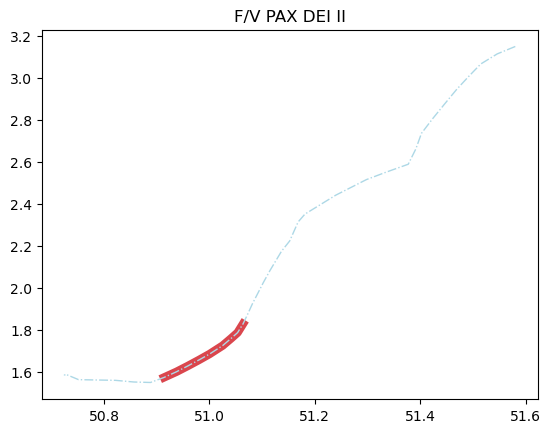

     position_speed  position_latitude  position_longitude
0               9.8          51.586305            3.151890
1               9.8          51.586305            3.151890
2              10.4          51.551110            3.117198
3              10.6          51.529172            3.085557
4              11.1          51.492358            3.012432
5              11.5          51.470935            2.947548
6              11.7          51.448838            2.878558
7              11.8          51.431892            2.829840
8              11.8          51.407760            2.756063
9              11.7          51.390812            2.688262
10             12.1          51.376017            2.615457
11             12.0          51.335483            2.559352
12             12.3          51.290703            2.506888
13             12.1          51.249787            2.459128
14             12.2          51.215178            2.413763
15             12.2          51.181770            2.3539

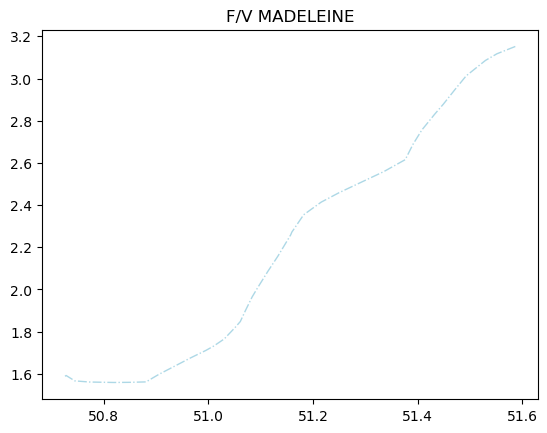

     position_speed  position_latitude  position_longitude
0               0.0          -4.620282           55.461925
1               0.0          -4.620282           55.461925
2               0.0          -4.620282           55.461925
3               0.0          -4.620265           55.461927
4               0.0          -4.620268           55.461908
5               0.0          -4.620273           55.461900
6               0.0          -4.620273           55.461900
7               0.0          -4.620285           55.461895
8               0.0          -4.620252           55.461878
9               0.0          -4.620267           55.461928
10              0.0          -4.620267           55.461928
11              0.0          -4.620278           55.461915
12              0.0          -4.620255           55.461880
13              0.0          -4.620248           55.461930
14              0.0          -4.620248           55.461930
15              0.0          -4.620278           55.4619

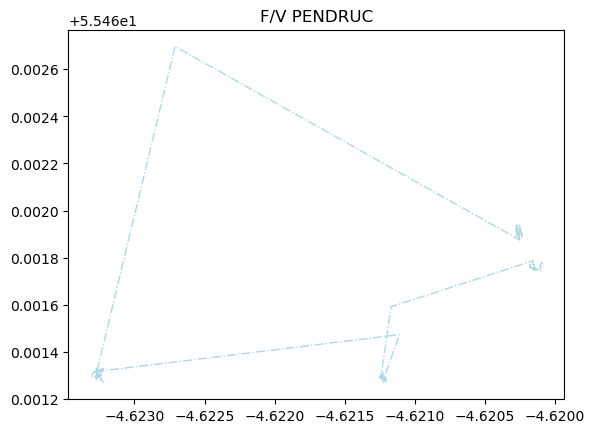

     position_speed  position_latitude  position_longitude
0               0.0          57.120740            8.595742
1               0.0          57.120740            8.595742
2               0.0          57.120745            8.595707
3               0.0          57.120737            8.595717
4               0.0          57.120755            8.595698
5               0.0          57.120727            8.595708
6               0.0          57.120725            8.595730
7               0.0          57.120717            8.595745
8               0.0          57.120725            8.595743
9               0.0          57.120750            8.595732
10              0.0          57.120752            8.595713
11              0.0          57.120748            8.595755
12              0.0          57.120747            8.595728
13              0.0          57.120728            8.595728
14              0.0          57.120732            8.595722
15              0.0          57.120738            8.5957

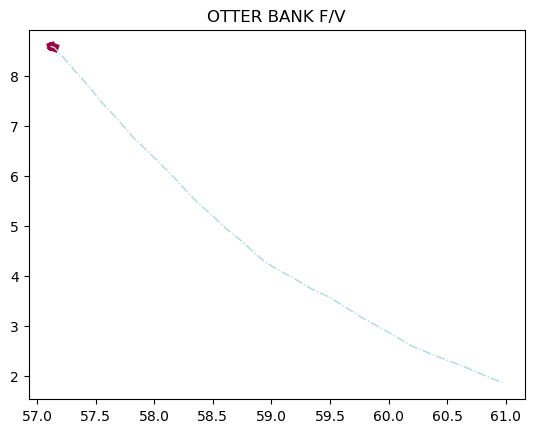

     position_speed  position_latitude  position_longitude
0               7.4          49.836320           -0.186057
1               7.4          49.836320           -0.186057
2               7.4          49.836320           -0.186057
3               7.4          49.836320           -0.186057
4               7.4          49.836320           -0.186057
5               7.4          49.836320           -0.186057
6               7.4          49.836320           -0.186057
7               7.4          49.836320           -0.186057
8               7.4          49.836320           -0.186057
9               7.4          49.836320           -0.186057
10              7.4          49.836320           -0.186057
11              7.4          49.836320           -0.186057
12              7.4          49.836320           -0.186057
13              7.4          49.836320           -0.186057
14              7.4          49.836320           -0.186057
15              7.4          49.836320           -0.1860

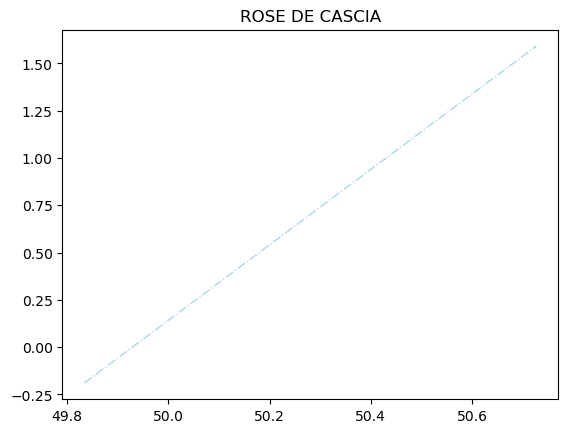

     position_speed  position_latitude  position_longitude
0              10.3          49.547598           -0.177695
1              10.3          49.547598           -0.177695
2              10.3          49.547598           -0.177695
3              10.3          49.547598           -0.177695
4              10.3          49.547598           -0.177695
5              10.3          49.547598           -0.177695
6              10.3          49.547598           -0.177695
7              10.3          49.547598           -0.177695
8              10.3          49.547598           -0.177695
9              10.3          49.547598           -0.177695
10             10.3          49.547598           -0.177695
11             10.3          49.547598           -0.177695
12             10.3          49.547598           -0.177695
13             10.3          49.547598           -0.177695
14             10.3          49.547598           -0.177695
15             10.3          49.547598           -0.1776

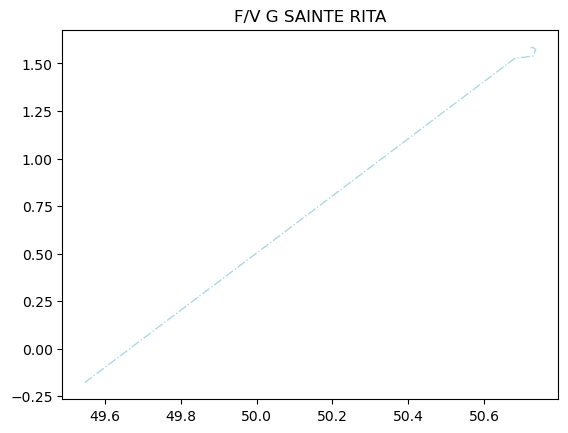

     position_speed  position_latitude  position_longitude
0               0.0          -4.616507           55.463262
1               0.0          -4.616507           55.463262
2               0.0          -4.616507           55.463262
3               0.0          -4.616462           55.463292
4               0.0          -4.616488           55.463285
5               0.0          -4.616517           55.463222
6               0.0          -4.616517           55.463222
7               0.0          -4.616532           55.463248
8               0.0          -4.616452           55.463273
9               0.0          -4.616420           55.463335
10              0.0          -4.616420           55.463335
11              0.0          -4.616465           55.463307
12              0.0          -4.616463           55.463350
13              0.0          -4.616457           55.463315
14              0.0          -4.616457           55.463315
15              0.0          -4.616475           55.4633

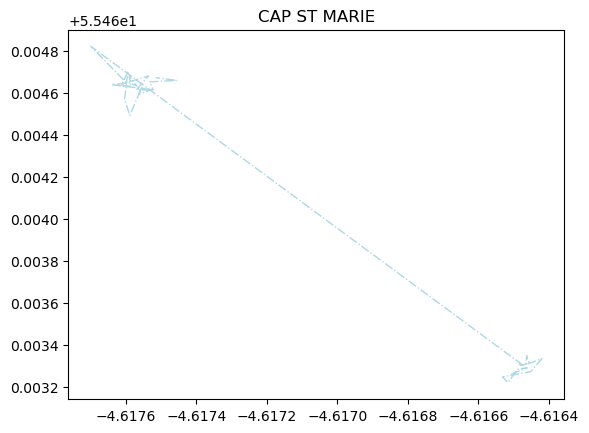

     position_speed  position_latitude  position_longitude
0              11.3          48.995475           -6.057543
1              11.3          48.995475           -6.057543
2              11.5          48.942282           -6.061905
3              11.7          48.894005           -6.067010
4              11.8          48.845315           -6.072602
5              12.2          48.794805           -6.077712
6              12.5          48.744868           -6.069062
7              12.6          48.697647           -6.037222
8              12.7          48.650910           -5.995218
9              12.8          48.621770           -5.970155
10             12.8          48.567788           -5.918227
11             12.4          48.525252           -5.864922
12             12.6          48.493992           -5.822573
13             12.4          48.453655           -5.766865
14             12.3          48.413817           -5.706578
15             12.4          48.359182           -5.6799

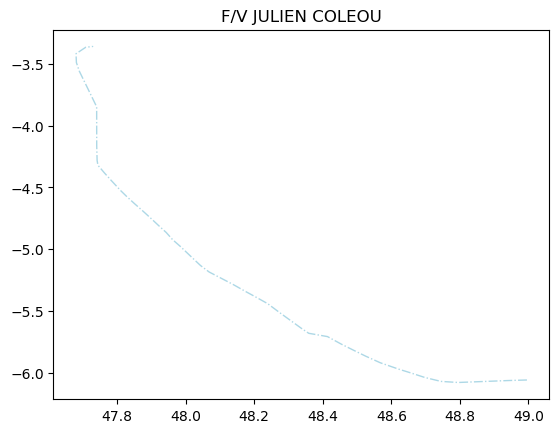

     position_speed  position_latitude  position_longitude
0               0.0          43.681505           -7.597408
1               0.0          43.681505           -7.597408
2               0.0          43.681505           -7.597408
3               0.0          43.681505           -7.597408
4               0.0          43.681505           -7.597408
5               0.0          43.681505           -7.597408
6               0.0          43.681505           -7.597408
7               0.0          43.681505           -7.597408
8               0.0          43.681505           -7.597408
9               0.0          43.681505           -7.597408
10              0.0          43.681505           -7.597408
11              0.0          43.681505           -7.597408
12              0.0          43.681505           -7.597408
13              0.0          43.681505           -7.597408
14              0.0          43.681505           -7.597408
15              0.0          43.681505           -7.5974

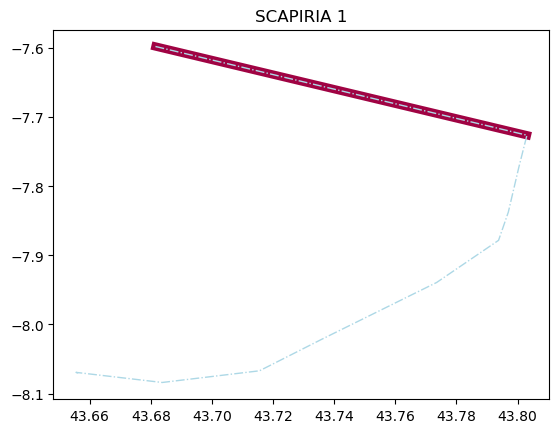

     position_speed  position_latitude  position_longitude
0              10.8          50.241367           -9.290057
1              10.8          50.241367           -9.290057
2              10.8          50.241367           -9.290057
3              10.8          50.241367           -9.290057
4              10.8          50.241367           -9.290057
5              10.8          50.241367           -9.290057
6              10.8          50.241367           -9.290057
7              10.8          50.241367           -9.290057
8              10.8          50.241367           -9.290057
9              10.8          50.241367           -9.290057
10             10.8          50.241367           -9.290057
11             10.8          50.241367           -9.290057
12             10.8          50.241367           -9.290057
13             10.8          50.241367           -9.290057
14             10.8          50.241367           -9.290057
15             10.8          50.241367           -9.2900

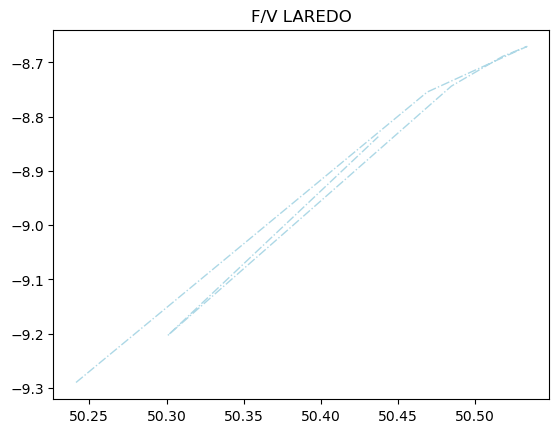

     position_speed  position_latitude  position_longitude
0               0.0          49.345000           -0.751667
1               0.0          49.345000           -0.751667
2               0.0          49.345000           -0.751667
3               0.0          49.345000           -0.751667
4               0.0          49.345000           -0.751667
5               0.0          49.345000           -0.751667
6               0.0          49.345000           -0.751667
7               0.0          49.345000           -0.751667
8               0.0          49.345000           -0.751667
9               0.0          49.345000           -0.751667
10              0.0          49.345000           -0.751667
11              0.0          49.345000           -0.751667
12              0.0          49.345000           -0.751667
13              0.0          49.345000           -0.751667
14              0.0          49.345000           -0.751667
15              0.0          49.345000           -0.7516

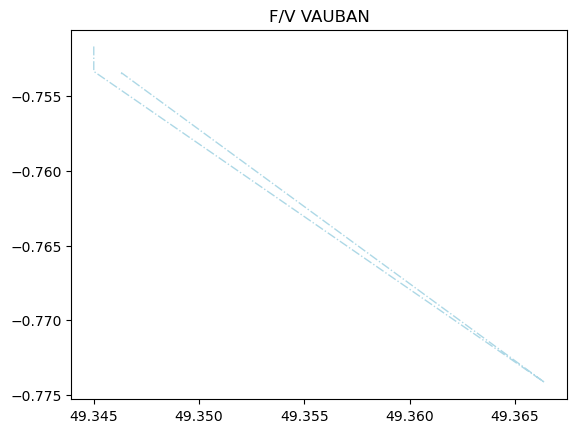

     position_speed  position_latitude  position_longitude
0              13.9          56.906442           -7.239788
1              13.9          56.906442           -7.239788
2              13.9          56.906442           -7.239788
3              13.9          56.906442           -7.239788
4              13.2          57.290118           -6.962900
5              13.3          57.343327           -6.920770
6              13.3          57.343327           -6.920770
7              13.3          57.343327           -6.920770
8              13.7          57.544182           -6.747310
9              13.8          57.548722           -6.742823
10             13.8          57.548722           -6.742823
11             13.9          57.641975           -6.623398
12             13.1          57.671902           -6.530772
13             13.3          57.699268           -6.442723
14             13.5          57.706633           -6.418562
15             13.0          57.758818           -6.2570

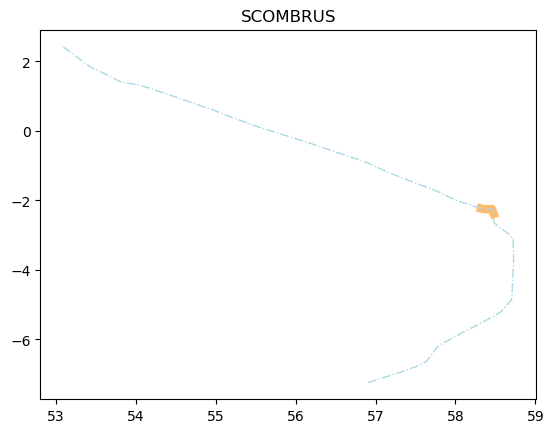

     position_speed  position_latitude  position_longitude
0               0.0           5.289293           -4.016368
1               0.0           5.289293           -4.016368
2               0.0           5.289305           -4.016388
3               0.0           5.289315           -4.016383
4               0.0           5.289317           -4.016388
5               0.0           5.289318           -4.016378
6               0.0           5.289343           -4.016353
7               0.0           5.289335           -4.016352
8               0.0           5.289342           -4.016345
9               0.0           5.289368           -4.016345
10              0.0           5.289363           -4.016407
11              0.0           5.289325           -4.016415
12              0.0           5.289320           -4.016392
13              0.0           5.289315           -4.016405
14              0.0           5.289328           -4.016422
15              0.0           5.289335           -4.0163

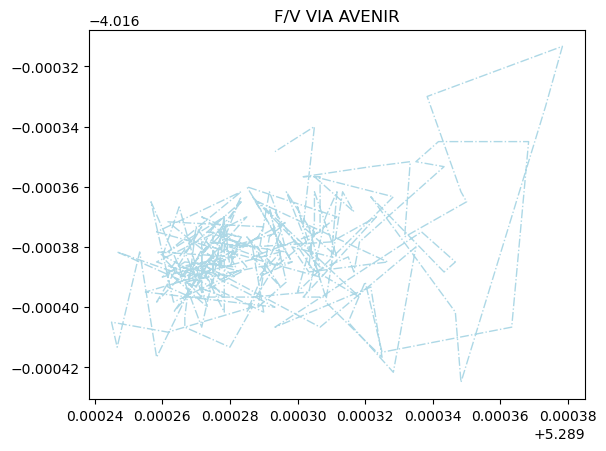

     position_speed  position_latitude  position_longitude
0              10.0          51.190952          -11.402298
1              10.0          51.190952          -11.402298
2              10.0          51.190952          -11.402298
3              10.0          51.190952          -11.402298
4              10.0          51.190952          -11.402298
5              10.0          51.190952          -11.402298
6              10.0          51.190952          -11.402298
7              10.0          51.190952          -11.402298
8              10.0          51.190952          -11.402298
9              10.0          51.190952          -11.402298
10             10.0          51.190952          -11.402298
11             10.0          51.190952          -11.402298
12             10.0          51.190952          -11.402298
13             10.0          51.190952          -11.402298
14             10.0          51.190952          -11.402298
15             10.0          51.190952          -11.4022

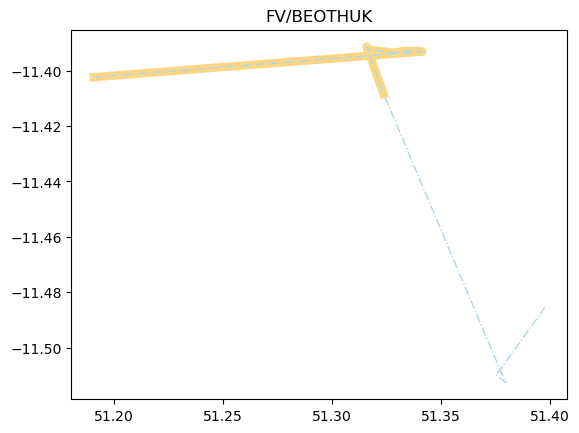

     position_speed  position_latitude  position_longitude
0               9.5          51.494302          -10.410677
1               9.5          51.494302          -10.410677
2               9.5          51.494302          -10.410677
3               9.5          51.494302          -10.410677
4               9.5          51.494302          -10.410677
5               9.5          51.494302          -10.410677
6               9.5          51.494302          -10.410677
7               9.5          51.494302          -10.410677
8               9.5          51.494302          -10.410677
9               9.5          51.494302          -10.410677
10              9.5          51.494302          -10.410677
11              9.5          51.494302          -10.410677
12              9.5          51.494302          -10.410677
13              9.5          51.494302          -10.410677
14              9.5          51.494302          -10.410677
15              9.5          51.494302          -10.4106

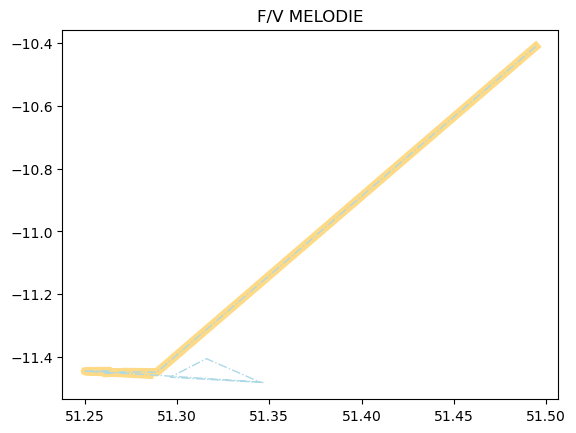

     position_speed  position_latitude  position_longitude
0               0.0           5.290782           -4.015815
1               0.0           5.290782           -4.015815
2               0.0           5.290790           -4.015803
3               0.0           5.290828           -4.015845
4               0.0           5.290833           -4.015845
5               0.0           5.290817           -4.015865
6               0.0           5.290865           -4.015793
7               0.0           5.290900           -4.015822
8               0.0           5.290868           -4.015813
9               0.0           5.290858           -4.015817
10              0.0           5.290823           -4.015852
11              0.0           5.290805           -4.015838
12              0.0           5.290828           -4.015888
13              0.0           5.290858           -4.015870
14              0.0           5.290815           -4.015760
15              0.0           5.290848           -4.0158

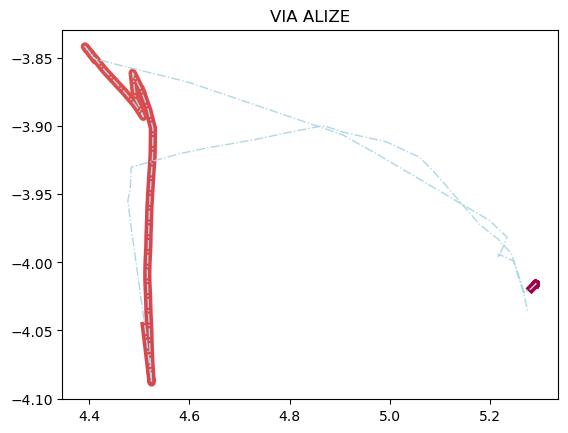

     position_speed  position_latitude  position_longitude
0               0.0          50.726525            1.594182
1               0.0          50.726525            1.594182
2               0.0          50.726548            1.594333
3               0.0          50.726527            1.594203
4               0.0          50.726535            1.594173
5               0.0          50.726558            1.594257
6               0.0          50.726507            1.594183
7               0.0          50.726577            1.594155
8               0.0          50.726547            1.594175
9               0.0          50.726523            1.594220
10              0.0          50.726552            1.594198
11              0.0          50.726520            1.594220
12              0.0          50.726612            1.594232
13              0.0          50.726607            1.594193
14              0.0          50.726512            1.594195
15              0.0          50.726548            1.5942

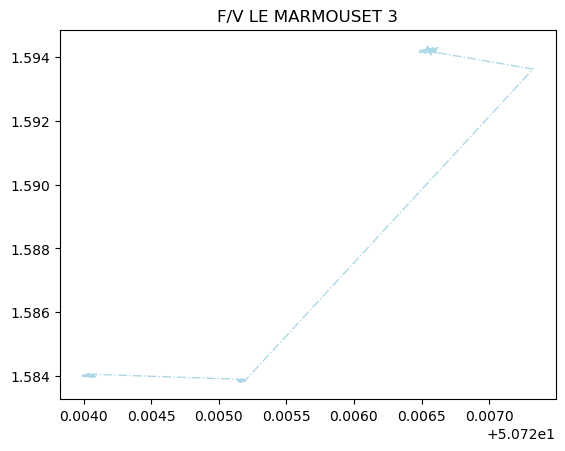

     position_speed  position_latitude  position_longitude
0               8.9          50.456167            0.829167
1               8.9          50.456167            0.829167
2               8.9          50.456167            0.829167
3               8.9          50.456167            0.829167
4               8.9          50.456167            0.829167
5               8.9          50.456167            0.829167
6               8.9          50.456167            0.829167
7               8.9          50.456167            0.829167
8               8.9          50.456167            0.829167
9               8.9          50.456167            0.829167
10              8.9          50.456167            0.829167
11              8.9          50.456167            0.829167
12              8.9          50.456167            0.829167
13              8.9          50.456167            0.829167
14              8.9          50.456167            0.829167
15              8.9          50.456167            0.8291

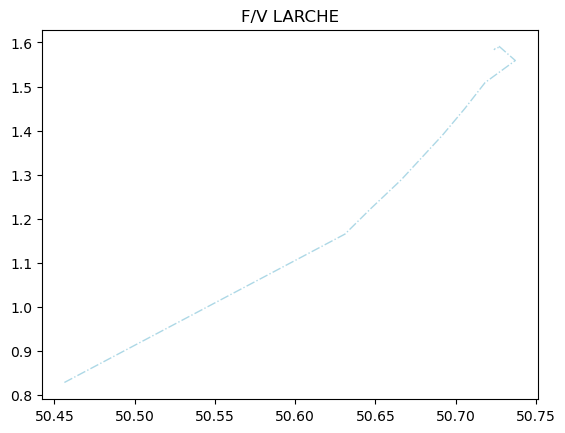

     position_speed  position_latitude  position_longitude
0               0.0          43.403957            3.702057
1               0.0          43.403957            3.702057
2               0.0          43.403957            3.702057
3               0.0          43.403957            3.702057
4               0.0          43.403957            3.702057
5               0.0          43.403957            3.702057
6               0.0          43.403957            3.702057
7               0.0          43.403957            3.702057
8               0.0          43.403957            3.702057
9               0.0          43.403957            3.702057
10              0.0          43.403957            3.702057
11              0.0          43.403957            3.702057
12              0.0          43.403957            3.702057
13              0.0          43.403957            3.702057
14              0.0          43.403957            3.702057
15              0.0          43.403957            3.7020

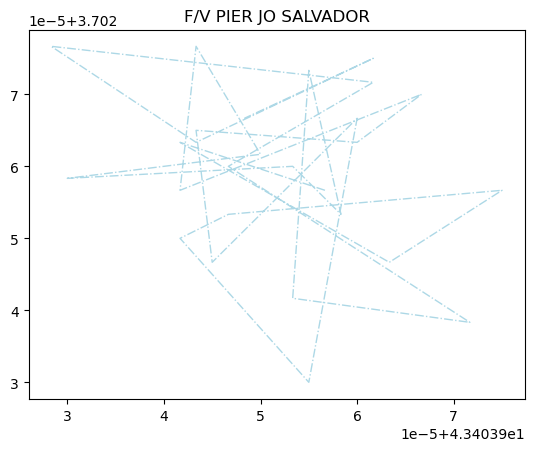

     position_speed  position_latitude  position_longitude
0              11.5          38.427533           15.607013
1              11.5          38.427533           15.607013
2              11.5          38.458555           15.589368
3              11.5          38.501940           15.565183
4              11.5          38.558143           15.532758
5              12.0          38.601947           15.505825
6              11.9          38.631758           15.487132
7              11.7          38.662367           15.467722
8              11.5          38.727083           15.426605
9              11.5          38.764807           15.402297
10             11.2          38.805098           15.377107
11             12.0          38.837387           15.357043
12             12.0          38.837387           15.357043
13             12.0          38.837387           15.357043
14             12.0          38.837387           15.357043
15             12.0          38.837387           15.3570

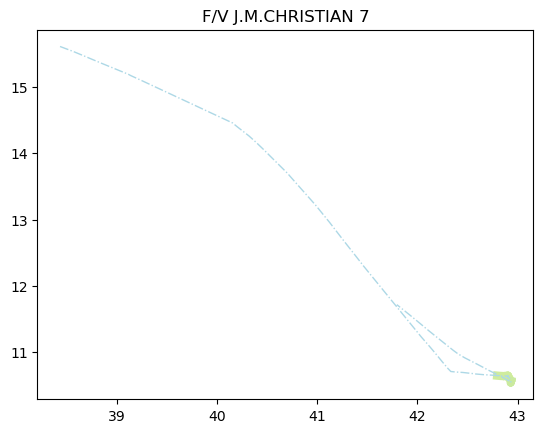

     position_speed  position_latitude  position_longitude
0              11.1          22.969740           37.046657
1              11.1          22.969740           37.046657
2              11.0          22.998642           37.028142
3              10.9          23.045408           36.998578
4              10.6          23.069405           36.984555
5              10.7          23.106798           36.960513
6              10.6          23.155635           36.930223
7              10.5          23.189285           36.909468
8              10.7          23.228233           36.884812
9              10.4          23.266372           36.861197
10             10.4          23.310712           36.833417
11             10.1          23.342342           36.814175
12              9.9          23.386355           36.786473
13             10.3          23.416028           36.767873
14             10.4          23.460085           36.739923
15             10.5          23.491330           36.7213

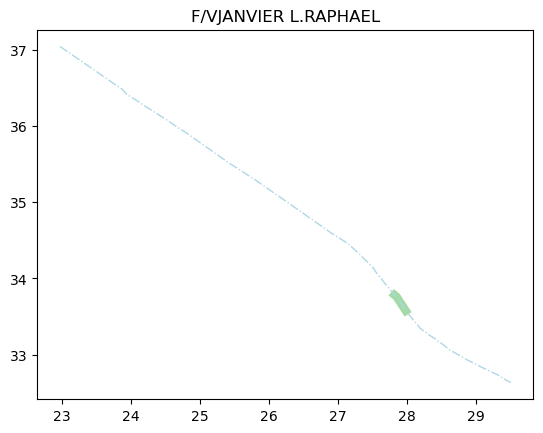

     position_speed  position_latitude  position_longitude
0              14.5          53.795917            4.949873
1              14.5          53.795917            4.949873
2              14.5          53.857963            4.988323
3              14.4          53.924003            5.029825
4              14.3          54.007778            5.082972
5              14.2          54.037473            5.101093
6              13.9          54.092233            5.114187
7              13.9          54.155667            5.107178
8              13.9          54.214092            5.101293
9              13.8          54.249837            5.097793
10             13.9          54.340435            5.089072
11             14.0          54.355620            5.087565
12             13.9          54.398755            5.082810
13             13.9          54.511598            5.071527
14             13.8          54.517052            5.070973
15             13.9          54.607535            5.0616

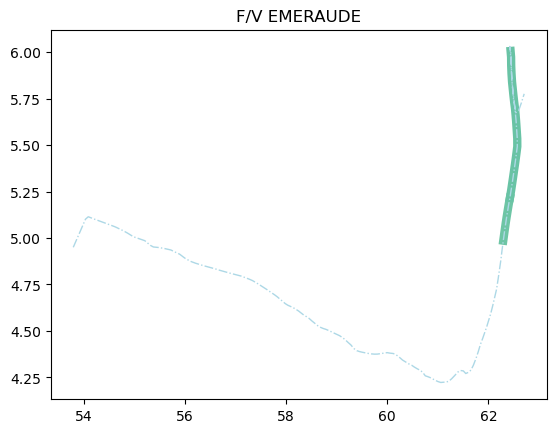

     position_speed  position_latitude  position_longitude
0               9.0          58.612692           -3.533775
1               9.0          58.612692           -3.533775
2               9.0          58.612692           -3.533775
3               9.0          58.612692           -3.533775
4               9.0          58.612692           -3.533775
5               9.0          58.612692           -3.533775
6               9.0          58.612692           -3.533775
7               9.0          58.612692           -3.533775
8               9.0          58.612692           -3.533775
9               9.0          58.612692           -3.533775
10              9.0          58.612692           -3.533775
11              9.0          58.612692           -3.533775
12              9.0          58.612692           -3.533775
13              9.0          58.612692           -3.533775
14              9.0          58.612692           -3.533775
15              9.0          58.612692           -3.5337

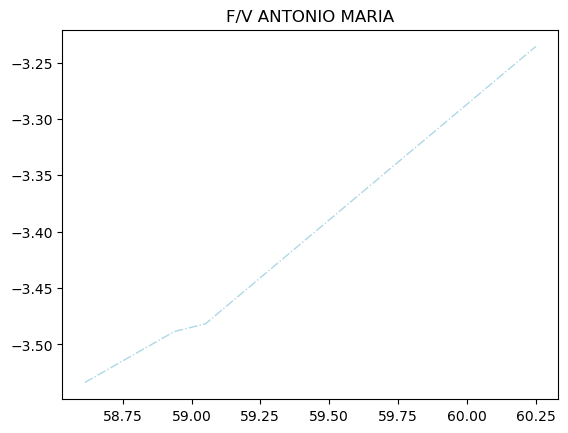

In [149]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
from mycolorpy import colorlist as mcp
import numpy as np
color1=mcp.gen_color(cmap="Spectral",n=200)

for vessel in vessels:
    df_ = df[(df['vessel_name'] == vessel)][['position_speed', 'position_latitude', 'position_longitude']].reset_index().drop('index', axis = 1)
    print(df_)
    indexes = df_[df_['position_speed'] >= 7].index
    for j, index in enumerate(indexes):
            if j == 0:
                #do the plot                     
                df_segment = df_.loc[0:index, :] 
                if len(df_segment) > 5:
                    plt.plot(df_segment['position_latitude'], df_segment['position_longitude'], color=color1[j+1], linewidth=6, label=f'{j+1}')
            if j != (len(indexes)-1):
                i = indexes[j+1]
                if i != index + 1:
                    print('diff ' + str(index) + ' ' + str(i))
                    df_segment = df_.loc[index:i, :]                        
                    if len(df_segment) > 5:
                        plt.plot(df_segment['position_latitude'], df_segment['position_longitude'], color=color1[j], linewidth=6, label=f'{j}')
    
    df__ = df[df['vessel_name'] == vessel]
    plt.plot(df__['position_latitude'], df__['position_longitude'], color= 'lightblue', linestyle = '-.', linewidth = 1)
    plt.title(vessel)
    plt.show();

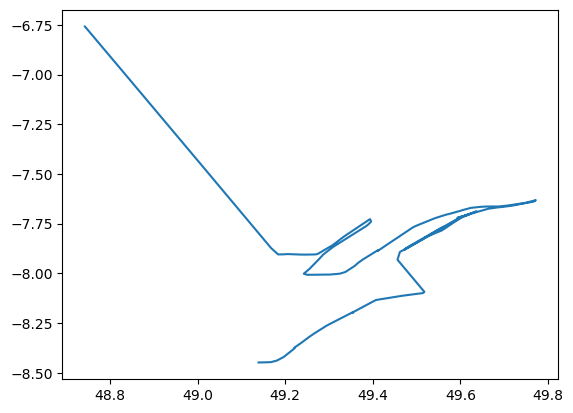

In [127]:
df__ = df[df['vessel_name'] == 'F/V FARPESCA']
plt.plot(df__['position_latitude'], df__['position_longitude'])

In [ ]:
from mycolorpy import colorlist as mcp
import numpy as np
color1=mcp.gen_color(cmap="winter",n=50)
print(color1)

In [47]:
df['vessel_name'].unique()

array(['F/V GERALD-JEAN 3', 'F/V ASPIN', 'CHRISDERIC V',
       'F/V GERALD JEAN IV', 'F/V  J.M.CHRISTIAN 4', 'F/V GLENAN',
       'CAP SAINT VINCENT', 'F/V TH0MAS NICOLAS 2', 'AVEL VAD',
       'NOTRE DAME CEDEIRA', 'F/V STEMARIELAMERII', 'CAP HORIZON',
       'SCAPIRIA 1', 'F/V ERIC MARIN', 'F/V VAUBAN', 'ROSE DE CASCIA',
       'F/V CHRISDERIC2', 'F/V GRAND ST BERNARD', 'PUNTA VIXIA',
       'F/V J.M.CHRISTIAN 3', 'F/V CORONA DEL MAR', 'F/V ROSSOREN',
       'F/V BIKAIN', 'F/V GERARD LUC 4', 'F/V JANVIER GIORDANO',
       'F/V G SAINTE RITA', 'F/V PIER JO SALVADOR', 'F/V STERENN',
       'F/V CISBERLANDE 5', 'F/VSTSOPHIEFRANCOIS2', 'F/V PEPE BARREIRO',
       'TIGERS III', 'F/V SAINT GOTHARD', 'F/V PUENTEAREAS UNO',
       'F/V ARGELES', 'F/V MAR MARES', 'F/V PLAYA DE TUYA', 'FV/BEOTHUK',
       'F/V LANDORA', 'F/V RABELAIS', 'F/V CAP BOJADOR', 'F/V GUEOTEC',
       'F/V SYLVANNA', 'FV FERREIRA MARTINEZ', 'F/V SIEMPRE VIRIATO',
       'F/V LARCHE', 'F/V MELODIE', 'F/V LOIRA', 'F/V A

In [56]:
pd.set_option('display.min_rows', 1000)
pd.set_option('display.max_rows', 1000)
print(df[df['vessel_name'] =='F/V FARPESCA']['position_speed'])

61        3.4
173       3.4
285       3.4
397       3.4
509       3.6
621       3.7
733       3.6
845       3.4
957       3.3
1069      1.1
1181      2.3
1293      3.1
1405      3.1
1517      3.0
1629      3.2
1741      3.0
1853      3.0
2077      2.9
1965      2.9
2189      2.9
2301      3.2
2413      3.0
2525      3.1
2637      1.2
2749      3.7
2861      3.4
2973      3.5
3085      3.4
3197      3.9
3309      3.9
3533      3.7
3421      3.7
3645      3.5
3757      3.6
3869      3.6
3981      3.7
4093      3.3
4205      9.9
4317      9.6
4429      9.7
4541      8.8
4653      3.8
4765      3.9
4877      3.9
4989      3.7
5101      3.7
5213      3.7
5325      3.5
5437      3.4
5549      4.0
5661      3.9
5773      3.8
5885      3.8
5997      3.4
6109      3.5
6221      3.4
6333      5.0
6445      3.9
6557      4.0
6669      4.0
6781      3.9
6893      4.2
7005      4.2
7117      4.0
7229      4.1
7341      3.9
7453      4.0
7565      4.1
7677      4.1
7789      1.4
7901      5.2
8013  

In [132]:
vessels = df[(df['position_speed'] < 7) & (df['position_speed'] > 0)]['vessel_name'].unique()

In [137]:
len(vessels)

82

In [139]:
i = 0
for vessel in vessels:
    df_vessel = df[df['vessel_name'] == vessel]
    if ((len(df_vessel[df_vessel['position_speed'] < 7])/len(df_vessel)))*100 > 10:
        i +=1
        print(vessel)
print(i)

NOTRE DAME CEDEIRA
F/V GRAND ST BERNARD
PUNTA VIXIA
F/V CORONA DEL MAR
F/V ROSSOREN
F/V STERENN
F/V CISBERLANDE 5
F/V PEPE BARREIRO
F/V SAINT GOTHARD
F/V PUENTEAREAS UNO
F/V ARGELES
F/V MAR MARES
F/V PLAYA DE TUYA
F/V LANDORA
F/V RABELAIS
F/V CAP BOJADOR
F/V GUEOTEC
F/V SYLVANNA
FV FERREIRA MARTINEZ
F/V CUCA
F/V LE RESSAC
F/V R0NSARD
F/V LE CROTELLOIS
F/V YANNICK
BRESSAY-BANK PAIR TR
CAP SAINT GEORGES
F/V SILURE
F/V CROIX MORAND
F/V RADOCHE TERCERO
F/V CARLA
F/V ARMOR II
F/V M. LE ROCH 2
F/V JP LE ROCH
F/V LAPALOMA II
F/V FASTNET
F\V LUDOVIC GEOFFRAY
F/V FARO PICAMILLO
F/V CAP FINISTERE
F/V NAONED
F/V PEDRA BLANCA II
F/V MAR DE FLORES
F/V IBARDIN
F/V AGORRETA
F/V LA TRINITE
F/V MEABAN
LE DOLMEN
F/V MERCATOR
F/V RIO DA BOUZA
F/V FARPESCA
F/V PEDRA BLANCA
F/V GEVRED
F/V NICOLAS JEREMY
F/V GURE AMETZA II
F/V GUERIDEN
F/V NOTRE DAME DE B
F/V STEMARIELAMERII
F/V ANDRE LEDUC
FISHER BANK
F/V TOURMALET
F/V PAX DEI II
F/V MADELEINE
F/V PENDRUC
OTTER BANK F/V
ROSE DE CASCIA
F/V G SAINTE RITA
CAP

In [150]:
# Vérifier les indices
# Changer de place le code des vessels
# Essayer avec un autre choix de vitesse
# Récupérer les portions de trajectoire à labeller: doit le placer sur une map avec latitude et longitude et coloration de vitesse (pour le display), pour la bdd, il faut la portion de trajectoire
# Peut-on trouver un unsupervised qui fait ça ? (Clustering ?)
# Sur streamlit (faire appel à un api qui génère automatiquement at random des portions de trajectoire identifiées comme en dessous de 7)
# Les trajectoires ne sont pas de la même taille, donc est-ce qu'on resize les trajectoires ou est-ce qu'on met des buffers avant et après pour avoir la même taille d'entrée dans l'algo 
# Et tu veux déterminer quels sont les pixels de fish (donc output 1 + le nombre de pixels) (ou 1 selon que l'on ne choisisse que la classification)
# On peut aussi imaginer un outil à la main de rectification des trajectoires quand on identifie un fishing
# Et ensuite on peut détecter le fishing en streaming et faire de l'alerting (est-ce que tu crois qu'ils vont arrêter si tu les appelles de loin comme ça ?)